# datasets from nb_bcat_Data_download_3_some.ipynb

 BCAT1, BCAT2, SLC7A8 in subtype AML-ETO, FLT3-ITD, MLL-AF9

- data/tcga_laml_RNAseq_Counts.rds
- data/tcga_laml_clin.rds
- data/tcga_laml_mutation.rds

- data/target_laml_RNAseq_Counts.rds
- data/target_aml_clin.rds
- data/target_aml_snv.tsv

- data/beataml_laml_RNAseq_Counts.rds
- data/beataml_aml_clin.rds
- data/beat_aml_snv.rds

# import packages

In [32]:
library(DESeq2)
library(data.table)
library(dplyr)
library(survival)
library(survminer)
library(clusterProfiler)
library(AnnotationDbi)
library(XML)
library(org.Hs.eg.db)
library(ggplot2)
library(gridExtra)
library(IRdisplay)
library(pbapply)
library(ChIPpeakAnno)
library(sva)
library(TCGAbiolinks) 
library(IRdisplay)
library(ggpubr)
library(DiffBind)
library(kableExtra)
library(tidyverse)
library(clusterProfiler)
library(enrichplot)
library(readxl)
library(corrplot)
library(ggrepel)
library(msigdbr)
library(ggraph)
library(tidygraph)
library(fgsea)
library(ggvenn)
library(ComplexHeatmap)
library(ggVennDiagram)
library(venneuler)
library(sva)
library(DT)
library(tools)
library(RSQLite)
library(rstatix)

library(edgeR)

#txdb <- TxDb.Hsapiens.UCSC.hg38.knownGene

options(width = 188)

base_dir = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/'
source('~/script/utils.r')
setwd(base_dir)

path = '/usr/NX/bin:/cm/local/apps/environment-modules/4.5.3//bin:/hpcf/lsf/lsf_prod/10.1/linux3.10-glibc2.17-x86_64/etc:/hpcf/lsf/lsf_prod/10.1/linux3.10-glibc2.17-x86_64/bin:/usr/lpp/mmfs/bin:/usr/lpp/mmfs/lib:/usr/local/bin:/usr/bin:/usr/local/sbin:/usr/sbin:/sbin:/usr/sbin:/cm/local/apps/environment-modules/4.5.3/bin:/usr/sbin:/sbin:/bin:/usr/bin:/etc:/usr/ucb:/usr/local/bin:/usr/local/local_dfs/bin:/usr/bin/X11:/usr/local/sas:/home/whu78/edirect:/home/whu78/.local/bin:/home/whu78/bin'
path = paste0(Sys.getenv('PATH'), ':', path)
Sys.setenv(PATH = path)


In [6]:
share_dir

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/"

In [33]:
aml_genes = c('TET2',  'DNMT3A',  'SF3B1',  'TP53',  'PPM1D',  'ASXL1',  'NRAS', 
  'JAK2',  'GNB1',  'KRAS',  'CBL',  'IDH1',  'IDH2', 'NPM1') 


# import data 

In [34]:
tcga_beat_clin = fread(file = 'tcga_beat_clin.tsv') 


In [35]:
tcga_rnaseq = readRDS('data/tcga_laml_RNAseq_Counts.rds')
tcga_clin   = readRDS('data/tcga_laml_clin.rds')
tcga_mut    = readRDS('data/tcga_laml_mutation.rds')

target_rnaseq = readRDS('data/target_laml_RNAseq_Counts.rds')
target_clin   = readRDS('data/target_aml_clin.rds')
target_mut    = readRDS('data/target_aml_snv.rds')

beat_rnaseq = readRDS('data/beataml_laml_RNAseq_Counts.rds')
beat_clin   = readRDS('data/beataml_aml_clin.rds')
beat_mut    = readRDS('data/beat_aml_snv.rds')


In [36]:
target_clin   = readRDS('data/target_aml_clin.rds')


In [37]:
head(tcga_rnaseq@assays)

An object of class "SimpleAssays"
Slot "data":
List of length 6
names(6): unstranded stranded_first stranded_second tpm_unstrand fpkm_unstrand fpkm_uq_unstrand


In [38]:
str(tcga_rnaseq@rowRanges$gene_name)

 chr [1:60660] "TSPAN6" "TNMD" "DPM1" "SCYL3" "C1orf112" "FGR" "CFH" "FUCA2" "GCLC" "NFYA" "STPG1" "NIPAL3" "LAS1L" "ENPP4" "SEMA3F" "CFTR" "ANKIB1" "CYP51A1" "KRIT1" "RAD52" "MYH16" ...


In [39]:
tcga_raw_count = tcga_rnaseq@assays@data[[1]]
colnames(tcga_raw_count) = tcga_rnaseq@colData$patient
rownames(tcga_raw_count) = tcga_rnaseq@rowRanges$gene_name
head(tcga_raw_count)


,TCGA-AB-2987,TCGA-AB-2857,TCGA-AB-2847,TCGA-AB-3000,TCGA-AB-2870,TCGA-AB-2826,TCGA-AB-2919,TCGA-AB-2940,TCGA-AB-2818,TCGA-AB-2990,⋯,TCGA-AB-2846,TCGA-AB-2808,TCGA-AB-2973,TCGA-AB-2984,TCGA-AB-2890,TCGA-AB-2897,TCGA-AB-2853,TCGA-AB-2885,TCGA-AB-2925,TCGA-AB-2815
TSPAN6,28,79,32,6,3,0,5,7,6,1,⋯,13,9,4,1,24,5,3,129,6,5
TNMD,2,1,1,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
DPM1,866,1018,913,632,549,795,717,683,742,841,⋯,824,792,578,1069,506,528,927,486,789,840
SCYL3,497,768,801,850,890,742,917,741,954,882,⋯,783,802,643,246,763,387,1224,761,628,927
C1orf112,249,1012,1257,934,1062,423,1040,715,574,761,⋯,795,798,319,277,476,314,730,828,566,1230
FGR,12247,2721,3082,2516,8239,16362,446,4077,15756,1951,⋯,7982,5538,18920,66,6803,807,2626,536,12509,9256


# TCGA analysis based on cbioportal data

## load clinical information from gdc

In [14]:
# GDC 151 cases
gdc_oo = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/tcga_laml_RNAseq_Counts.rds') 

In [15]:
mtx = gdc_oo@assays@data$unstranded
rownames(mtx) = gdc_oo@rowRanges$gene_name
colnames(mtx) = gdc_oo@colData$patient
mtx = mtx[!duplicated(rownames(mtx)), ]
dge = DGEList(counts=mtx)
dge <- calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_gdc = cpm(dge, normalize = T, log = T)


In [16]:
logcpm_gdc_t = as.data.table(t(logcpm_gdc), keep.rownames = T)
head2(logcpm_gdc_t)
dim(logcpm_gdc_t)

rn,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
TCGA-AB-2987,0.1020244,-2.888969,4.968769,4.169795
TCGA-AB-2857,1.1552342,-3.470378,4.804941,4.399437
TCGA-AB-2847,-0.1356749,-3.485090,4.599363,4.411073


[1]   151 59428

In [17]:
cbio_tcga_clin = fread('data/laml_tcga_pub/data_clinical_patient.txt', skip = 4)
setnames(cbio_tcga_clin, 1, 'PatientID')
cbio_tcga_clin[, subtype_used := 'Other']
datatable(cbio_tcga_clin)
# Tumor Other Histologic Subtype

HTML widgets cannot be represented in plain text (need html)

In [18]:
cbio_tcga_clin[grep('BCR-ABL1', HISTOLOGICAL_SUBTYPE), BCRABL := 'BCR-ABL1']
cbio_tcga_clin[grep('BCR-ABL1', HISTOLOGICAL_SUBTYPE), subtype_used := 'BCR-ABL1']
cbio_tcga_clin[grep('BCR-ABL1', HISTOLOGICAL_SUBTYPE), .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used,  BCRABL), ]


PatientID,HISTOLOGICAL_SUBTYPE,subtype_used,BCRABL
<chr>,<chr>,<chr>,<chr>
TCGA-AB-2817,BCR-ABL1,BCR-ABL1,BCR-ABL1
TCGA-AB-2901,BCR-ABL1,BCR-ABL1,BCR-ABL1
TCGA-AB-2941,BCR-ABL1,BCR-ABL1,BCR-ABL1


In [19]:
cbio_tcga_clin[BCRABL == 'BCR-ABL1', PatientID]

[1] "TCGA-AB-2817" "TCGA-AB-2901" "TCGA-AB-2941"

In [20]:
logcpm_t[, BCRABL := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[BCRABL == 'BCR-ABL1', PatientID], BCRABL := 'BCR-ABL1'] 

ERROR: Error: object 'logcpm_t' not found


In [ ]:
table(logcpm_t$BCRABL)

In [ ]:
dim(cbio_tcga_clin)

In [ ]:
table(cbio_tcga_clin$CYTOGENETIC_CODE_OTHER)

In [ ]:
cbio_tcga_clin[, karyotype := 'Altered' ]
cbio_tcga_clin[CYTOGENETIC_CODE_OTHER == 'Normal Karyotype', karyotype := 'Normal' ]

In [ ]:
logcpm_t[grep('TCGA', rn2), karyotype := 'Altered'] 
logcpm_t[rn2 %in% cbio_tcga_clin[CYTOGENETIC_CODE_OTHER == 'Normal Karyotype', PatientID], karyotype := 'Normal'] 
table(logcpm_t$karyotype)


In [ ]:
logcpm_t[, MLL_re := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[HISTOLOGICAL_SUBTYPE %in% c('MLL translocation, poor risk', 'MLL translocation, t(9;11)'), PatientID], MLL_re := 'MLL_re' ]
table(logcpm_t$MLL_re)


In [ ]:
table(cbio_tcga_clin$HISTOLOGICAL_SUBTYPE)

In [ ]:
cbio_tcga_clin[grep('MLL translocation, poor risk', HISTOLOGICAL_SUBTYPE), MLL_re := 'MLL_re']
cbio_tcga_clin[grep('MLL translocation, poor risk', HISTOLOGICAL_SUBTYPE), subtype_used := 'MLL_re']
cbio_tcga_clin[grep('MLL translocation, poor risk', HISTOLOGICAL_SUBTYPE), .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used,  MLL_re), ]

cbio_tcga_clin[grep('MLL translocation, t(9;11)', HISTOLOGICAL_SUBTYPE), MLL_re := 'MLL_re']
cbio_tcga_clin[grep('MLL translocation, t(9;11)', HISTOLOGICAL_SUBTYPE), subtype_used := 'MLL_re']
cbio_tcga_clin[grep('MLL translocation, t(9;11)', HISTOLOGICAL_SUBTYPE), .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used,  MLL_re), ]

cbio_tcga_clin[HISTOLOGICAL_SUBTYPE == 'MLL translocation, t(9;11)', MA9 := 'MA9']
cbio_tcga_clin[HISTOLOGICAL_SUBTYPE == 'MLL translocation, t(9;11)', subtype_used := 'MA9']
cbio_tcga_clin[HISTOLOGICAL_SUBTYPE == 'MLL translocation, t(9;11)', .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used,  MA9), ]


In [ ]:
logcpm_t[, AML1ETO := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[HISTOLOGICAL_SUBTYPE %in% c('RUNX1-RUNX1T1'), PatientID], AML1ETO := 'AML1-ETO' ]
table(logcpm_t$AML1ETO)


In [ ]:
cbio_tcga_clin[grep('RUNX1-RUNX1T1', HISTOLOGICAL_SUBTYPE), AML1ETO:= 'AML1-ETO']
cbio_tcga_clin[grep('RUNX1-RUNX1T1', HISTOLOGICAL_SUBTYPE), subtype_used := 'RUNX1-RUNX1T1']
cbio_tcga_clin[grep('RUNX1-RUNX1T1', HISTOLOGICAL_SUBTYPE), .(`PatientID`, HISTOLOGICAL_SUBTYPE, subtype_used, AML1ETO), ]


In [ ]:
logcpm_t[, PMLRARA := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[HISTOLOGICAL_SUBTYPE %in% c('PML-RARA'), PatientID], PMLRARA := 'PML-RARA' ]
table(logcpm_t$PMLRARA)


In [ ]:
cbio_tcga_clin[grep('PML-RARA', HISTOLOGICAL_SUBTYPE), PMLRARA:= 'PML-RARA']
cbio_tcga_clin[grep('PML-RARA', HISTOLOGICAL_SUBTYPE), subtype := 'PML-RARA']
cbio_tcga_clin[grep('PML-RARA', HISTOLOGICAL_SUBTYPE), .(`PatientID`, HISTOLOGICAL_SUBTYPE, subtype_used, PMLRARA), ]


In [ ]:
logcpm_t[, CBFBMYH11 := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[HISTOLOGICAL_SUBTYPE %in% c('CBFB-MYH11'), PatientID], CBFBMYH11 := 'CBFB-MYH11' ]
table(logcpm_t$CBFBMYH11)


In [ ]:
cbio_tcga_clin[grep('CBFB-MYH11', HISTOLOGICAL_SUBTYPE), CBFBMYH11 := 'CBFB-MYH11']
cbio_tcga_clin[grep('CBFB-MYH11', HISTOLOGICAL_SUBTYPE), subtype_used := 'CBFB-MYH11']
cbio_tcga_clin[grep('CBFB-MYH11', HISTOLOGICAL_SUBTYPE), .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used, CBFBMYH11), ]

In [ ]:
logcpm_t[, Complex := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_clin[HISTOLOGICAL_SUBTYPE %in% c('Complex Cytogenetics'), PatientID], Complex := 'Complex' ]
table(logcpm_t$Complex)


In [ ]:
cbio_tcga_clin[grep('Complex Cytogenetics', HISTOLOGICAL_SUBTYPE), Complex := 'Complex Cytogenetics']
cbio_tcga_clin[grep('Complex Cytogenetics', HISTOLOGICAL_SUBTYPE), subtype_used := 'Complex Cytogenetics']
cbio_tcga_clin[grep('Complex Cytogenetics', HISTOLOGICAL_SUBTYPE), .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used, Complex), ]


In [ ]:
cbio_tcga_clin[is.na(MLL_re), MLL_re := "WT"]
cbio_tcga_clin[is.na(MA9), MA9 := "WT"]
cbio_tcga_clin[is.na(AML1ETO), AML1ETO := "WT"]
cbio_tcga_clin[is.na(PMLRARA), PMLRARA := "WT"]
cbio_tcga_clin[is.na(CBFBMYH11), CBFBMYH11 := "WT"]
cbio_tcga_clin[is.na(Complex), Complex := "WT"]
datatable(cbio_tcga_clin[, .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used, MLL_re, MA9, AML1ETO, PMLRARA, CBFBMYH11, Complex), ])


In [179]:
table(cbio_tcga_clin$subtype_used)


            BCR-ABL1           CBFB-MYH11 Complex Cytogenetics                  MA9               MLL_re                Other        RUNX1-RUNX1T1 
                   3                   12                   24                    2                    9                  143                    7 

## load mutation data from cbioportal for FLT3 genotype

In [180]:
cbio_tcga_mut = fread('data/laml_tcga_pub/data_mutations.txt')
cbio_tcga_mut[, PatientID := substr(Tumor_Sample_Barcode, 1, 12)]
cbio_tcga_mut[, flt3_subtype := 'Other']

datatable(cbio_tcga_mut)

Warning message in instance$preRenderHook(instance):
“It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html”


HTML widgets cannot be represented in plain text (need html)

In [181]:
datatable(cbio_tcga_mut[grep('FLT3', Hugo_Symbol), .(Tumor_Sample_Barcode, Hugo_Symbol, Variant_Classification, Variant_Type, HGVSp_Short, flt3_subtype, Reference_Allele, Tumor_Seq_Allele2)])

HTML widgets cannot be represented in plain text (need html)

In [182]:
cbio_tcga_mut[, flt3_subtype := 'Other']
cbio_tcga_mut[grepl('dup', HGVSp_Short) & Variant_Classification == 'In_Frame_Ins', flt3_subtype := 'FLT3-ITD']
cbio_tcga_mut[grep('D835', HGVSp_Short), flt3_subtype := 'FLT3_Mut']
cbio_tcga_mut[grep('I836', HGVSp_Short), flt3_subtype := 'FLT3_Mut']



In [183]:
cbio_tcga_clin[, FLT3 := 'WT']
cbio_tcga_clin[PatientID %in% cbio_tcga_mut[flt3_subtype == 'FLT3_Mut', PatientID], FLT3 := 'FLT3_Mut']
cbio_tcga_clin[PatientID %in% cbio_tcga_mut[flt3_subtype == 'FLT3-ITD', PatientID], FLT3 := 'FLT3-ITD']

In [184]:
#logcpm_t[, FLT3ITD := 'WT' ]
logcpm_t[rn2 %in% cbio_tcga_mut[flt3_subtype == 'FLT3-ITD', PatientID], FLT3ITD := 'FLT3-ITD' ]
table(logcpm_t$FLT3ITD)



FLT3-ITD       WT 
     152     1779 

In [185]:
datatable(cbio_tcga_clin[, .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used, MLL_re, MA9, AML1ETO, PMLRARA, CBFBMYH11, Complex, FLT3), ])


HTML widgets cannot be represented in plain text (need html)

In [186]:
datatable(cbio_tcga_clin[subtype_used != 'Other' & FLT3 != 'WT', .(PatientID, HISTOLOGICAL_SUBTYPE, subtype_used, MLL_re, MA9, AML1ETO, PMLRARA, CBFBMYH11, Complex, FLT3), ])



HTML widgets cannot be represented in plain text (need html)

In [187]:
table(cbio_tcga_clin$FLT3)


FLT3_Mut FLT3-ITD       WT 
      16       18      166 

In [188]:
cbio_tcga_clin$FLT3_mut = cbio_tcga_clin$FLT3

In [189]:
cbio_tcga_clin[, FLT3ITD := 'WT' ]
cbio_tcga_clin[FLT3_mut == 'FLT3-ITD', FLT3ITD := 'FLT3ITD' ]

## add other mutation data

In [190]:
tcga_mut_oncokb = fread('tcga_mut_oncokb.tsv')


In [191]:
dim(tcga_mut_oncokb)

[1] 3900  168

In [192]:
length(unique(tcga_mut_oncokb$Tumor_Sample_Barcode))

[1] 131

In [193]:
table(tcga_mut_oncokb$ONCOGENIC)


  Likely Neutral Likely Oncogenic        Oncogenic          Unknown 
               2               80               29             3789 

In [194]:
tcga_mut_oncokb = tcga_mut_oncokb[ONCOGENIC %in% c('Likely Oncogenic', 'Oncogenic'), ]


In [195]:
tcga_mut_oncokb[, PatientID := substr(.id, 1, 12) ]

In [196]:
tmp = copy(cbio_tcga_clin)
gene_mut = 'IDH1_mut'
tmp[, (gene_mut) := NULL]
tmp[, (gene_mut) := NULL]
tmp[, (gene_mut) := NULL]
tmp$IDH1_mut

Warning message in `[.data.table`(tmp, , `:=`((gene_mut), NULL)):
“Column 'IDH1_mut' does not exist to remove”
Warning message in `[.data.table`(tmp, , `:=`((gene_mut), NULL)):
“Column 'IDH1_mut' does not exist to remove”
Warning message in `[.data.table`(tmp, , `:=`((gene_mut), NULL)):
“Column 'IDH1_mut' does not exist to remove”


NULL

In [197]:
tmp[, (gene_mut) := NULL ]
tmp$IDH1_mut

Warning message in `[.data.table`(tmp, , `:=`((gene_mut), NULL)):
“Column 'IDH1_mut' does not exist to remove”


NULL

In [198]:
tmp$DNMT3A_mut = NULL
tmp$DNMT3A_mut

Warning message in set(x, j = name, value = value):
“Column 'DNMT3A_mut' does not exist to remove”


NULL

In [199]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    cbio_tcga_clin[, (gene_mut) := NULL ]
    cbio_tcga_clin[, (gene_mut) := NULL ]
}


Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'TET2_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'TET2_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'DNMT3A_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'DNMT3A_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'SF3B1_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'SF3B1_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'TP53_mut' does not exist to remove”
Warning message in `[.data.table`(cbio_tcga_clin, , `:=`((gene_mut), NULL)):
“Column 'TP53_mut' does not exist to remove”
Warning message in

In [200]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(cbio_tcga_clin))) > 0){
        cbio_tcga_clin[, (gene_mut) := NULL ]
    }
    cbio_tcga_clin[, xxx := 'WT' ]
    cbio_tcga_clin[PatientID %in% tcga_mut_oncokb[Hugo_Symbol == gene, PatientID], xxx := gene_mut ]
    setnames(cbio_tcga_clin, 'xxx', gene_mut)
    message(gene, '\tmut\t', length(unique(tcga_mut_oncokb[Hugo_Symbol == gene, PatientID])))
}


TET2	mut	1

DNMT3A	mut	8

SF3B1	mut	0

TP53	mut	9

PPM1D	mut	0

ASXL1	mut	7

NRAS	mut	1

JAK2	mut	0

GNB1	mut	1

KRAS	mut	6

CBL	mut	1

IDH1	mut	4

IDH2	mut	7



In [201]:
aml_genes

[1] "TET2"   "DNMT3A" "SF3B1"  "TP53"   "PPM1D"  "ASXL1"  "NRAS"   "JAK2"   "GNB1"   "KRAS"   "CBL"    "IDH1"   "IDH2"

In [202]:
tmp = copy(logcpm_t)

In [203]:
aml_genes

[1] "TET2"   "DNMT3A" "SF3B1"  "TP53"   "PPM1D"  "ASXL1"  "NRAS"   "JAK2"   "GNB1"   "KRAS"   "CBL"    "IDH1"   "IDH2"

In [204]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(logcpm_t))) > 0){
        logcpm_t[grep('TCGA', rn2), (gene_mut) := 'WT']
    }else{ 
        logcpm_t[,  (gene_mut) := 'WT' ]
    }
    logcpm_t[rn2 %in% tcga_mut_oncokb[Hugo_Symbol == gene, PatientID],  (gene_mut) := gene_mut ]
    message(gene, '\tmut\t', nrow(logcpm_t[get(gene_mut) != 'WT', ])) 
}


TET2	mut	12

DNMT3A	mut	31

SF3B1	mut	9

TP53	mut	22

PPM1D	mut	0

ASXL1	mut	10

NRAS	mut	22

JAK2	mut	2

GNB1	mut	1

KRAS	mut	9

CBL	mut	2

IDH1	mut	14

IDH2	mut	13



In [205]:
tail2(cbio_tcga_clin)
colnames(cbio_tcga_clin)

JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
WT,WT,WT,WT,WT,WT
WT,WT,KRAS_mut,WT,WT,WT
WT,WT,WT,WT,WT,WT
WT,WT,WT,WT,WT,WT


[1] "PatientID"              "SEX"                    "RACE"                   "FAB"                    "AGE"                    "BM_BLAST_PERCENTAGE"    "WBC"                   
 [8] "PB_BLAST_PERCENTAGE"    "AML_IN_SKIN_PERCENTAGE" "CYTOGENETICS"           "CYTOGENETIC_CODE_OTHER" "RISK_CYTO"              "HISTOLOGICAL_SUBTYPE"   "RISK_MOLECULAR"        
[15] "DFS_MONTHS"             "DFS_STATUS"             "INDUCTION"              "TRANSPLANT_TYPE"        "DARK_ZONE_STAT"         "OS_MONTHS"              "OS_STATUS"             
[22] "subtype_used"           "BCRABL"                 "karyotype"              "MLL_re"                 "MA9"                    "AML1ETO"                "PMLRARA"               
[29] "subtype"                "CBFBMYH11"              "Complex"                "FLT3"                   "FLT3_mut"               "FLT3ITD"                "TET2_mut"              
[36] "DNMT3A_mut"             "SF3B1_mut"              "TP53_mut"               "PPM1D_mut"              "ASXL1_mut"              "NRAS_mut"               "JAK2_mut"              
[43] "GNB1_mut"               "KRAS_mut"               "CBL_mut"                "IDH1_mut"               "IDH2_mut"

In [206]:
table(cbio_tcga_clin$TP53_mut)


TP53_mut       WT 
       9      191 

In [207]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [208]:
fwrite(cbio_tcga_clin, file = 'cbio_tcga_clin_Dec20.tsv') 


In [209]:
cbio_tcga_clin = fread('cbio_tcga_clin_Dec20.tsv')


In [210]:
head2(cbio_tcga_clin)

PatientID,SEX,RACE,FAB,AGE
<chr>,<chr>,<chr>,<chr>,<int>
TCGA-AB-2803,Female,WHITE,M3,61
TCGA-AB-2804,Male,WHITE,M3,30
TCGA-AB-2806,Male,WHITE,M1,46


In [211]:
dim(cbio_tcga_clin)

[1] 200  47

In [212]:
logcpm_gdc_t_2 = merge(logcpm_gdc_t, cbio_tcga_clin, by.x = 'rn', by.y = 'PatientID', all.x = T)

In [213]:
dim(logcpm_gdc_t_2)

[1]   151 59474

In [214]:
datatable(logcpm_gdc_t_2[, 59424:59474])

HTML widgets cannot be represented in plain text (need html)

In [548]:
saveRDS(logcpm_gdc_t_2, file = 'logcpm_tcga_aml_151_cases_from_GDC_Dec30.rds')
fwrite(logcpm_gdc_t_2, file = 'logcpm_tcga_aml_151_cases_from_GDC_Dec20.xls', sep = '\t')

In [215]:
head2(logcpm_gdc_t_2)
tail2(logcpm_gdc_t_2)

rn,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
TCGA-AB-2805,-3.992524,-3.473114,4.802986,4.653374
TCGA-AB-2806,-3.171528,-3.171528,4.616453,4.641724
TCGA-AB-2808,-1.685588,-3.992524,4.452289,4.470339


JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
WT,WT,WT,WT,WT,WT
WT,WT,WT,WT,WT,WT
WT,WT,WT,WT,WT,WT
WT,WT,WT,WT,WT,WT


In [216]:
mtx_t = as.data.table(t(mtx), keep.rownames = T)
mtx_t_clin = merge(mtx_t, cbio_tcga_clin, by.x = 'rn', by.y = 'PatientID', all.x = T)
dim(mtx_t_clin) 
head2(mtx_t_clin) 
saveRDS(mtx_t_clin, file = 'readCount_tcga_aml_151_cases_from_GDC_Dec30.rds')
fwrite(mtx_t_clin, file = 'readCount_tcga_aml_151_cases_from_GDC_Dec30.xls', sep = '\t')

[1]   151 59474

rn,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<int>,<int>,<int>,<int>
TCGA-AB-2805,0,1,1023,922
TCGA-AB-2806,2,2,1016,1034
TCGA-AB-2808,9,0,792,802


In [217]:
setwd('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data')
setnames(logcpm_gdc_t_2, 1, 'sampleName')
fwrite(logcpm_gdc_t_2, file = 'tcgaAML_logcpm_clin_151_cases_from_GDC_wide_Dec30.xls', sep = '\t') 
ex = as.data.table(logcpm_gdc, keep.rownames = T)
setnames(ex, 1, 'geneName')
fwrite(ex, file = 'tcgaAML_logcpm_151_cases_from_GDC_long_Dec30.xls', sep = '\t') 

setnames(mtx_t_clin, 1, 'sampleName')
fwrite(mtx_t_clin, file = 'tcgaAML_rawCount_clin_151_cases_from_GDC_wide_Dec30.xls', sep = '\t')
ex = as.data.table(mtx, keep.rownames = T)
setnames(ex, 1, 'geneName')
fwrite(ex, file = 'tcgaAML_rawCount_151_cases_from_GDC_long_Dec30.xls', sep = '\t')


Warning message:
“Removed 1 row containing missing values or values outside the scale range (`geom_point()`).”


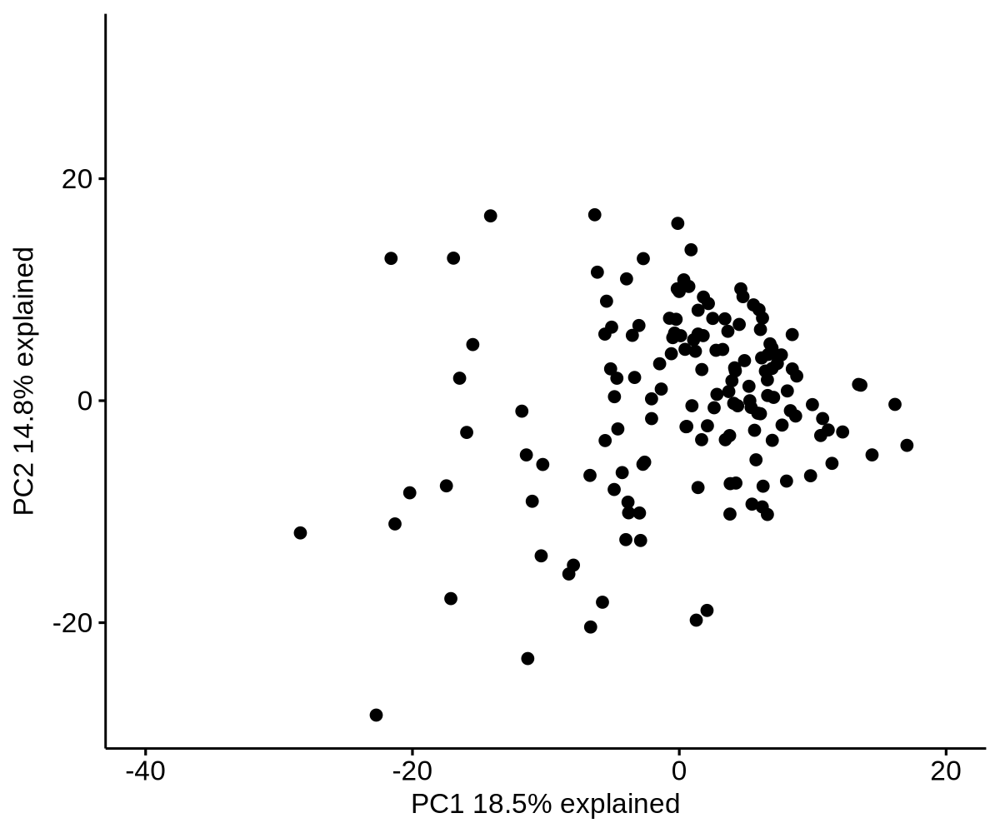

In [218]:
ntop = 500
ex = fread('tcgaAML_rawCount_151_cases_from_GDC_long_Dec30.xls')
ex_df = setDF(ex[, 2:ncol(ex)], rownames = ex$geneName)
row_sd = rowSds(ex_df)
row_sd = sort(row_sd, decreasing = T)
sel = names(row_sd[1:ntop])
mtx = ex_df[sel, ]

pc = prcomp(t(mtx), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained')
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained')
plotdat = as.data.table(pc$x, keep.rownames = T)
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2') + xlab(lblx) + ylab(lbly) + xlim(-40, 20)


In [365]:
dim(plotdat)

[1] 151 152

In [123]:
tmp = cbio_tcga_clin[PatientID %in% colnames(mtx), ]
dim(tmp)
head2(tmp)
tail2(tmp)
fwrite(tmp, file = 'tcgaAML_clinical_info_only_151_cases_from_GDC.xls', sep = '\t')


[1] 151  47

PatientID,SEX,RACE,FAB,AGE
<chr>,<chr>,<chr>,<chr>,<int>
TCGA-AB-2806,Male,WHITE,M1,46
TCGA-AB-2815,Male,WHITE,M4,49
TCGA-AB-2819,Female,WHITE,M2,52


JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
WT,WT,KRAS_mut,WT,WT,WT
WT,WT,WT,WT,WT,WT
WT,WT,WT,WT,WT,WT
WT,WT,KRAS_mut,WT,WT,WT


## load RNASeq results from cbioportal 

In [ ]:
tcga_rna = fread('data/laml_tcga_pub/data_mrna_seq_v2_rsem.txt')
tmp = tcga_rna[!duplicated(Hugo_Symbol) & !is.na(Hugo_Symbol) & Hugo_Symbol != '', ]
tcga_rna_mtx = setDF(tmp[, 3:ncol(tcga_rna)], rownames = tmp$Hugo_Symbol)

dge = DGEList(counts=tcga_rna_mtx)
dge <- calcNormFactors(dge)

dge = normLibSizes(dge)
logcpm_tcga = cpm(dge, normalize = T, log = T)

logcpm_tcga_t = as.data.table(t(logcpm_tcga), keep.rownames = T)
logcpm_tcga_t[, PatientID := substr(rn, 1, 12)]


,TCGA-AB-2803-03,TCGA-AB-2805-03,TCGA-AB-2806-03,TCGA-AB-2807-03,TCGA-AB-2808-03
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
UBE2Q2P2,0.0000,0.0000,16.3654,13.5154,28.3975
HMGB1P1,92.5926,92.6305,119.5990,178.4211,170.2042
RNU12-2P,9.2593,9.3708,4.4558,4.9652,2.3566


In [220]:
dim(logcpm_tcga_t)

[1]   173 20513

In [324]:
table(logcpm_t$batch)


BeatAML  TARGET    TCGA 
    671    1087     173 

In [82]:
length(intersect(logcpm_tcga_t$PatientID, cbio_tcga_clin$PatientID)) 

[1] 173

In [83]:
logcpm_tcga_clin = merge(logcpm_tcga_t, cbio_tcga_clin, by.x = 'PatientID', by.y = 'PatientID', all.x = T)

In [84]:
dim(logcpm_tcga_t)


[1]   173 20513

In [561]:
fwrite(logcpm_tcga_clin, file = 'logcpm_tcga_clin_Dec30.xls', sep = '\t')


In [562]:
saveRDS(logcpm_tcga_clin, file = 'logcpm_tcga_clin_Dec30.rds')

In [85]:
logcpm_tcga_clin = readRDS('logcpm_tcga_clin.rds')


In [10]:
dim(logcpm_tcga_clin)

[1]   173 20558

In [563]:
# GDC 151 cases
tmp = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/tcga_laml_RNAseq_Counts.rds')

In [564]:
tmp_col = as.data.table(tmp@colData)

In [565]:
head(tmp_col$patient)
length(tmp_col$patient)

[1] "TCGA-AB-2987" "TCGA-AB-2857" "TCGA-AB-2847" "TCGA-AB-3000" "TCGA-AB-2870" "TCGA-AB-2826"

[1] 151

In [566]:
setdiff(logcpm_tcga_clin$PatientID, tmp_col$patient) 
setdiff(tmp_col$patient, logcpm_tcga_clin$PatientID) 

[1] "TCGA-AB-2803" "TCGA-AB-2807" "TCGA-AB-2816" "TCGA-AB-2824" "TCGA-AB-2832" "TCGA-AB-2833" "TCGA-AB-2837" "TCGA-AB-2838" "TCGA-AB-2848" "TCGA-AB-2854" "TCGA-AB-2855" "TCGA-AB-2860"
[13] "TCGA-AB-2868" "TCGA-AB-2879" "TCGA-AB-2887" "TCGA-AB-2903" "TCGA-AB-2904" "TCGA-AB-2954" "TCGA-AB-2964" "TCGA-AB-2967" "TCGA-AB-2969" "TCGA-AB-2972" "TCGA-AB-2978" "TCGA-AB-2982"
[25] "TCGA-AB-2985" "TCGA-AB-2993" "TCGA-AB-3005" "TCGA-AB-3006"

[1] "TCGA-AB-2878" "TCGA-AB-2883" "TCGA-AB-2893" "TCGA-AB-2894" "TCGA-AB-2892" "TCGA-AB-2876"

In [567]:
sel = logcpm_tcga_clin[logcpm_tcga_clin$PatientID %in% tmp_col$patient, ]
dim(sel)

[1]   145 20545

In [86]:
dim(logcpm_tcga_clin)

[1]   173 20558

## gene expression correlation

In [87]:
dim(logcpm_tcga_clin)

[1]   173 20558

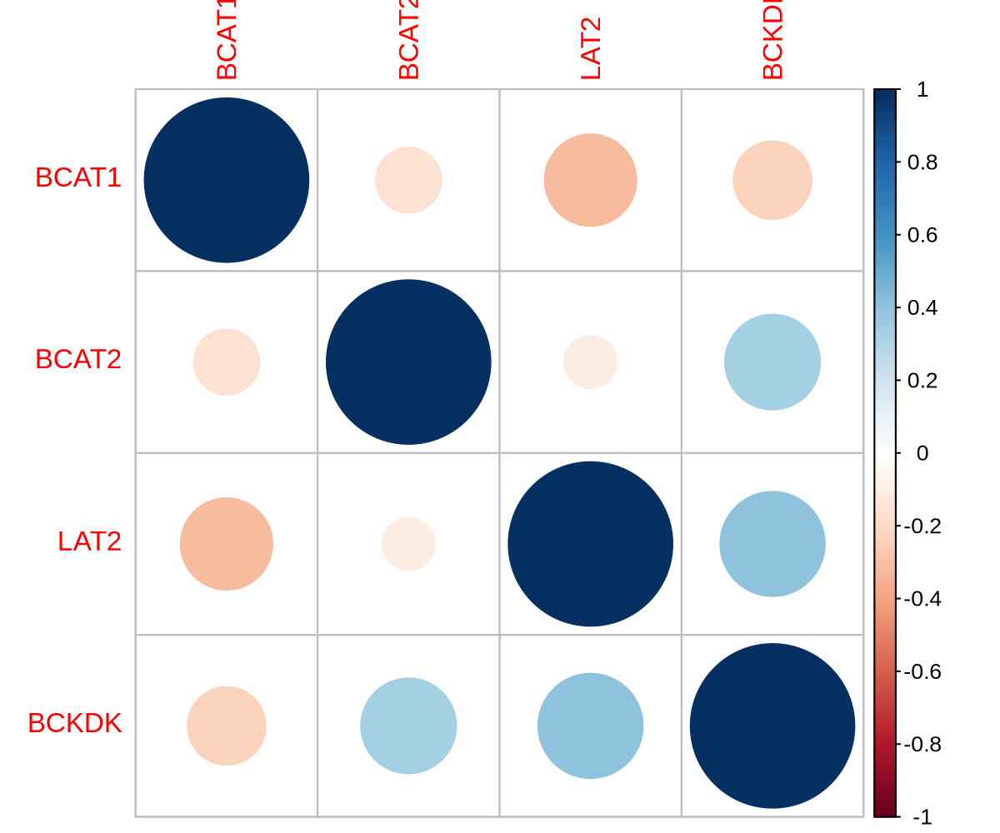

In [221]:
genes = c('BCAT1', 'BCAT2', 'SLC7A8', 'BCKDK')
genes = c('BCAT1', 'BCAT2', 'LAT2',   'BCKDK')
plotdat = logcpm_tcga_clin[, genes, with = F]
plotdat = cor(plotdat)
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)
corrplot(plotdat) # colorful number



##  correlation plot dotplot

In [89]:
library(GGally)

Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2


Attaching package: ‘GGally’


The following object is masked from ‘package:enrichplot’:

    ggtable




In [90]:
genes

[1] "BCAT1" "BCAT2" "LAT2"  "BCKDK"

Warning message:
“Removed 5 rows containing non-finite outside the scale range (`stat_smooth()`).”
Warning message:
“Removed 5 rows containing non-finite outside the scale range (`stat_cor()`).”
Warning message:
“Computation failed in `stat_cor()`.
Caused by error in `cor.test.default()`:
! not enough finite observations”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range (`geom_point()`).”
Warning message:
“Removed 13 rows containing non-finite outside the scale range (`stat_smooth()`).”
Warning message:
“Removed 13 rows containing non-finite outside the scale range (`stat_cor()`).”
Warning message:
“Removed 13 rows containing missing values or values outside the scale range (`geom_point()`).”


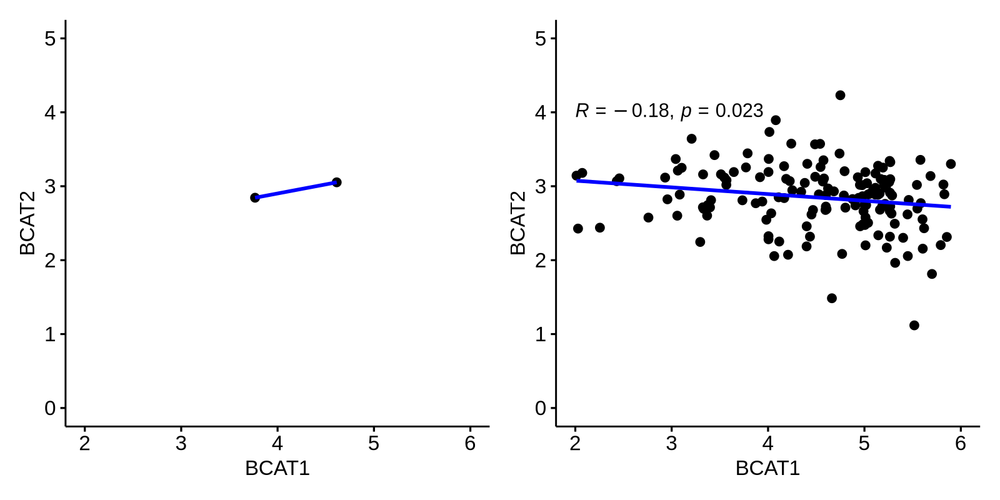

In [91]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 = ggscatter(logcpm_tcga_clin[MLL_re == 'MLL_re', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5) + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg2 = ggscatter(logcpm_tcga_clin[MLL_re == 'WT', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5)  + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg1 | gg2

In [224]:
logcpm_tcga_clin$FLT3ITD

[1] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"     
 [19] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"     
 [37] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"     
 [55] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"     
 [73] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"     
 [91] "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"     
[109] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"     
[127] "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"     
[145] "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "FLT3ITD" "WT"      "WT"      "FLT3ITD"
[163] "WT"      "WT"      "WT"      "WT"      "WT"      "WT"      "FLT3ITD" "WT"      "WT"      "WT"      "WT"

Warning message:
“Removed 18 rows containing non-finite outside the scale range (`stat_smooth()`).”
Warning message:
“Removed 18 rows containing non-finite outside the scale range (`stat_cor()`).”
Warning message:
“Removed 18 rows containing missing values or values outside the scale range (`geom_point()`).”


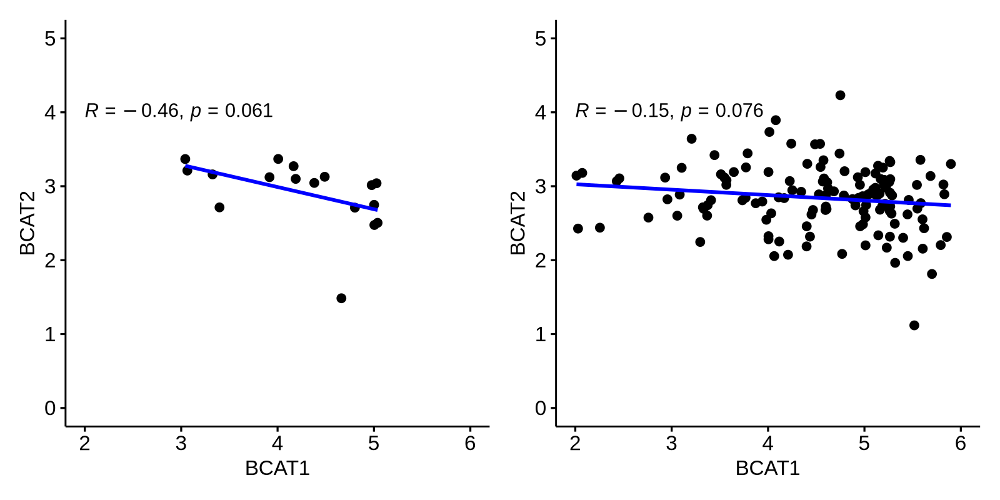

In [225]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 = ggscatter(logcpm_tcga_clin[FLT3ITD == 'FLT3ITD', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5) + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg2 = ggscatter(logcpm_tcga_clin[FLT3ITD == 'WT', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5)  + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg1 | gg2

Warning message:
“Removed 18 rows containing non-finite outside the scale range (`stat_smooth()`).”
Warning message:
“Removed 18 rows containing non-finite outside the scale range (`stat_cor()`).”
Warning message:
“Removed 18 rows containing missing values or values outside the scale range (`geom_point()`).”


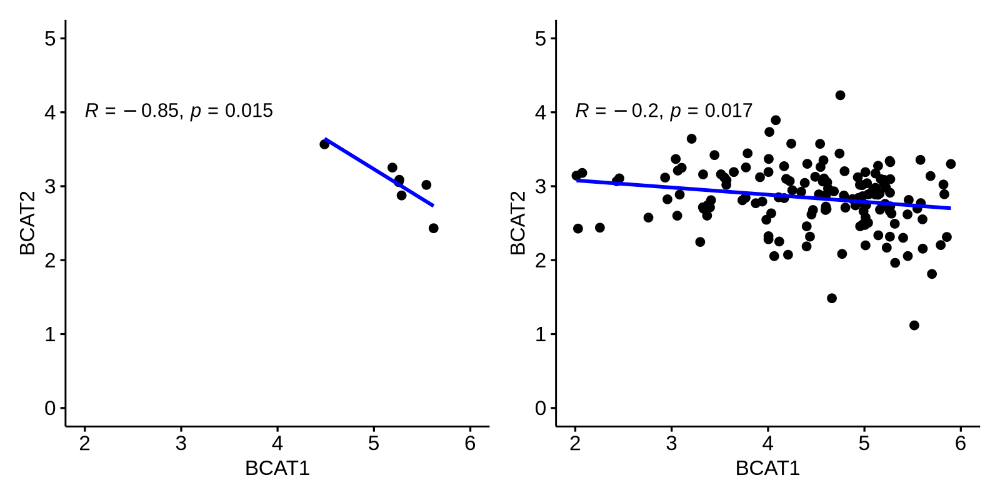

In [226]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 = ggscatter(logcpm_tcga_clin[AML1ETO == 'AML1-ETO', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5) + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg2 = ggscatter(logcpm_tcga_clin[AML1ETO == 'WT', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5)  + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg1 | gg2

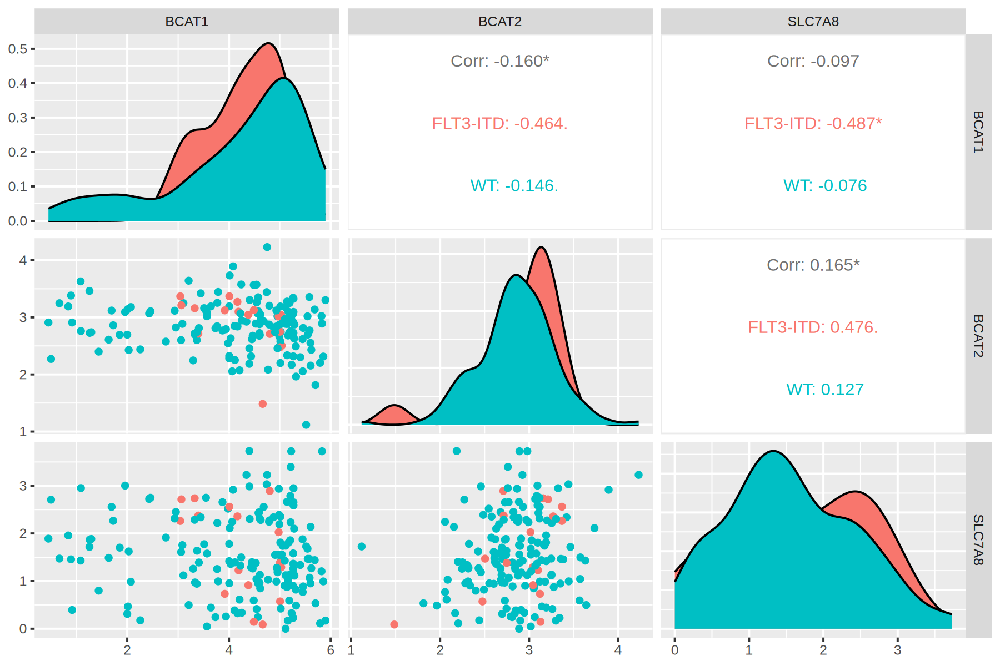

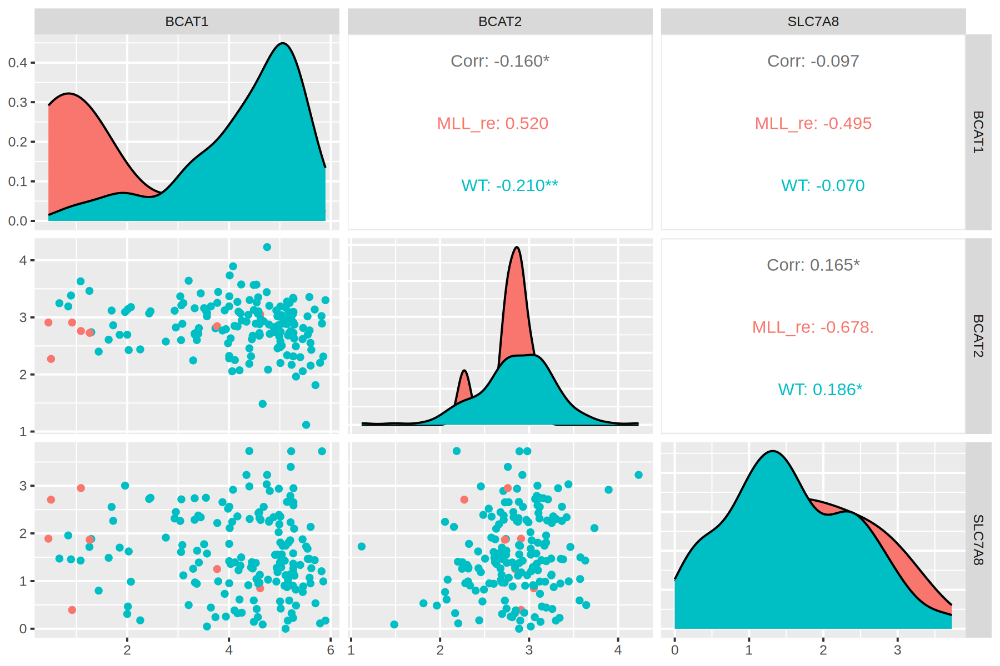

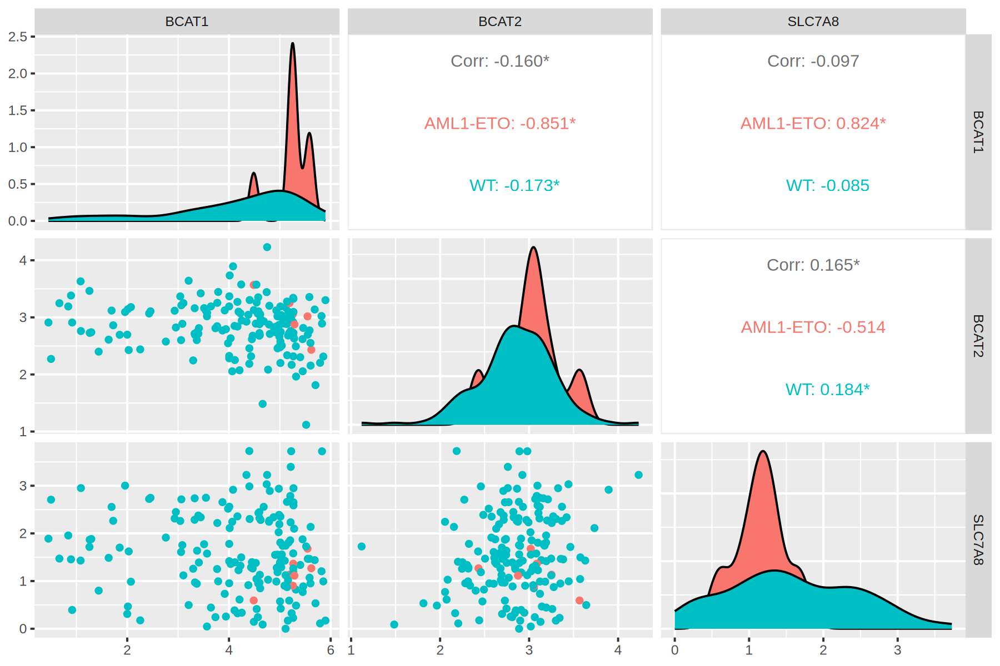

In [321]:
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = FLT3))
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = MLL_re))
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = AML1ETO))

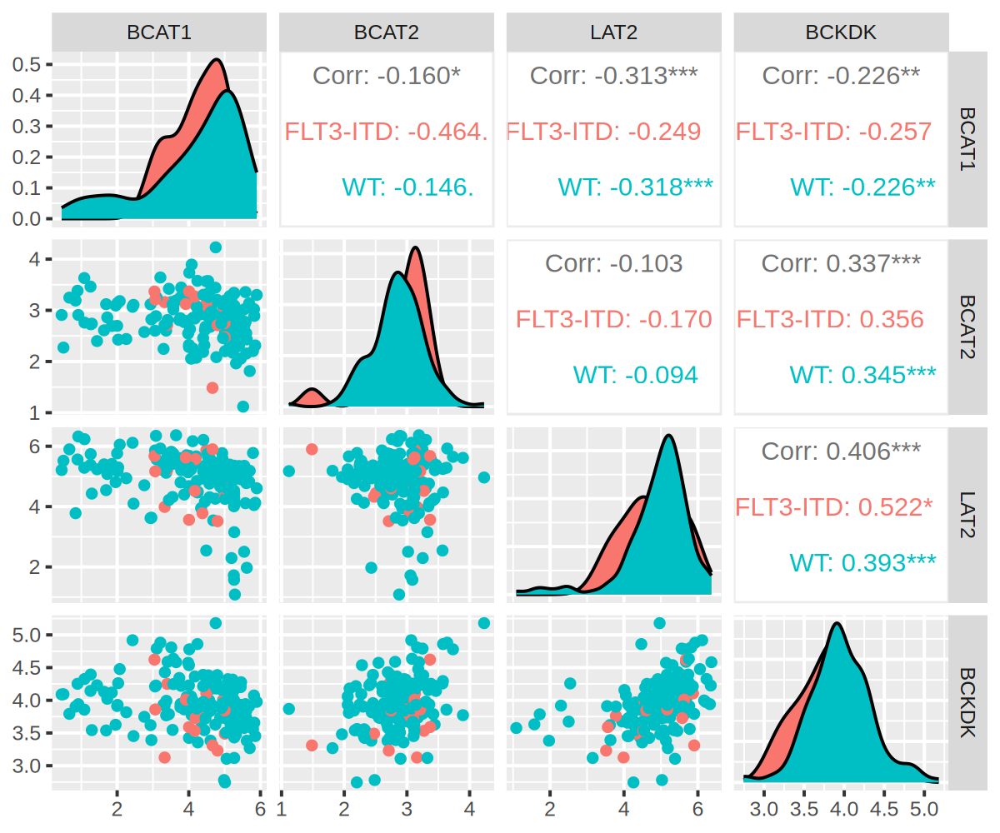

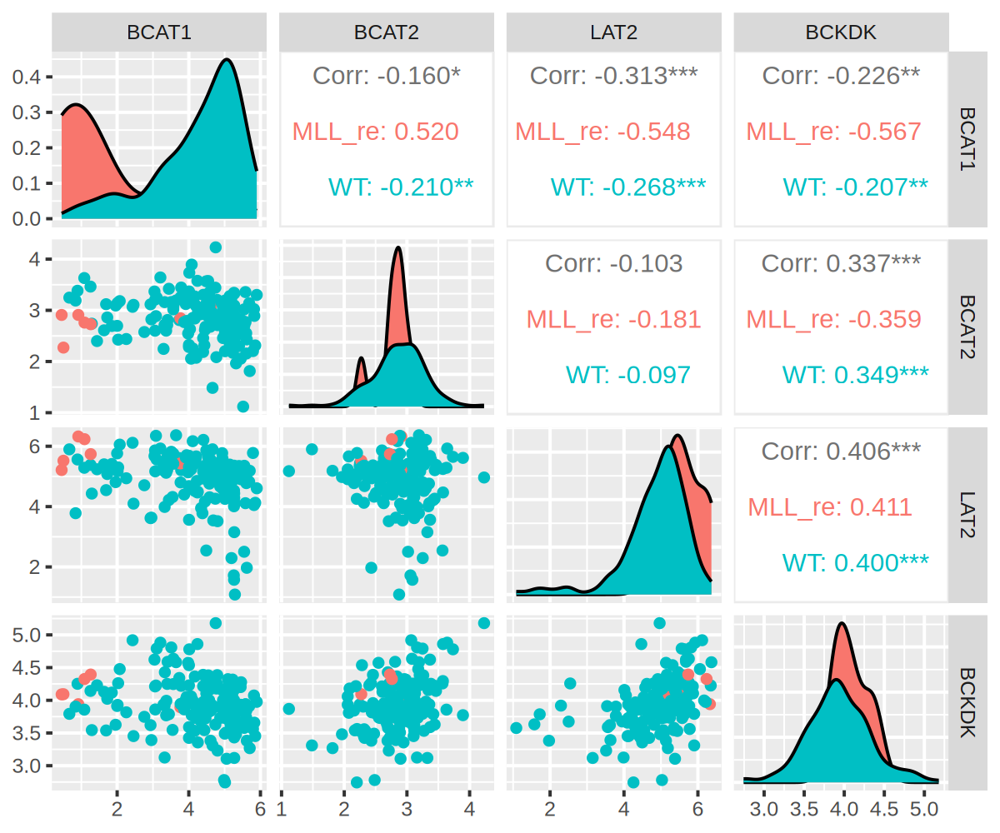

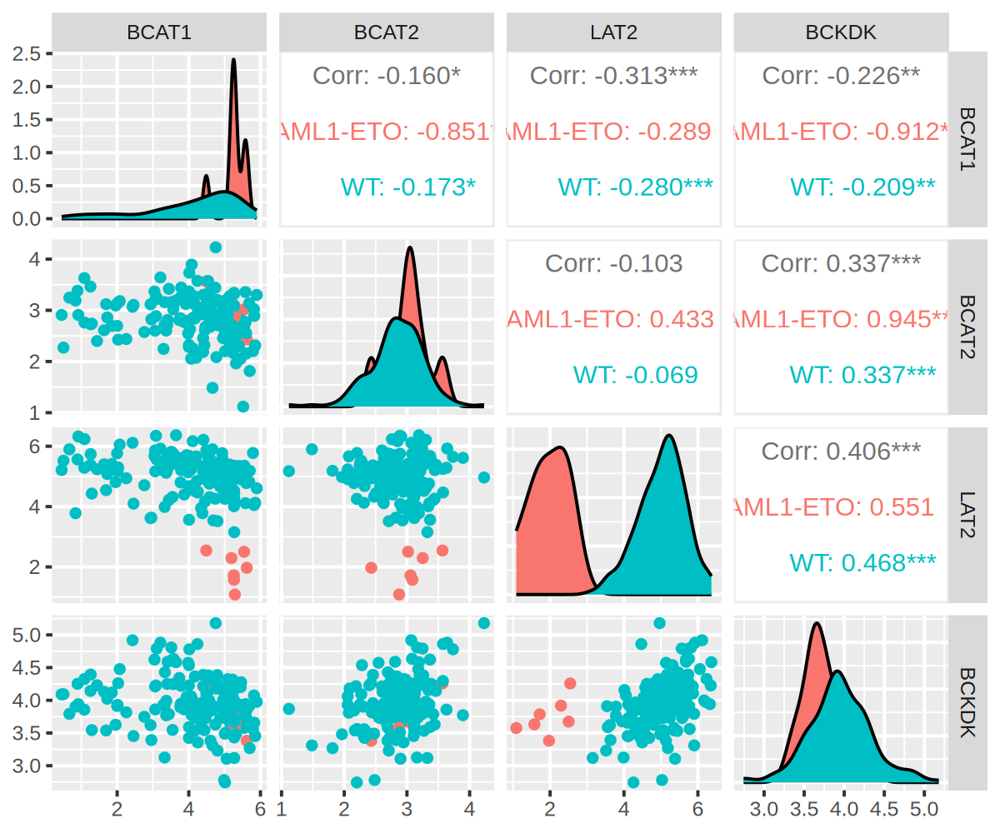

In [55]:
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = FLT3))
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = MLL_re))
ggpairs(logcpm_tcga_clin, columns = genes, aes(color = AML1ETO))

## DEG BCAT1 hi vs low

In [228]:
dsn_sel = logcpm_tcga_clin[AML1ETO == 'WT' & FLT3ITD == 'WT' & MLL_re == 'WT', .(rn, BCAT1, BCAT2)]
dsn_sel = logcpm_tcga_clin[, .(rn, BCAT1, BCAT2)]
dsn_sel$group = cut_quantile(dsn_sel$BCAT1, 4)
dsn_sel = dsn_sel[group %in% c('Q1', 'Q4'), ]
dsn_sel$group = factor(dsn_sel$group, levels = c('Q1', 'Q4'))

tcga_deg = deg_fun2(dsn_sel, tcga_rna_mtx[, dsn_sel$rn]) 

logcpm_tcga_bcat1 = logcpm_fun(tcga_rna_mtx[, dsn_sel$rn])


In [626]:
meta = fread('~/Mouse_metab_genes.txt')


In [ ]:
pathwaysDF = msigdbr(species = 'Homo sapiens')
pathways <- split(as.character(pathwaysDF$gene_symbol),  pathwaysDF$gs_name)


In [584]:
tcga_rank = ranking_fun(tcga_deg)

In [ ]:
paths = c('HALLMARK_OXIDATIVE_PHOSPHORYLATION', 'HALLMARK_MTORC1_SIGNALING', 'KEGG_APOPTOSIS', 'KEGG_CELL_CYCLE') 


In [622]:
tcga_fgsea_res = fgsea_fun(tcga_deg, if_all_pathways = T) 
tcga_fgsea_res[, UpDn := 'Dn' ]
tcga_fgsea_res[NES > 0, UpDn := 'Up' ]
tcga_fgsea_res[, UpDn := factor(UpDn, levels = c('Up', 'Dn'))]
tcga_fgsea_res[, NES2 := abs(NES) ]


Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (11.93% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


  |==================================================================================================================================================================================| 100%



Warning message in fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize, :
"For some pathways, in reality P-values are less than 1e-50. You can set the `eps` argument to zero for better estimation."


In [ ]:
tcga_fgsea_res[grepl('reac', pathway, ignore.case = T) & padj < 0.05, ][order(padj), ]

Warning message in `[.data.table`(tcga_fgsea_res, , `:=`(lbl, NULL)):
"Column 'lbl' does not exist to remove"
Warning message:
"Removed 25988 rows containing missing values (`geom_text_repel()`)."


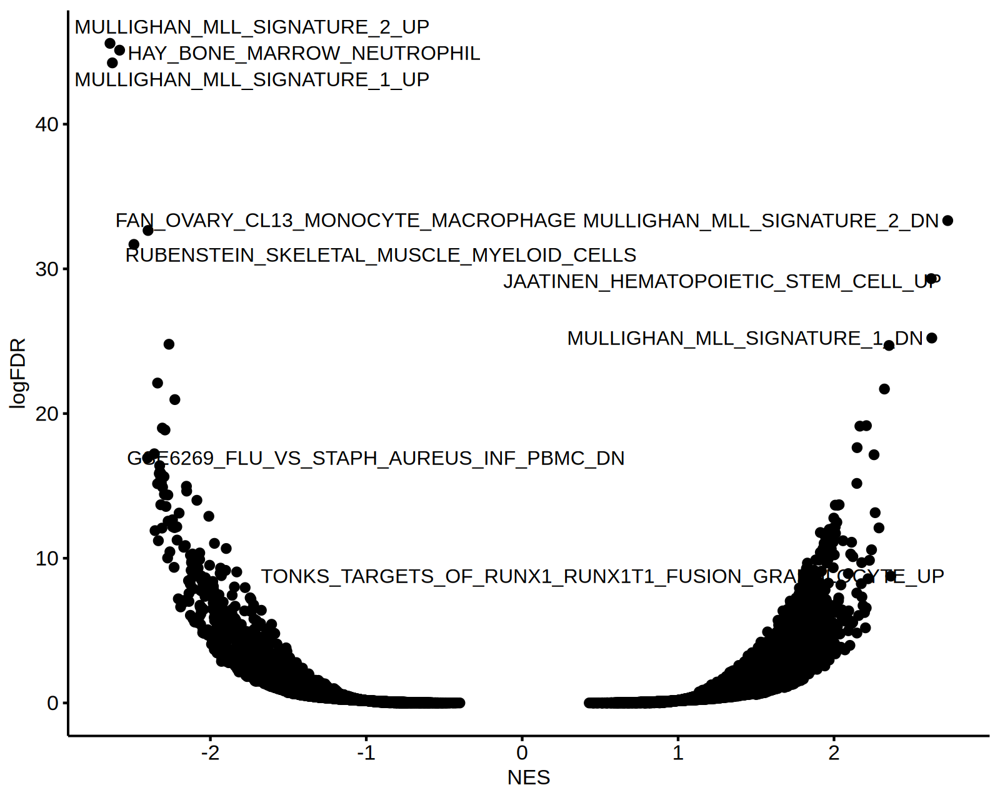

In [623]:
tcga_fgsea_res[, logFDR := -log(padj, 10) ]
tcga_fgsea_res[, lbl := NULL ]
tcga_fgsea_res = tcga_fgsea_res[order(NES, decreasing = T) ]
tcga_fgsea_res[1:4, lbl := pathway ]
tcga_fgsea_res = tcga_fgsea_res[order(NES, decreasing = F) ]
tcga_fgsea_res[1:6, lbl := pathway ]

options(repr.plot.width = 8, repr.plot.height = 6.4, repr.plot.res = 200)
ggscatter(tcga_fgsea_res, x = 'NES', y = 'logFDR', label = 'lbl', repel = T) 


In [646]:
cmd = "wget -O jaatinen_up.gmt 'https://www.gsea-msigdb.org/gsea/msigdb/human/download_geneset.jsp?geneSetName=JAATINEN_HEMATOPOIETIC_STEM_CELL_UP&fileType=gmt'"
system(cmd)
cmd = "wget -O jaatinen_dn.gmt 'https://www.gsea-msigdb.org/gsea/msigdb/human/download_geneset.jsp?geneSetName=JAATINEN_HEMATOPOIETIC_STEM_CELL_DN&fileType=gmt'"
system(cmd)

In [651]:
jaatinen_up = unlist(strsplit(readLines('jaatinen_up.gmt'), '\t'))
jaatinen_dn = unlist(strsplit(readLines('jaatinen_dn.gmt'), '\t'))
jaatinen_up = jaatinen_up[3:length(jaatinen_up)]
jaatinen_dn = jaatinen_dn[3:length(jaatinen_dn)]


Warning message in readLines("jaatinen_up.gmt"):
"incomplete final line found on 'jaatinen_up.gmt'"
Warning message in readLines("jaatinen_dn.gmt"):
"incomplete final line found on 'jaatinen_dn.gmt'"


rn,BCAT1,BCAT2,group
<chr>,<dbl>,<dbl>,<fct>
TCGA-AB-2803-03,1.9573661,3.093687,Q1
TCGA-AB-2805-03,5.2316112,2.168890,Q4
TCGA-AB-2806-03,5.6187365,2.431621,Q4
TCGA-AB-2811-03,3.5112826,3.161154,Q1
TCGA-AB-2813-03,3.3316759,2.695058,Q1
TCGA-AB-2814-03,0.6657734,3.247958,Q1


[1] 87  4

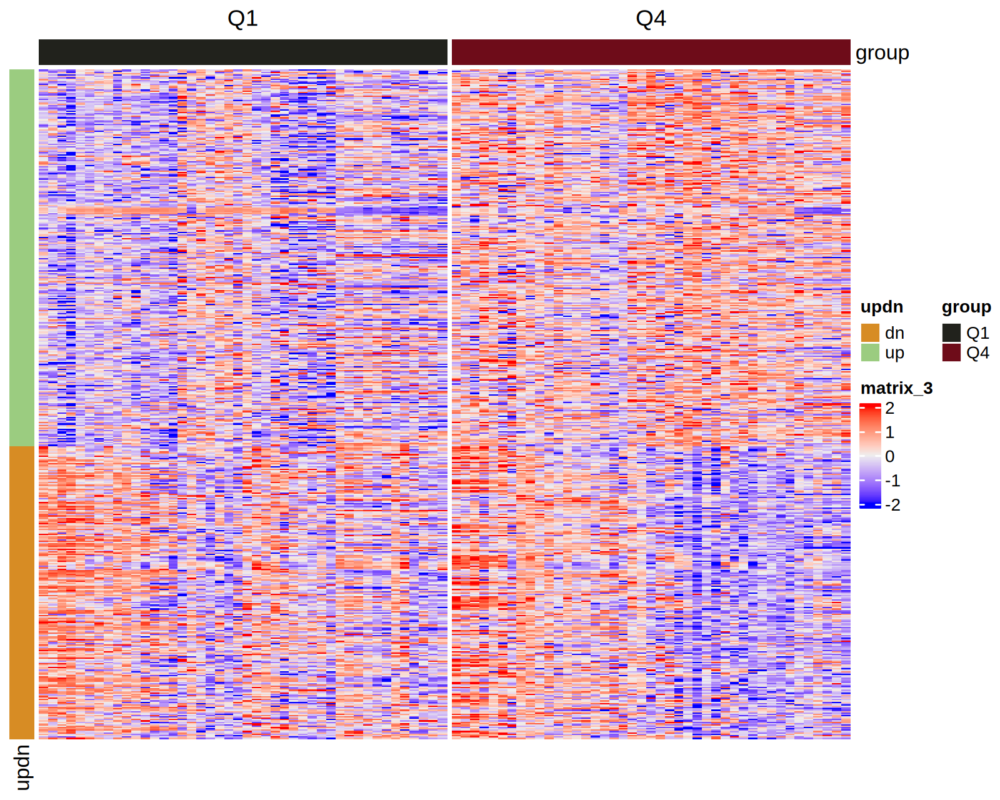

In [669]:
row_dsn = data.table(rn = c(jaatinen_up, jaatinen_dn) )
row_dsn[, updn := 'up' ]
row_dsn[rn %in% jaatinen_dn, updn := 'dn' ]
row_dsn = row_dsn[rn %in% rownames(logcpm_tcga_bcat1), ]
row_dsn_df = setDF(row_dsn, rownames = row_dsn$rn)

head(dsn_sel)
dim(dsn_sel)

plotdat = logcpm_tcga_bcat1[row_dsn$rn, dsn_sel$rn]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = dsn_sel[, "group", drop = F])
row_ha = rowAnnotation(df = row_dsn_df[, 'updn', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha, left_annotation = row_ha,
                column_split = factor(dsn_sel$group), show_column_names = F, 
                show_row_names = F, show_column_dend = F, cluster_rows = F, 
                row_names_gp = grid::gpar(fontsize = 7), show_row_dend = F)

hp = do.call(Heatmap, args)
draw(hp)



In [661]:
(tcga_logcpm_bcat1[rownames(tcga_logcpm_bcat1) %in% c(jaatinen_up, jaatinen_dn), ])

[1] 503  87

In [655]:
head(tcga_logcpm_bcat1)

,TCGA-AB-2803-03,TCGA-AB-2805-03,TCGA-AB-2806-03,TCGA-AB-2811-03,TCGA-AB-2813-03,TCGA-AB-2814-03,TCGA-AB-2817-03,TCGA-AB-2818-03,TCGA-AB-2819-03,TCGA-AB-2820-03,⋯,TCGA-AB-2985-03,TCGA-AB-2988-03,TCGA-AB-2991-03,TCGA-AB-2994-03,TCGA-AB-2995-03,TCGA-AB-2999-03,TCGA-AB-3001-03,TCGA-AB-3005-03,TCGA-AB-3011-03,TCGA-AB-3012-03
UBE2Q2P2,-3.0881429,-3.0881429,0.1354682,-0.7183232,-2.333367,2.850463,-2.134147,-0.2498189,-1.763086,-1.027994,⋯,-0.36694566,-1.851913,-0.527884,-0.6064684,1.1315409,-0.05260384,-0.03247683,-0.3808049,0.01826262,-0.3653371
HMGB1P1,2.5323601,2.6162929,2.8650752,1.1723464,1.638285,2.413659,2.719356,2.4894701,3.186433,2.204474,⋯,3.49174398,2.552072,2.507923,2.3640583,2.7168509,2.44558874,2.37672658,2.5170861,2.21979114,2.2868225
RNU12-2P,-0.5471891,-0.4619571,-1.3783845,-2.1158181,-1.311629,-1.152113,-2.134147,-0.7609640,-2.659364,-2.053919,⋯,-3.08814292,-2.619226,-2.118372,-1.7938118,-2.6919020,-1.74049365,-2.20094764,-2.5195363,-3.08814292,-2.5658270
SSX9P,-3.0881429,-3.0881429,-3.0881429,-3.0881429,-3.088143,-3.088143,-3.088143,-3.0881429,-3.088143,-3.088143,⋯,-3.08814292,-3.088143,-3.088143,-3.0881429,-3.0881429,-3.08814292,-3.08814292,-3.0881429,-3.08814292,-3.0881429
EZHIP,-1.4364221,-3.0881429,-3.0881429,-3.0881429,-3.088143,-2.598841,-3.088143,-2.6008491,-3.088143,-3.088143,⋯,-2.19232040,-2.619226,-3.088143,-3.0881429,0.7473649,-1.97795345,-3.08814292,-2.5195363,-1.48172229,-3.0881429
EFCAB8,-3.0881429,-2.2897699,-0.7047415,-0.5495753,-3.088143,-3.088143,-1.157712,-1.3179784,-3.088143,-1.725229,⋯,-0.03233313,-2.265911,-1.543629,-0.3203758,-2.1259529,0.09948021,-1.65565958,-1.1252444,-1.06402483,-0.5523763


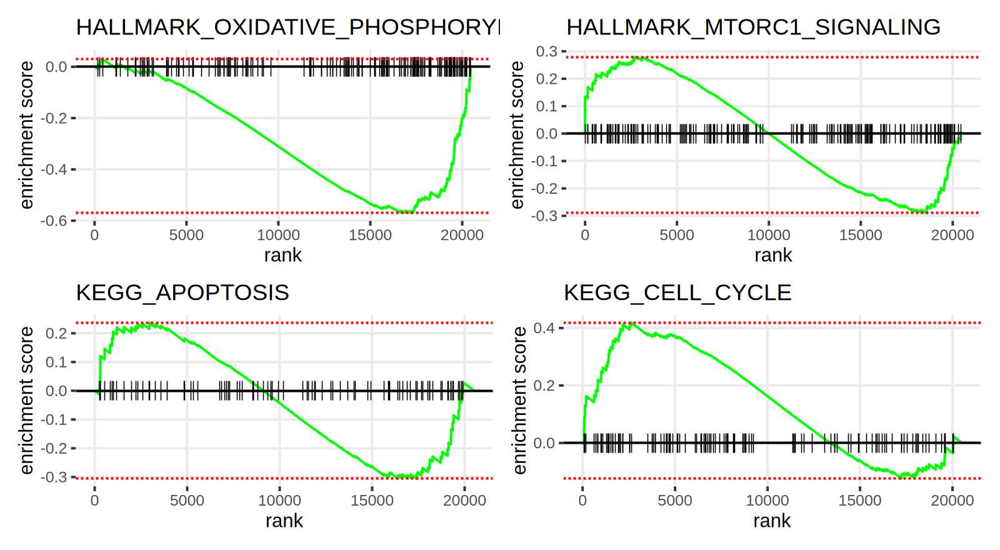

In [589]:
options(repr.plot.width = 8, repr.plot.height = 4.4, repr.plot.res = 200)
gg1 = plotEnrichment(pathways[["HALLMARK_OXIDATIVE_PHOSPHORYLATION"]], tcga_rank) + labs(title="HALLMARK_OXIDATIVE_PHOSPHORYLATION") 
gg2 = plotEnrichment(pathways[["HALLMARK_MTORC1_SIGNALING"]], tcga_rank) + labs(title="HALLMARK_MTORC1_SIGNALING")
gg3 = plotEnrichment(pathways[["KEGG_APOPTOSIS"]], tcga_rank) + labs(title="KEGG_APOPTOSIS")
gg4 = plotEnrichment(pathways[["KEGG_CELL_CYCLE"]], tcga_rank) + labs(title="KEGG_CELL_CYCLE")
(gg1 | gg2) / (gg3 | gg4)


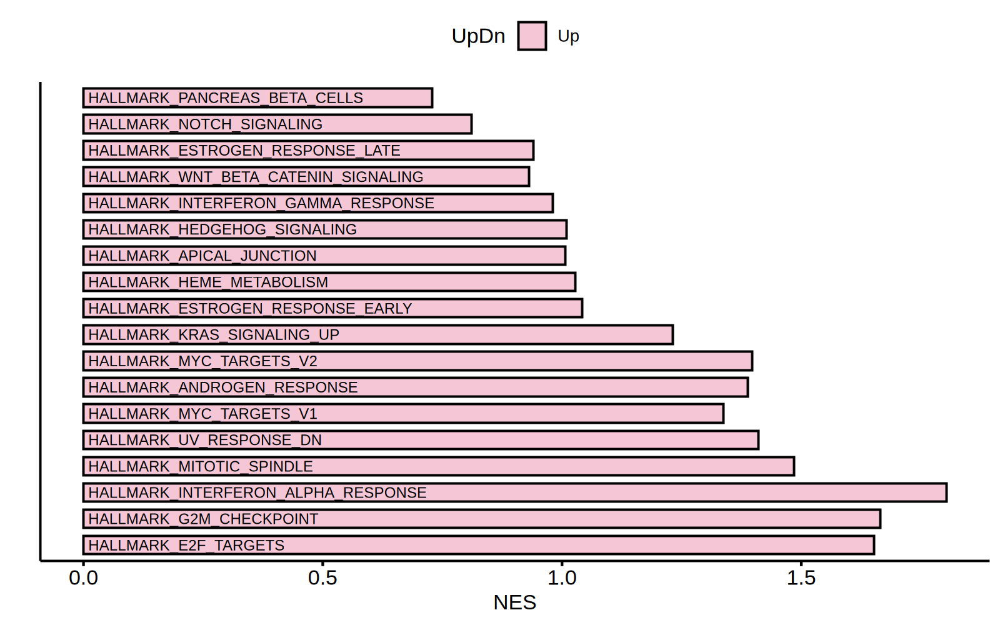

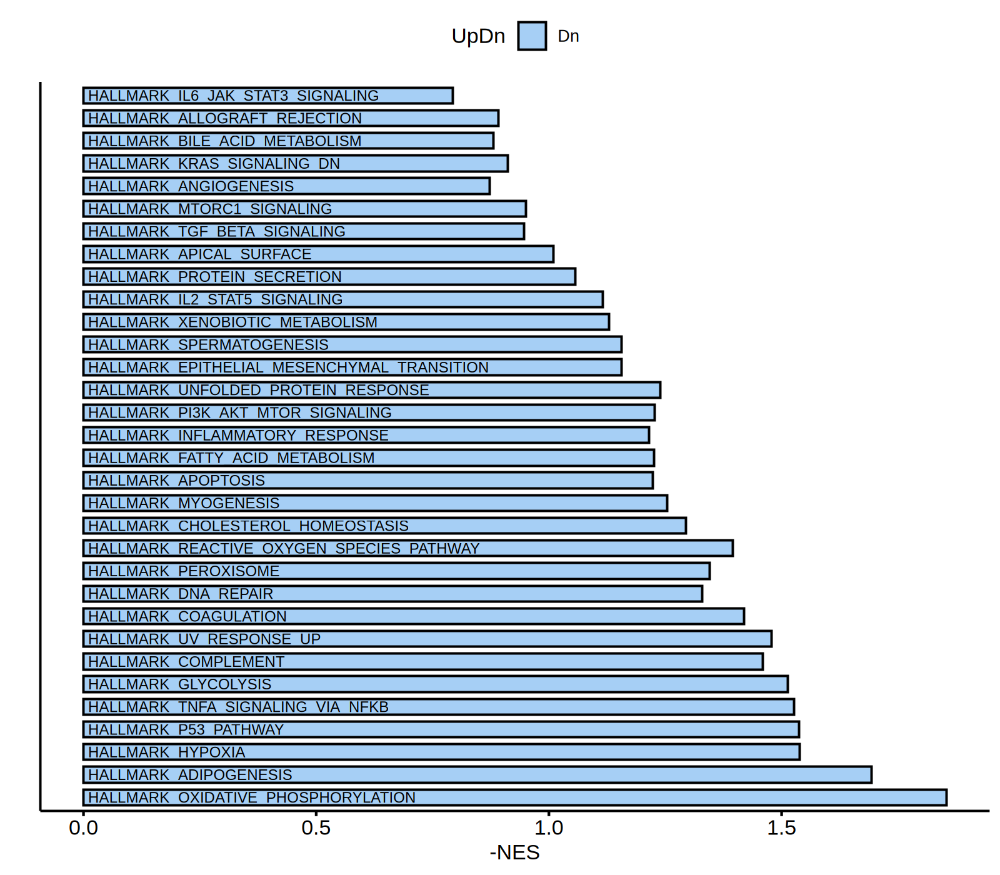

In [466]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
plotdat = fgsea_res[UpDn == 'Up', ]
plotdat[, xx := paste0('P', 1:nrow(plotdat))]
ggbarplot(plotdat, x = 'xx', y = 'NES2', fill = 'UpDn') + theme(axis.ticks.y = element_blank(), axis.text.y = element_blank()) + 
ylab('NES') + xlab('') + geom_text(data = plotdat, aes(x = xx, y = 0.01, label = pathway), inherit.aes = F, hjust = 0, size = 3) + coord_flip() +
scale_fill_manual(values = c("#f5c6d6")) 

options(repr.plot.width = 8, repr.plot.height = 7, repr.plot.res = 200) 
plotdat = fgsea_res[UpDn == 'Dn', ]
plotdat[, xx := paste0('P', 1:nrow(plotdat))]
ggbarplot(plotdat, x = 'xx', y = 'NES2', fill = 'UpDn') + theme(axis.ticks.y = element_blank(), axis.text.y = element_blank()) + 
ylab('-NES') + xlab('') + geom_text(data = plotdat, aes(x = xx, y = 0.01, label = pathway), inherit.aes = F, hjust = 0, size = 3) + coord_flip() +
scale_fill_manual(values = c("#a6cff5"))

In [393]:
dim(fgsea_res)

[1] 50  8

## gene expression by molecular subtypes

In [73]:
logcpm_tcga_clin[, FLT3 := FLT3.y]
logcpm_tcga_clin[FLT3.y == 'FLT3_Mut', FLT3 := 'WT']

In [231]:
vnames = genes
cnames = c('FLT3ITD', 'MLL_re', 'AML1ETO')
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep

[1] "BCAT1" "BCAT1" "BCAT1" "BCAT2" "BCAT2" "BCAT2" "LAT2"  "LAT2"  "LAT2"  "BCKDK" "BCKDK" "BCKDK"

[1] "FLT3ITD" "MLL_re"  "AML1ETO" "FLT3ITD" "MLL_re"  "AML1ETO" "FLT3ITD" "MLL_re"  "AML1ETO" "FLT3ITD" "MLL_re"  "AML1ETO"

In [232]:
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname)) %>% 
    mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
    t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
    stat.test <- stat.test %>% add_xy_position(x = cname)
    gg1 = ggboxplot(logcpm_tcga_clin, x = cname, y = vname, outlier.shape = NA, add = 'jitter', color = cname, width = .5) + 
    stat_pvalue_manual(stat.test, label = "p") + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = 1))
    gg1
})

[[1]]
NULL


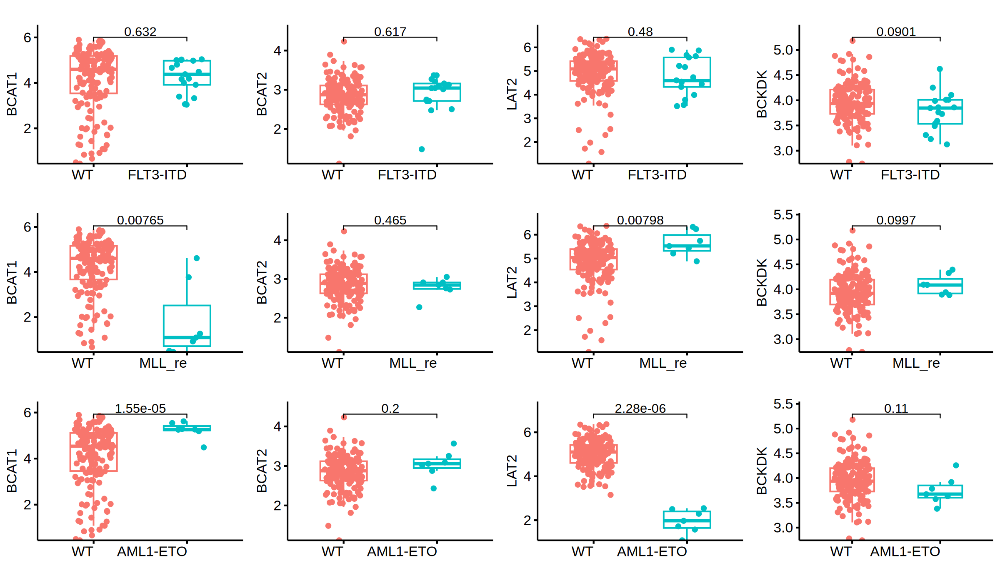

In [67]:
options(repr.plot.width = 12, repr.plot.height = 7, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 4, nrow = 3, top = '')

Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT1,WT,FLT3ITD,156,17,-0.4830638,30.89106,0.632,ns,6.00008,WT,1,2
BCAT1,WT,FLT3ITD,156,17,-0.4830638,30.89106,0.632,ns,6.00008,FLT3ITD,1,2


Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT1,WT,MLL_re,166,7,3.865017,6.26175,0.00765,**,6.05096,WT,1,2
BCAT1,WT,MLL_re,166,7,3.865017,6.26175,0.00765,**,6.05096,MLL_re,1,2


Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT1,WT,AML1-ETO,166,7,-6.411103,14.14304,1.55e-05,****,5.93036,WT,1,2
BCAT1,WT,AML1-ETO,166,7,-6.411103,14.14304,1.55e-05,****,5.93036,AML1-ETO,1,2


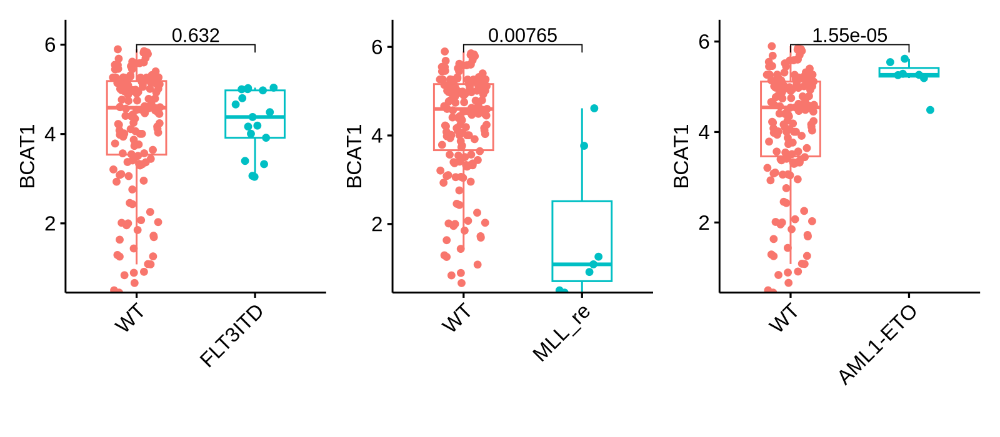

In [233]:
vname = 'BCAT1'
cname1 = 'FLT3ITD'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)
stat.test

gg1 = ggboxplot(logcpm_tcga_clin, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MLL_re'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)
stat.test

gg2 = ggboxplot(logcpm_tcga_clin, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)
stat.test

gg3 = ggboxplot(logcpm_tcga_clin, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT2,WT,FLT3-ITD,156,17,-0.5085112,19.12056,0.617,ns,4.33444,"WT, FLT3-ITD",1,2


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT2,WT,MLL_re,166,7,0.7698758,7.622557,0.465,ns,4.37236,"WT, MLL_re",1,2


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
BCAT2,WT,AML1-ETO,166,7,-1.420559,6.800243,0.2,ns,4.31068,"WT, AML1-ETO",1,2


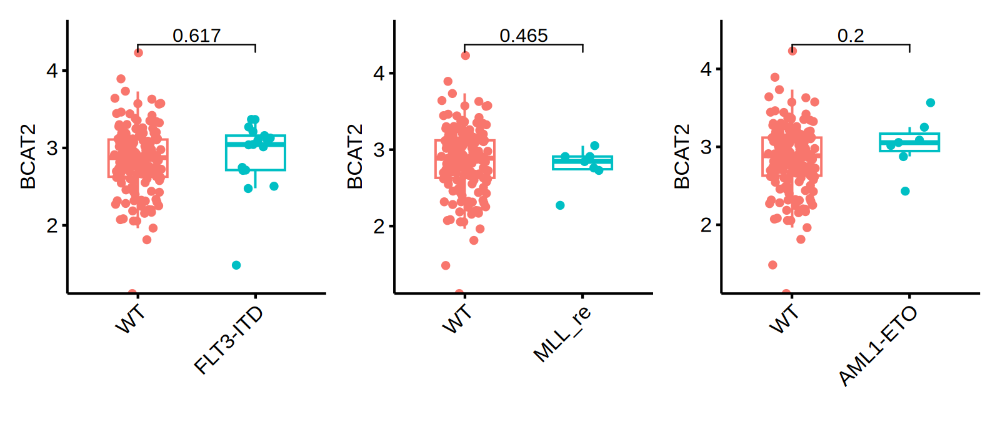

In [496]:
vname = 'BCAT2'
cname1 = 'FLT3'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)
stat.test

gg1 = ggboxplot(logcpm_tcga_clin, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MLL_re'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)
stat.test

gg2 = ggboxplot(logcpm_tcga_clin, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)
stat.test

gg3 = ggboxplot(logcpm_tcga_clin, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
SLC7A8,WT,FLT3-ITD,156,17,-0.2752334,19.11543,0.786,ns,3.82956,"WT, FLT3-ITD",1,2


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
SLC7A8,WT,MLL_re,166,7,-0.3701185,6.439493,0.723,ns,3.82236,"WT, MLL_re",1,2


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
SLC7A8,WT,AML1-ETO,166,7,2.993956,9.709588,0.0139,*,3.97488,"WT, AML1-ETO",1,2


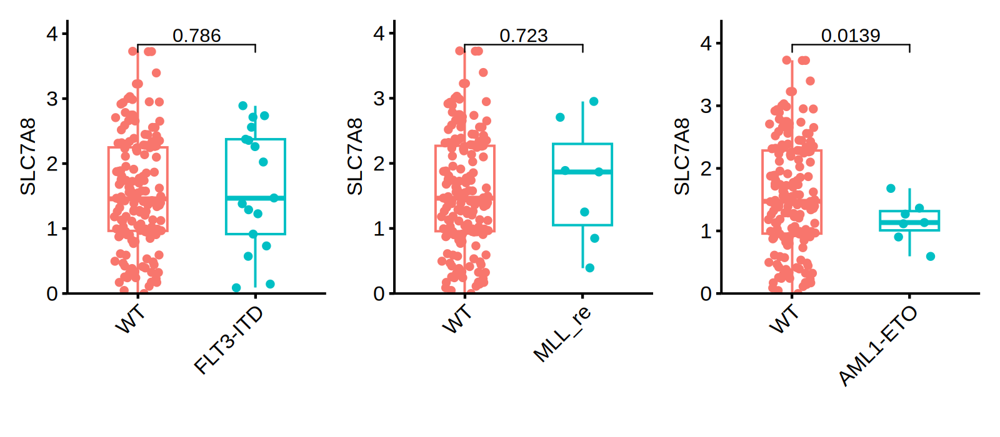

In [497]:
vname = 'SLC7A8'
cname1 = 'FLT3'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)
stat.test

gg1 = ggboxplot(logcpm_tcga_clin, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MLL_re'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)
stat.test

gg2 = ggboxplot(logcpm_tcga_clin, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)
stat.test

gg3 = ggboxplot(logcpm_tcga_clin, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
DDX41,WT,FLT3ITD,156,17,0.4766588,20.44467,0.639,ns,5.65572,WT,1,2
DDX41,WT,FLT3ITD,156,17,0.4766588,20.44467,0.639,ns,5.65572,FLT3ITD,1,2


Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
DDX41,WT,MLL_re,166,7,-0.9222019,6.531729,0.389,ns,5.646,WT,1,2
DDX41,WT,MLL_re,166,7,-0.9222019,6.531729,0.389,ns,5.646,MLL_re,1,2


Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”
Warning message in data.frame(..., check.names = FALSE):
“row names were found from a short variable and have been discarded”


.y.,group1,group2,n1,n2,statistic,df,p,p.signif,y.position,groups,xmin,xmax
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<named list>,<dbl>,<dbl>
DDX41,WT,AML1-ETO,166,7,-1.533683,7.875649,0.164,ns,5.67456,WT,1,2
DDX41,WT,AML1-ETO,166,7,-1.533683,7.875649,0.164,ns,5.67456,AML1-ETO,1,2


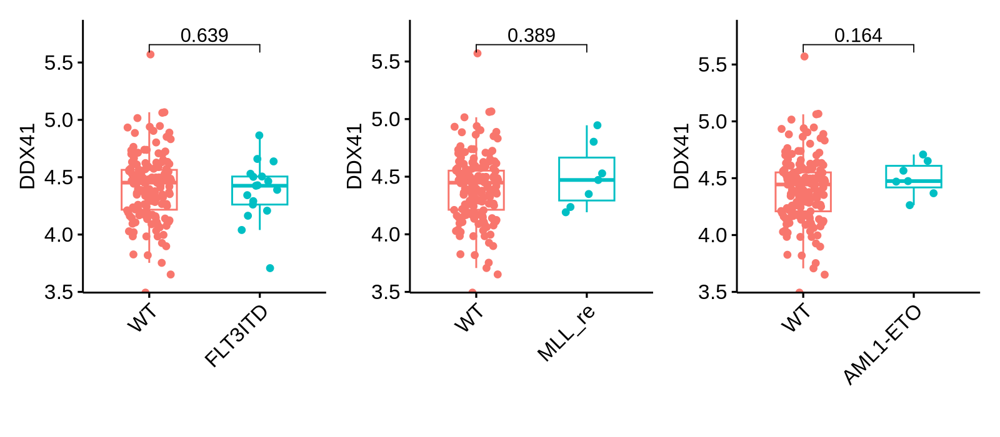

In [235]:
vname = 'DDX41'
cname1 = 'FLT3ITD'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)
stat.test

gg1 = ggboxplot(logcpm_tcga_clin, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MLL_re'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)
stat.test

gg2 = ggboxplot(logcpm_tcga_clin, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)
stat.test

gg3 = ggboxplot(logcpm_tcga_clin, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


## bcl2 expression

In [535]:
head(logcpm_tcga_clin)

PatientID,rn,UBE2Q2P2,HMGB1P1,RNU12-2P,SSX9P,EZHIP,EFCAB8,SRP14P1,TRIM75P,⋯,TP53_mut,PPM1D_mut,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TCGA-AB-2803,TCGA-AB-2803-03,0.0000000,1.911115,0.4549309,0,0.2279527,0.0000000,0.1204576,0.06204148,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
TCGA-AB-2805,TCGA-AB-2805-03,0.0000000,1.935057,0.4695882,0,0.0000000,0.0821515,0.2621087,0.19395980,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
TCGA-AB-2806,TCGA-AB-2806-03,0.6835446,2.100268,0.2367037,0,0.0000000,0.4027785,0.2663680,0.29517759,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
TCGA-AB-2807,TCGA-AB-2807-03,0.5559990,2.381173,0.2415406,0,0.0000000,0.0000000,0.3626543,0.10371543,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
TCGA-AB-2808,TCGA-AB-2808-03,1.0070439,2.434834,0.1346954,0,0.0000000,0.1346954,0.2900118,0.13469541,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
TCGA-AB-2810,TCGA-AB-2810-03,0.4398636,2.338965,0.1503647,0,0.0000000,0.0000000,0.8667678,0.00000000,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT


In [536]:
logcpm_tcga_clin$FLT3

NULL

In [568]:
vname = 'BCL2'
cname1 = 'FLT3ITD'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)
stat.test

gg1 = ggboxplot(logcpm_tcga_clin, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MLL_re'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)
stat.test

gg2 = ggboxplot(logcpm_tcga_clin, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)
stat.test

gg3 = ggboxplot(logcpm_tcga_clin, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname4 = 'NPM1_mut'
stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname4)) %>% 
  mutate(across(!!sym(cname4), factor)) %>% mutate(across(!!sym(cname4), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname4))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname4)
stat.test

gg4 = ggboxplot(logcpm_tcga_clin, x = cname4, y = vname, outlier.shape = NA, add = 'jitter', color = cname4, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3 + gg4


ERROR: [1m[33mError[39m in `select()`:[22m
[33m![39m Can't select columns that don't exist.
[31m✖[39m Column `FLT3ITD` doesn't exist.


## survival analysis 

In [ ]:
xx = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/tcgaAML_logcpm_clin_151_cases_from_GDC_wide.xls')

In [1]:
xx[, OS_STATUS := as.numeric(substr(OS_STATUS, 1, 1))]

ERROR: Error: object 'xx' not found


In [ ]:
head(xx[, .(OS_STATUS, OS_MONTHS)])

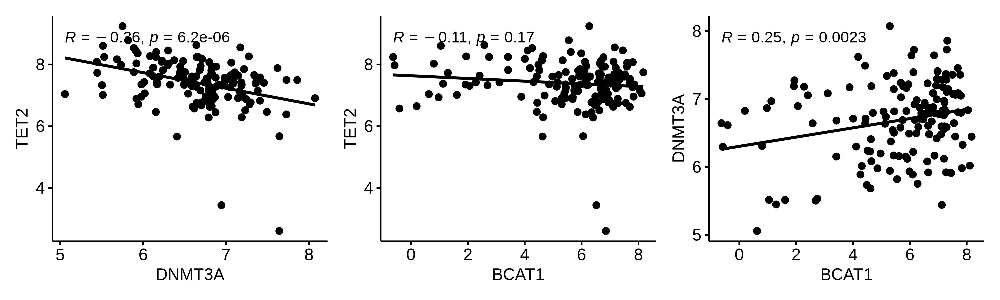

In [517]:
options(repr.plot.res = 300, repr.plot.height = 3, repr.plot.width = 10)
ggscatter(xx, 'DNMT3A', 'TET2', add = 'reg.line', cor.coef = T) | 
ggscatter(xx, 'BCAT1', 'TET2', add = 'reg.line', cor.coef = T) | 
ggscatter(xx, 'BCAT1', 'DNMT3A', add = 'reg.line', cor.coef = T)

In [530]:
options(rgl.useNULL = TRUE) 
options(rgl.printRglwidget = TRUE)

In [533]:
library(rgl)
plot3d(xx$BCAT1, xx$DNMT3A, xx$TET2, col = "blue", size = 1, type = "s", xlab = "BCAT1", ylab = "DNMT3A", zlab = "TET2")
rglwidget() 


HTML widgets cannot be represented in plain text (need html)

In [527]:
table(xx$DNMT3A_mut, xx$TET2_mut)

            
             TET2_mut  WT
  DNMT3A_mut        1   7
  WT                0 143

In [519]:
aml_mut = intersect(aml_mut, colnames(xx))
aml_mut = aml_mut[unlist(lapply(aml_mut, function(ii){length(table(unlist(xx[, ii, with = F]))) > 1}))]

In [523]:
#coxph(Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + BCAT2 + TET2_mut + DNMT3A_mut + SF3B1_mut + TP53_mut + PPM1D_mut + ASXL1_mut + NRAS_mut + JAK2_mut + GNB1_mut + KRAS_mut + CBL_mut + IDH1_mut + IDH2_mut + MLL_re + FLT3ITD + AML1ETO + PMLRARA + CBFBMYH11, plotdat) 
#coxph(Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + BCAT2 +  JAK2_mut + GNB1_mut + KRAS_mut + CBL_mut + IDH1_mut + IDH2_mut + MLL_re + FLT3ITD + AML1ETO + PMLRARA + CBFBMYH11, plotdat) 
plotdat = xx[, c('BCAT1', 'BCAT2', 'DNMT3A', 'TET2', aml_mut, 'OS_STATUS', 'OS_MONTHS'), with =F ]
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + BCAT2 + DNMT3A + TET2 +', paste(aml_mut, collapse = ' + '))), plotdat) 
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + + DNMT3A + TET2 +', paste(aml_mut, collapse = ' + '))), plotdat) 
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + BCAT1+ DNMT3A + TET2')), plotdat) 
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT1+ DNMT3A + TET2')), plotdat) 


Warning message in coxph.fit(X, Y, istrat, offset, init, control, weights = weights, :
“Loglik converged before variable  12 ; coefficient may be infinite. ”


Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + BCAT2 + DNMT3A + TET2 +", 
    paste(aml_mut, collapse = " + "))), data = plotdat)

                   coef  exp(coef)   se(coef)      z      p
BCAT1         1.631e-01  1.177e+00  7.560e-02  2.157 0.0310
BCAT2         3.615e-01  1.435e+00  1.848e-01  1.956 0.0505
DNMT3A       -5.491e-01  5.775e-01  2.371e-01 -2.316 0.0205
TET2         -1.946e-01  8.231e-01  1.094e-01 -1.779 0.0752
TET2_mutWT   -2.136e+00  1.181e-01  1.605e+00 -1.331 0.1830
DNMT3A_mutWT  2.083e+00  8.027e+00  1.360e+00  1.531 0.1257
TP53_mutWT   -3.791e-03  9.962e-01  4.395e-01 -0.009 0.9931
ASXL1_mutWT  -8.389e-03  9.916e-01  5.358e-01 -0.016 0.9875
NRAS_mutWT   -9.725e-04  9.990e-01  1.046e+00 -0.001 0.9993
GNB1_mutWT   -3.072e+00  4.631e-02  1.573e+00 -1.953 0.0508
KRAS_mutWT   -4.290e-01  6.511e-01  4.888e-01 -0.878 0.3801
CBL_mutWT     1.539e+01  4.828e+06  2.166e+03  0.007 0.9943
IDH1_mutWT   -8.216e-01  4.397e-01  1.466e+00 -0.560 0.575

Warning message in coxph.fit(X, Y, istrat, offset, init, control, weights = weights, :
“Loglik converged before variable  11 ; coefficient may be infinite. ”


Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + + DNMT3A + TET2 +", 
    paste(aml_mut, collapse = " + "))), data = plotdat)

                   coef  exp(coef)   se(coef)      z      p
BCAT2         2.541e-01  1.289e+00  1.789e-01  1.420 0.1556
DNMT3A       -4.718e-01  6.239e-01  2.273e-01 -2.076 0.0379
TET2         -2.286e-01  7.956e-01  1.055e-01 -2.168 0.0302
TET2_mutWT   -1.439e+00  2.371e-01  1.577e+00 -0.913 0.3614
DNMT3A_mutWT  2.187e+00  8.905e+00  1.333e+00  1.640 0.1009
TP53_mutWT   -1.130e-01  8.932e-01  4.380e-01 -0.258 0.7964
ASXL1_mutWT  -2.307e-02  9.772e-01  5.342e-01 -0.043 0.9656
NRAS_mutWT   -3.132e-02  9.692e-01  1.043e+00 -0.030 0.9760
GNB1_mutWT   -3.118e+00  4.426e-02  1.565e+00 -1.992 0.0463
KRAS_mutWT   -5.365e-01  5.848e-01  4.885e-01 -1.098 0.2721
CBL_mutWT     1.540e+01  4.895e+06  2.154e+03  0.007 0.9943
IDH1_mutWT   -8.854e-01  4.125e-01  1.447e+00 -0.612 0.5406
IDH2_mutWT    1.276e+00  3.582e+00  1.178e+00  1.084 0.2786
MLL_

Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + BCAT1+ DNMT3A + TET2")), 
    data = plotdat)

           coef exp(coef) se(coef)      z        p
BCAT2   0.33616   1.39957  0.17799  1.889   0.0589
BCAT1   0.15391   1.16639  0.06214  2.477   0.0133
DNMT3A -0.86891   0.41941  0.21661 -4.011 6.04e-05
TET2   -0.25156   0.77759  0.11120 -2.262   0.0237

Likelihood ratio test=21.67  on 4 df, p=0.0002335
n= 151, number of events= 97 

Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT1+ DNMT3A + TET2")), 
    data = plotdat)

          coef exp(coef) se(coef)      z        p
BCAT1   0.1166    1.1236   0.0578  2.017 0.043724
DNMT3A -0.7834    0.4569   0.2132 -3.674 0.000239
TET2   -0.2683    0.7647   0.1039 -2.582 0.009815

Likelihood ratio test=18.11  on 3 df, p=0.0004172
n= 151, number of events= 97 

In [183]:
gg_list = lapply(aml_mut, function(ii){
    plotdat = xx[, c('BCAT1', 'BCAT2', aml_mut, 'OS_STATUS', 'OS_MONTHS'), with =F ]
    ggboxplot(plotdat, y = 'BCAT1', x = ii, add = 'jitter', outlier.shape = NA) + stat_compare_means(method = "t.test")
})
gg = gridExtra::marrangeGrob(gg_list, nrow = 3, ncol = 5)

Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `t.test.default()`:
! not enough 'x' observations”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `t.test.default()`:
! not enough 'x' observations”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `t.test.default()`:
! not enough 'x' observations”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `t.test.default()`:
! not enough 'x' observations”


[[1]]
NULL


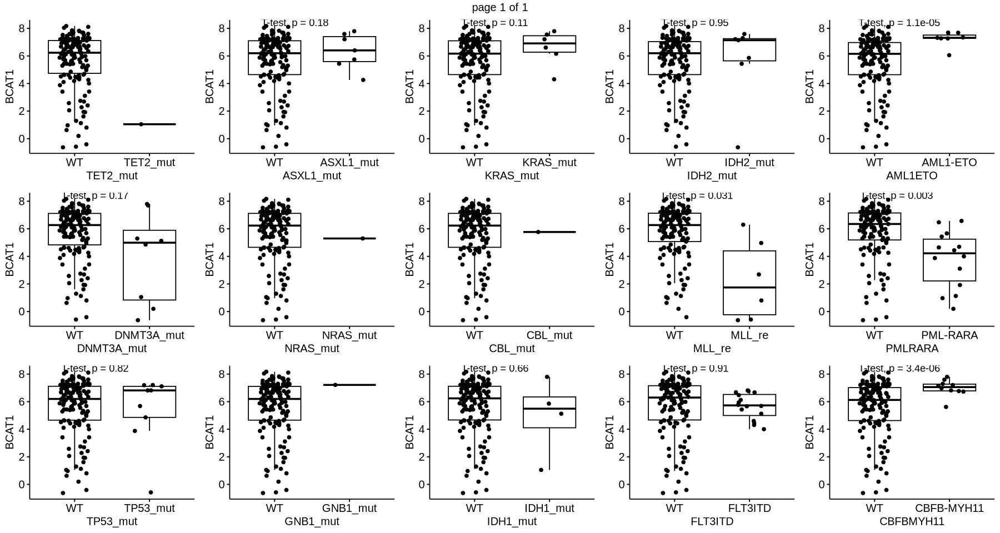

In [184]:
options(repr.plot.width = 15, repr.plot.height = 8, repr.plo.res = 300)
gg


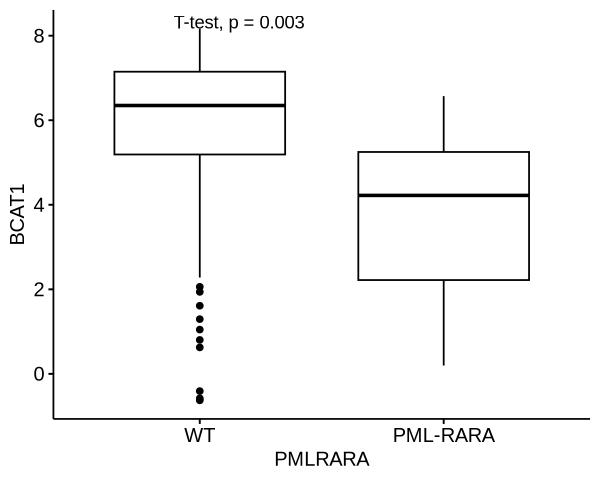

In [163]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggboxplot(plotdat, y = 'BCAT1', x = 'PMLRARA') + stat_compare_means(method = "t.test")


In [573]:
aml_mut = intersect(aml_mut, colnames(xx))

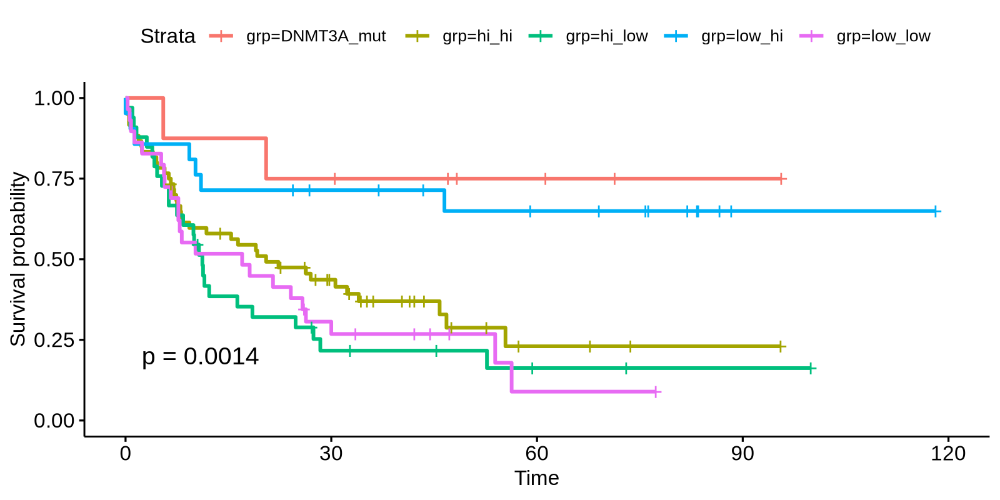

In [581]:
plotdat = xx[, c('BCAT1', 'DNMT3A', aml_mut,'OS_STATUS', 'OS_MONTHS'), with =F ] 
#plotdat = plotdat[DNMT3A_mut == 'WT', ]
#plotdat = plotdat[TET2_mut == 'WT', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[, dnmt_lvl := 'low' ]
plotdat[DNMT3A > mean(plotdat$DNMT3A, na.rm = T), dnmt_lvl := 'hi' ]
plotdat[, grp := paste0(bcat1_lvl, '_', dnmt_lvl)]
plotdat[DNMT3A_mut != 'WT', grp := 'DNMT3A_mut']
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ grp, data = plotdat)
options(repr.plot.width = 8, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr() )      # Change ggplot2 theme
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels



In [30]:
head2(xx)

ERROR: Error in h(simpleError(msg, call)): error in evaluating the argument 'x' in selecting a method for function 'head': object 'xx' not found


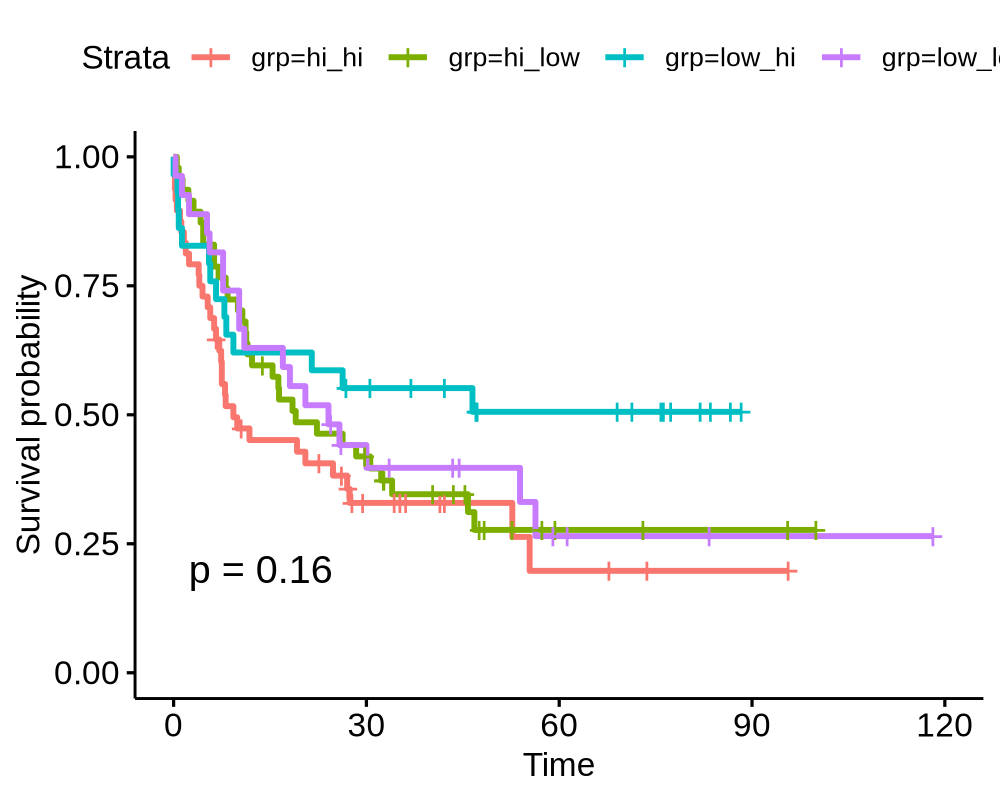

In [605]:
plotdat = xx[, c('BCAT1', 'BCAT2', 'DNMT3A', aml_mut,'OS_STATUS', 'OS_MONTHS'), with =F ] 
#plotdat = plotdat[TET2_mut == 'WT', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[, bcat2_lvl := 'low' ]
plotdat[BCAT2 > mean(plotdat$BCAT2, na.rm = T), bcat2_lvl := 'hi' ]
plotdat[, grp := paste0(bcat1_lvl, '_', bcat2_lvl)]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ grp, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr() )      # Change ggplot2 theme
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels



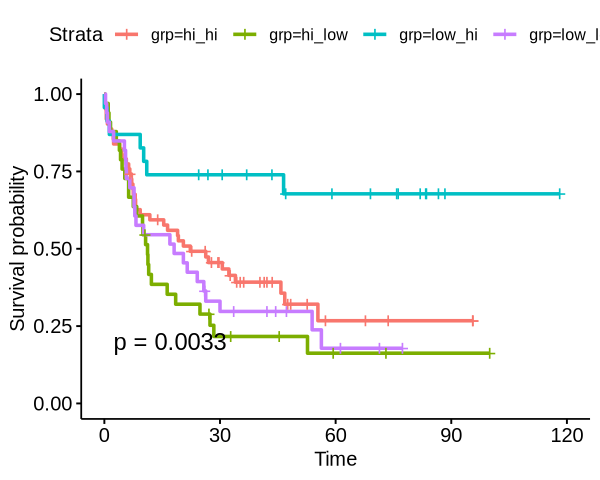

In [507]:
plotdat = xx[, c('BCAT1', 'BCAT2', 'DNMT3A', aml_mut,'OS_STATUS', 'OS_MONTHS'), with =F ] 
#plotdat = plotdat[TET2_mut == 'WT', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[, dnmt_lvl := 'low' ]
plotdat[DNMT3A > mean(plotdat$DNMT3A, na.rm = T), dnmt_lvl := 'hi' ]
plotdat[, grp := paste0(bcat1_lvl, '_', dnmt_lvl)]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ grp, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr() )      # Change ggplot2 theme
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels



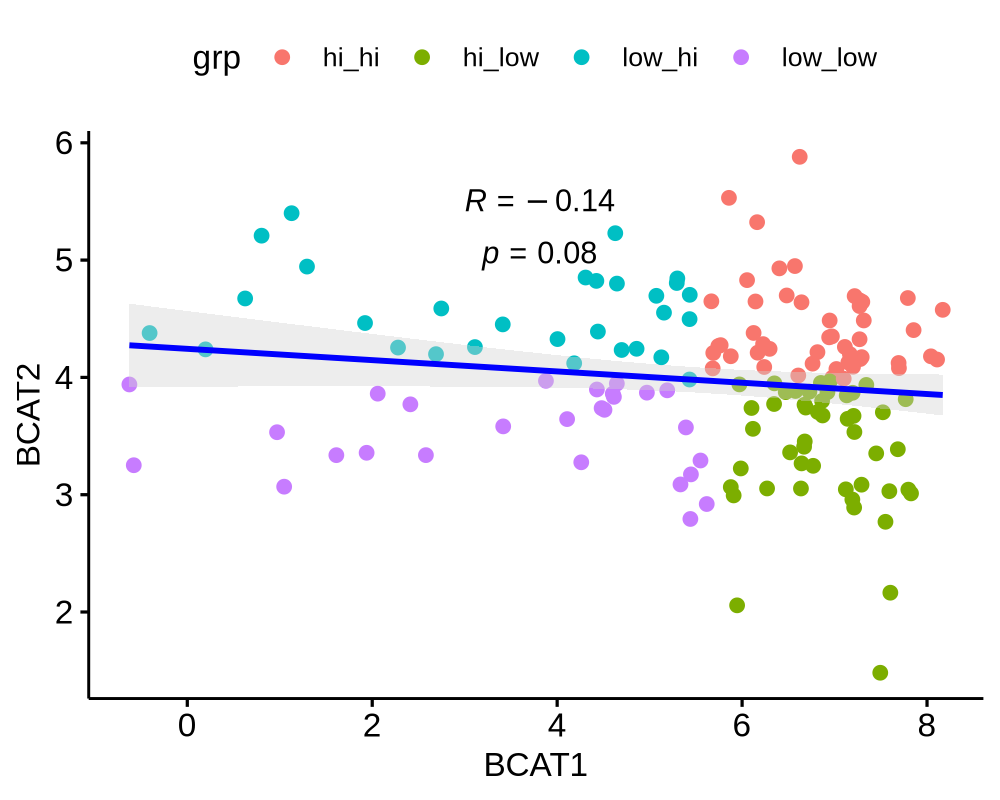

In [607]:
#plotdat = xx[DNMT3A_mut == 'WT', ]
#plotdat = copy(xx)
#dim(plotdat)
ggscatter(plotdat, x = 'BCAT1', y = 'BCAT2', col = 'grp', 
          add = "reg.line",  # Add regressin line
          add.params = list(color = "blue", fill = "lightgray"), # Customize reg. line
          conf.int = TRUE, # Add confidence interval
          cor.coef = TRUE, # Add correlation coefficient. see ?stat_cor
          cor.coeff.args = list(method = "pearson", label.x = 3, label.sep = "\n"))


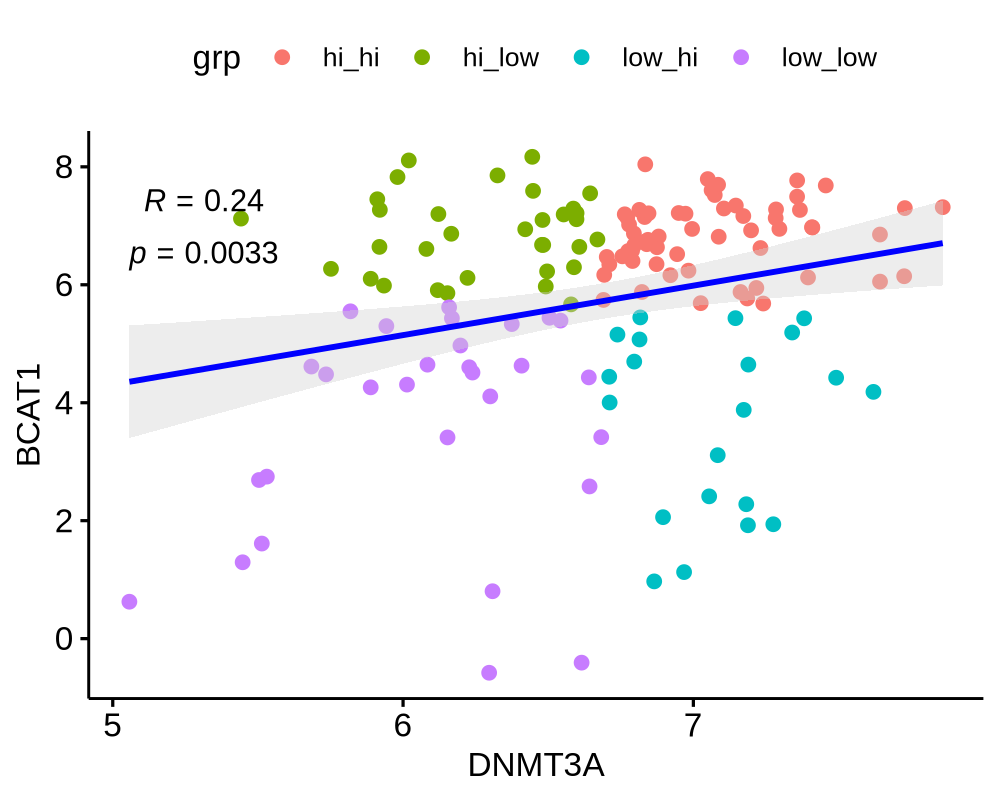

In [611]:
plotdat = xx[DNMT3A_mut == 'WT', ]
ggscatter(plotdat, x = 'DNMT3A', y = 'BCAT1', col = 'grp', 
          add = "reg.line",  # Add regressin line
          add.params = list(color = "blue", fill = "lightgray"), # Customize reg. line
          conf.int = TRUE, # Add confidence interval
          cor.coef = TRUE, # Add correlation coefficient. see ?stat_cor
          cor.coeff.args = list(method = "pearson", label.sep = "\n"))


In [599]:
aml_mut

[1] "TET2_mut"   "DNMT3A_mut" "SF3B1_mut"  "TP53_mut"   "PPM1D_mut"  "ASXL1_mut"  "NRAS_mut"   "JAK2_mut"   "GNB1_mut"   "KRAS_mut"   "CBL_mut"    "IDH1_mut"   "IDH2_mut"   "MLL_re"    
[15] "FLT3ITD"    "AML1ETO"    "PMLRARA"    "CBFBMYH11"

In [600]:
table(xx$karyotype)


Altered  Normal 
     87      64 

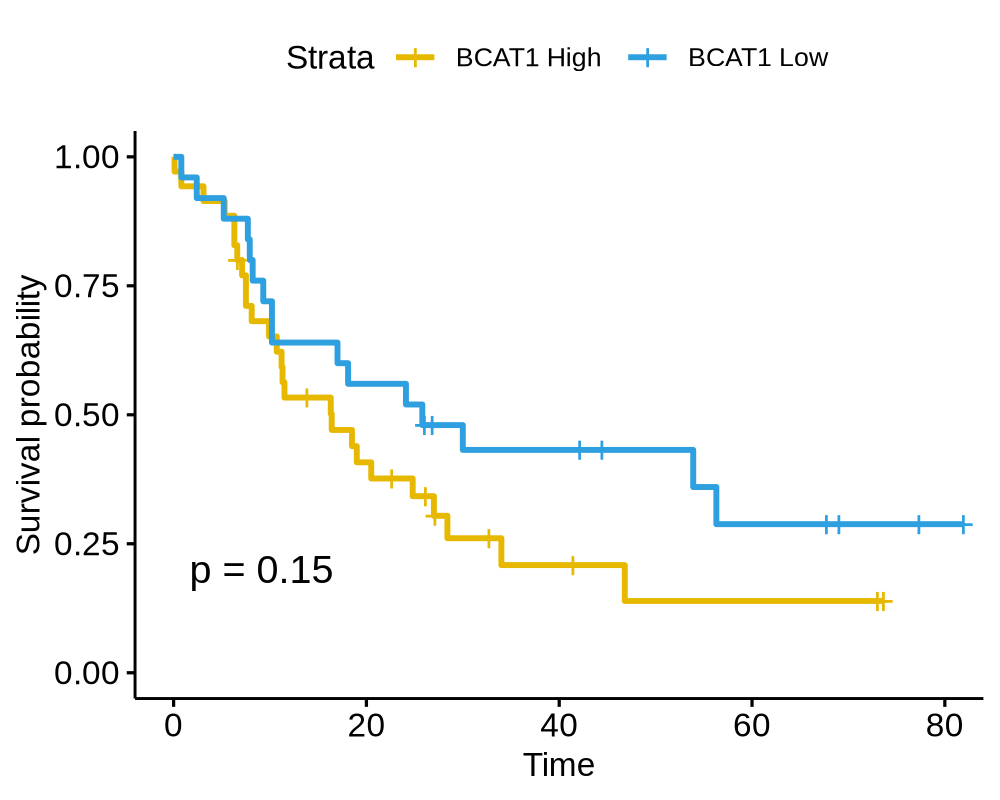

In [602]:
plotdat = xx[TET2_mut == 'WT' & DNMT3A_mut == 'WT' & karyotype == 'Normal', ]
plotdat = plotdat[, c('BCAT1', 'BCAT2', aml_mut, 'OS_STATUS', 'OS_MONTHS'), with =F ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme



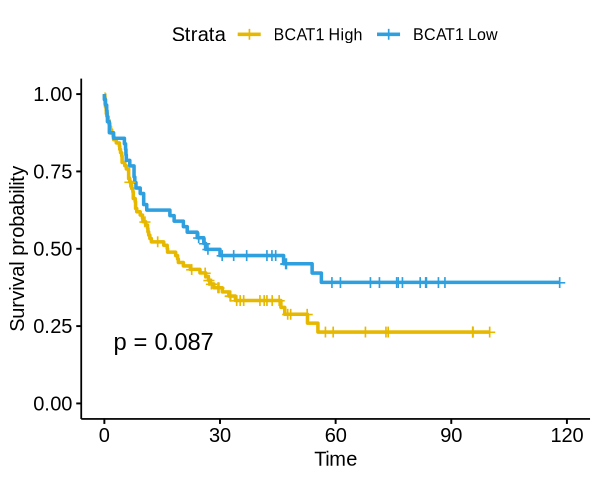

In [391]:
plotdat = xx[, c('BCAT1', 'BCAT2', aml_mut, 'OS_STATUS', 'OS_MONTHS'), with =F ]
#plotdat = plotdat[TET2_mut == 'WT', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme



In [596]:
mean(xx$BCAT1)

[1] 5.62813

In [595]:
dim(xx)

[1]   151 59477

In [26]:
library(survival)


Attaching package: ‘survival’


The following object is masked from ‘package:survminer’:

    myeloma




In [68]:
dim(logcpm_tcga_clin)

[1]   173 20558

In [187]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
fname = paste0('~/WenhuoHu/workspace/bcat1/tcga_surv.pdf')
pdf(file = fname, width = 5, height = 4) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme
dev.off()


pdf 
  2

[1]   173 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

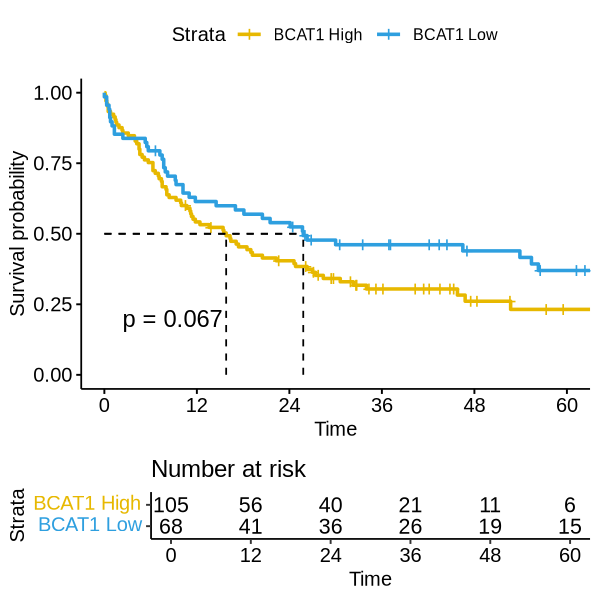

In [471]:
plotdat = logcpm_t[grep('TCGA', rn), ]
dim(plotdat)
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_tcga.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


In [616]:
plotdat = logcpm_t[grep('TCGA', rn), ]
table(plotdat$TET2_mut)



TET2_mut       WT 
       1      172 

[1]    14 17640

Warning message in .add_surv_median(p, fit, type = surv.median.line, fun = fun, :
“Median survival not reached.”
Warning message in .add_surv_median(p, fit, type = surv.median.line, fun = fun, :
“Median survival not reached.”


pdf 
  2

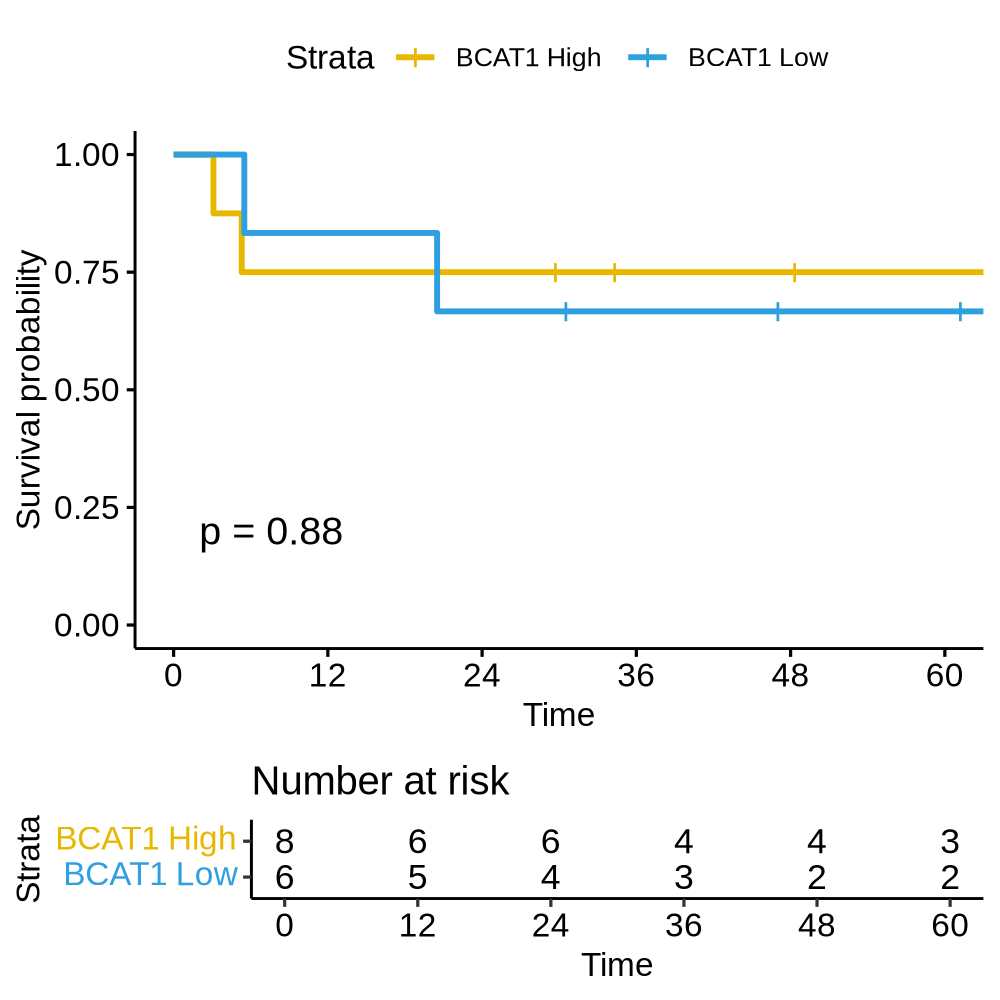

In [619]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat = plotdat[TET2_mut == 'TET2_mut' | IDH1_mut == 'IDH1_mut' | IDH2_mut == 'IDH2_mut' | DNMT3A_mut == 'DNMT3A_mut', ]
dim(plotdat)
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme

pdf(file = '~/plot/tcga_bcat1_mut_surv.pdf', width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1]   159 17640

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

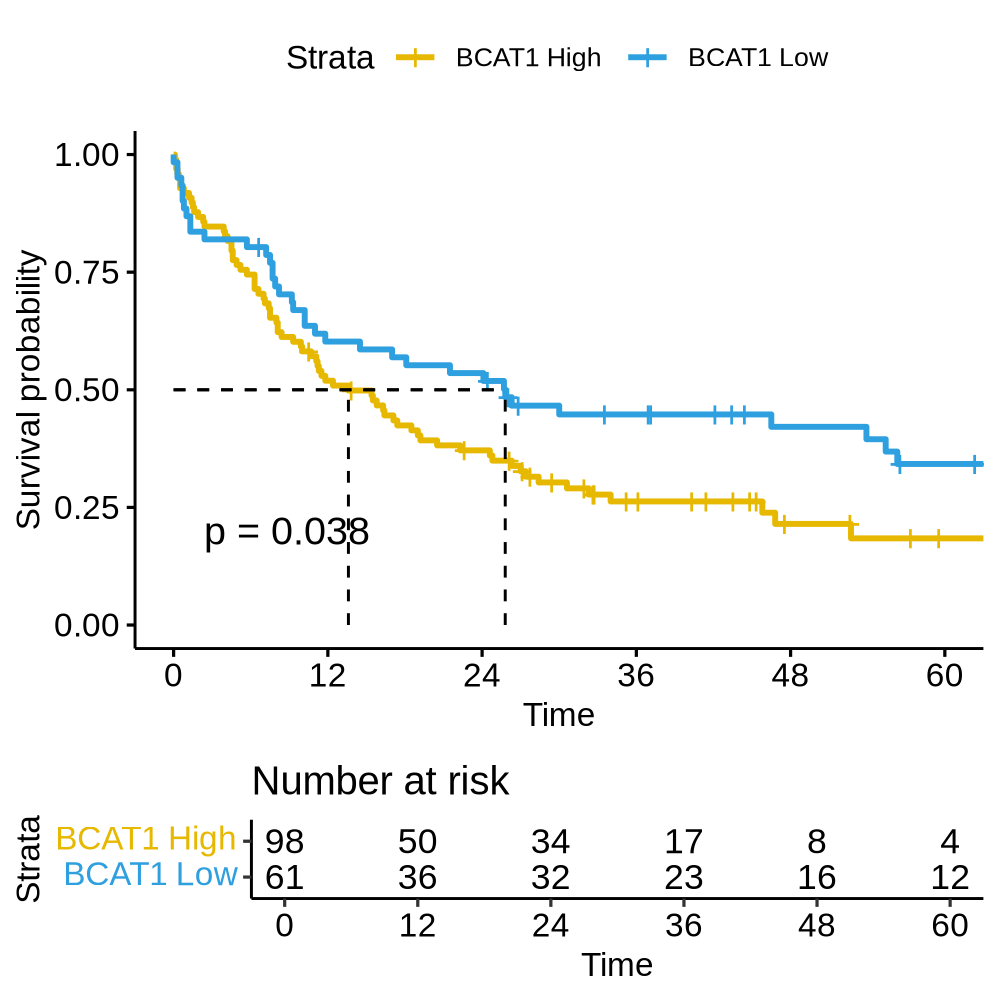

In [615]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat = plotdat[TET2_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT' & DNMT3A_mut == 'WT', ]
dim(plotdat)
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme

pdf(file = '~/plot/tcga_bcat1_surv.pdf', width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1]   163 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

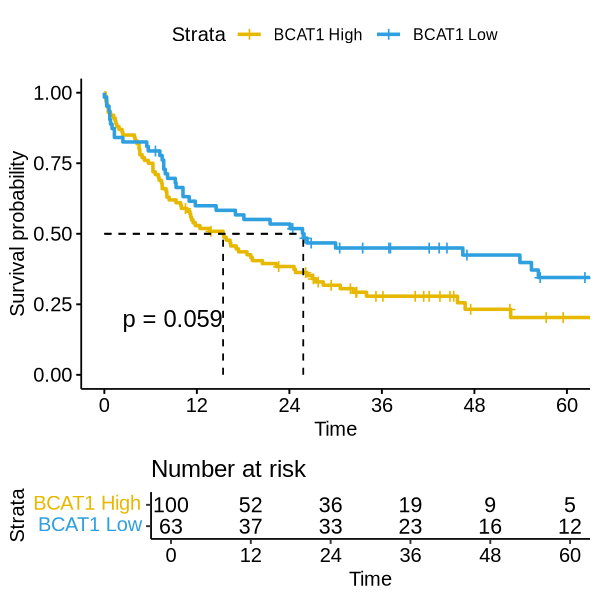

In [472]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat = plotdat[TET2_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT', ]
dim(plotdat)
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_tcga_noMut.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


In [105]:
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'high' ]


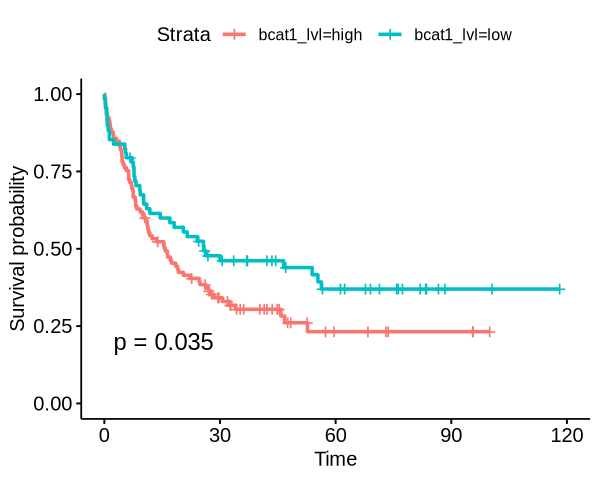

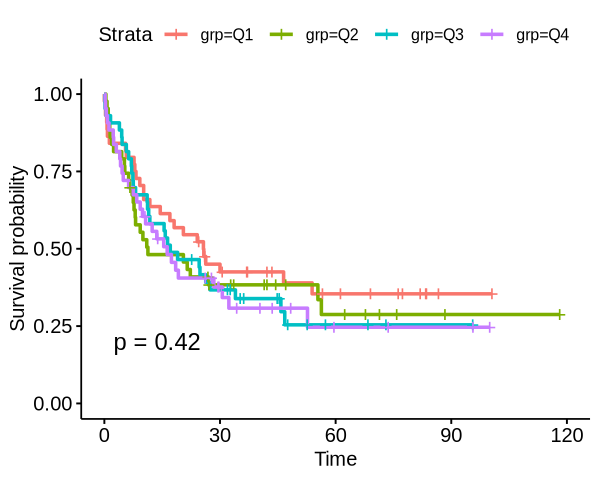

In [115]:
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat[AML1ETO == 'WT', ],
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           #legend.labs =  levels(plotdat$grp), #c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ grp, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat[AML1ETO == 'WT', ],
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           #legend.labs =  levels(plotdat$grp), #c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme

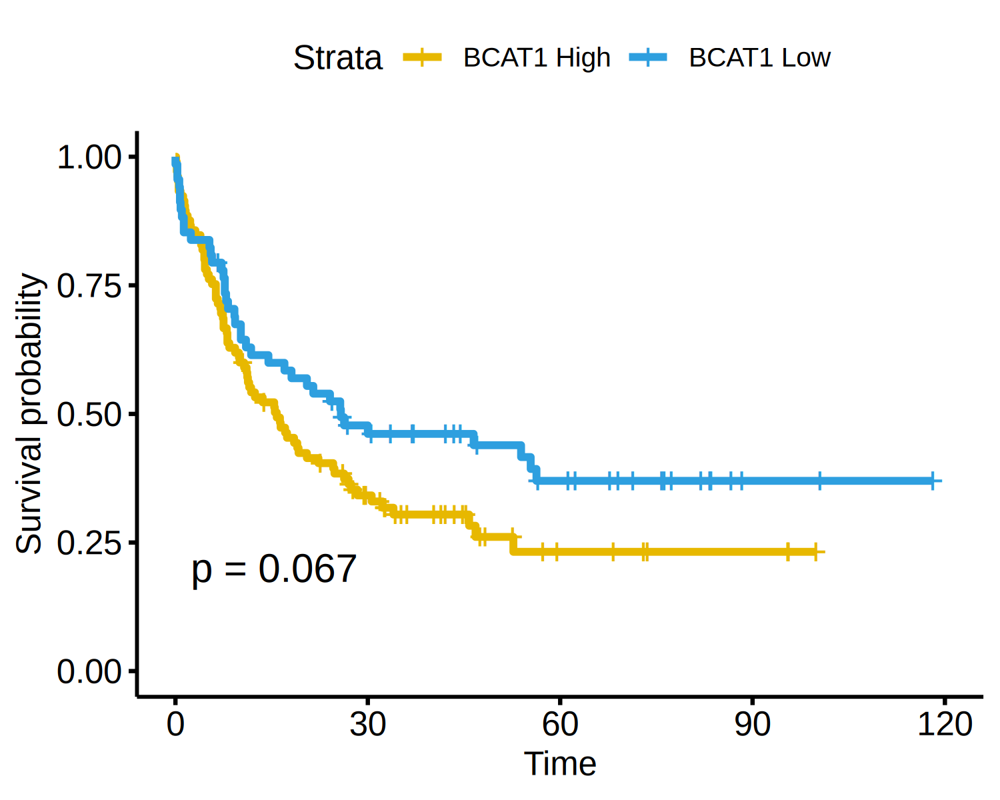

In [658]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme



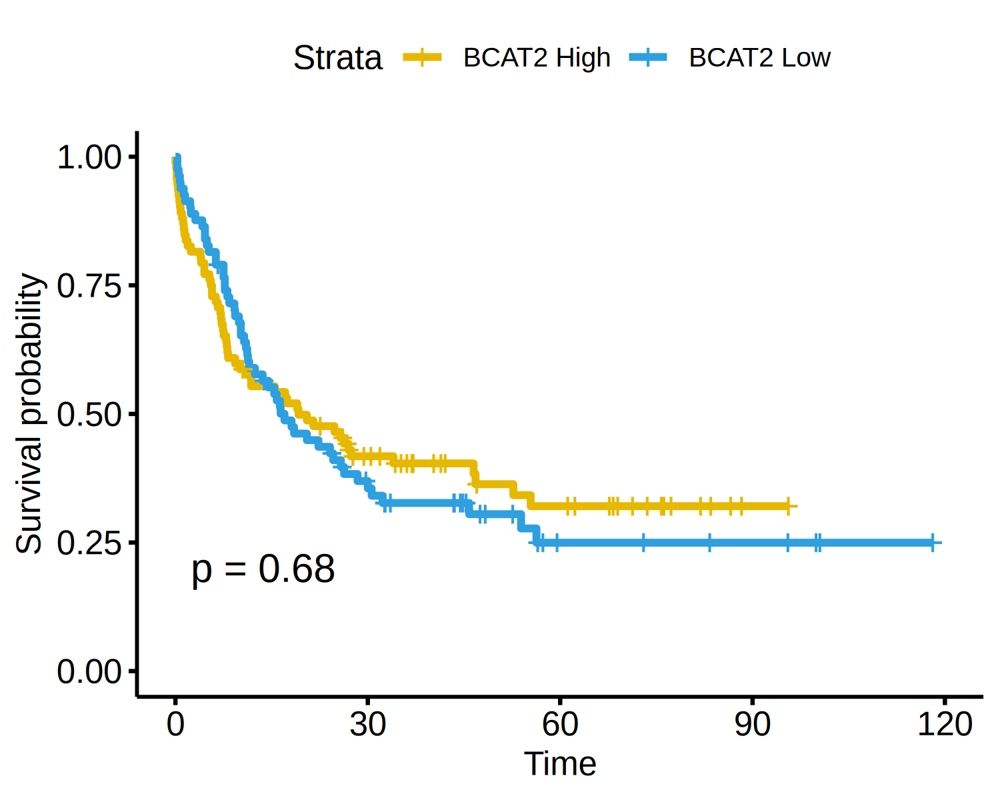

In [669]:
plotdat = logcpm_t[grep('TCGA', rn), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]

plotdat[, bcat2_lvl := 'low' ]
plotdat[BCAT2 > mean(plotdat$BCAT2, na.rm = T), bcat2_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT2 High", "BCAT2 Low"),    # Change legend labels
           ggtheme = theme_pubr() )      # Change ggplot2 theme



# BeatAML

## based on the shared data

In [328]:
beataml_mtx = fread(paste0(share_dir, 'BeatAML_logcpm_735_cases_from_GDC_matrix.xls'))
beataml_mtx = setDF(beataml_mtx[, 2:ncol(beataml_mtx)], rownames = beataml_mtx$geneName) 
head(beataml_mtx)


,BA2861R,BA2477R,BA2244R,BA3089R,BA2619R,BA2288R,BA2375R,BA2334R,BA2025R,BA2482R,⋯,BA2483R,BA2402R,BA3073R,BA2221R,BA2412R,BA3386R,BA2622R,BA2236R,BA2930R,BA2728R
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TSPAN6,-3.164130,-3.901944,-1.500337,-3.899123,-1.465264,0.3426768,0.0832082,-1.694039,-2.575040,-4.404309,⋯,-2.587626,-2.091202,0.3514756,-0.2915523,-1.271438,-2.925571,-0.6072514,-2.798997,-1.711236,-2.796977
TNMD,-4.404309,-4.404309,-4.404309,-4.404309,-4.404309,-4.4043087,-4.4043087,-4.404309,-4.404309,-4.404309,⋯,-4.404309,-4.404309,-4.4043087,-4.4043087,-4.404309,-4.404309,-4.4043087,-4.404309,-4.404309,-4.404309
DPM1,5.082644,5.147899,5.109012,4.555340,5.423399,5.0067132,4.8728405,3.683481,5.163456,4.881925,⋯,4.720064,4.981278,4.9455847,4.5198926,4.499468,5.029060,4.6644480,4.430172,4.947475,5.187494
SCYL3,4.090113,4.470980,4.533377,5.141361,4.447142,2.8727581,4.2251570,4.131921,4.556954,4.169063,⋯,3.988434,4.755853,4.4563866,3.6771307,4.246365,4.396510,4.6778022,4.237056,4.465944,4.334670
C1orf112,3.272781,4.613430,3.306584,3.422279,3.445636,3.3019039,2.7517484,2.486447,3.459036,3.569640,⋯,2.905568,2.661554,3.5652244,3.7431254,2.673184,3.530173,3.3487723,3.149507,2.913465,4.353552
FGR,8.313536,7.551878,9.224068,7.151613,8.552116,6.6886271,8.6200534,8.048241,8.853515,7.731898,⋯,7.779726,7.497736,5.3035767,9.5892785,10.103424,6.123953,9.4478114,7.418687,10.453707,10.240313


[1] 59427   735

In [195]:
beataml_clin = fread(paste0(share_dir, 'BeatAML_671cases_clincalInfo.xls'))
head(beataml_clin)


sampleName,dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,⋯,PPM1D_mut,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,OS_Stat
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
BA2452R,2157,BA2452D,BA2452R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2922R,2269,,BA2922R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2707R,2313,BA2707D,BA2707R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2409R,2418,,BA2409R,Waves1+2,yes,no,yes,yes,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2480R,2374,,BA2480R,Waves1+2,yes,no,yes,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2496R,2099,,BA2496R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1


In [470]:
dir(share_dir)

[1] "__PCA_Shared_data.pptx"                            "BeatAML_671cases_clincalInfo.xls"                  "BeatAML_671cases_logcpm_clinicalInfo_wide.xls"    
 [4] "BeatAML_671cases_logcpm.xls"                       "BeatAML_logcpm_735_cases_from_GDC_matrix.xls"      "BeatAML_logcpm_clin_735_cases_from_GDC_wide.xls"  
 [7] "pAML_887cases_5CD34_log2CPM.xls"                   "pAML_887cases_5CD34_subtypes.xls"                  "readme"                                           
[10] "sync"                                              "TARGET_clin_information_2615cases_filled.xls"      "TARGET_clin_information_3062cases_filled.xls"     
[13] "TARGET_logcpm_2615cases.xls"                       "TARGET_logcpm_3063cases.xls"                       "tcgaAML_clinical_info_only_151_cases_from_GDC.xls"
[16] "tcgaAML_logcpm_151_cases_from_GDC_long.xls"        "tcgaAML_logcpm_clin_151_cases_from_GDC_wide.xls"   "tcgaAML_rawCount_151_cases_from_GDC_long.xls"     
[19] "tcgaAML_rawCount_clin_151_cases_from_GDC_wide.xls"

## load clinical data from BeatAML https://biodev.github.io/BeatAML2/

In [202]:
# GDC results
beat_clin_gdc = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/beataml_aml_clin.rds')
beat_rna_gdc = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/beataml_laml_RNAseq_Counts.rds')
dim(beat_clin_gdc) 
head2(beat_clin_gdc) 
colnames(beat_clin_gdc) 
dim(beat_rna_gdc) 
head2(beat_rna_gdc) 

[1] 826  96

,project,submitter_id,disease_type,primary_site,submitter_id.1
,<chr>,<chr>,<chr>,<chr>,<chr>
1,BEATAML1.0-COHORT,2533,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2533
2,BEATAML1.0-COHORT,2455,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2455
3,BEATAML1.0-COHORT,2324,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2324


[1] "project"                                  "submitter_id"                             "disease_type"                             "primary_site"                            
 [5] "submitter_id"                             "irs_stage"                                "iss_stage"                                "ajcc_pathologic_stage"                   
 [9] "ann_arbor_clinical_stage"                 "created_datetime"                         "enneking_msts_stage"                      "inrg_stage"                              
[13] "enneking_msts_metastasis"                 "tissue_or_organ_of_origin"                "age_at_diagnosis"                         "esophageal_columnar_dysplasia_degree"    
[17] "cog_liver_stage"                          "child_pugh_classification"                "metastasis_at_diagnosis_site"             "state"                                   
[21] "prior_treatment"                          "cog_rhabdomyosarcoma_risk_group"          "days_to_last_known_disease_status"        "inpc_grade"                              
[25] "ajcc_pathologic_t"                        "morphology"                               "ajcc_pathologic_n"                        "ajcc_pathologic_m"                       
[29] "irs_group"                                "medulloblastoma_molecular_classification" "wilms_tumor_histologic_subtype"           "residual_disease"                        
[33] "classification_of_tumor"                  "tumor_focality"                           "ann_arbor_b_symptoms"                     "icd_10_code"                             
[37] "cog_renal_stage"                          "figo_stage"                               "synchronous_malignancy"                   "burkitt_lymphoma_clinical_variant"       
[41] "days_to_best_overall_response"            "inss_stage"                               "eln_risk_classification"                  "supratentorial_localization"             
[45] "ishak_fibrosis_score"                     "tumor_confined_to_organ_of_origin"        "days_to_diagnosis"                        "goblet_cells_columnar_mucosa_present"    
[49] "laterality"                               "last_known_disease_status"                "days_to_last_follow_up"                   "primary_diagnosis"                       
[53] "ajcc_clinical_stage"                      "cog_neuroblastoma_risk_group"             "updated_datetime"                         "metastasis_at_diagnosis"                 
[57] "enneking_msts_tumor_site"                 "prior_malignancy"                         "year_of_diagnosis"                        "best_overall_response"                   
[61] "ann_arbor_pathologic_stage"               "ann_arbor_extranodal_involvement"         "method_of_diagnosis"                      "mitosis_karyorrhexis_index"              
[65] "ajcc_staging_system_edition"              "days_to_recurrence"                       "esophageal_columnar_metaplasia_present"   "ajcc_clinical_m"                         
[69] "ajcc_clinical_n"                          "ajcc_clinical_t"                          "inpc_histologic_group"                    "micropapillary_features"                 
[73] "diagnosis_id"                             "tumor_regression_grade"                   "site_of_resection_or_biopsy"              "first_symptom_prior_to_diagnosis"        
[77] "tumor_grade"                              "enneking_msts_grade"                      "gastric_esophageal_junction_involvement"  "progression_or_recurrence"               
[81] "treatments"                               "submitter_sample_ids"                     "cause_of_death"                           "race"                                    
[85] "gender"                                   "ethnicity"                                "vital_status"                             "age_at_index"                            
[89] "submitter_id"                             "days_to_birth"                            "year_of_birth" 

[1] 60660   735

class: RangedSummarizedExperiment 
dim: 3 5 
metadata(1): data_release
assays(6): unstranded stranded_first ... fpkm_unstrand fpkm_uq_unstrand
rownames(3): ENSG00000000003.15 ENSG00000000005.6 ENSG00000000419.13
rowData names(10): source type ... hgnc_id havana_gene
colnames(5): BA2861R BA2477R BA2244R BA3089R BA2619R
colData names(33): sample sample_submitter_id ... releasable released

In [203]:
table(beat_clin_gdc$vital_status)


  Alive    Dead Unknown 
    249     452     125 

In [204]:
beat_clin = as.data.table(read_xlsx('data/beataml/beataml_wv1to4_clinical.xlsx', 1))
dim(beat_clin)
head(beat_clin)


[1] 942  95

dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,inferred_sex,⋯,surfaceAntigensImmunohistochemicalStains,totalProtein,wbcCount,FLT3-ITD,allelic_ratio,NPM1,RUNX1,ASXL1,TP53,variantSummary
<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
2476,BA2102D,NA,Waves1+2,yes,yes,no,no,Female,Female,⋯,"CD7, CD13, CD33, partial CD34, dim CD45, CD117, CD123, HLA-DR and MPO positive",5.4,58.80,positive,0.9607843,positive,NA,NA,NA,CEBPA|FLT3-ITD|NPM1
2476,BA2005D,NA,Waves1+2,no,no,no,no,Female,Male,⋯,"partial CD7, variable CD13, CD33, partial CD34,CD38, CD58, CD117, CD123, and partial HLA-DR positive",6.7,5.30,positive,1.1739130,positive,NA,NA,NA,NA
2476,BA3074D,NA,Waves1+2,no,no,no,no,Female,Male,⋯,NA,6.9,2.54,positive,2.0303030,positive,NA,NA,NA,NA
2476,BA2555D,NA,Waves1+2,no,no,no,no,Female,Female,⋯,NA,5.0,17.79,positive,NA,positive,NA,NA,NA,NA
2476,NA,BA3073R,Waves1+2,no,no,no,no,Female,NA,⋯,NA,5.0,17.79,NA,NA,positive,NA,NA,NA,NA
2157,BA2452D,BA2452R,Both,no,no,no,no,Male,Male,⋯,"partial CD7, CD13, CD33, CD38, dim CD45, dimCD58, CD117, CD123, and HLA-DR",5.8,0.60,positive,0.9607843,positive,NA,NA,NA,NA


In [205]:
beat_clin[ vitalStatus == 'Dead', stat := 1 ]
beat_clin[ vitalStatus == 'Alive', stat := 0 ]
beat_clin[ vitalStatus == 'Unknown', stat := NA ]

beat_clin[ , OS_Month := overallSurvival / 30.25 ] 


In [206]:
dim(beat_clin)
table(beat_clin$stat)

[1] 942  97


  0   1 
345 565 

In [207]:
nrow(beat_clin[grep('FLT3-ITD', variantSummary), ])

[1] 173

In [208]:
beat_clin[, FLT3ITD := 'WT']
beat_clin[grep('FLT3-ITD', variantSummary), FLT3ITD := 'FLT3-ITD']

beat_clin[, AML1ETO := 'WT']
beat_clin[grep('RUNX1-RUNX1T1', consensusAMLFusions), AML1ETO := 'AML1-ETO']

beat_clin[, PMLRARA := 'WT']
beat_clin[grep('PML-RARA', consensusAMLFusions), PMLRARA := 'PML-RARA']

beat_clin[, CBFBMYH11 := 'WT']
beat_clin[grep('CBFB-MYH11', consensusAMLFusions), CBFBMYH11 := 'CBFB-MYH11']

beat_clin[, GATA2MECOM := 'WT']
beat_clin[grep('GATA2-MECOM', consensusAMLFusions), GATA2MECOM := 'GATA2-MECOM']

beat_clin[, MLL_re := 'WT']
beat_clin[grep('KMT2A_re', consensusAMLFusions), MLL_re := 'MLL_re']

beat_clin[, MA9 := 'WT']
beat_clin[grep('MLLT3-KMT2A', consensusAMLFusions), MA9 := 'MA9']

In [210]:
beat_clin[, karyotype := 'Altered' ]
beat_clin[otherCytogenetics %in% c('Normal', 'normal'), karyotype := 'Normal' ]

In [441]:
logcpm_t[rn2 %in% beat_clin[FLT3ITD != 'WT', dbgap_rnaseq_sample], FLT3ITD := 'FLT3-ITD']
logcpm_t[rn2 %in% beat_clin[AML1ETO != 'WT', dbgap_rnaseq_sample], AML1ETO := 'AML1-ETO']
logcpm_t[rn2 %in% beat_clin[PMLRARA != 'WT', dbgap_rnaseq_sample], PMLRARA := 'PML-RARA']
logcpm_t[rn2 %in% beat_clin[CBFBMYH11 != 'WT', dbgap_rnaseq_sample], CBFBMYH11 := 'CBFB-MYH11']
logcpm_t[rn2 %in% beat_clin[GATA2MECOM != 'WT', dbgap_rnaseq_sample], GATA2MECOM := 'GATA2-MECOM']
logcpm_t[rn2 %in% beat_clin[MLL_re != 'WT', dbgap_rnaseq_sample], MLL_re := 'MLL_re']
logcpm_t[rn2 %in% beat_clin[MA9 != 'WT', dbgap_rnaseq_sample], MLL_re := 'MLL_re']
table(logcpm_t$FLT3ITD)


FLT3-ITD       WT 
     152     1779 

In [443]:
logcpm_t[rn2 %in% beat_clin[karyotype == 'Normal', dbgap_rnaseq_sample], karyotype := 'Normal']
logcpm_t[rn2 %in% beat_clin[karyotype == 'Altered', dbgap_rnaseq_sample], karyotype := 'Altered']


In [445]:
table(logcpm_t$karyotype, logcpm_t$batch)

         
          BeatAML TARGET TCGA
  Altered     481      0   93
  Normal      190      0   80

In [211]:
table(beat_clin$karyotype)


Altered  Normal 
    674     268 

In [212]:
dim(beat_clin_gdc[beat_clin_gdc$submitter_id %in% beat_clin$dbgap_subject_id, ])

[1] 805  96

In [213]:
dim(beat_clin_gdc)

[1] 826  96

## load mutation data for gain of function FLT3 mutations 
this already derived from the clinical information

In [ ]:
query <- GDCquery(
    project = "BEATAML1.0-COHORT", 
    data.category = "Simple Nucleotide Variation", 
    access = "open",
    data.type = "Masked Somatic Mutation", 
    workflow.type = "Aliquot Ensemble Somatic Variant Merging and Masking"
)
GDCdownload(query)
maf <- GDCprepare(query)


In [446]:
beat_mut = fread('data/beataml/beataml_wes_wv1to4_mutations_dbgap.txt')


In [215]:
dim(beat_mut[grep('FLT3', symbol), .(dbgap_sample_id, variant_classification, hgvsp_short, symbol)])
head(beat_mut[grep('FLT3', symbol), .(dbgap_sample_id, variant_classification, hgvsp_short, symbol)])

[1] 167   4

dbgap_sample_id,variant_classification,hgvsp_short,symbol
<chr>,<chr>,<chr>,<chr>
BA2012D,missense_variant,p.A680V,FLT3
BA2881D,missense_variant,p.D835Y,FLT3
BA2881D,missense_variant,p.D835Y,FLT3
BA2352D,missense_variant,p.A680V,FLT3
BA2352D,missense_variant,p.A680V,FLT3
BA2630D,missense_variant,p.A680V,FLT3


In [112]:
dim(beat_mut)
head(beat_mut)

[1] 11721    32

dbgap_sample_id,capture_type,seqnames,pos_start,pos_end,ref,alt,genotyper,tumor_only,total_reads,⋯,cdna_position,cds_position,protein_position,amino_acids,codons,existing_variation,refseq,sift,polyphen,exac_af
<chr>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
BA2336D,NexteraV1.2,4,106156042,106156043,TC,T,varscan,1,151,⋯,1804/10166,944/6009,315/2002,S/X,tCc/tc,,,,,NA
BA2336D,NexteraV1.2,4,106190829,106190830,AG,A,varscan,1,74,⋯,4968/10166,4108/6009,1370/2002,G/X,Ggg/gg,rs756348991,,,,3.73e-05
BA2336D,NexteraV1.2,5,170837543,170837543,C,CTCTG,varscan,1,59,⋯,1160-1161/1758,859-860/885,287/294,L/LCX,ctc/cTCTGtc,rs758959453&COSM158604,NM_002520.6,,,8.29e-06
BA2643D,NexteraV1.2,11,32456651,32456652,GC,G,varscan,1,51,⋯,525/3122,240/1554,80/517,L/X,ctG/ct,,NM_024426.4&NM_024424.3,,,NA
BA2643D,NexteraV1.2,2,25457242,25457242,C,T,mutect,1,28,⋯,2983/4380,2645/2739,882/912,R/H,cGc/cAc,rs147001633&COSM52944&COSM442676,NM_175629.2,deleterious(0),probably_damaging(0.993),5.93e-04
BA2643D,NexteraV1.2,2,25457242,25457242,C,T,varscan,1,30,⋯,2983/4380,2645/2739,882/912,R/H,cGc/cAc,rs147001633&COSM52944&COSM442676,NM_175629.2,deleterious(0),probably_damaging(0.993),5.93e-04


In [216]:
beat_clin[, FLT3_mut := 'WT']
beat_clin[FLT3_mut == 'WT' & dbgap_subject_id %in% beat_mut[grep('FLT3', symbol), dbgap_sample_id], FLT3_mut := 'FLT3_Mut']


## load mutation data for recurrent mutated genes

In [127]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [451]:
beat_mut = fread('beat_mut_oncokb_filtered.tsv')

In [452]:
head(beat_mut$Tumor_Sample_Barcode2) 
length(unique(beat_mut$Tumor_Sample_Barcode2) )

[1] "BA2244D" "BA2619D" "BA2266D" "BA2163D" "BA2163D" "BA3153D"

[1] 261

In [493]:
dim(beat_clin)
head(beat_clin)

[1] 826  96

project,submitter_id,disease_type,primary_site,submitter_id.1,irs_stage,iss_stage,ajcc_pathologic_stage,ann_arbor_clinical_stage,created_datetime,⋯,vital_status,age_at_index,submitter_id,days_to_birth,year_of_birth,premature_at_birth,weeks_gestation_at_birth,demographic_id,days_to_death,year_of_death
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<chr>,<lgl>,<lgl>,<lgl>,<lgl>,<chr>,<lgl>,<lgl>
BEATAML1.0-COHORT,2533,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2533,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Dead,NA,2533,NA,NA,NA,NA,960c8fce-0d74-4c32-85dc-28ca4b328256,NA,NA
BEATAML1.0-COHORT,2455,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2455,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Dead,NA,2455,NA,NA,NA,NA,1a2acc4c-6192-4dc5-b6ec-765478fb2bcf,NA,NA
BEATAML1.0-COHORT,2324,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2324,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Dead,NA,2324,NA,NA,NA,NA,782649e4-68e9-40ce-ba3b-6873cff67d2e,NA,NA
BEATAML1.0-COHORT,2095,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2095,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Alive,NA,2095,NA,NA,NA,NA,ab6d5e38-c113-4385-83c7-ab8d8720b2cf,NA,NA
BEATAML1.0-COHORT,2109,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,diag-2109,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Dead,NA,2109,NA,NA,NA,NA,7617bb4f-f388-48e4-b843-4c0cf4a1bb59,NA,NA
BEATAML1.0-COHORT,2204,Chronic Myeloproliferative Disorders,Hematopoietic and reticuloendothelial systems,diag-2204,NA,NA,NA,NA,2019-03-12T12:10:30.725957-05:00,⋯,Alive,NA,2204,NA,NA,NA,NA,eab75341-23a9-4b59-a944-eab9e9c7bd8a,NA,NA


In [450]:
table(beat_clin$karyotype)


Altered  Normal 
    674     268 

In [506]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(beat_clin))) > 0){
        beat_clin[, (gene_mut) := NULL ]
    }
    beat_clin[, xxx := 'WT' ]
    beat_clin[dbgap_dnaseq_sample %in% beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2], xxx := gene_mut ]
    setnames(beat_clin, 'xxx', gene_mut)
    message(gene, '\tmut\t', length(unique(beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2])))
}


TET2	mut	18

DNMT3A	mut	39

SF3B1	mut	10

TP53	mut	24

PPM1D	mut	1

ASXL1	mut	6

NRAS	mut	30

JAK2	mut	3

GNB1	mut	0

KRAS	mut	6

CBL	mut	1

IDH1	mut	22

IDH2	mut	16



In [447]:
table(logcpm_t$batch)


BeatAML  TARGET    TCGA 
    671    1087     173 

In [449]:
beat_mut[, Tumor_Sample_Barcode2]

ERROR: Error: j (the 2nd argument inside [...]) is a single symbol but column name 'Tumor_Sample_Barcode2' is not found. If you intended to select columns using a variable in calling scope, please try DT[, ..Tumor_Sample_Barcode2]. The .. prefix conveys one-level-up similar to a file system path.


In [459]:
beat_mut[, rna_id := sub('D$', 'R', Tumor_Sample_Barcode2) ]
beat_mut$rna_id

[1] "BA2244R" "BA2619R" "BA2266R" "BA2163R" "BA2163R" "BA3153R" "BA2528R" "BA2528R" "BA2528R" "BA2528R" "BA2528R" "BA2528R" "BA2634R" "BA2634R" "BA2082R" "BA2790R" "BA2422R" "BA2124R"
 [19] "BA2124R" "BA2124R" "BA2157R" "BA2835R" "BA3435R" "BA2484R" "BA2658R" "BA2195R" "BA2195R" "BA2779R" "BA2779R" "BA3434R" "BA3434R" "BA2488R" "BA3001R" "BA2860R" "BA2860R" "BA3171R"
 [37] "BA2314R" "BA2681R" "BA2681R" "BA2191R" "BA2191R" "BA2191R" "BA2294R" "BA2313R" "BA2731R" "BA2358R" "BA2358R" "BA2358R" "BA2249R" "BA2249R" "BA2249R" "BA2979R" "BA2979R" "BA2979R"
 [55] "BA2000R" "BA2738R" "BA2738R" "BA2257R" "BA2257R" "BA2914R" "BA2598R" "BA3026R" "BA3026R" "BA3026R" "BA2116R" "BA2116R" "BA2715R" "BA2715R" "BA2060R" "BA2603R" "BA2483R" "BA2483R"
 [73] "BA2483R" "BA2483R" "BA2483R" "BA2438R" "BA2438R" "BA2588R" "BA2588R" "BA2875R" "BA2020R" "BA3310R" "BA3310R" "BA2181R" "BA2181R" "BA2816R" "BA2816R" "BA3108R" "BA2206R" "BA2206R"
 [91] "BA2206R" "BA2206R" "BA2206R" "BA2052R" "BA2052R" "BA3401R" "BA2841R" "BA2841R" "BA2841R" "BA2960R" "BA2457R" "BA2456R" "BA2456R" "BA2456R" "BA2212R" "BA2752R" "BA2692R" "BA2692R"
[109] "BA2650R" "BA2123R" "BA3319R" "BA3405R" "BA3405R" "BA3255R" "BA3255R" "BA2547R" "BA2547R" "BA2547R" "BA2547R" "BA3192R" "BA2246R" "BA2359R" "BA2359R" "BA2616R" "BA2616R" "BA2902R"
[127] "BA2908R" "BA2908R" "BA2366R" "BA2366R" "BA3084R" "BA3084R" "BA2829R" "BA2829R" "BA3040R" "BA3040R" "BA2377R" "BA2986R" "BA2494R" "BA2494R" "BA2494R" "BA2113R" "BA2883R" "BA2883R"
[145] "BA2883R" "BA2798R" "BA2798R" "BA2798R" "BA2649R" "BA2238R" "BA2238R" "BA2114R" "BA2114R" "BA2209R" "BA2805R" "BA2856R" "BA2856R" "BA2856R" "BA2443R" "BA2524R" "BA2524R" "BA3318R"
[163] "BA3318R" "BA3318R" "BA3318R" "BA2600R" "BA3157R" "BA2007R" "BA2007R" "BA3341R" "BA2640R" "BA2315R" "BA2322R" "BA2454R" "BA2589R" "BA2589R" "BA2546R" "BA2933R" "BA2198R" "BA2198R"
[181] "BA2804R" "BA3453R" "BA2155R" "BA2882R" "BA2337R" "BA2337R" "BA2344R" "BA2344R" "BA2720R" "BA2720R" "BA2918R" "BA2918R" "BA2918R" "BA2918R" "BA2918R" "BA2652R" "BA2894R" "BA2894R"
[199] "BA3214R" "BA3214R" "BA3214R" "BA2464R" "BA2280R" "BA2280R" "BA2280R" "BA2092R" "BA3134R" "BA3134R" "BA3134R" "BA2450R" "BA2450R" "BA2106R" "BA2106R" "BA2106R" "BA2106R" "BA2915R"
[217] "BA2972R" "BA2972R" "BA2302R" "BA2792R" "BA2792R" "BA2682R" "BA2682R" "BA2255R" "BA2255R" "BA2523R" "BA2523R" "BA3196R" "BA2044R" "BA2211R" "BA3370R" "BA3370R" "BA3370R" "BA2772R"
[235] "BA2481R" "BA2418R" "BA2166R" "BA3245R" "BA2086R" "BA2086R" "BA2086R" "BA2086R" "BA2756R" "BA2756R" "BA2756R" "BA2781R" "BA3183R" "BA2714R" "BA3002R" "BA3002R" "BA3002R" "BA3002R"
[253] "BA3002R" "BA3176R" "BA3176R" "BA2867R" "BA2867R" "BA2867R" "BA2867R" "BA3168R" "BA3420R" "BA3420R" "BA2688R" "BA2688R" "BA2455R" "BA2666R" "BA2694R" "BA2217R" "BA2217R" "BA2217R"
[271] "BA2576R" "BA2576R" "BA2576R" "BA3413R" "BA2812R" "BA3333R" "BA3333R" "BA2515R" "BA3410R" "BA2936R" "BA2301R" "BA2517R" "BA2657R" "BA2657R" "BA2357R" "BA3232R" "BA2661R" "BA2661R"
[289] "BA2661R" "BA2661R" "BA2661R" "BA2169R" "BA2421R" "BA2421R" "BA2421R" "BA2421R" "BA3381R" "BA2081R" "BA2676R" "BA2676R" "BA2676R" "BA2606R" "BA2606R" "BA2606R" "BA2606R" "BA3117R"
[307] "BA2930R" "BA2930R" "BA2930R" "BA2614R" "BA2614R" "BA2614R" "BA2614R" "BA2489R" "BA2489R" "BA2122R" "BA2122R" "BA2870R" "BA2870R" "BA2868R" "BA2868R" "BA2868R" "BA2557R" "BA2103R"
[325] "BA2103R" "BA2103R" "BA2103R" "BA3029R" "BA3029R" "BA2296R" "BA2296R" "BA2197R" "BA2197R" "BA2197R" "BA2197R" "BA2824R" "BA2824R" "BA2994R" "BA2994R" "BA2225R" "BA3375R" "BA2995R"
[343] "BA2995R" "BA2597R" "BA2597R" "BA2926R" "BA2233R" "BA3406R" "BA3411R" "BA3411R" "BA2665R" "BA2254R" "BA2982R" "BA2982R" "BA2093R" "BA2093R" "BA2093R" "BA2655R" "BA3023R" "BA3023R"
[361] "BA3023R" "BA3023R" "BA3023R" "BA2763R" "BA2763R" "BA2229R" "BA2850R" "BA2451R" "BA2451R" "BA2451R" "BA2499R" "BA2499R" "BA2499R" "BA2499R" "BA2499R" "BA2073R" "BA2073R" "BA3185R"
[379] "BA3185R" "BA3185R" "BA2156R" "BA2074R" "BA2074R" "BA2074R" "BA2074R" "BA2074R" "BA2068R" 

In [460]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(logcpm_t))) > 0){
        logcpm_t[grep('BeatAML', batch), (gene_mut) := 'WT']
    }else{ 
        logcpm_t[,  (gene_mut) := 'WT' ]
    }
    logcpm_t[rn2 %in% beat_mut[Hugo_Symbol == gene, rna_id],  (gene_mut) := gene_mut ]
    message(gene, '\tmut\t', nrow(logcpm_t[get(gene_mut) != 'WT', ])) 
}


TET2	mut	12

DNMT3A	mut	31

SF3B1	mut	9

TP53	mut	22

PPM1D	mut	0

ASXL1	mut	10

NRAS	mut	22

JAK2	mut	2

GNB1	mut	1

KRAS	mut	9

CBL	mut	2

IDH1	mut	14

IDH2	mut	13



In [467]:
table(logcpm_t$DNMT3A_mut, logcpm_t$batch)

            
             BeatAML TARGET TCGA
  DNMT3A_mut      23      0    8
  WT             648   1087  165

In [507]:
beat_clin_gdc = as.data.table(beat_clin_gdc)

In [509]:
library(splitstackshape)

In [510]:
beat_clin_gdc_split = cSplit(beat_clin_gdc, 'submitter_sample_ids', ',', direction = 'long')

Warning message in type.convert.default(unlist(x, use.names = FALSE)):
"'as.is' should be specified by the caller; using TRUE"


In [511]:
head(beat_clin_gdc_split[, .(submitter_id, submitter_sample_ids)])

submitter_id,submitter_sample_ids
<chr>,<chr>
2533,BA2515R
2533,BA2515D
2533,BA3033D
2455,BA2893R
2455,BA2893D
2324,BA3027R


In [512]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(beat_clin_gdc_split))) > 0){
        beat_clin_gdc_split[, (gene_mut) := NULL ]
    }
    beat_clin_gdc_split[, xxx := 'WT' ]
    beat_clin_gdc_split[submitter_sample_ids %in% beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2], xxx := gene_mut ]
    setnames(beat_clin_gdc_split, 'xxx', gene_mut)
    message(gene, '\tmut\t', length(unique(beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2])))
}


TET2	mut	18

DNMT3A	mut	39

SF3B1	mut	10

TP53	mut	24

PPM1D	mut	1

ASXL1	mut	6

NRAS	mut	30

JAK2	mut	3

GNB1	mut	0

KRAS	mut	6

CBL	mut	1

IDH1	mut	22

IDH2	mut	16



In [513]:
for(ii in 1:length(aml_genes)){
    gene = aml_genes[ii]
    gene_mut = paste0(gene, '_mut')
    if(length(intersect(gene_mut, colnames(beat_clin_gdc))) > 0){
        beat_clin_gdc[, (gene_mut) := NULL ]
    }
    beat_clin_gdc[, xxx := 'WT' ]
    for(jj in 1:nrow(beat_clin_gdc)){
        tmp = beat_clin_gdc[ii, submitter_sample_ids]
        tmp_list = unlist(strsplit(tmp, ','))
        if(length(intersect(tmp_list, beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2])) > 0){
            beat_clin_gdc[, xxx := gene_mut ]
        }
    }
    setnames(beat_clin_gdc, 'xxx', gene_mut)
    message(gene, '\tmut\t', length(unique(beat_mut[Hugo_Symbol == gene, Tumor_Sample_Barcode2])))
}


TET2	mut	18

DNMT3A	mut	39

SF3B1	mut	10

TP53	mut	24

PPM1D	mut	1

ASXL1	mut	6

NRAS	mut	30

JAK2	mut	3

GNB1	mut	0

KRAS	mut	6

CBL	mut	1

IDH1	mut	22

IDH2	mut	16



## export clinical data and subtype

In [515]:
saveRDS(beat_clin_gdc, file = 'data/beat_clin_gdc_beatAug13.rds')


In [153]:
fwrite(beat_clin, file = 'data/beat_clin_beatAug13.tsv', sep = '\t')


## load normalized rnaseq results

In [161]:
# https://biodev.github.io/BeatAML2/
beat_rna = fread('data/beataml/beataml_waves1to4_norm_exp_dbgap.txt')
# '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat'
 

In [326]:
dim(beat_rna)
head2(beat_rna)
tail2(beat_rna)


[1] 22843   711

stable_id,display_label,description,biotype,BA2392R
<chr>,<chr>,<chr>,<chr>,<dbl>
ENSG00000000003,TSPAN6,tetraspanin 6 [Source:HGNC Symbol;Acc:11858],protein_coding,1.523670
ENSG00000000419,DPM1,"dolichyl-phosphate mannosyltransferase polypeptide 1, catalytic subunit [Source:HGNC Symbol;Acc:3005]",protein_coding,7.107711
ENSG00000000457,SCYL3,SCY1-like 3 (S. cerevisiae) [Source:HGNC Symbol;Acc:19285],protein_coding,3.362605


BA3249R,BA3385R,BA3242R,BA3446R,BA3416R,BA3123R
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-0.6844119,0.2772651,0.3198632,0.06409522,1.6562811,-0.5716497
3.7779000,3.3784457,4.1949058,3.34672340,4.1182451,4.1843929
0.1327421,0.4595501,-0.1663286,0.88746229,0.2210562,-0.2894384
3.2169529,3.1104940,2.9482113,2.10514698,2.8030356,1.4416074


In [9]:
fwrite(beat_rna, file = 'BeatAML_rna.xls', sep = '\t')


In [190]:
beat_rna = fread('BeatAML_rna.xls')

In [520]:
beat_rna[duplicated(display_label), ] # no duplicated gene symbol 

Warning message in cbind(parts$left, chars$ellip_h, parts$right, deparse.level = 0L):
"number of rows of result is not a multiple of vector length (arg 2)"
Warning message in cbind(parts$left, chars$ellip_h, parts$right, deparse.level = 0L):
"number of rows of result is not a multiple of vector length (arg 2)"
Warning message in cbind(parts$left, chars$ellip_h, parts$right, deparse.level = 0L):
"number of rows of result is not a multiple of vector length (arg 2)"
Warning message in cbind(parts$left, chars$ellip_h, parts$right, deparse.level = 0L):
"number of rows of result is not a multiple of vector length (arg 2)"


stable_id,display_label,description,biotype,BA2392R,BA2611R,BA2506R,BA2430R,BA2448R,BA2730R,⋯,BA3376R,BA3137R,BA3300R,BA3375R,BA3249R,BA3385R,BA3242R,BA3446R,BA3416R,BA3123R
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>


In [191]:
length(intersect(beat_clin$dbgap_rnaseq_sample, colnames(beat_rna)))

[1] 0

In [523]:
beat_rna_sel = setDF(beat_rna[, 5:ncol(beat_rna)], rownames = beat_rna$display_label)
ov = intersect(colnames(beat_rna_sel), beat_clin$dbgap_rnaseq_sample)
beat_rna_sel = beat_rna_sel[, ov]
beat_clin_sel = beat_clin[dbgap_rnaseq_sample %in% ov, ]
beat_clin_sel[, OS_Stat := stat]
beat_clin_sel[, sampleName := dbgap_rnaseq_sample]
beat_clin_sel = relocate(beat_clin_sel, 'sampleName')
dim(beat_rna_sel)
head2(beat_rna_sel)
dim(beat_clin_sel)
head2(beat_clin_sel)


[1] 22843   671

,BA2409R,BA3037R,BA2496R,BA2172R,BA2865R
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TSPAN6,-1.561549,2.352178,-2.824391,1.687906,-3.270986
DPM1,6.886147,6.437932,6.553935,6.852068,6.613288
SCYL3,3.817809,3.986917,3.208805,3.878267,4.527671


[1] 671 120

sampleName,dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort
<chr>,<dbl>,<chr>,<chr>,<chr>
BA2452R,2157,BA2452D,BA2452R,Both
BA2922R,2269,NA,BA2922R,Waves1+2
BA2707R,2313,BA2707D,BA2707R,Both


In [524]:
beat_rna_t = as.data.table(t(beat_rna_sel), keep.rownames = T) 
setnames(beat_rna_t, 1, 'sampleName')
beat_rna_clin_t = merge(beat_rna_t, beat_clin_sel, by = 'sampleName') 
dim(beat_rna_t) 
dim(beat_rna_clin_t) 
head2(beat_rna_t) 
head2(beat_rna_clin_t) 


[1]   671 22844

[1]   671 22963

sampleName,TSPAN6,DPM1,SCYL3,C1orf112
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2409R,-1.561549,6.886147,3.817809,2.436853
BA3037R,2.352178,6.437932,3.986917,1.862032
BA2496R,-2.824391,6.553935,3.208805,3.369261


sampleName,TSPAN6,DPM1,SCYL3,C1orf112
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,-2.440122,7.314841,3.723787,4.551298
BA2003R,1.180018,7.261503,4.036186,2.780778
BA2004R,-1.760990,6.884307,4.415685,2.761738


In [525]:
ex = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_logcpm.xls')
dim(ex)


[1] 22843   672

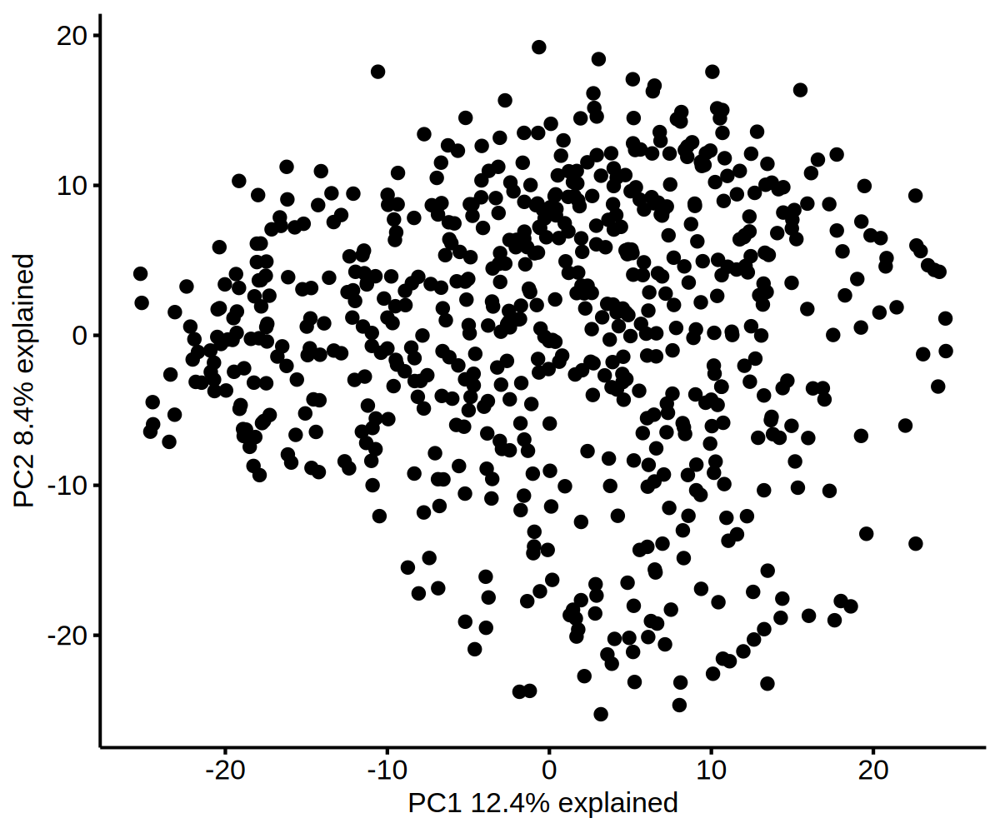

In [362]:
ntop = 1000
ex = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_logcpm.xls')
ex_df = setDF(ex[, 2:ncol(ex)], rownames = ex$geneName) 
row_sd = rowSds(ex_df)
row_sd = sort(row_sd, decreasing = T)
sel = names(row_sd[1:ntop])
mtx = ex_df[sel, ]

pc = prcomp(t(mtx), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained')
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained')
plotdat = as.data.table(pc$x, keep.rownames = T)
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2') + xlab(lblx) + ylab(lbly)


In [ ]:
#'https://biodev.github.io/BeatAML2/'
setwd('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data')
fwrite(beat_rna_clin_t, file = 'BeatAML_671cases_logcpm_clinicalInfo_wide.xls', sep = '\t')
ex = as.data.table(beat_rna_sel, keep.rownames = T)
setnames(ex, 1, 'geneName')
fwrite(ex, file = 'BeatAML_671cases_logcpm.xls', sep = '\t')
fwrite(beat_clin_sel, file = 'BeatAML_671cases_clincalInfo.xls', sep = '\t')


In [533]:
ov = intersect(colnames(mtx), colnames(ex))
mtx2 = mtx[, ov]
dim(mtx2)

[1] 59427   671

In [534]:
write.table(mtx2, file = 'BeatAML_671cases_rawocount.xls')

## corrleation plot

Warning message:
"Removed 4 rows containing non-finite values (`stat_smooth()`)."
Warning message:
"Removed 4 rows containing non-finite values (`stat_cor()`)."
Warning message:
"Removed 4 rows containing missing values (`geom_point()`)."
Warning message:
"Removed 220 rows containing non-finite values (`stat_smooth()`)."
Warning message:
"Removed 220 rows containing non-finite values (`stat_cor()`)."
Warning message:
"Removed 220 rows containing missing values (`geom_point()`)."


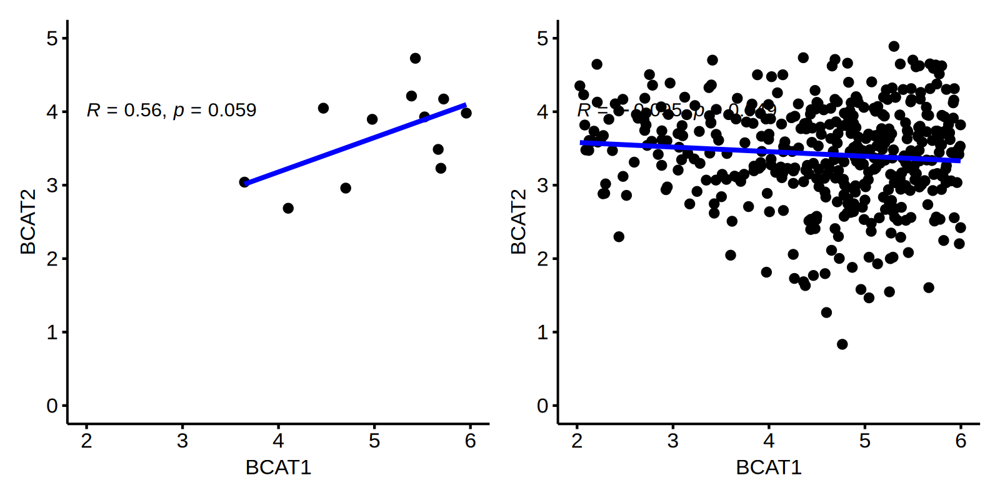

In [539]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 = ggscatter(beat_rna_clin_t[AML1ETO == 'AML1-ETO', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5) + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg2 = ggscatter(beat_rna_clin_t[AML1ETO == 'WT', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5)  + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg1 | gg2

Warning message:
"Removed 36 rows containing non-finite values (`stat_smooth()`)."
Warning message:
"Removed 36 rows containing non-finite values (`stat_cor()`)."
Warning message:
"Removed 36 rows containing missing values (`geom_point()`)."
Warning message:
"Removed 188 rows containing non-finite values (`stat_smooth()`)."
Warning message:
"Removed 188 rows containing non-finite values (`stat_cor()`)."
Warning message:
"Removed 188 rows containing missing values (`geom_point()`)."


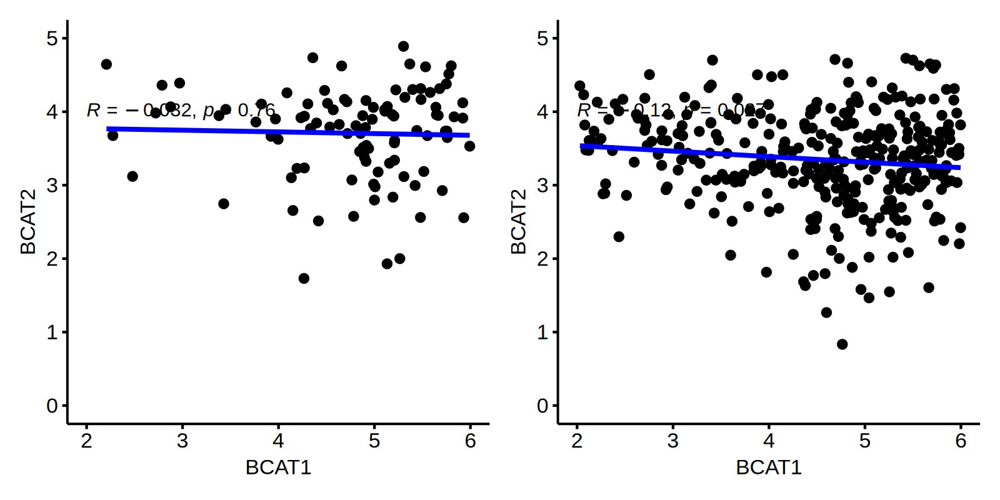

In [540]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 = ggscatter(beat_rna_clin_t[FLT3ITD == 'FLT3-ITD', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5) + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg2 = ggscatter(beat_rna_clin_t[FLT3ITD == 'WT', ], x = 'BCAT1', y = 'BCAT2', add = 'reg.line', add.params = list(color = 'blue', fill = 'lightgray')) + xlim(2, 6) + ylim(0, 5)  + stat_cor(method = "pearson", label.x = 2, label.y = 4)
gg1 | gg2

In [998]:
beat_rna_clin_t[, subtype := 'WT']
beat_rna_clin_t[FLT3ITD != 'WT', subtype := 'FLT3ITD']
beat_rna_clin_t[MLL_re != 'WT', subtype := 'MLL_re']
beat_rna_clin_t[AML1ETO != 'WT', subtype := 'AML1ETO']

Warning message:
"Removed 20 rows containing non-finite values (`stat_smooth()`)."
Warning message:
"Removed 20 rows containing missing values (`geom_point()`)."


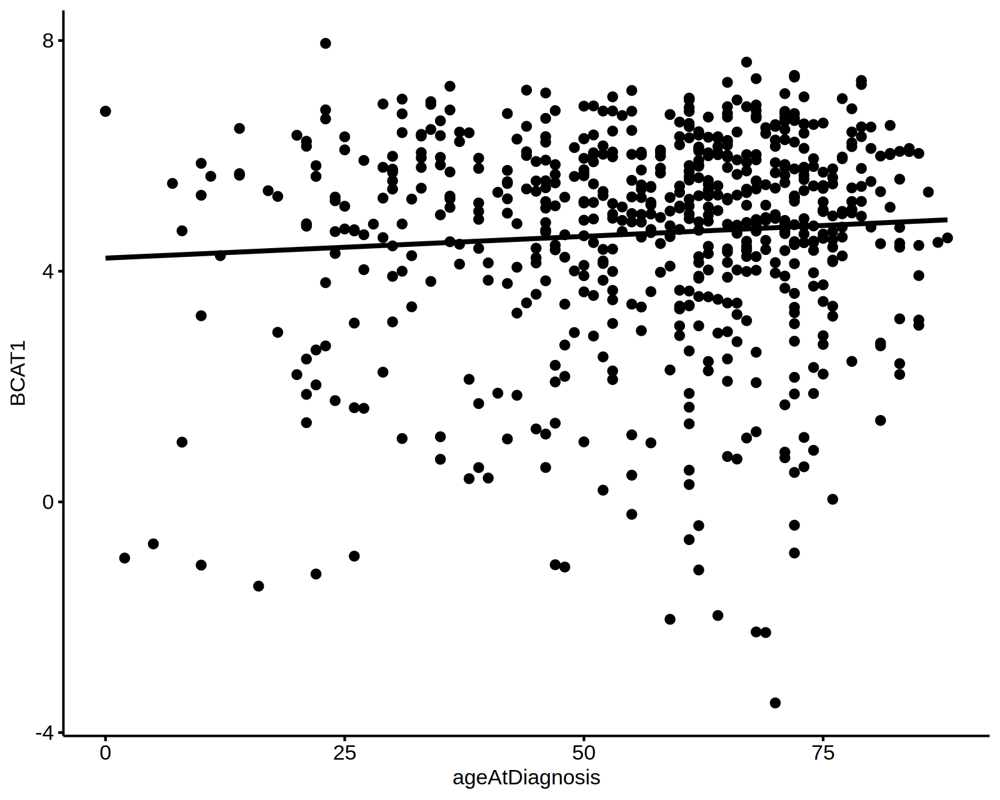

In [1001]:
ggscatter(beat_rna_clin_t, x = 'ageAtDiagnosis', y = 'BCAT1', col = 'subtype', add = 'reg.line')
#FLT3ITD == 'WT' & MLL_re == 'WT' & AML1ETO == 'WT', ]

## DEG BCAT1 hi vs lo

In [546]:
head2(beat_rna_clin_t)
dim(beat_rna_clin_t)

sampleName,TSPAN6,DPM1,SCYL3,C1orf112
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,-2.440122,7.314841,3.723787,4.551298
BA2003R,1.180018,7.261503,4.036186,2.780778
BA2004R,-1.760990,6.884307,4.415685,2.761738


[1]   671 22964

In [565]:
beat_rna_clin_t$group = cut_quantile(beat_rna_clin_t$BCAT1, 4)
dsn_sel = beat_rna_clin_t[group %in% c('Q1', 'Q4'), .(sampleName, group, BCAT1)]
dsn_sel$group = factor(dsn_sel$group, levels = c('Q1', 'Q4'))

beat_deg = deg_fun2(dsn_sel, mtx2[, dsn_sel$sampleName]) 

In [620]:
head(beat_deg)
head(tcga_deg)

rn,logFC,logCPM,PValue,FDR,rank
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
BCAT1,4.001531,6.5781398,2.220349e-214,1.319487e-209,208.87960
AC026310.1,3.966595,-1.8117120,3.254950e-112,9.671594e-108,107.01450
AC023796.2,3.541868,-3.1679539,5.279698e-97,1.045855e-92,91.98053
AC026310.2,3.487312,-0.8265287,2.478648e-75,3.682466e-71,70.43386
RBPMS,2.758789,4.5508440,3.699611e-74,4.397135e-70,69.35683
ADAM23,-4.886974,3.0405637,8.321450e-72,8.241980e-68,-67.08397


rn,logFC,logCPM,PValue,FDR,rank
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
BCAT1,4.066520,6.8951264,8.648005e-60,1.773792e-55,54.75110
DAD1L,3.523295,-0.5128236,1.335840e-47,1.369971e-43,42.86329
CLTCL1,-4.101091,5.7227690,1.588430e-27,1.086010e-23,-22.96417
SEPT11,1.501495,7.3267212,3.127777e-27,1.603846e-23,22.79484
RBPMS,2.943711,4.7901309,7.373260e-24,3.024659e-20,19.51932
SMARCD3,-2.539063,4.6415248,3.539691e-23,1.210043e-19,-18.91720


In [617]:
beat_fgsea_res = fgsea_fun(beat_deg, if_all_pathways = T) 
beat_fgsea_res[, UpDn := 'Dn' ]
beat_fgsea_res[NES > 0, UpDn := 'Up' ]
beat_fgsea_res[, UpDn := factor(UpDn, levels = c('Up', 'Dn'))]
beat_fgsea_res[, NES2 := abs(NES) ]


Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (11.18% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


  |==================================================================================================================================================================================| 100%



Warning message in fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize, :
"For some pathways, in reality P-values are less than 1e-50. You can set the `eps` argument to zero for better estimation."


In [618]:
head(beat_fgsea_res)

pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>
MULLIGHAN_MLL_SIGNATURE_2_UP,1.000000e-50,2.645200e-46,NA,-0.8341572,-2.494954,419,"CCL23, S....",Dn,2.494954
HAY_BONE_MARROW_NEUTROPHIL,6.553353e-50,8.667465e-46,1.842852,-0.8128040,-2.447886,446,LINC0048....,Dn,2.447886
MULLIGHAN_MLL_SIGNATURE_1_UP,7.288325e-48,6.426359e-44,1.803094,-0.8311210,-2.463732,383,"CCL23, S....",Dn,2.463732
JAATINEN_HEMATOPOIETIC_STEM_CELL_UP,2.427317e-38,1.605184e-34,1.608880,0.8619888,2.439385,318,"BCAT1, R....",Up,2.439385
TRAVAGLINI_LUNG_NEUTROPHIL_CELL,1.324813e-36,7.008790e-33,1.576374,-0.8014184,-2.362692,364,TP53INP2....,Dn,2.362692
MULLIGHAN_MLL_SIGNATURE_2_DN,1.190931e-33,5.250419e-30,1.509263,0.8551559,2.395492,279,"BCAT1, R....",Up,2.395492


Warning message in `[.data.table`(beat_fgsea_res, , `:=`(lbl, NULL)):
"Column 'lbl' does not exist to remove"
Warning message:
"Removed 26442 rows containing missing values (`geom_text_repel()`)."


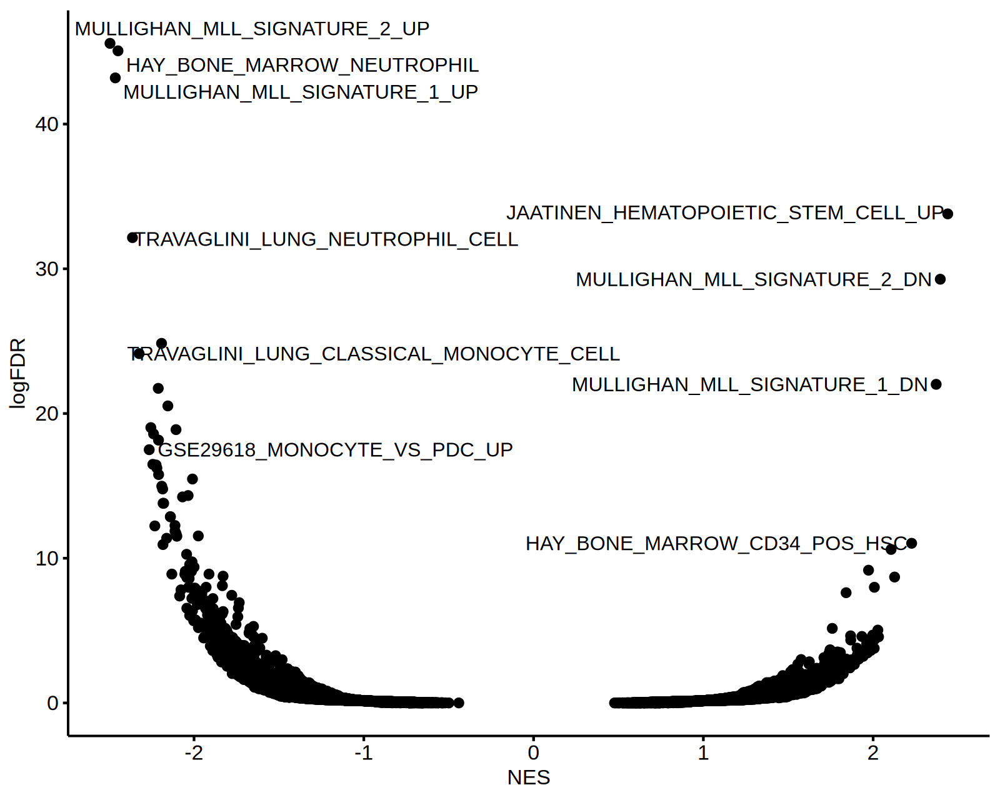

In [619]:
beat_fgsea_res[, logFDR := -log(padj, 10) ]
beat_fgsea_res[, lbl := NULL ]
beat_fgsea_res = beat_fgsea_res[order(NES, decreasing = T) ]
beat_fgsea_res[1:4, lbl := pathway ]
beat_fgsea_res = beat_fgsea_res[order(NES, decreasing = F) ]
beat_fgsea_res[1:6, lbl := pathway ]
options(repr.plot.width = 8, repr.plot.height = 6.4, repr.plot.res = 200)
ggscatter(beat_fgsea_res, x = 'NES', y = 'logFDR', label = 'lbl', repel = T) 


In [625]:
intersect(beat_fgsea_res[order(padj), ][1:10, pathway], tcga_fgsea_res[order(padj), ][1:10, pathway]) 

[1] "MULLIGHAN_MLL_SIGNATURE_2_UP"             "HAY_BONE_MARROW_NEUTROPHIL"               "MULLIGHAN_MLL_SIGNATURE_1_UP"             "JAATINEN_HEMATOPOIETIC_STEM_CELL_UP"     
[5] "MULLIGHAN_MLL_SIGNATURE_2_DN"             "REACTOME_NEUTROPHIL_DEGRANULATION"        "MULLIGHAN_MLL_SIGNATURE_1_DN"             "RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS"

In [572]:
library(msigdbr)

In [569]:
beat_rank = ranking_fun(beat_deg)

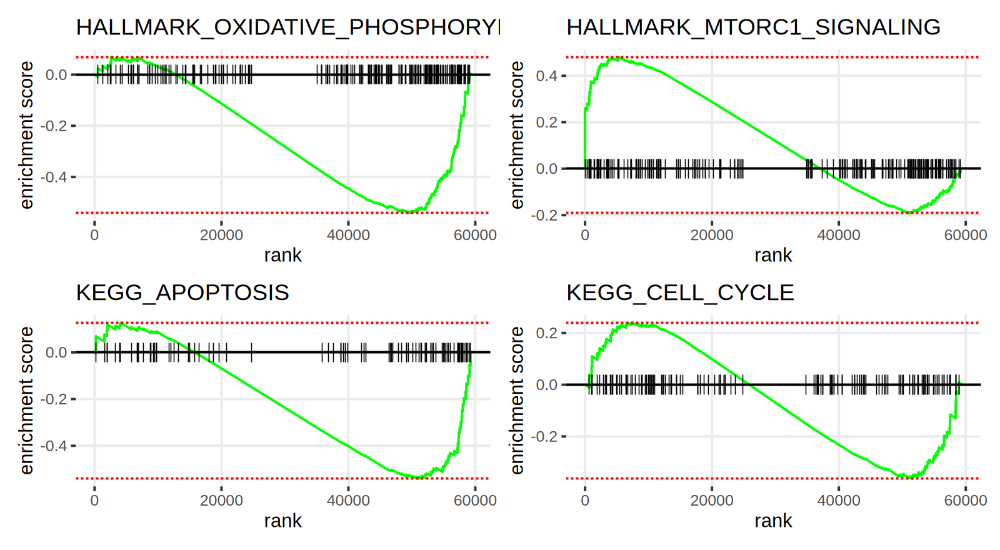

In [590]:
options(repr.plot.width = 8, repr.plot.height = 4.4, repr.plot.res = 200)
gg1 = plotEnrichment(pathways[["HALLMARK_OXIDATIVE_PHOSPHORYLATION"]], beat_rank) + labs(title="HALLMARK_OXIDATIVE_PHOSPHORYLATION") 
gg2 = plotEnrichment(pathways[["HALLMARK_MTORC1_SIGNALING"]], beat_rank) + labs(title="HALLMARK_MTORC1_SIGNALING")
gg3 = plotEnrichment(pathways[["KEGG_APOPTOSIS"]], beat_rank) + labs(title="KEGG_APOPTOSIS")
gg4 = plotEnrichment(pathways[["KEGG_CELL_CYCLE"]], beat_rank) + labs(title="KEGG_CELL_CYCLE")
(gg1 | gg2) / (gg3 | gg4)


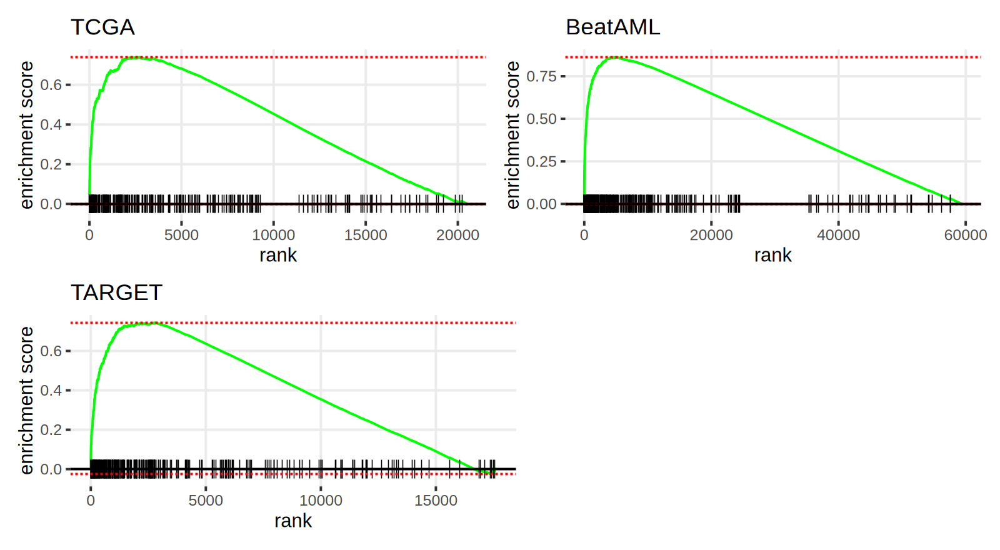

In [923]:
options(repr.plot.width = 8, repr.plot.height = 4.4, repr.plot.res = 200)
gg1 = plotEnrichment(pathways[["JAATINEN_HEMATOPOIETIC_STEM_CELL_UP"]], tcga_rank) + labs(title="TCGA") 
gg2 = plotEnrichment(pathways[["JAATINEN_HEMATOPOIETIC_STEM_CELL_UP"]], beat_rank) + labs(title="BeatAML") 
gg3 = plotEnrichment(pathways[["JAATINEN_HEMATOPOIETIC_STEM_CELL_UP"]], target_rank) + labs(title="TARGET") 
gg4 = plot_spacer()

(gg1 | gg2) / (gg3 + gg4) 


In [922]:
pathways[["JAATINEN_HEMATOPOIETIC_STEM_CELL_UP"]]

[1] "ABCC1"           "ABCC1"           "ABRAXAS1"        "ACACA"           "ACACA"           "ACSF2"           "ADAM28"          "ADAT2"           "ADGRA3"          "ADGRG6"         
 [11] "AKR1A1"          "AKR1C3"          "AKT3"            "AKT3"            "ALDH1A1"         "ALG10B"          "ANGPT1"          "ANKRD28"         "ANKRD6"          "AREG"           
 [21] "ARHGAP22"        "ARMCX1"          "ARMCX2"          "ASPH"            "ATP2C1"          "ATP6V0A2"        "ATP9A"           "B4GALT6"         "BAALC"           "BCAT1"          
 [31] "BCL11A"          "BEND4"           "BEX2"            "BIVM"            "BSPRY"           "BTBD3"           "C11orf54"        "C1QTNF4"         "C1QTNF4"         "CALN1"          
 [41] "CBX2"            "CBX5"            "CCDC171"         "CCDC6"           "CCNB1IP1"        "CD109"           "CD34"            "CDCA7"           "CDK2AP1"         "CDK4"           
 [51] "CDK6"            "CEP170"          "CEP170"          "CFH"             "CHRDL1"          "CHST13"          "CIBAR1"          "CMAHP"           "CNKSR3"          "COL24A1"        
 [61] "COL5A1"          "CPA3"            "CPSF3"           "CPT1A"           "CRACD"           "CREBZF"          "CRHBP"           "CRIM1"           "CRIM1"           "CRISPLD1"       
 [71] "CTHRC1"          "CYTL1"           "CYYR1"           "DAPK1"           "DDAH1"           "DEPTOR"          "DIPK1B"          "DKC1"            "DNMT3B"          "DOCK7"          
 [81] "DPPA4"           "DPY19L2"         "DPY19L3"         "DPY19L4"         "DPYSL3"          "DSG2"            "DST"             "DTL"             "EBPL"            "ECPAS"          
 [91] "EMP1"            "ENSG00000259658" "EOGT"            "ERG"             "ERLIN2"          "ERMP1"           "ETV6"            "F2R"             "F2RL1"           "FABP5"          
[101] "FAIM"            "FAM171B"         "FAM216A"         "FAM30A"          "FAM30A"          "FAM98B"          "FANCL"           "FGD5"            "FHL1"            "FLT3"           
[111] "FLVCR1"          "FRMD4B"          "FRMD6"           "GALNT7"          "GATA2"           "GATM"            "GCSH"            "GIHCG"           "GIHCG"           "GLIDR"          
[121] "GNA15"           "GNAI1"           "GOLIM4"          "GUCY1A1"         "HACD1"           "HADH"            "HDGFL3"          "HHEX"            "HLF"             "HMGA2"          
[131] "HMGCR"           "HOXA3"           "HOXA5"           "HOXA9"           "HOXB3"           "HPGDS"           "HSH2D"           "HSPB1"           "HSPD1"           "IGFBP7"         
[141] "IGLL1"           "IL18"            "IPO11"           "IPO7"            "IQGAP2"          "ISYNA1"          "ITGA9"           "ITM2C"           "ITPRIPL2"        "JADE3"          
[151] "JUP"             "KCTD15"          "KCTD3"           "KDM5B"           "KHDRBS3"         "KIT"             "LAPTM4B"         "LIMCH1"          "LINC00888"       "LPIN1"          
[161] "LRCH2"           "LRCH2"           "MACROH2A1"       "MAP7"            "MAP9"            "MAST4"           "MBLAC2"          "MCM5"            "ME3"             "MEG3"           
[171] "MEGF6"           "MEIS1"           "MEST"            "MICU3"           "MIR155HG"        "MIR221"          "MLLT3"           "MMP28"           "MMP28"           "MPL"            
[181] "MRNIP-DT"        "MRNIP-DT"        "MRPS27"          "MSH5"            "MSH5"            "MSH5"            "MSH5"            "MSH5"            "MSH5"            "MSH5"           
[191] "MSH5"            "MSI2"            "MSRB3"           "MYB"             "MYCT1"           "MYO5C"           "MZB1"            "NAP1L3"          "NASP"            "NDN"            
[201] "NDN"             "NEGR1"           "NKAIN2"          "NKX2-3"          "NME1"            "NPR3"            "NREP"            "NRIP1"           "NT5DC2"          "OBSL1"          
[211] "PAICS"           "PAIP1"           "PAM"             "PDE1A"           "PDGFC"           

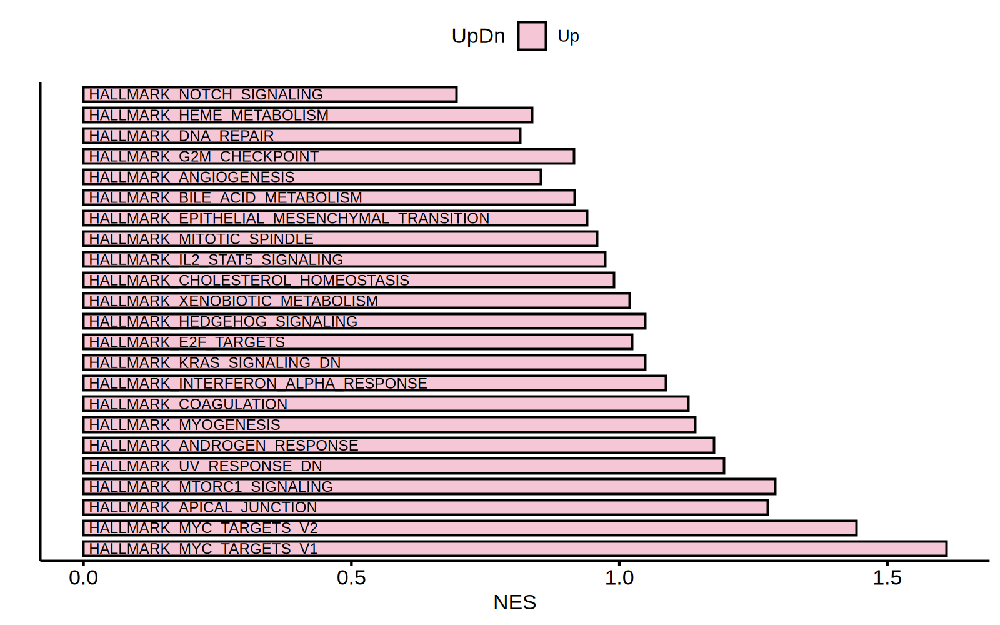

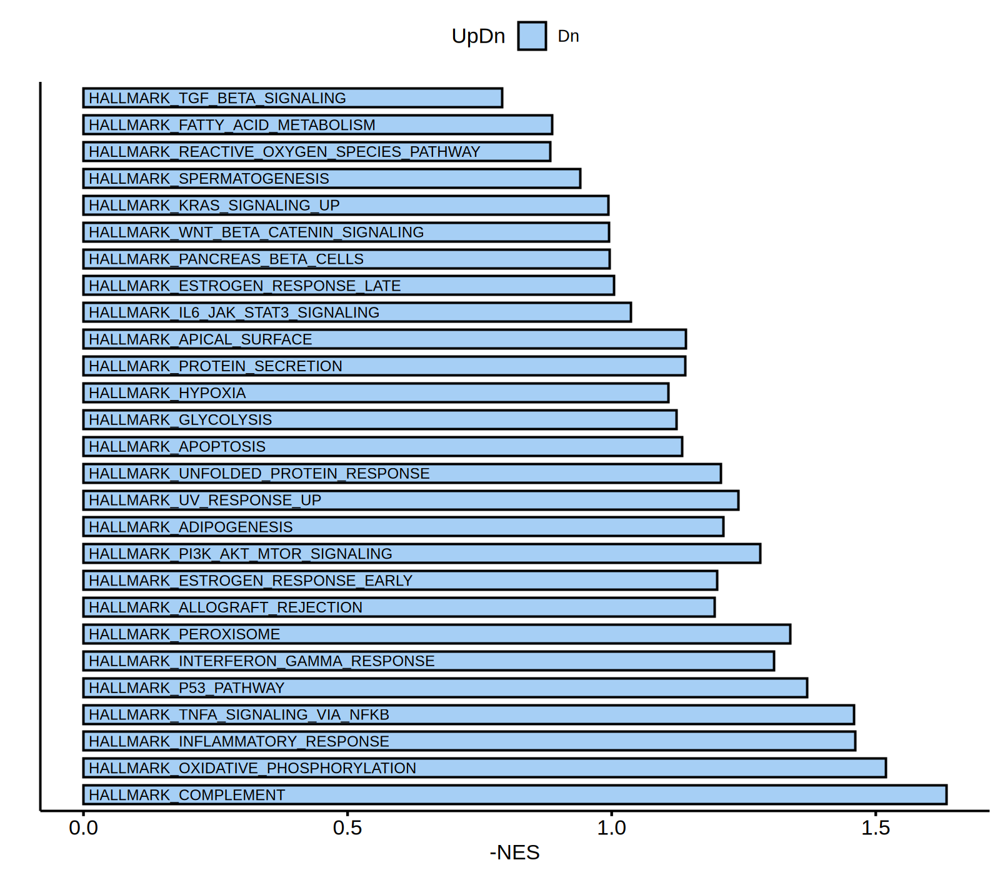

In [554]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
plotdat = fgsea_res[UpDn == 'Up', ]
plotdat[, xx := paste0('P', 1:nrow(plotdat))]
ggbarplot(plotdat, x = 'xx', y = 'NES2', fill = 'UpDn') + theme(axis.ticks.y = element_blank(), axis.text.y = element_blank()) + 
ylab('NES') + xlab('') + geom_text(data = plotdat, aes(x = xx, y = 0.01, label = pathway), inherit.aes = F, hjust = 0, size = 3) + coord_flip() +
scale_fill_manual(values = c("#f5c6d6")) 

options(repr.plot.width = 8, repr.plot.height = 7, repr.plot.res = 200) 
plotdat = fgsea_res[UpDn == 'Dn', ]
plotdat[, xx := paste0('P', 1:nrow(plotdat))]
ggbarplot(plotdat, x = 'xx', y = 'NES2', fill = 'UpDn') + theme(axis.ticks.y = element_blank(), axis.text.y = element_blank()) + 
ylab('-NES') + xlab('') + geom_text(data = plotdat, aes(x = xx, y = 0.01, label = pathway), inherit.aes = F, hjust = 0, size = 3) + coord_flip() +
scale_fill_manual(values = c("#a6cff5"))

## gene expression by molecular type

In [ ]:
vnames = c('BCAT1', 'BCAT2')
cnames = c('FLT3ITD', 'MLL_re', 'AML1ETO')
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    gg1 = ggboxplot(logcpm_t[batch == 'BeatAML', ], x = cname, y = vname, outlier.shape = NA, add = 'jitter', color = cname, width = .5) + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = 1))
    gg1
})
options(repr.plot.width = 12, repr.plot.height = 7, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 3, nrow = 2, top = '')

In [ ]:
vnames = genes
cnames = c('FLT3ITD', 'MLL_re', 'AML1ETO')
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    stat.test = logcpm_tcga_clin %>% select(!!sym(vname), !!sym(cname)) %>% 
    mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
    t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
    stat.test <- stat.test %>% add_xy_position(x = cname)
    gg1 = ggboxplot(logcpm_tcga_clin, x = cname, y = vname, outlier.shape = NA, add = 'jitter', color = cname, width = .5) + 
    stat_pvalue_manual(stat.test, label = "p") + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = 1))
    gg1
})
options(repr.plot.width = 12, repr.plot.height = 7, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 4, nrow = 3, top = '')

## Based on GDC data only

In [488]:
mtx = assay(beat_rna_gdc)
rownames(mtx) = beat_rna_gdc@rowRanges$gene_name
mtx = mtx[!duplicated(rownames(mtx)), ]
dim(mtx)
head2(mtx)

[1] 59427   735

,BA2861R,BA2477R,BA2244R,BA3089R,BA2619R
TSPAN6,2,1,13,1,9
TNMD,0,0,0,0,0
DPM1,1052,1800,1463,1185,1225


In [489]:
dge = DGEList(counts=mtx)
dge <- calcNormFactors(dge)

dge = normLibSizes(dge)
mtx_logcpm = cpm(dge, normalize = T, log = T)


In [490]:
head2(mtx_logcpm)

,BA2861R,BA2477R,BA2244R,BA3089R,BA2619R
TSPAN6,-3.164130,-3.901944,-1.500337,-3.899123,-1.465264
TNMD,-4.404309,-4.404309,-4.404309,-4.404309,-4.404309
DPM1,5.082644,5.147899,5.109012,4.555340,5.423399


In [491]:
head(beat_clin_gdc_split)

ERROR: Error in h(simpleError(msg, call)): error in evaluating the argument 'x' in selecting a method for function 'head': object 'beat_clin_gdc_split' not found


In [289]:
beat_rna_gdc_t = as.data.table(t(mtx_logcpm), keep.rownames = T)
beat_rna_gdc_t_clin = merge(beat_rna_gdc_t, beat_clin_gdc_split, by.x = 'rn', by.y = 'submitter_sample_ids', all.x = F, all.y = F)
setnames(beat_rna_gdc_t, 1, 'sampleName')
setnames(beat_rna_gdc_t_clin, 1, 'sampleName')
head2(beat_rna_gdc_t) 
dim(beat_rna_gdc_t) 
head2(beat_rna_gdc_t_clin) 
dim(beat_rna_gdc_t_clin) 


sampleName,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2861R,-3.164130,-4.404309,5.082644,4.090113
BA2477R,-3.901944,-4.404309,5.147899,4.470980
BA2244R,-1.500337,-4.404309,5.109012,4.533377


[1]   735 59428

sampleName,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,-3.82065863,-4.404309,5.196309,4.619664
BA2003R,0.04588601,-4.404309,5.344386,3.892485
BA2004R,-1.26575803,-4.404309,4.507710,4.425424


[1]   735 59535

In [300]:
tmp = copy(beat_clin_gdc_split)
tmp[, submitter_sample_ids := NULL]

In [303]:
head2(beat_clin_gdc_split)

project,submitter_id,disease_type,primary_site,irs_stage
<chr>,<chr>,<chr>,<chr>,<chr>
BEATAML1.0-COHORT,2533,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,NA
BEATAML1.0-COHORT,2533,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,NA
BEATAML1.0-COHORT,2533,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,NA


In [494]:
colnames(beat_clin)

[1] "project"                                  "submitter_id"                             "disease_type"                             "primary_site"                            
 [5] "submitter_id"                             "irs_stage"                                "iss_stage"                                "ajcc_pathologic_stage"                   
 [9] "ann_arbor_clinical_stage"                 "created_datetime"                         "enneking_msts_stage"                      "inrg_stage"                              
[13] "enneking_msts_metastasis"                 "tissue_or_organ_of_origin"                "age_at_diagnosis"                         "esophageal_columnar_dysplasia_degree"    
[17] "cog_liver_stage"                          "child_pugh_classification"                "metastasis_at_diagnosis_site"             "state"                                   
[21] "prior_treatment"                          "cog_rhabdomyosarcoma_risk_group"          "days_to_last_known_disease_status"        "inpc_grade"                              
[25] "ajcc_pathologic_t"                        "morphology"                               "ajcc_pathologic_n"                        "ajcc_pathologic_m"                       
[29] "irs_group"                                "medulloblastoma_molecular_classification" "wilms_tumor_histologic_subtype"           "residual_disease"                        
[33] "classification_of_tumor"                  "tumor_focality"                           "ann_arbor_b_symptoms"                     "icd_10_code"                             
[37] "cog_renal_stage"                          "figo_stage"                               "synchronous_malignancy"                   "burkitt_lymphoma_clinical_variant"       
[41] "days_to_best_overall_response"            "inss_stage"                               "eln_risk_classification"                  "supratentorial_localization"             
[45] "ishak_fibrosis_score"                     "tumor_confined_to_organ_of_origin"        "days_to_diagnosis"                        "goblet_cells_columnar_mucosa_present"    
[49] "laterality"                               "last_known_disease_status"                "days_to_last_follow_up"                   "primary_diagnosis"                       
[53] "ajcc_clinical_stage"                      "cog_neuroblastoma_risk_group"             "updated_datetime"                         "metastasis_at_diagnosis"                 
[57] "enneking_msts_tumor_site"                 "prior_malignancy"                         "year_of_diagnosis"                        "best_overall_response"                   
[61] "ann_arbor_pathologic_stage"               "ann_arbor_extranodal_involvement"         "method_of_diagnosis"                      "mitosis_karyorrhexis_index"              
[65] "ajcc_staging_system_edition"              "days_to_recurrence"                       "esophageal_columnar_metaplasia_present"   "ajcc_clinical_m"                         
[69] "ajcc_clinical_n"                          "ajcc_clinical_t"                          "inpc_histologic_group"                    "micropapillary_features"                 
[73] "diagnosis_id"                             "tumor_regression_grade"                   "site_of_resection_or_biopsy"              "first_symptom_prior_to_diagnosis"        
[77] "tumor_grade"                              "enneking_msts_grade"                      "gastric_esophageal_junction_involvement"  "progression_or_recurrence"               
[81] "treatments"                               "submitter_sample_ids"                     "cause_of_death"                           "race"                                    
[85] "gender"                                   "ethnicity"                                "vital_status"                             "age_at_index"                            
[89] "submitter_id"                             "days_to_birth"                            "year_of_birth" 

## 3 genes vs AML subtypes 

In [ ]:
plotdat = beat_rna_t[, c(genes, 'FLT3ITD', 'MLL_re', 'AML1ETO', 'MA9', 'OS_Month', 'stat'), with = F]
plotdat[is.na(FLT3ITD), FLT3ITD := 'WT']
plotdat[is.na(MLL_re),  MLL_re := 'WT']
plotdat[is.na(MA9),  MA9 := 'WT']
plotdat[is.na(AML1ETO), AML1ETO := 'WT']

plotdat[, FLT3ITD := factor(FLT3ITD) ]
plotdat[, MLL_re  := factor(MLL_re) ]
plotdat[, AML1ETO := factor(AML1ETO) ]
plotdat[, MA9     := factor(MA9) ]

plotdat[, FLT3ITD := relevel(FLT3ITD, ref = 'WT')]
plotdat[, MLL_re  := relevel(MLL_re, ref = 'WT')]
plotdat[, AML1ETO := relevel(AML1ETO, ref = 'WT')]
plotdat[, MA9     := relevel(MA9, ref = 'WT')]

plotdat[, BCAT1   := as.numeric(BCAT1)] 
plotdat[, BCAT2   := as.numeric(BCAT2)] 
plotdat[, SLC7A8  := as.numeric(SLC7A8)] 


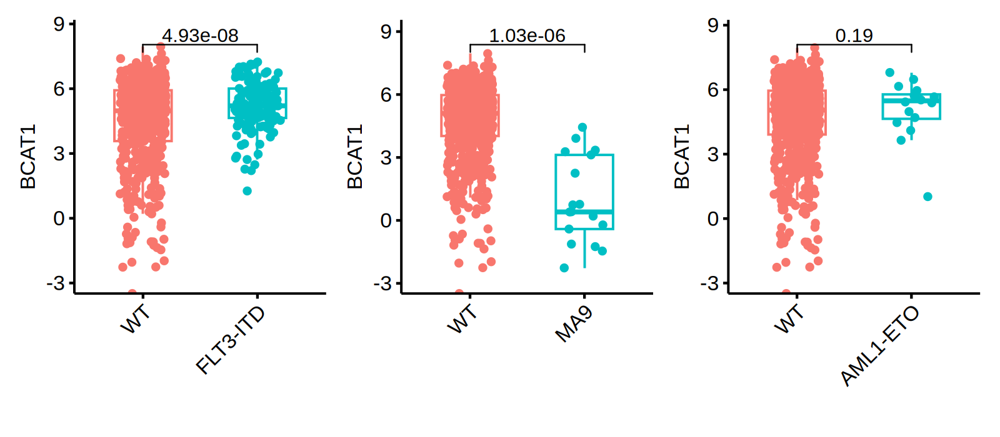

In [617]:
vname = 'BCAT1'
cname1 = 'FLT3ITD'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)

gg1 = ggboxplot(plotdat, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MA9'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)

gg2 = ggboxplot(plotdat, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)

gg3 = ggboxplot(plotdat, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


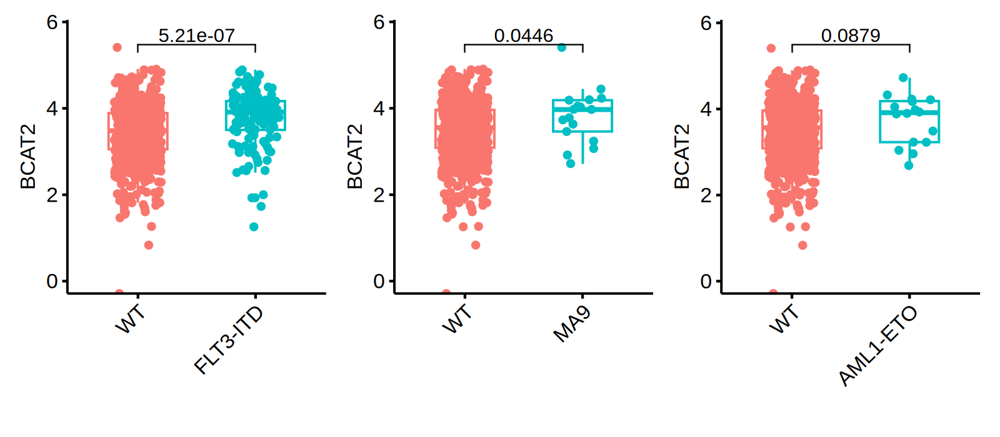

In [618]:
vname = 'BCAT2'
cname1 = 'FLT3ITD'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)

gg1 = ggboxplot(plotdat, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MA9'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)

gg2 = ggboxplot(plotdat, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)

gg3 = ggboxplot(plotdat, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


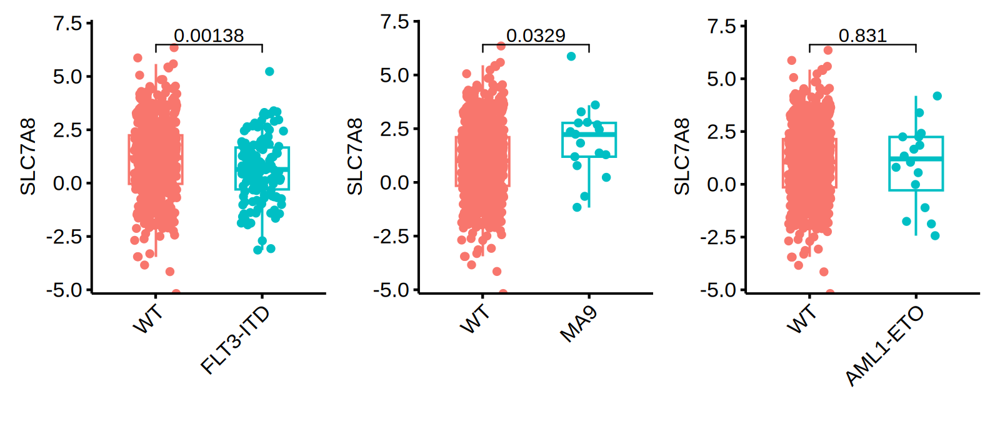

In [619]:
vname = 'SLC7A8'
cname1 = 'FLT3ITD'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)

gg1 = ggboxplot(plotdat, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MA9'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)

gg2 = ggboxplot(plotdat, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)

gg3 = ggboxplot(plotdat, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


## Beat AML survival analysis 

In [ ]:
table(plotdat$stat)

In [77]:
genes = c('BCAT1', 'BCAT2', 'SLC7A8')
genes_cat = c('BCAT1_cat', 'BCAT2_cat', 'SLC7A8_cat')

inv = lapply(1:length(genes), function(ii){
    gene = genes[ii]
    gene_cat = genes_cat[ii]
    gene_var = unlist(plotdat[, gene, with = F])
    plotdat[, (gene_cat) := factor(findInterval(gene_var, c(-Inf, mean(gene_var, na.rm = T),  Inf)),  labels=c("Low", "High") ) ]
})
rm(inv)

forms = paste0('Surv(OS_Month, stat) ~ ', genes_cat)
ff_list = lapply(forms, as.formula)
my_fits = surv_fit(ff_list, data = plotdat)
ggsurvs = ggsurvplot_list(my_fits, risk.table = F, pval = TRUE, data = plotdat, title = genes, ylab = 'Overall survival', xlim = c(0, 95))

options(repr.plot.width = 17, repr.plot.height = 5, repr.plot.res = 300)
arrange_ggsurvplots(ggsurvs, nrow = 1, ncol = 3)


ERROR: Error: column(s) not found: [BCAT1]


In [76]:
genes = c('BCAT1', 'BCAT2', 'SLC7A8')
genes_cat = c('BCAT1_cat', 'BCAT2_cat', 'SLC7A8_cat')

inv = lapply(1:length(genes), function(ii){
    gene = genes[ii]
    gene_cat = genes_cat[ii]
    gene_var = unlist(plotdat[, gene, with = F])
    plotdat[, (gene_cat) := factor(findInterval(gene_var, c(-Inf, mean(gene_var, na.rm = T),  Inf)),  labels=c("Low", "High") ) ]
})
rm(inv)

forms = paste0('Surv(OS_Month, stat) ~ ', genes_cat)
ff_list = lapply(forms, as.formula)
my_fits = surv_fit(ff_list, data = plotdat)
ggsurvs = ggsurvplot_list(my_fits, risk.table = F, pval = TRUE, data = plotdat, title = genes, ylab = 'Overall survival', xlim = c(0, 95))

options(repr.plot.width = 17, repr.plot.height = 5, repr.plot.res = 300)
arrange_ggsurvplots(ggsurvs, nrow = 1, ncol = 3)


ERROR: Error: column(s) not found: [BCAT1]


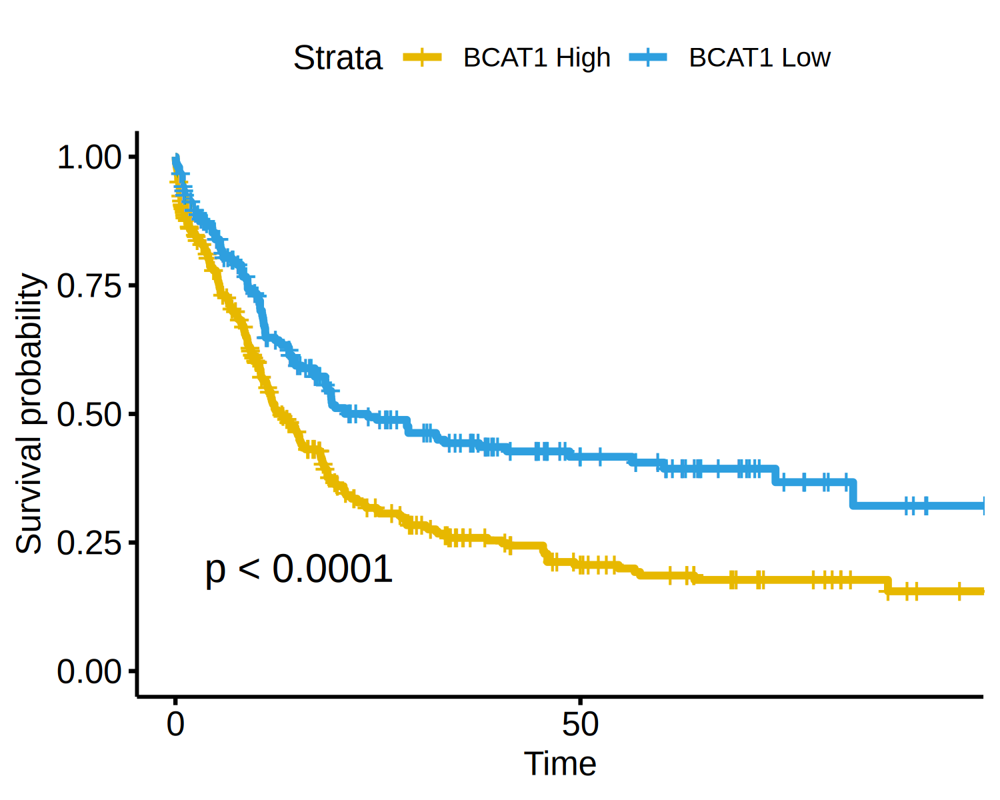

In [666]:
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_Month, stat) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           xlim = c(0, 95), 
           ggtheme = theme_pubr() )      # Change ggplot2 theme



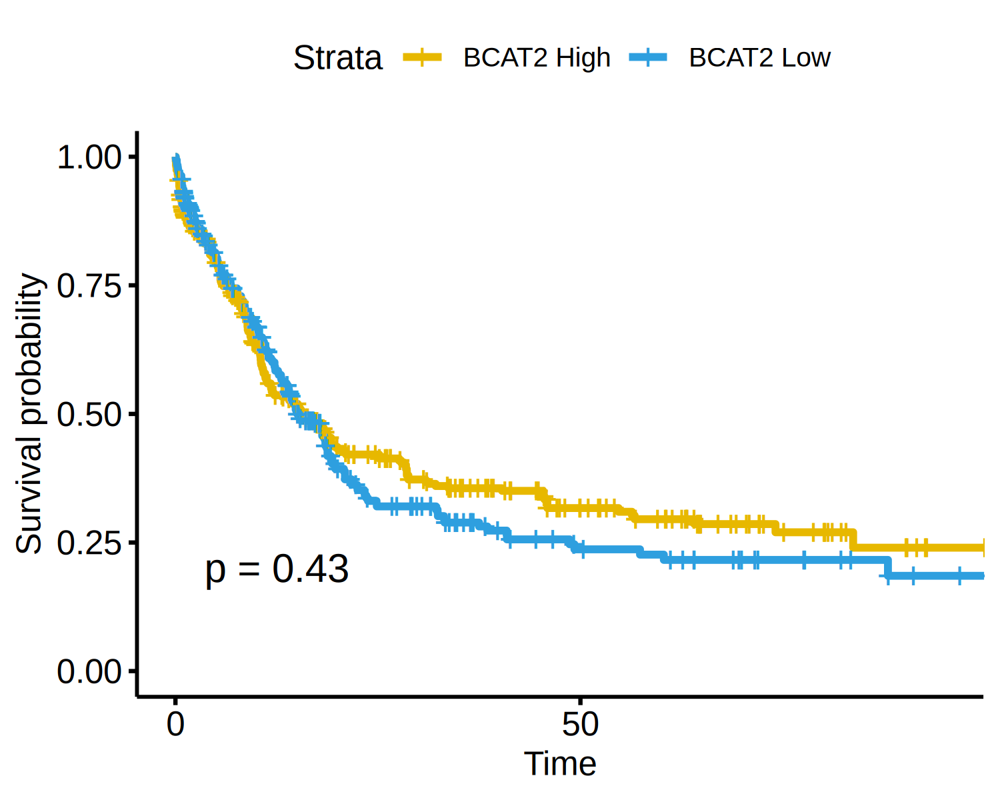

In [667]:
plotdat[, bcat2_lvl := 'low' ]
plotdat[BCAT2 > mean(plotdat$BCAT2, na.rm = T), bcat2_lvl := 'hi' ]
fit <- survfit(Surv(OS_Month, stat) ~ bcat2_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("BCAT2 High", "BCAT2 Low"),    # Change legend labels
           xlim = c(0, 95), 
           ggtheme = theme_pubr() )      # Change ggplot2 theme



In [316]:
genes = c('BCAT1', 'BCAT2', 'SLC7A8')
genes_cat = c('BCAT1_cat', 'BCAT2_cat', 'SLC7A8_cat')


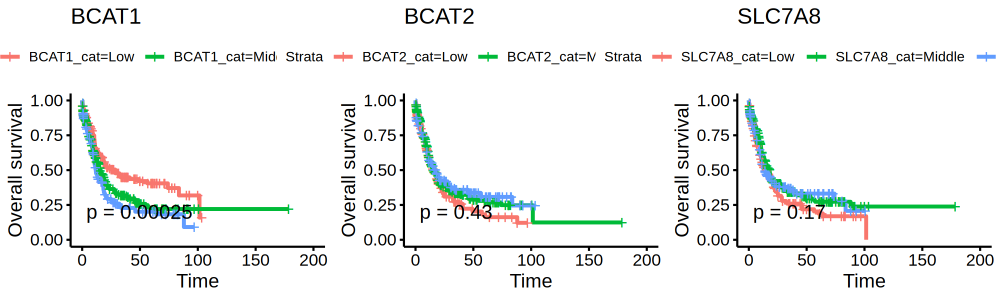

In [621]:
inv = lapply(1:length(genes), function(ii){
    gene = genes[ii]
    gene_cat = genes_cat[ii]
    gene_var = unlist(plotdat[, gene, with = F])
    plotdat[, (gene_cat) := factor(findInterval(gene_var, c(-Inf, quantile(gene_var, probs=c(0.25, .75)),  Inf)), 
                                        labels=c("Low", "Middle", "High") ) ]
})
rm(inv)

forms = paste0('Surv(OS_Month, stat) ~ ', genes_cat)
ff_list = lapply(forms, as.formula)
my_fits = surv_fit(ff_list, data = plotdat)
ggsurvs = ggsurvplot_list(my_fits, risk.table = F, pval = TRUE, data = plotdat, title = genes, ylab = 'Overall survival')

options(repr.plot.width = 10, repr.plot.height = 3, repr.plot.res = 200)
arrange_ggsurvplots(ggsurvs, nrow = 1, ncol = 3)


In [ ]:
# https://portal.gdc.cancer.gov/projects/BEATAML1.0-COHORT

## survival

In [473]:
table(logcpm_t$batch)


BeatAML  TARGET    TCGA 
    671    1087     173 

In [ ]:
plotdat = xx[, c('BCAT1', 'DNMT3A', aml_mut,'OS_STATUS', 'OS_MONTHS'), with =F ] 
plotdat = logcpm_t[grep('BeatAML', batch), ]
#plotdat = plotdat[DNMT3A_mut == 'WT', ]
#plotdat = plotdat[TET2_mut == 'WT', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[, dnmt_lvl := 'low' ]
plotdat[DNMT3A > mean(plotdat$DNMT3A, na.rm = T), dnmt_lvl := 'hi' ]
plotdat[, grp := paste0(bcat1_lvl, '_', dnmt_lvl)]
plotdat[DNMT3A_mut != 'WT', grp := 'DNMT3A_mut']
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ grp, data = plotdat)
options(repr.plot.width = 8, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr() )      # Change ggplot2 theme
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels



[1] 671   6

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 5 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 5 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 5 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 5 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


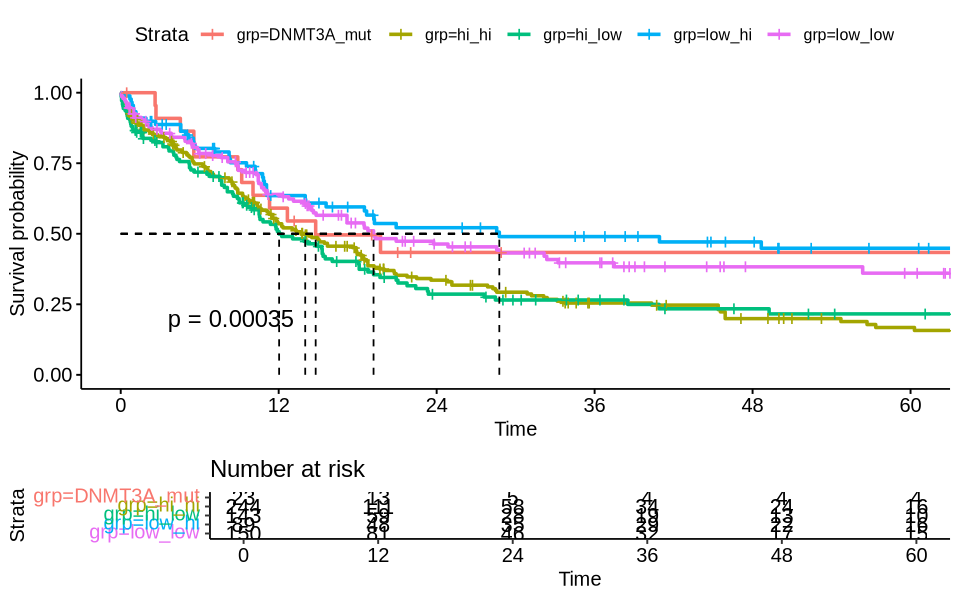

In [18]:
plotdat = logcpm_t[grep('BeatAML', batch), .(OS_STATUS, OS_MONTHS, BCAT1, DNMT3A, DNMT3A_mut)]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[, dnmt_lvl := 'low' ]
plotdat[DNMT3A > mean(plotdat$DNMT3A, na.rm = T), dnmt_lvl := 'hi' ]
plotdat[, grp := paste0(bcat1_lvl, '_', dnmt_lvl)]
plotdat[DNMT3A_mut != 'WT', grp := 'DNMT3A_mut']

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ grp, data = plotdat)
options(repr.plot.width = 8, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme


[1]   671 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


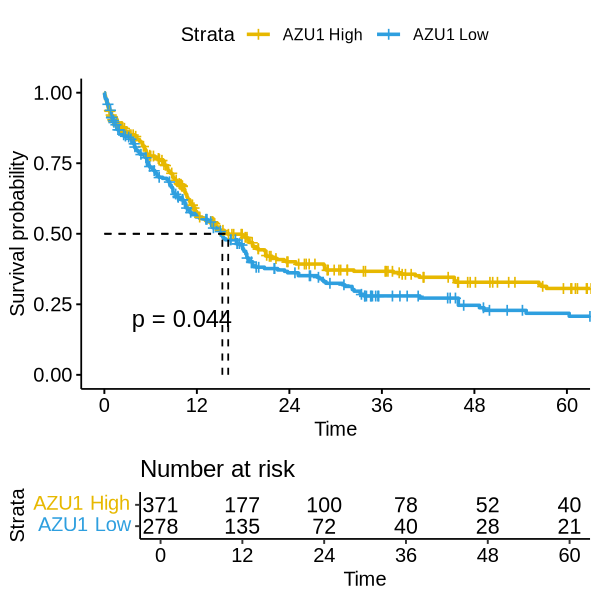

In [22]:
plotdat = logcpm_t[grep('BeatAML', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

gene = 'AZU1'
plotdat[, gene_lvl := 'low' ]
plotdat[plotdat[[gene]] > mean(plotdat[[gene]], na.rm = T), gene_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ gene_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  paste0(gene, c(" High", " Low")),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme


In [23]:
tail2(plotdat)

KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,GATA2MECOM,gene_lvl
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
WT,WT,WT,WT,,hi
WT,WT,WT,WT,,low
WT,WT,WT,WT,,hi
WT,WT,WT,WT,,low


In [590]:
dim(xx)

[1]   151 59477

In [ ]:
plotdat = logcpm_t[grep('TCGA', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)


In [592]:
head2(xx)

sampleName,TSPAN6,TNMD,DPM1,SCYL3
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
TCGA-AB-2805,-3.992524,-3.473114,4.802986,4.653374
TCGA-AB-2806,-3.171528,-3.171528,4.616453,4.641724
TCGA-AB-2808,-1.685588,-3.992524,4.452289,4.470339


In [593]:
head2(logcpm_t)

rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,0.02926131,0.4846250,0.18884637,0.1122339
BA2003R,0.90268049,0.4228661,0.03690553,0.3191444
BA2004R,0.75782187,0.3605750,0.02383337,1.0413694


[1]   173 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

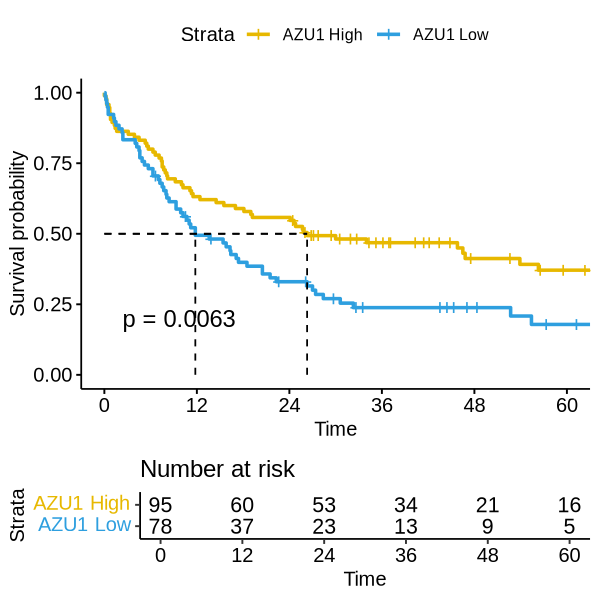

In [47]:
plotdat = logcpm_t[grep('TCGA', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

gene = 'AZU1'
plotdat[, gene_lvl := 'low' ]
plotdat[plotdat[[gene]] > mean(plotdat[[gene]], na.rm = T), gene_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ gene_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  paste0(gene, c(" High", " Low")),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme

pdf(file = '~/WenhuoHu/plot/azu1_surv.pdf', width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  paste0(gene, c(" High", " Low")),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1]   173 17639

pdf 
  2

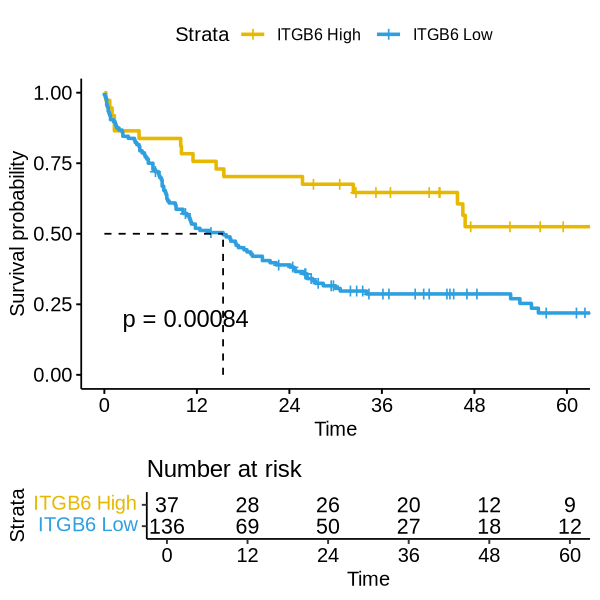

In [48]:
plotdat = logcpm_t[grep('TCGA', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

gene = 'ITGB6'
plotdat[, gene_lvl := 'low' ]
plotdat[plotdat[[gene]] > mean(plotdat[[gene]], na.rm = T), gene_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ gene_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  paste0(gene, c(" High", " Low")),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme

pdf(file = '~/WenhuoHu/plot/ITGB6_surv.pdf', width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  paste0(gene, c(" High", " Low")),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


In [594]:
dim(logcpm_t[rn %in% xx$sampleName, ])

[1]     0 17640

[1]   173 17640

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


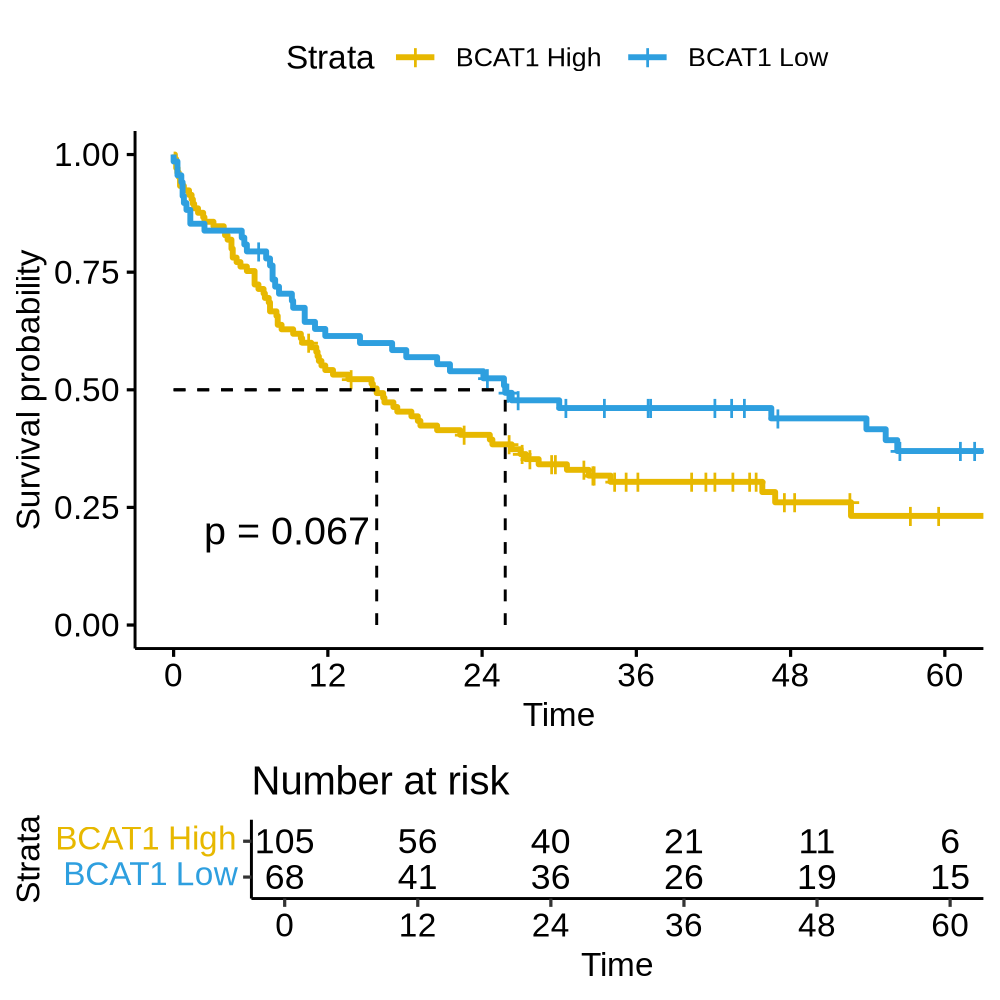

In [589]:
plotdat = logcpm_t[grep('TCGA', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme


[1]   671 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

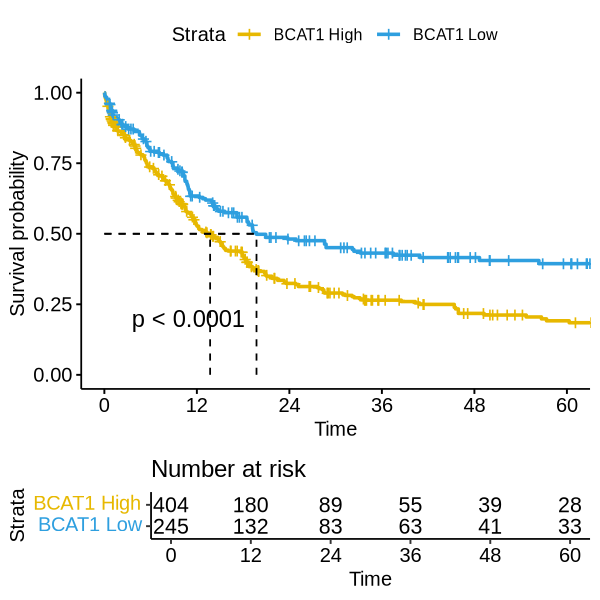

In [479]:
plotdat = logcpm_t[grep('BeatAML', batch), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_beat.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1]   644 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

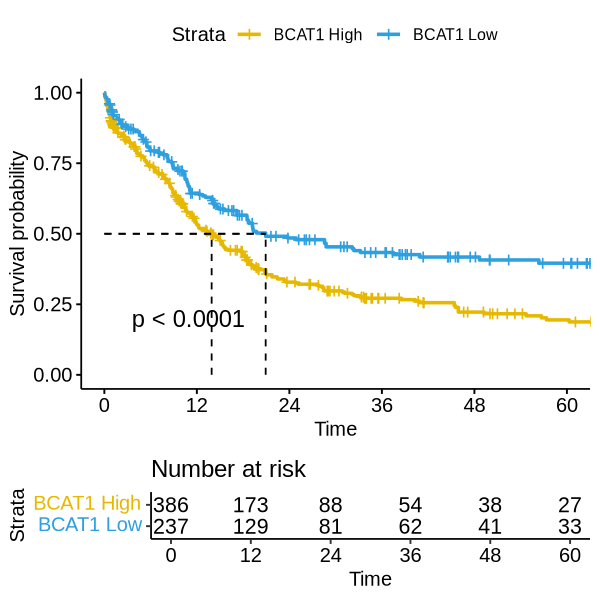

In [480]:
plotdat = logcpm_t[grep('BeatAML', batch), ]
plotdat = plotdat[TET2_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT', ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_beat_noMut.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


# import TARGET data for BCAT1 analysis 

In [873]:
raw_count = read.csv(file = 'data/data_jun20/raw_count.cvs', check.names = F) 
raw_count = as.matrix(setDF(raw_count[, 2:ncol(raw_count)], rownames = raw_count[, 1])) 

In [875]:
raw_count_target = raw_count[, grep('TARGET', colnames(raw_count))]
dim(raw_count_target)


[1] 17611  2185

In [876]:
logcpm_tmp = logcpm_fun(raw_count_target)


In [878]:
head2(logcpm_tmp)

,TARGET-20-PASNIY,TARGET-20-PASNKC,TARGET-20-PASNLR,TARGET-20-PASNAL,TARGET-20-PASNDA
UBE2Q2P2,0.2486435,1.296167,0.2852236,-0.2389536,3.406424
HMGB1P1,-1.3032722,-1.841529,-2.0241370,-2.3453575,-1.317771
RNU12-2P,-2.5356915,-2.532458,-2.5644239,-3.9069930,-2.095986


In [884]:
dsn_tmp = data.table(rn = colnames(raw_count_target))
dsn_tmp$BCAT1 = logcpm_tmp['BCAT1', ]
dsn_tmp$group = cut_quantile(dsn_tmp$BCAT1, 4)
dsn_tmp = dsn_tmp[group %in% c('Q1', 'Q4'), ]
dsn_tmp[, group := factor(group, levels = c('Q1', 'Q4'))]


In [885]:
head(dsn_tmp)

rn,BCAT1,group
<chr>,<dbl>,<fct>
TARGET-20-PASNIY,1.68677143,Q1
TARGET-20-PASNKC,2.76748881,Q1
TARGET-20-PASNLR,1.46179853,Q1
TARGET-20-PASNDA,0.09779847,Q1
TARGET-20-PATLKU,2.87742785,Q1
TARGET-20-PATLMH,6.81185472,Q4


In [888]:
target_deg = deg_fun2(dsn_tmp, mtx = raw_count_target[, dsn_tmp$rn])


In [896]:
head(target_deg)

rn,logFC,logCPM,PValue,FDR,rank
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
BCAT1,5.186307,6.446846,0.000000e+00,0.000000e+00,Inf
MMP28,3.658211,2.152480,1.107092e-218,9.748496e-215,214.0111
C2,-2.899480,3.015817,2.078530e-166,1.220167e-162,-161.9136
MRC1,4.117025,4.215343,1.001622e-165,4.409893e-162,161.3556
TBXA2R,2.380714,3.284728,2.036143e-163,7.171704e-160,159.1444
LRP4,3.107905,2.906073,1.584857e-155,4.651819e-152,151.3324


In [892]:
target_fgsea_res = fgsea_fun(target_deg, if_all_pathways = T) 
target_fgsea_res[, UpDn := 'Dn' ]
target_fgsea_res[NES > 0, UpDn := 'Up' ]
target_fgsea_res[, UpDn := factor(UpDn, levels = c('Up', 'Dn'))]
target_fgsea_res[, NES2 := abs(NES) ]


Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (2.72% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


  |==================================================================================================================================================================================| 100%



Warning message in `[.data.table`(target_fgsea_res, , `:=`(lbl, NULL)):
"Column 'lbl' does not exist to remove"
Warning message:
"Removed 25988 rows containing missing values (`geom_text_repel()`)."


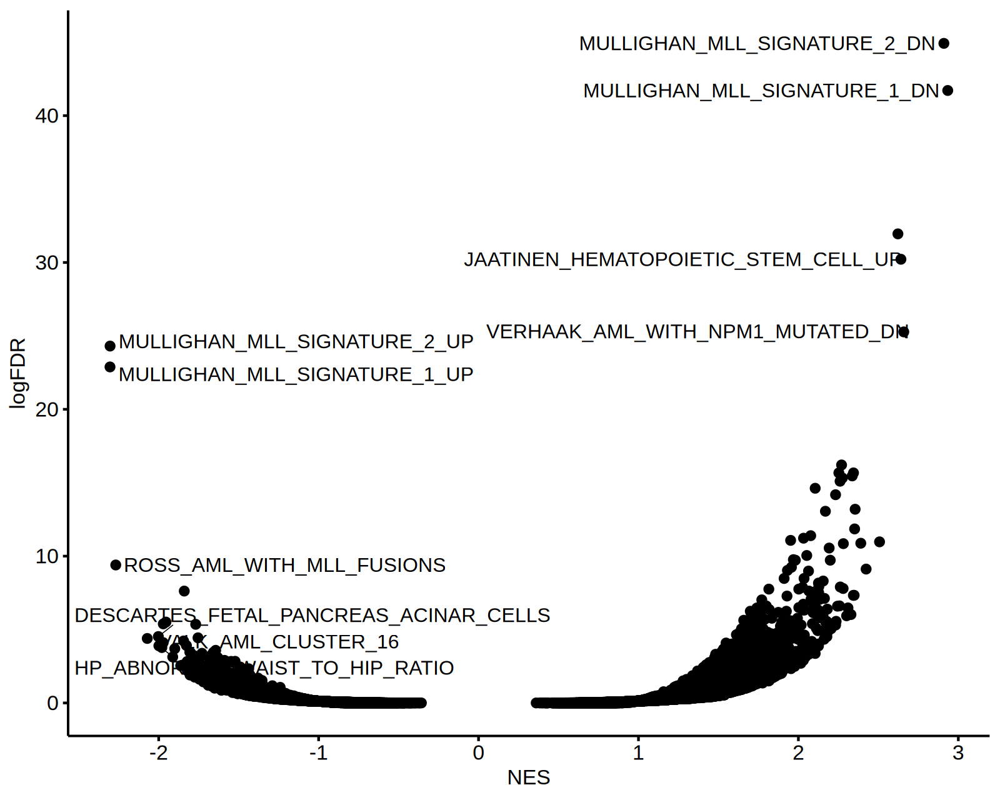

In [893]:
target_fgsea_res[, logFDR := -log(padj, 10) ]
target_fgsea_res[, lbl := NULL ]
target_fgsea_res = target_fgsea_res[order(NES, decreasing = T) ]
target_fgsea_res[1:4, lbl := pathway ]
target_fgsea_res = target_fgsea_res[order(NES, decreasing = F) ]
target_fgsea_res[1:6, lbl := pathway ]
options(repr.plot.width = 8, repr.plot.height = 6.4, repr.plot.res = 200)
ggscatter(target_fgsea_res, x = 'NES', y = 'logFDR', label = 'lbl', repel = T) 

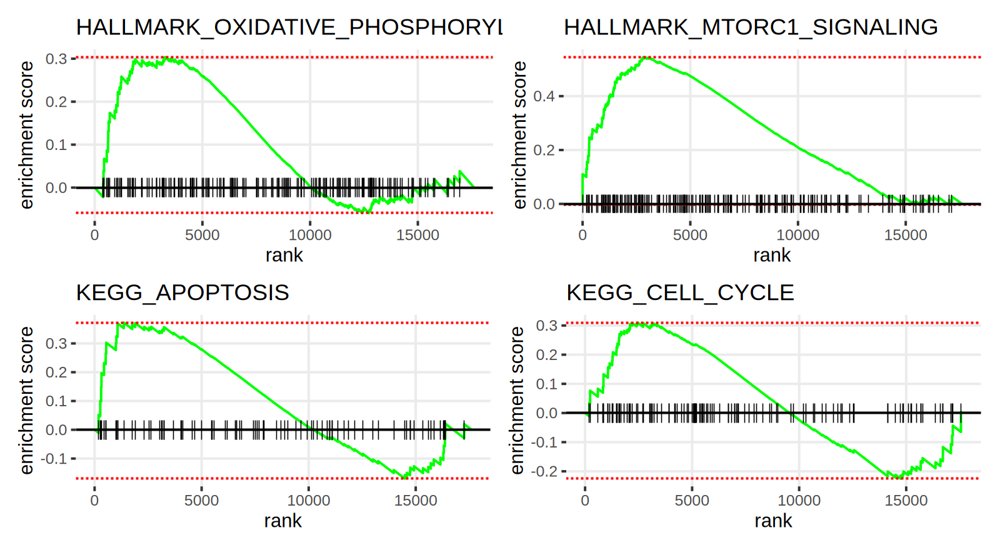

In [895]:
target_rank = ranking_fun(target_deg)
options(repr.plot.width = 8, repr.plot.height = 4.4, repr.plot.res = 200)
gg1 = plotEnrichment(pathways[["HALLMARK_OXIDATIVE_PHOSPHORYLATION"]], target_rank) + labs(title="HALLMARK_OXIDATIVE_PHOSPHORYLATION") 
gg2 = plotEnrichment(pathways[["HALLMARK_MTORC1_SIGNALING"]], target_rank) + labs(title="HALLMARK_MTORC1_SIGNALING")
gg3 = plotEnrichment(pathways[["KEGG_APOPTOSIS"]], target_rank) + labs(title="KEGG_APOPTOSIS")
gg4 = plotEnrichment(pathways[["KEGG_CELL_CYCLE"]], target_rank) + labs(title="KEGG_CELL_CYCLE")
(gg1 | gg2) / (gg3 | gg4)


In [699]:
target_rna = read.table(paste0(share_dir, 'TARGET_logcpm_2615cases.xls') , check.names = FALSE)
target_dsn = fread(paste0(share_dir, 'TARGET_clin_information_2615cases_filled.xls') )


In [685]:
head(target_dsn[, .(sample_name, `Age at Diagnosis in Days`) ])

sample_name,Age at Diagnosis in Days
<chr>,<int>
TARGET-20-PABGKN-09A,6641
TARGET-20-PABHET-09A,5368
TARGET-20-PABHET-03A,5368
TARGET-20-PABHKY-03A,4698
TARGET-20-PABLDZ-09A,2455
TARGET-20-PABLDZ-04A,2455


In [710]:
target_dsn[, age := `Age at Diagnosis in Days` ]


In [701]:
target_rna = read.table(paste0(share_dir, 'TARGET_logcpm_2615cases.xls') , check.names = FALSE)


In [706]:
target_dsn$BCAT1 = as.vector(t(target_rna['BCAT1', target_dsn$sample_name]))

Warning message:
"Removed 21 rows containing missing values (`geom_point()`)."


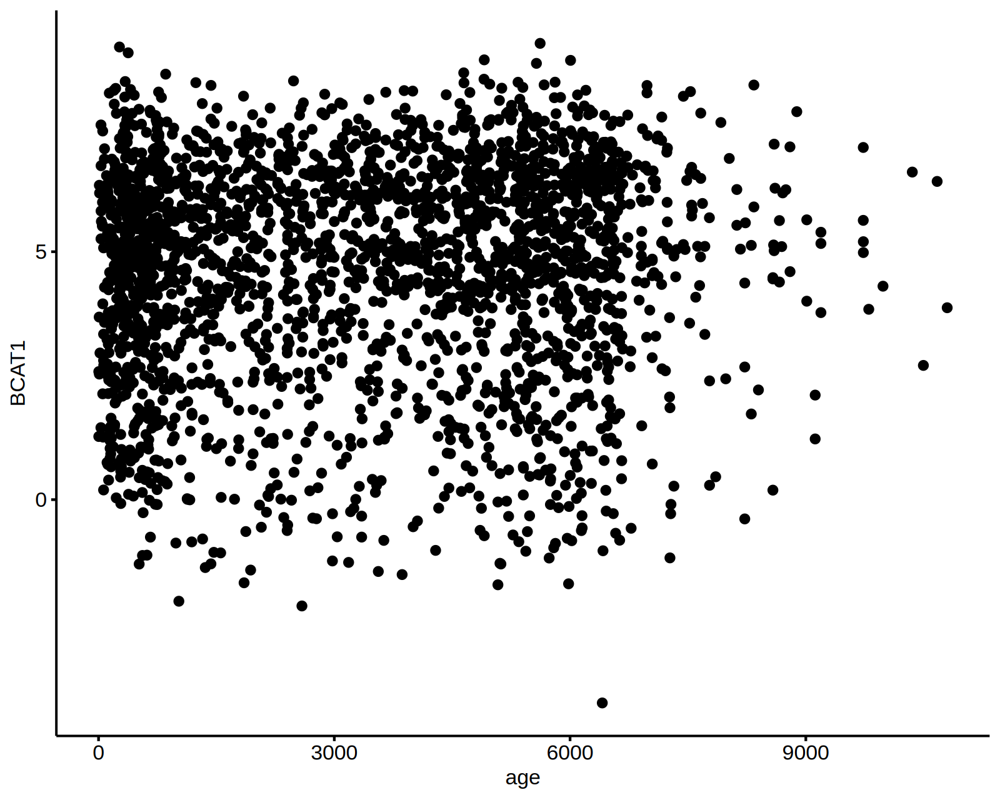

In [712]:
ggscatter(target_dsn, x = 'age', y = 'BCAT1')

In [924]:
head(tcga_fgsea_res) 

pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>
MULLIGHAN_MLL_SIGNATURE_2_UP,1.000000e-50,2.599800e-46,NA,-0.7600002,-2.643796,384,"CLTCL1, ....",Dn,2.643796,45.58506,MULLIGHAN_MLL_SIGNATURE_2_UP
MULLIGHAN_MLL_SIGNATURE_1_UP,6.696979e-49,5.803602e-45,1.825919,-0.7609378,-2.628566,348,"CLTCL1, ....",Dn,2.628566,44.23630,MULLIGHAN_MLL_SIGNATURE_1_UP
HAY_BONE_MARROW_NEUTROPHIL,5.932054e-50,7.711077e-46,1.842852,-0.7389948,-2.582264,403,"SMARCD3,....",Dn,2.582264,45.11288,HAY_BONE_MARROW_NEUTROPHIL
RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS,4.705133e-36,2.038734e-32,1.563182,-0.7252566,-2.490377,318,"PLAUR, S....",Dn,2.490377,31.69064,RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS
GSE6269_FLU_VS_STAPH_AUREUS_INF_PBMC_DN,9.452847e-21,1.170262e-17,1.177893,-0.7490809,-2.403164,156,"SMARCD3,....",Dn,2.403164,16.93172,GSE6269_FLU_VS_STAPH_AUREUS_INF_PBMC_DN
FAN_OVARY_CL13_MONOCYTE_MACROPHAGE,4.275630e-37,2.223156e-33,1.582928,-0.6848784,-2.399712,424,"PLAUR, S....",Dn,2.399712,32.65303,FAN_OVARY_CL13_MONOCYTE_MACROPHAGE


In [927]:
tmp = list(tcga_fgsea_res, beat_fgsea_res, target_fgsea_res)
names(tmp) = c('tcga', 'beat', 'target')
fgsea_res = rbindlist(tmp, idcol = T)
head(fgsea_res) 


.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>
tcga,MULLIGHAN_MLL_SIGNATURE_2_UP,1.000000e-50,2.599800e-46,NA,-0.7600002,-2.643796,384,"CLTCL1, ....",Dn,2.643796,45.58506,MULLIGHAN_MLL_SIGNATURE_2_UP
tcga,MULLIGHAN_MLL_SIGNATURE_1_UP,6.696979e-49,5.803602e-45,1.825919,-0.7609378,-2.628566,348,"CLTCL1, ....",Dn,2.628566,44.23630,MULLIGHAN_MLL_SIGNATURE_1_UP
tcga,HAY_BONE_MARROW_NEUTROPHIL,5.932054e-50,7.711077e-46,1.842852,-0.7389948,-2.582264,403,"SMARCD3,....",Dn,2.582264,45.11288,HAY_BONE_MARROW_NEUTROPHIL
tcga,RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS,4.705133e-36,2.038734e-32,1.563182,-0.7252566,-2.490377,318,"PLAUR, S....",Dn,2.490377,31.69064,RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS
tcga,GSE6269_FLU_VS_STAPH_AUREUS_INF_PBMC_DN,9.452847e-21,1.170262e-17,1.177893,-0.7490809,-2.403164,156,"SMARCD3,....",Dn,2.403164,16.93172,GSE6269_FLU_VS_STAPH_AUREUS_INF_PBMC_DN
tcga,FAN_OVARY_CL13_MONOCYTE_MACROPHAGE,4.275630e-37,2.223156e-33,1.582928,-0.6848784,-2.399712,424,"PLAUR, S....",Dn,2.399712,32.65303,FAN_OVARY_CL13_MONOCYTE_MACROPHAGE


In [977]:
pcut = 0.05
fgsea_res[, id := 1:nrow(fgsea_res) ]
fgsea_res[, sel := NULL ]
fgsea_res[, sel := {
    nrow_sig = nrow(.SD[padj < pcut, ])
    #if(nrow(.SD) ==3 & nrow_sig > 1 & length(intersect(.SD[padj < pcut, .id], 'target')) > 0){
    if(nrow(.SD) ==3 & nrow_sig > 1){
        nes1 = .SD[.id %in% c('tcga'), NES]
        nes2 = .SD[.id %in% c('beat'), NES]
        nes3 = .SD[.id %in% c('target'), NES]
        #message(.BY$pathway, '\t', nes1, '\t', nes2, '\t', nes3)
        if(sign(nes1) == sign(nes2)){
            if(sign(nes2) == sign(nes3)){
                'same'
            }else{
                'opposite'
            }
        }else{
            'inconsistent in adult'
        }
    }else{
        'not all sig'
    }
}, by = 'pathway' ]

In [958]:
table(fgsea_res$sel)


inconsistent in adult           not all sig              opposite                  same 
                  330                 75781                   150                  2187 

In [984]:
length(unique(fgsea_res[sel == 'opposite', pathway]) )

[1] 189

In [985]:
plotdat = fgsea_res[.id %in% c('beat', 'target') & sel == 'opposite', ][order(padj), ]
dim(plotdat)
head(plotdat)

[1] 378  15

.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl,id,sel
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>,<int>,<chr>
beat,REACTOME_NEUTROPHIL_DEGRANULATION,3.766891e-29,1.423454e-25,1.402589,-0.7252040,-2.191315,478,"GALNS, R....",Dn,2.191315,24.84666,NA,26014,opposite
beat,TRAVAGLINI_LUNG_CLASSICAL_MONOCYTE_CELL,2.198318e-28,7.268740e-25,1.380265,-0.8036548,-2.323314,270,C1orf162....,Dn,2.323314,24.13854,TRAVAGLINI_LUNG_CLASSICAL_MONOCYTE_CELL,26003,opposite
beat,RUBENSTEIN_SKELETAL_MUSCLE_MYELOID_CELLS,6.900722e-26,1.825379e-22,1.318889,-0.7552987,-2.210740,346,"SRGN, C1....",Dn,2.210740,21.73865,NA,26011,opposite
beat,FAN_OVARY_CL13_MONOCYTE_MACROPHAGE,6.385296e-23,1.299260e-19,1.237897,-0.6990418,-2.106151,456,"SRGN, C1....",Dn,2.106151,18.88630,NA,26027,opposite
beat,CUI_DEVELOPING_HEART_C8_MACROPHAGE,3.909010e-22,6.893408e-19,1.221054,-0.7664897,-2.209421,275,"SRGN, C1....",Dn,2.209421,18.16157,NA,26012,opposite
beat,GSE29618_MONOCYTE_VS_PDC_DAY7_FLU_VACCINE_UP,2.457976e-20,3.612132e-17,1.169070,-0.7968068,-2.223669,200,"PCSK5, A....",Dn,2.223669,16.44224,NA,26009,opposite


In [979]:
fgsea_res[grep('HALLMARK_OXIDATIVE_PHOSPHORYLATION', pathway), ]
plotdat[grep('HALLMARK_OXIDATIVE_PHOSPHORYLATION', pathway), ]

.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl,id,sel
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>,<int>,<chr>
tcga,HALLMARK_OXIDATIVE_PHOSPHORYLATION,7.188480e-08,4.386998e-06,0.7049757,-0.5705247,-1.866017,182,"ACADVL, ....",Dn,1.866017,5.357833,NA,211,opposite
beat,HALLMARK_OXIDATIVE_PHOSPHORYLATION,3.024397e-04,1.446679e-02,0.4984931,-0.5413047,-1.510633,200,"MPC1, AT....",Dn,1.510633,1.839628,NA,26760,opposite
target,HALLMARK_OXIDATIVE_PHOSPHORYLATION,3.047619e-01,6.365039e-01,0.1404062,0.3035660,1.043022,182,"MRPL15, ....",Up,1.043022,0.196199,NA,69198,opposite


.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl,id,sel
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>,<int>,<chr>
beat,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.0003024397,0.01446679,0.4984931,-0.5413047,-1.510633,200,"MPC1, AT....",Dn,1.510633,1.839628,NA,26760,opposite
target,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.3047619048,0.63650386,0.1404062,0.3035660,1.043022,182,"MRPL15, ....",Up,1.043022,0.196199,NA,69198,opposite


In [1006]:
plotdat[.id == 'target' & NES < 0, ]

.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,id,sel,lbl
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<int>,<chr>,<chr>
target,DESCARTES_FETAL_PANCREAS_ERYTHROBLASTS,9.037383e-06,0.0006055513,0.5933255,-0.5846917,-1.778906,118,"HBZ, HBG....",Dn,1.778906,3.217849,52482,opposite,NA
target,GSE34205_RSV_VS_FLU_INF_INFANT_PBMC_UP,2.039851e-04,0.0063461623,0.5188481,-0.5168446,-1.624353,162,"HTR7, PI....",Dn,1.624353,2.197489,52605,opposite,NA
target,GOMF_OLFACTORY_RECEPTOR_ACTIVITY,2.233907e-03,0.0341831146,0.4317077,-0.4019919,-1.384555,364,"OR52I2, ....",Dn,1.384555,1.466188,53333,opposite,NA


Warning message:
"Removed 365 rows containing missing values (`geom_text_repel()`)."


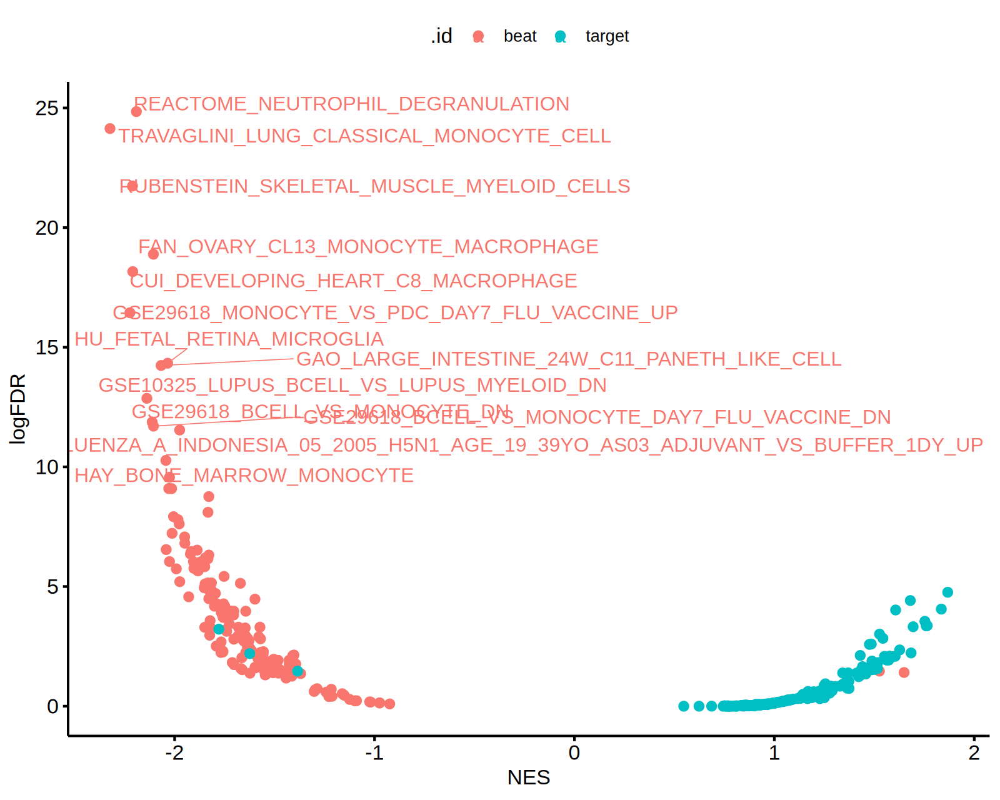

In [1005]:
options(repr.plot.width = 8, repr.plot.height = 6.4, repr.plot.res = 200)
plotdat = fgsea_res[.id %in% c('beat', 'target') & sel == 'opposite', ]
plotdat[, lbl := NULL ]
plotdat[logFDR > 10, lbl := pathway ]

ggscatter(plotdat, x = 'NES', y = 'logFDR', label = 'lbl', repel = T, color = '.id') 

In [1003]:
plotdat[grep('HALLMARK_OXIDATIVE_PHOSPHORYLATION', pathway), ]

.id,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,UpDn,NES2,logFDR,lbl,id,sel
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<fct>,<dbl>,<dbl>,<chr>,<int>,<chr>
beat,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.0003024397,0.01446679,0.4984931,-0.5413047,-1.510633,200,"MPC1, AT....",Dn,1.510633,1.839628,NA,26760,opposite
target,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.3047619048,0.63650386,0.1404062,0.3035660,1.043022,182,"MRPL15, ....",Up,1.043022,0.196199,NA,69198,opposite


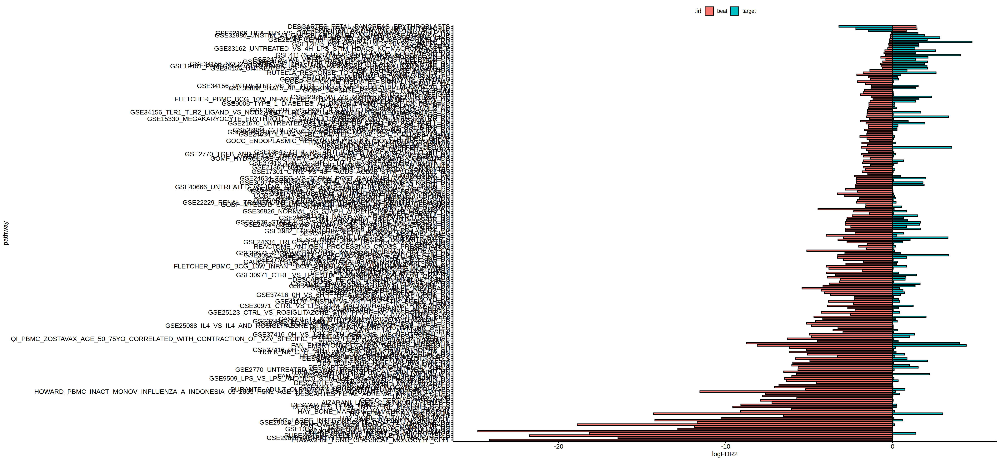

In [1004]:
options(repr.plot.width = 26, repr.plot.height = 12, repr.plot.res = 200)
plotdat = fgsea_res[.id %in% c('beat', 'target') & sel == 'opposite', ]
plotdat[, logFDR2 := logFDR * sign(NES)]
ggbarplot(plotdat, x = 'pathway', y = 'logFDR2', fill = '.id') + coord_flip()

In [957]:
dim(target_rna)

[1] 19938  2615

# combine two cohort2

## raw counts

In [1]:
dsn_batch

ERROR: Error: object 'dsn_batch' not found


In [350]:
dsn_2c = dsn_batch[batch %in% c('TCGA', 'BeatAML'), ]
raw_count_2c = raw_count[, dsn_2c$rn]
dim(raw_count_2c) 


[1] 17611   880

In [354]:
raw_count_adj <- ComBat_seq(raw_count_2c, batch=dsn_2c$batch, group=NULL)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [356]:
logcpm_2c = logcpm_fun(raw_count_adj)

In [366]:
logcpm_2c_t = as.data.table(t(logcpm_2c), keep.rownames = T)
ov = setdiff(colnames(logcpm_t), colnames(logcpm_2c_t))
logcpm_2c_t = merge(logcpm_2c_t, logcpm_t[, c('rn', ov), with = F], by = 'rn', all.x = T)
head(logcpm_2c_t) 


rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8,SDR16C6P,HSPB1P1,PPBPP1,GTPBP6,EFCAB12,⋯,PPM1D_mut,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,GATA2MECOM
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
BA2000R,-3.3000618,1.335585,-2.342690,-2.9061810,-3.84362,-1.3644861,-3.84362,5.554123,0.8910087,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
BA2003R,-1.2551066,1.238516,-3.204667,-2.4259184,-3.84362,-0.6174235,-3.84362,5.821225,1.8640774,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
BA2004R,-1.5670531,1.110243,-3.374230,-0.4890881,-3.84362,0.5745530,-3.84362,5.496571,1.2138294,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
BA2011R,-1.6807435,1.117228,-2.389953,0.4454542,-3.84362,-1.3485839,-3.84362,5.936447,0.7525470,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
BA2019R,-0.4301567,2.921254,-3.843620,-2.7335212,-3.84362,2.0838311,-3.84362,5.699378,1.2690600,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
BA2020R,-2.0067721,2.547946,-2.293106,-2.6507040,-3.84362,-1.0139368,-3.84362,5.896159,1.5867051,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT


In [28]:
head2(logcpm_t)

ERROR: Error in h(simpleError(msg, call)): error in evaluating the argument 'x' in selecting a method for function 'head': object 'logcpm_t' not found


In [368]:
head2(logcpm_2c_t)

rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,-3.300062,1.335585,-2.342690,-2.9061810
BA2003R,-1.255107,1.238516,-3.204667,-2.4259184
BA2004R,-1.567053,1.110243,-3.374230,-0.4890881


## BCAT1 expression 

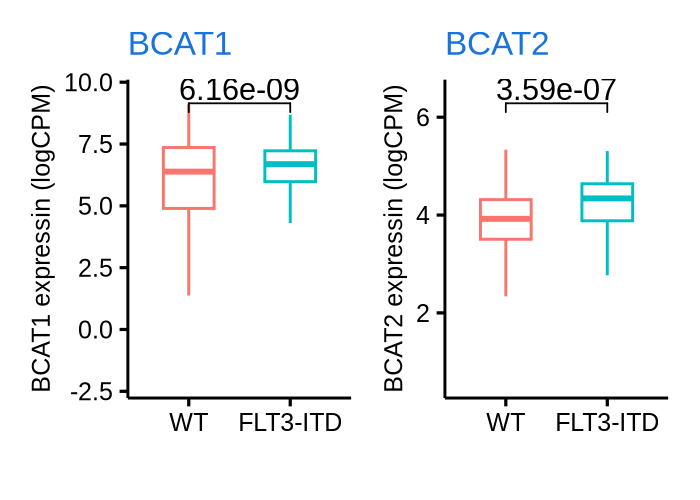

In [397]:
##### mar
plotdat = copy(logcpm_2c_t[!is.na(FLT3ITD), ])
plotdat[, FLT3ITD := factor(FLT3ITD, levels = c('WT', 'FLT3-ITD'))]

#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 3.5, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/mar/expression_BCAT12_both.pdf'), width = 3.5, height = 2.5)


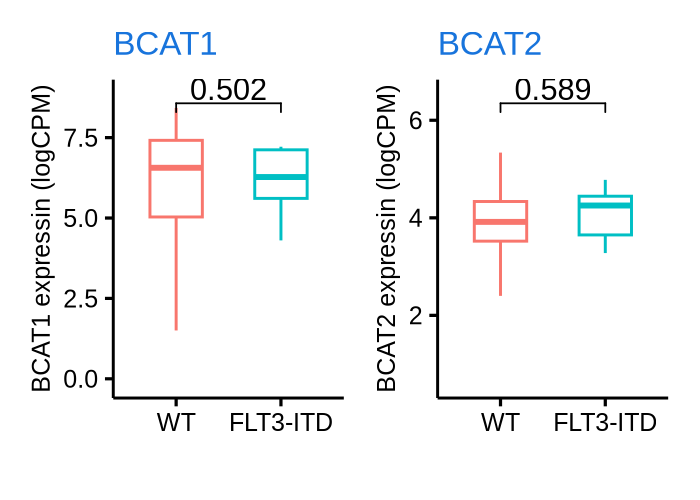

In [398]:
##### mar
plotdat = copy(logcpm_2c_t[!is.na(FLT3ITD) & batch == 'TCGA', ])
plotdat[, FLT3ITD := factor(FLT3ITD, levels = c('WT', 'FLT3-ITD'))]

#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 3.5, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/mar/expression_BCAT12_TCGA.pdf'), width = 3.5, height = 2.5)


In [ ]:
##### mar
plotdat = copy(logcpm_2c_t[!is.na(FLT3ITD) & batch == 'BeatAML', ])
plotdat[, FLT3ITD := factor(FLT3ITD, levels = c('WT', 'FLT3-ITD'))]

#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 3.5, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/mar/expression_BCAT12_BeatAML.pdf'), width = 3.5, height = 2.5)


# load 3 cohort for BCAT1 expression analysis

In [29]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [ ]:
logcpm_t = fread(file = 'data/batch_corrected_normalized_3cohort_with_basic_clinical_info.tsv')


In [898]:
dsn_3c = fread('data/batch_corrected_3cohort_design_table.tsv')

In [905]:
head(logcpm_t[, .(rn, batch, BCAT1)])

rn,batch,BCAT1
<chr>,<chr>,<dbl>
BA2000R,BeatAML,3.920193
BA2003R,BeatAML,3.869503
BA2004R,BeatAML,3.960267
BA2011R,BeatAML,3.790495
BA2019R,BeatAML,4.484909
BA2020R,BeatAML,2.528706


In [ ]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 300)
ggboxplot(logcpm_t[, .(rn, batch, BCAT1)], x = 'batch', y = 'BCAT1')

In [897]:
dim(logcpm_t)
head(logcpm_t)

[1]  1931 17618

rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8,SDR16C6P,HSPB1P1,PPBPP1,GTPBP6,EFCAB12,⋯,ZYX,ZZEF1,ZZZ3,AKR1C6P,batch,OS_STATUS,OS_MONTHS,MLL_re,FLT3ITD,AML1ETO
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
BA2000R,0.02926131,0.4846250,0.18884637,0.1122339,0,0.1122339,0,3.915470,1.897842,⋯,5.936752,5.347596,4.340146,0.02926131,BeatAML,1,20.925620,WT,FLT3-ITD,WT
BA2003R,0.90268049,0.4228661,0.03690553,0.3191444,0,0.2034060,0,4.137656,2.575903,⋯,6.346626,5.543146,4.113977,0.29144123,BeatAML,1,8.495868,WT,FLT3-ITD,WT
BA2004R,0.75782187,0.3605750,0.02383337,1.0413694,0,0.5444091,0,3.834550,2.075757,⋯,5.726868,6.153414,4.082155,0.06986087,BeatAML,1,11.272727,WT,WT,WT
BA2011R,0.70116448,0.3463987,0.17241135,1.5996898,0,0.1069691,0,4.180953,1.780018,⋯,6.844946,6.058742,3.713674,0.03694244,BeatAML,0,10.115702,WT,WT,WT
BA2019R,1.26473146,1.5293057,0.00000000,0.2096319,0,1.3346557,0,3.955835,2.087743,⋯,5.448280,5.146951,4.385431,1.17524927,BeatAML,1,5.586777,WT,WT,WT
BA2020R,0.53412315,1.2472955,0.18373763,0.2167557,0,0.1320719,0,4.130938,2.337846,⋯,5.134402,4.768515,4.534286,0.00000000,BeatAML,0,25.190083,WT,FLT3-ITD,WT


# TARGET based on GDC database

## downwload fusion gene information

In [ ]:

query = GDCquery(
    project = "TCGA-ACC",
    data.category = "Proteome Profiling",
    sample.type = "Primary Tumor", 
    legacy = FALSE)

manifest <- getManifest(query)
TCGAbiolinks:::GDCdownload.aux(
    server = "https://api.gdc.cancer.gov/data/",
    manifest = manifest,
    name = "test.tar.gz",
    path = "Test"
)


In [ ]:
query <- GDCquery(project = "TARGET-AML", data.category = 'Structural Variation') 


In [561]:
res = as.data.table(getResults(query))

In [568]:
fwrite(res, file = 'GDCdata/TARGET-AML/fusion/manifest_targetAML_sv.tsv', sep = '\t')

In [9]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [566]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [565]:
res = res[data_format == 'TSV', ]
dim(res)
fwrite(res, file = 'manifest_fusion_target.tsv', sep = '\t')
datatable(head(res))

[1] 6362   30

HTML widgets cannot be represented in plain text (need html)

In [134]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [5]:
res = fread('manifest_fusion_target.tsv')

In [ ]:
cd /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/GDCdata/TARGET-AML/fusion
singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/gdc-client_latest.sif gdc-client download -t ~/gdc-user-token.2024-08-27T02_39_51.215Z.txt -m manifest_targetAML_sv.tsv


In [7]:
res[, fname := paste0('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/GDCdata/TARGET-AML/fusion/', id, '/', file_name) ]

In [8]:
all(file.exists(res$fname))

[1] TRUE

In [9]:
table(res$analysis_workflow_type)


     Arriba STAR-Fusion 
       3181        3181 

In [10]:
tmp = res[analysis_workflow_type == 'STAR-Fusion', ]
star_fusion_list = lapply(tmp$fname, function(fname){fread(fname)})
names(star_fusion_list) = tmp$sample.submitter_id
star_fusion_dt = rbindlist(star_fusion_list, idcol = T, fill = T)
star_fusion_dt$pipeline = 'STAR-Fusion'
setnames(star_fusion_dt, 2, 'FusionName')
star_fusion_dt[, patient_name := substr(.id, 1, 16) ]
head(star_fusion_dt) 


.id                  FusionName     JunctionReadCount SpanningFragCount SpliceType          LeftGene                 LeftBreakpoint    RightGene                  RightBreakpoint  
1 TARGET-20-PAVDAJ-09A HUWE1--WNK3     5                  4               ONLY_REF_SPLICE     HUWE1^ENSG00000086758.16 chrX:53680049:-   WNK3^ENSG00000196632.10    chrX:54251687:-  
2 TARGET-20-PAXBXU-09A DEK--NUP214    63                 82               ONLY_REF_SPLICE     DEK^ENSG00000124795.17   chr6:18236452:-   NUP214^ENSG00000126883.17  chr9:131159383:+ 
3 TARGET-20-PAXBXU-09A PPRC1--TECTB   11                 12               INCL_NON_REF_SPLICE PPRC1^ENSG00000148840.11 chr10:102148572:+ TECTB^ENSG00000119913.6    chr10:112293738:+
4 TARGET-20-PAXBXU-09A PPRC1--TECTB    3                 12               ONLY_REF_SPLICE     PPRC1^ENSG00000148840.11 chr10:102147392:+ TECTB^ENSG00000119913.6    chr10:112293738:+
5 TARGET-20-PAXBXU-09A PPRC1--TECTB    2                 12               ONLY_REF_SPLICE     PPRC1^ENSG00000148840.11 chr10:102148521:+ TECTB^ENSG00000119913.6    chr10:112293738:+
6 TARGET-20-PAWDKU-09A RUNX1--RUNX1T1 77                129               ONLY_REF_SPLICE     RUNX1^ENSG00000159216.19 chr21:34859474:-  RUNX1T1^ENSG00000079102.16 chr8:92017363:-  
  JunctionReads                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [18]:
star_fusion_dt[, right_chr := sub(':.*', '', RightBreakpoint) ]
star_fusion_dt[, right_pos := sub('.*:(.*):.*', '\\1', RightBreakpoint) ]
star_fusion_dt[, left_chr := sub(':.*', '', LeftBreakpoint) ]
star_fusion_dt[, left_pos := sub('.*:(.*):.*', '\\1', LeftBreakpoint) ]
head(star_fusion_dt) 


.id,FusionName,JunctionReadCount,SpanningFragCount,SpliceType,LeftGene,LeftBreakpoint,RightGene,RightBreakpoint,JunctionReads,⋯,LeftBreakEntropy,RightBreakDinuc,RightBreakEntropy,annots,pipeline,patient_name,right_chr,right_pos,left_chr,left_pos
<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TARGET-20-PAVDAJ-09A,HUWE1--WNK3,5,4,ONLY_REF_SPLICE,HUWE1^ENSG00000086758.16,chrX:53680049:-,WNK3^ENSG00000196632.10,chrX:54251687:-,"&CBDRDANXX.5@HS27_165:5:2103:11292:20249,&CBDRDANXX.5@HS27_165:5:2312:8189:23401,&CBDRDANXX.5@HS27_165:5:1106:4312:25768,&CBDRDANXX.5@HS27_165:5:1315:5917:63167,&CBDRDANXX.5@HS27_165:5:2115:16114:99111",⋯,1.6895,AG,1.7819,"[""INTRACHROMOSOMAL[chrX:0.51Mb]""]",STAR-Fusion,TARGET-20-PAVDAJ,chrX,54251687,chrX,53680049
TARGET-20-PAXBXU-09A,DEK--NUP214,63,82,ONLY_REF_SPLICE,DEK^ENSG00000124795.17,chr6:18236452:-,NUP214^ENSG00000126883.17,chr9:131159383:+,"&CBD2PANXX.4@HS27_171:4:1204:12295:89963,&CBD2PANXX.4@HS27_171:4:2213:14343:26870,&CBD2PANXX.4@HS27_171:4:2214:12087:37701,&CBD2PANXX.4@HS27_171:4:2305:5041:51764,&CBD2PANXX.4@HS27_171:4:1209:21165:64314,&CBD2PANXX.4@HS27_171:4:2309:5016:44940,&CBD2PANXX.4@HS27_171:4:1314:3502:63173,&CBD2PANXX.4@HS27_171:4:1301:4523:5888,&CBD2PANXX.4@HS27_171:4:1209:3882:28025,&CBD2PANXX.4@HS27_171:4:1205:8867:48207,&CBD2PANXX.4@HS27_171:4:1106:12726:26954,&CBD2PANXX.4@HS27_171:4:1303:17268:10312,&CBD2PANXX.4@HS27_171:4:2201:8756:76294,&CBD2PANXX.4@HS27_171:4:2303:15810:64842,&CBD2PANXX.4@HS27_171:4:2316:11236:41876,&CBD2PANXX.4@HS27_171:4:1115:14999:66402,&CBD2PANXX.4@HS27_171:4:2313:12999:32289,&CBD2PANXX.4@HS27_171:4:1305:6571:52658,&CBD2PANXX.4@HS27_171:4:2108:10647:24412,&CBD2PANXX.4@HS27_171:4:2205:20455:84491,&CBD2PANXX.4@HS27_171:4:2209:14754:87698,&CBD2PANXX.4@HS27_171:4:2113:3799:19949,&CBD2PANXX.4@HS27_171:4:2207:12222:28842,&CBD2PANXX.4@HS27_171:4:2305:15229:93798,&CBD2PANXX.4@HS27_171:4:1309:7159:28149,&CBD2PANXX.4@HS27_171:4:1108:4972:79580,&CBD2PANXX.4@HS27_171:4:1210:14572:57479,&CBD2PANXX.4@HS27_171:4:2309:20832:46780,&CBD2PANXX.4@HS27_171:4:2311:19117:96071,&CBD2PANXX.4@HS27_171:4:1101:14167:90126,&CBD2PANXX.4@HS27_171:4:1301:17122:18621,&CBD2PANXX.4@HS27_171:4:2301:9509:8937,&CBD2PANXX.4@HS27_171:4:1306:15876:88297,&CBD2PANXX.4@HS27_171:4:2205:10570:12042,&CBD2PANXX.4@HS27_171:4:1113:4276:31646,&CBD2PANXX.4@HS27_171:4:2201:19462:94033,&CBD2PANXX.4@HS27_171:4:1211:4900:51648,&CBD2PANXX.4@HS27_171:4:2115:17617:90237,&CBD2PANXX.4@HS27_171:4:1301:18793:92891,&CBD2PANXX.4@HS27_171:4:2304:9561:54406,&CBD2PANXX.4@HS27_171:4:1302:17504:91225,&CBD2PANXX.4@HS27_171:4:1105:9554:77854,&CBD2PANXX.4@HS27_171:4:1115:14316:17824,&CBD2PANXX.4@HS27_171:4:1109:20319:72640,&CBD2PANXX.4@HS27_171:4:2307:1142:12376,&CBD2PANXX.4@HS27_171:4:1202:5417:84771,&CBD2PANXX.4@HS27_171:4:1302:16622:39780,&CBD2PANXX.4@HS27_171:4:2109:20521:77014,&CBD2PANXX.4@HS27_171:4:2103:9527:40690,&CBD2PANXX.4@HS27_171:4:2313:6984:83206,&CBD2PANXX.4@HS27_171:4:2315:6682:24344,&CBD2PANXX.4@HS27_171:4:2114:19205:87546,&CBD2PANXX.4@HS27_171:4:2209:17046:41243,&CBD2PANXX.4@HS27_171:4:2101:5014:39238,&CBD2PANXX.4@HS27_171:4:1308:7288:75368,&CBD2PANXX.4@HS27_171:4:1115:8080:49282,&CBD2PANXX.4@HS27_171:4:2106:10457:67029,&CBD2PANXX.4@HS27_171:4:1115:3544:41114,&CBD2PANXX.4@HS27_171:4:2307:6191:96606,&CBD2PANXX.4@HS27_171:4:1313:4007:5672,&CBD2PANXX.4@HS27_171:4:1101:20729:53824,&CBD2PANXX.4@HS27_171:4:2215:19232:53224,&CBD2PANXX.4@HS27_171:4:2101:6543:51631",⋯,1.8295,AG,1.9899,"[""chimerdb_pubmed"",""chimerdb_omim"",""ChimerKB"",""Mitelman"",""INTERCHROMOSOMAL[chr6--chr9]""]",STAR-Fusion,TARGET-20-PAXBXU,chr9,131159383,chr6,18236452
TARGET-20-PAXBXU-09A,PPRC1--TECTB,11,12,INCL_NON_REF_SPLICE,PPRC1^ENSG00000148840.11,chr10:102148572:+,TECTB^ENSG00000119913.6,chr10:112293738:+,"&CBD2PANXX.4@HS27_171:4:1211:6407:51036,&CBD2PANXX.4@HS27_171:4:1304:3457:24030,&CBD2PANXX.4@HS27_171:4:2208:9496:88377,&CBD2PANXX.4@HS27_171:4:2205:6825:32726,&CBD2

In [72]:
star_fusion_dt[, x1 := as.numeric(sub('chr', '', left_chr)) ] 
star_fusion_dt[, x2 := as.numeric(sub('chr', '', right_chr)) ] 
head(star_fusion_dt[, .(left_chr, right_chr, x1, x2) ])
dim(star_fusion_dt)
dim(star_fusion_dt[(x1 - x2) > 0,])
table(sign(star_fusion_dt$x1 - star_fusion_dt$x2))

Warning message in eval(jsub, SDenv, parent.frame()):
"NAs introduced by coercion"
Warning message in eval(jsub, SDenv, parent.frame()):
"NAs introduced by coercion"


left_chr,right_chr,x1,x2
<chr>,<chr>,<dbl>,<dbl>
chrX,chrX,NA,NA
chr6,chr9,6,9
chr10,chr10,10,10
chr10,chr10,10,10
chr10,chr10,10,10
chr21,chr8,21,8


[1] 8965   27

[1] 2755   27


  -1    0    1 
1562 4527 2755 

In [74]:
ext = 1000000 
tmp1 = star_fusion_dt[(right_chr == 'chr7'  & right_pos > 157006479 - ext & right_pos < 157006479 + ext) & (left_chr == 'chr12'  & left_pos  > 11825644 - ext & left_pos   < 11825644  + ext), ]
tmp2 = star_fusion_dt[(left_chr == 'chr7'   & left_pos > 157006479 - ext  & left_pos < 157006479 + ext)  & (right_chr == 'chr12' & right_pos > 11825644 - ext & right_pos  < 11825644  + ext), ]
tmp = rbind(tmp1, tmp2) 
tmp[, tag := paste(.id, '_', RightGene, '_', LeftGene)]
dim(tmp)
dim(tmp[!duplicated(.id), ])
dim(tmp[!duplicated(tag), ])
star_fusion_dt[.id %in% tmp$.id, fusion := 'ops' ]

#datatable(tmp[tag %in% tmp[duplicated(tag), tag], .(.id, FusionName, LeftGene, LeftBreakpoint, RightGene, RightBreakpoint, right_chr, right_pos, left_chr, left_pos, tag)][order(.id), ])
datatable(tmp[, .(.id, FusionName, LeftGene, LeftBreakpoint, RightGene, RightBreakpoint, right_chr, right_pos, left_chr, left_pos, tag)][order(.id), ])


[1]  4 28

[1]  2 28

[1]  2 28

HTML widgets cannot be represented in plain text (need html)

In [19]:
star_fusion_dt[grep('MNX', FusionName), ]


.id,FusionName,JunctionReadCount,SpanningFragCount,SpliceType,LeftGene,LeftBreakpoint,RightGene,RightBreakpoint,JunctionReads,⋯,LeftBreakEntropy,RightBreakDinuc,RightBreakEntropy,annots,pipeline,patient_name,right_chr,right_pos,left_chr,left_pos
<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TARGET-20-PAWNHH-09A,MNX1--ETV6,1,12,ONLY_REF_SPLICE,MNX1^ENSG00000130675.15,chr7:157006479:-,ETV6^ENSG00000139083.11,chr12:11825644:+,&CBD1VANXX.4@HS28_178:4:2209:4826:20869,⋯,1.7465,AG,1.6895,"[""ChimerPub"",""Mitelman"",""ChimerKB"",""chimerdb_pubmed"",""INTERCHROMOSOMAL[chr7--chr12]""]",STAR-Fusion,TARGET-20-PAWNHH,chr12,11825644,chr7,157006479
TARGET-20-PAWNHH-09A,MNX1--ETV6,1,12,ONLY_REF_SPLICE,MNX1^ENSG00000130675.15,chr7:157009660:-,ETV6^ENSG00000139083.11,chr12:11752450:+,&CBD1VANXX.4@HS28_178:4:1315:11823:79720,⋯,1.8892,AG,1.9219,"[""ChimerPub"",""Mitelman"",""ChimerKB"",""chimerdb_pubmed"",""INTERCHROMOSOMAL[chr7--chr12]""]",STAR-Fusion,TARGET-20-PAWNHH,chr12,11752450,chr7,157009660
TARGET-20-PAWNHH-09A,MNX1--ETV6,1,12,ONLY_REF_SPLICE,MNX1^ENSG00000130675.15,chr7:157009660:-,ETV6^ENSG00000139083.11,chr12:11825644:+,&CBD1VANXX.4@HS28_178:4:1202:17831:27687,⋯,1.8892,AG,1.6895,"[""ChimerPub"",""Mitelman"",""ChimerKB"",""chimerdb_pubmed"",""INTERCHROMOSOMAL[chr7--chr12]""]",STAR-Fusion,TARGET-20-PAWNHH,chr12,11825644,chr7,157009660


In [12]:
tmp = res[analysis_workflow_type == 'Arriba', ]
arriba_fusion_list = lapply(tmp$fname, function(fname){fread(fname)})
names(arriba_fusion_list) = tmp$sample.submitter_id
arriba_fusion_dt = rbindlist(arriba_fusion_list, idcol = T, fill = T)
arriba_fusion_dt$pipeline = 'Arriba'
setnames(arriba_fusion_dt, 2, 'gene1')
arriba_fusion_dt[, FusionName := paste0(gene1, '-', gene2) ]
arriba_fusion_dt[, patient_name := substr(.id, 1, 16) ]
head(arriba_fusion_dt) 


.id,gene1,gene2,strand1(gene/fusion),strand2(gene/fusion),breakpoint1,breakpoint2,site1,site2,type,⋯,closest_genomic_breakpoint1,closest_genomic_breakpoint2,filters,fusion_transcript,reading_frame,peptide_sequence,read_identifiers,pipeline,FusionName,patient_name
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TARGET-20-PAVDAJ-09A,SERF1B,SMN2,+/+,+/+,5:70026515,5:70063415,splice-site,splice-site,deletion/read-through,⋯,.,.,"duplicates(2),low_entropy(5),mismatches(2)",.,.,.,.,Arriba,SERF1B-SMN2,TARGET-20-PAVDAJ
TARGET-20-PAVDAJ-09A,SERF1B,SMN2,+/+,+/+,5:70041631,5:70063415,splice-site,splice-site,deletion/read-through,⋯,.,.,"duplicates(4),read_through(32)",.,.,.,.,Arriba,SERF1B-SMN2,TARGET-20-PAVDAJ
TARGET-20-PAVDAJ-09A,HUWE1,WNK3,-/-,-/-,X:53680049,X:54251687,splice-site,splice-site,duplication,⋯,.,.,duplicates(1),.,.,.,.,Arriba,HUWE1-WNK3,TARGET-20-PAVDAJ
TARGET-20-PAVDAJ-09A,MAP4K5,AL627171.2,-/-,-/-,14:50494753,14:49862760,intron,exon,deletion,⋯,.,.,"duplicates(32),low_entropy(21),mismappers(46),mismatches(149)",.,.,.,.,Arriba,MAP4K5-AL627171.2,TARGET-20-PAVDAJ
TARGET-20-PAVDAJ-09A,AC007566.1,GATAD1,+/+,+/+,7:92492286,7:92457552,exon,3'UTR,duplication,⋯,.,.,"duplicates(1),mismatches(2)",.,.,.,.,Arriba,AC007566.1-GATAD1,TARGET-20-PAVDAJ
TARGET-20-PAVDAJ-09A,TIAM2,SCAF8,+/+,+/+,6:154833409,6:154773989,splice-site,splice-site,duplication,⋯,.,.,.,.,.,.,.,Arriba,TIAM2-SCAF8,TARGET-20-PAVDAJ


In [121]:
setnames(arriba_fusion_dt, 4, 'strand1')
setnames(arriba_fusion_dt, 5, 'strand2')

In [76]:
arriba_fusion_dt[, left_chr := paste0('chr', sub(':.*', '', breakpoint1)) ]
arriba_fusion_dt[, left_pos := sub('.*:', '', breakpoint1) ]
arriba_fusion_dt[, right_chr := paste0('chr', sub(':.*', '', breakpoint2)) ]
arriba_fusion_dt[, right_pos := sub('.*:', '', breakpoint2) ]


In [89]:
arriba_fusion_dt[, sample_name := substr(.id, 1, 16)]

In [124]:
ext = 1000000 
tmp1 = arriba_fusion_dt[(right_chr == 'chr7'  & right_pos > 157006479 - ext & right_pos < 157006479 + ext) & (left_chr == 'chr12'  & left_pos  > 11825644 - ext & left_pos   < 11825644  + ext), ]
tmp2 = arriba_fusion_dt[(left_chr  == 'chr7'  & left_pos  > 157006479 - ext & left_pos  < 157006479 + ext) & (right_chr == 'chr12' & right_pos > 11825644 - ext & right_pos  < 11825644  + ext), ]
tmp = rbind(tmp1, tmp2) 
dim(tmp)
dim(tmp[!duplicated(.id), ])
#arriba_fusion_dt[.id %in% tmp$.id, fusion := 'ops' ]
mtx_fusion_dt = copy(tmp)

datatable(tmp[, .(.id, FusionName, breakpoint1, breakpoint2, strand1, strand2, right_chr, right_pos, left_chr, left_pos)][order(.id), ])


[1] 30 36

[1] 15 36

HTML widgets cannot be represented in plain text (need html)

In [217]:
sort(mnx_ids_2)
length(mnx_ids_2)
# not working: 3 6 7 9 13 14 16 17 18 19   20 21 22 23

[1] "TARGET-20-PARUNX" "TARGET-20-PASIBG" "TARGET-20-PAUSBP" "TARGET-20-PAUYCA" "TARGET-20-PAUYZY" "TARGET-20-PAVAAM" "TARGET-20-PAVCJB" "TARGET-20-PAVDGM" "TARGET-20-PAVFDW"
[10] "TARGET-20-PAVNGY" "TARGET-20-PAVXPB" "TARGET-20-PAVXZL" "TARGET-20-PAWBTJ" "TARGET-20-PAWJDM" "TARGET-20-PAWMLK" "TARGET-20-PAWNHH" "TARGET-20-PAWNYK" "TARGET-20-PAWUTL"
[19] "TARGET-20-PAWYKA" "TARGET-20-PAXEWS" "TARGET-20-PAXHGR" "TARGET-20-PAXKAL" "TARGET-20-PAXMPG" "TARGET-21-PASVJS"

[1] 24

In [250]:
tmp = arriba_fusion_dt[sample_name %in% mnx_ids & (left_chr == 'chr7' & right_chr == 'chr12' | left_chr == 'chr12' & right_chr == 'chr7'), ][order(sample_name), ]
dim(tmp)
#datatable(arriba_fusion_dt[sample_name %in% mnx_ids_2[3] & left_chr == 'chr7' & right_chr == 'chr12', .(sample_name, left_chr, left_pos, right_chr, right_pos, gene1, gene2, filter)])
#datatable(arriba_fusion_dt[sample_name %in% mnx_ids_2[3] & left_chr == 'chr12' & right_chr == 'chr7', .(sample_name, left_chr, left_pos, right_chr, right_pos, gene1, gene2, filter)])
#datatable(tmp)
g1 = setdiff(mnx_ids_2, tmp$patient_name)
g2 = intersect(mnx_ids_2, tmp$patient_name)
length(g2)
length(g1)

datatable(tmp[sample_name %in% g2[1], .(sample_name, left_chr, left_pos, right_chr, right_pos, gene1, gene2, filter)])
datatable(tmp[sample_name %in% g2[10], .(sample_name, left_chr, left_pos, right_chr, right_pos, gene1, gene2, filter)])


[1] 27 36

[1] 10

[1] 14

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

Warning message:
"Using `bins = 30` by default. Pick better value with the argument `bins`."


[1] 59

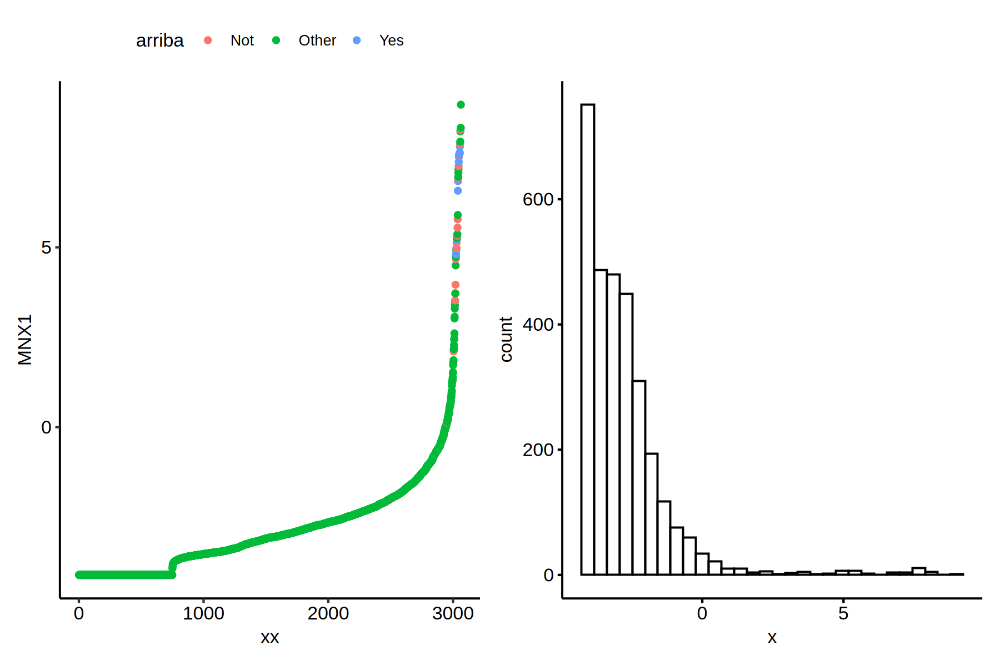

In [305]:
plotdat = as.data.table(logcpm[c('MNX1'), ], keep.rownames = T) 
setnames(plotdat, c('sample_name', 'MNX1'))
plotdat = plotdat[order(MNX1), ]
plotdat[, patient_name := substr(sample_name, 1, 16) ]
plotdat[, arriba := 'Other' ]
plotdat[patient_name %in% g1, arriba := 'Not' ]
plotdat[patient_name %in% g2, arriba := 'Yes' ]
plotdat$xx = 1:nrow(plotdat)
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)
ggplot(plotdat, aes(x = xx, y = MNX1, color = arriba)) + geom_point() + theme_pubr() |
gghistogram(plotdat$MNX1)
nrow(plotdat[MNX1 > 2, ])


Warning message:
"The melt generic in data.table has been passed a matrix and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is superseded and is no longer actively developed, and this redirection is now deprecated. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace, i.e. reshape2::melt(logcpm[c("MNX1", "ETV6", "NOM1"), ]). In the next version, this warning will become an error."


Var1,Var2,value,patient_name,arriba
<fct>,<fct>,<dbl>,<chr>,<chr>
MNX1,TARGET-20-PAVDAJ-09A,-2.388529,TARGET-20-PAVDAJ,Other
ETV6,TARGET-20-PAVDAJ-09A,8.695195,TARGET-20-PAVDAJ,Other
NOM1,TARGET-20-PAVDAJ-09A,4.481038,TARGET-20-PAVDAJ,Other
MNX1,TARGET-20-PAXBXU-09A,-2.750891,TARGET-20-PAXBXU,Other
ETV6,TARGET-20-PAXBXU-09A,8.458565,TARGET-20-PAXBXU,Other
NOM1,TARGET-20-PAXBXU-09A,5.121134,TARGET-20-PAXBXU,Other


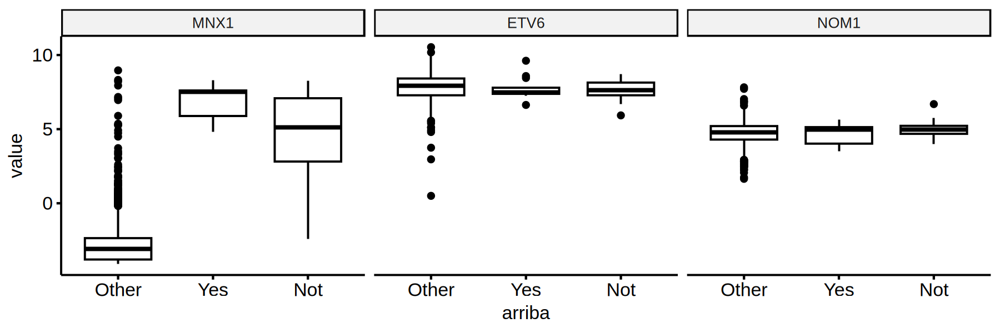

In [289]:
plotdat = as.data.table(melt(logcpm[c('MNX1', 'ETV6', 'NOM1'), ]))
plotdat[, patient_name := substr(Var2, 1, 16) ]
plotdat[, arriba := 'Other' ]
plotdat[patient_name %in% g1, arriba := 'Not' ]
plotdat[patient_name %in% g2, arriba := 'Yes' ]
options(repr.plot.width = 9, repr.plot.height = 3, repr.plot.res = 200)
ggboxplot(plotdat, x = 'arriba', y = 'value') + facet_wrap(~Var1)
head(plotdat) 


In [288]:
head(plotdat[Var1 == 'NOM1', ])

Var1,Var2,value,patient_name,arriba,tag,logcpm
<fct>,<fct>,<dbl>,<chr>,<chr>,<chr>,<dbl>


In [291]:
plotdat[, tag := paste0(patient_name, '_', Var1) ]
plotdat[, logcpm := mean(.SD$value), by = 'tag' ]
plotdat = plotdat[!duplicated(tag), ]
dat = plotdat[Var1 == 'MNX1', ]
summary(aov(logcpm ~ arriba, dat))

              Df Sum Sq Mean Sq F value Pr(>F)    
arriba         2   1835   917.7   496.7 <2e-16 ***
Residuals   2181   4030     1.8                   
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

In [248]:
plotdat = as.data.table(melt(tgt_dt[gene_name %in% c('MNX1'), ]), keep.rownames = T)
plotdat


Warning message in melt.data.table(tgt_dt[gene_name %in% c("MNX1"), ]):
"id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [gene_name, ...]. Consider providing at least one of 'id' or 'measure' vars in future."


gene_name,variable,value
<chr>,<fct>,<int>
MNX1,TARGET-20-PAVDAJ-09A,5
MNX1,TARGET-20-PAXBXU-09A,3
MNX1,TARGET-20-PAWDKU-09A,0
MNX1,TARGET-20-PAUVMN-09A,0
MNX1,TARGET-20-PAUVMN-04A,5
MNX1,TARGET-20-PAXEWS-09A,8570
MNX1,TARGET-20-PAWMLA-09A,1
MNX1,TARGET-20-PAVVAT-09A,18
MNX1,TARGET-20-PAVVAT-04A,25


In [209]:
tmp = sort(unique(dsn[mnx_ids == 'Yes', patient_name]))
length(tmp)
length(mnx_ids_2)
all(tmp == mnx_ids_2)

[1] 23

[1] 24

Warning message in tmp == mnx_ids_2:
"longer object length is not a multiple of shorter object length"


[1] FALSE

In [210]:
setdiff(mnx_ids_2, tmp)

[1] "TARGET-20-PAWJDM"

In [211]:
dsn[patient_name %in% 'TARGET-20-PAWJDM',]

patient_name,sample_name,.id,Gender,Race,Ethnicity,Age at Diagnosis in Days,First Event,Event Free Survival Time in Days,Vital Status,⋯,Cytogenetic Site of Relapse/Induction Failure,Other Site of Relapse/Induction Failure,Gene Fusion,Gemtuzumab ozogamicin treatment,Refractory Timepoint sent for Induction Failure Project,Comment,Blast count used for RNA seq,arriba_fusion,mnx_ids,mnx_id
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>
TARGET-20-PAWJDM,TARGET-20-PAWJDM-09A,AML1031,Male,White,Not Hispanic or Latino,8122,Death,946,Dead,⋯,Not done,Not done,,,NA,NA,NA,No,NA,No
TARGET-20-PAWJDM,TARGET-20-PAWJDM-14A,AML1031,Male,White,Not Hispanic or Latino,8122,Death,946,Dead,⋯,Not done,Not done,,,NA,NA,NA,No,NA,No


In [207]:
tmp

[1] "TARGET-20-PARUNX" "TARGET-20-PASIBG" "TARGET-20-PAUSBP" "TARGET-20-PAUYCA" "TARGET-20-PAUYZY" "TARGET-20-PAVAAM" "TARGET-20-PAVCJB" "TARGET-20-PAVDGM" "TARGET-20-PAVFDW"
[10] "TARGET-20-PAVNGY" "TARGET-20-PAVXPB" "TARGET-20-PAVXZL" "TARGET-20-PAWBTJ" "TARGET-20-PAWMLK" "TARGET-20-PAWNHH" "TARGET-20-PAWNYK" "TARGET-20-PAWUTL" "TARGET-20-PAWYKA"
[19] "TARGET-20-PAXEWS" "TARGET-20-PAXHGR" "TARGET-20-PAXKAL" "TARGET-20-PAXMPG" "TARGET-21-PASVJS"

In [208]:
mnx_ids_2

[1] "TARGET-20-PARUNX" "TARGET-20-PASIBG" "TARGET-20-PAUSBP" "TARGET-20-PAUYCA" "TARGET-20-PAUYZY" "TARGET-20-PAVAAM" "TARGET-20-PAVCJB" "TARGET-20-PAVDGM" "TARGET-20-PAVFDW"
[10] "TARGET-20-PAVNGY" "TARGET-20-PAVXPB" "TARGET-20-PAVXZL" "TARGET-20-PAWBTJ" "TARGET-20-PAWJDM" "TARGET-20-PAWMLK" "TARGET-20-PAWNHH" "TARGET-20-PAWNYK" "TARGET-20-PAWUTL"
[19] "TARGET-20-PAWYKA" "TARGET-20-PAXEWS" "TARGET-20-PAXHGR" "TARGET-20-PAXKAL" "TARGET-20-PAXMPG" "TARGET-21-PASVJS"

In [ ]:
tmp

In [199]:
table(unique(dsn$mnx_ids))


Yes 
  1 

In [155]:
setdiff(mnx_ids, tmp$sample_name)
setdiff(mnx_ids, dsn$patient_name)
intersect(mnx_ids, tmp$sample_name)
length(intersect(mnx_ids, arriba_fusion_dt$sample_name))
length(intersect(mnx_ids, dsn$patient_name))
length(unique(mnx_ids))

[1] "TARGET-20-PAWUTL" "TARGET-20-PAXHGR" "TARGET-20-PAUYCA" "TARGET-20-PAVCJB" "TARGET-20-PAVFDW" "TARGET-20-PAVAAM" "TARGET-20-PAVNGY" "TARGET-20-PAWYKA" "TARGET-20-PAVDGM"
[10] "TARGET-20-PAWMLK" "TARGET-20-PAUYZY" "TARGET-20-PAUSBP" "TARGET-20-PAXKAL"

character(0)

[1] "TARGET-20-PARUNX" "TARGET-20-PASIBG" "TARGET-20-PAVXZL" "TARGET-20-PAXMPG" "TARGET-20-PAWNHH" "TARGET-20-PAXEWS" "TARGET-20-PAVXPB" "TARGET-20-PAWBTJ" "TARGET-20-PAWNYK"
[10] "TARGET-21-PASVJS"

[1] 23

[1] 23

[1] 23

In [127]:
length(unique(tmp$sample_name))
length(unique(mnx_ids))

[1] 13

[1] 23

In [125]:
length(intersect(tmp$sample_name, mnx_ids))

[1] 9

In [114]:
dsn[, arriba_fusion := 'No']
dsn[patient_name %in% tmp$sample_name, arriba_fusion := 'Yes']
dsn[,         mnx_id := 'No']
dsn[patient_name %in% substr(mnx_ids_2, 1, 16),         mnx_id := 'Yes']


In [119]:
head(dsn$patient_name)

[1] "TARGET-00-BM3897" "TARGET-00-BM3969" "TARGET-00-BM4203" "TARGET-00-BM4387" "TARGET-00-BM4404" "TARGET-00-BM4473"

In [117]:
table(dsn$arriba_fusion)
table(dsn$mnx_id)


  No 
3063 

In [115]:
table(dsn$arriba_fusion, dsn$mnx_id)

     
        No
  No  3045
  Yes   18

In [61]:
datatable(arriba_fusion_dt[grep('MNX', FusionName), ][!duplicated(patient_name), ])

HTML widgets cannot be represented in plain text (need html)

In [595]:
table(arriba_fusion_dt[grep('MNX', FusionName), ][!duplicated(patient_name), FusionName])


            AC246787.2-MNX1                   MNX1-ETV6                  MNX1-LMBR1 NOM1(19768),MNX1(1107)-MNX1                 PTPRN2-MNX1 
                          1                           2                           4                          19                           2 

In [601]:
length(mnx_ids_2)

[1] 24

In [641]:
#dim(arriba_fusion_dt[patient_name %in% mnx_ids_2, ][!duplicated(patient_name), ])
datatable(arriba_fusion_dt[patient_name %in% mnx_ids_2[2], ][grepl('^7', breakpoint1) & grepl('^12', breakpoint2), ])
# [grepl('ETV|NOM|MNX', gene1) | grepl('ETV|NOM|MNX', gene2), ]
# not MNX1: mnx_ids_2[3], 6, 7, 9, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24
# 1, 2, 4, 5, 8, 10, 11, 12, 15, 


HTML widgets cannot be represented in plain text (need html)

## load RNA-Seq data

In [372]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [ ]:
query <- GDCquery(
    project = "TARGET-AML",
    data.category = "Transcriptome Profiling",
    data.type = "Gene Expression Quantification", 
    workflow.type = "STAR - Counts"
)
#GDCdownload(query = query)
#data <- GDCprepare(query = query)


In [380]:
res = as.data.table(query$results[[1]])
dim(res)
datatable(head(res))


[1] 3181   30

HTML widgets cannot be represented in plain text (need html)

In [261]:
res[, fname := paste0(getwd(), '/GDCdata/TARGET-AML/Transcriptome_Profiling/Gene_Expression_Quantification/', id, '/', file_name) ]
#dim(res[file.exists(fname), ])
# # gene-model: GENCODE v36
# gene_id gene_name       gene_type       unstranded      stranded_first  stranded_second tpm_unstranded  fpkm_unstranded fpkm_uq_unstranded
# N_unmapped                      5803754 5803754 5803754
# N_multimapping                  8850570 8850570 8850570
# N_noFeature                     37840800        70619861        38927680
# N_ambiguous                     3699968 65397   2159178
# ENSG00000000003.15      TSPAN6  protein_coding  3       1       2       0.0807  0.0225  0.0212
# ENSG00000000005.6       TNMD    protein_coding  0       0       0       0.0000  0.0000  0.0000
# ENSG00000000419.13      DPM1    protein_coding  358     3       360     36.2052 10.0711 9.5158

In [263]:
res_2 = res[!duplicated(sample.submitter_id), ]


In [259]:
dim(res_2)

[1] 3063   31

In [ ]:
tgt_list = lapply(1:nrow(res_2), function(ii){
    fname = res_2[ii, fname]
    sname = res_2[ii, sample.submitter_id]
    tmp = fread(fname)
    tmp = tmp[gene_type == 'protein_coding', ][!duplicated(gene_name), ]
    tmp = tmp[, .(gene_name, unstranded)]
    setnames(tmp, 2, sname) 
})


In [399]:
fun = function(x, y){
    merge(x, y, by = 'gene_name')
}
tgt_dt = Reduce(f = fun, tgt_list)


In [402]:
saveRDS(tgt_dt, file = 'data/target_rnaseq_counts_3063cases.rds')


In [38]:
tgt_dt = readRDS('data/target_rnaseq_counts_3063cases.rds')


In [39]:
head(tgt_dt)


gene_name,TARGET-20-PAVDAJ-09A,TARGET-20-PAXBXU-09A,TARGET-20-PAWDKU-09A,TARGET-20-PAUVMN-09A,TARGET-20-PAUVMN-04A,TARGET-20-PAXEWS-09A,TARGET-20-PAWMLA-09A,TARGET-20-PAVVAT-09A,TARGET-20-PAVVAT-04A,⋯,TARGET-20-PASLMR-09A,TARGET-20-PARHVK-04A,TARGET-20-PAEERJ-04A,TARGET-20-PANZXI-09A,TARGET-20-PANXWX-09A,TARGET-20-PASFJB-03A,TARGET-20-PARYFN-03A,TARGET-20-PARXNG-09A,TARGET-20-PASCGR-04A,TARGET-20-PARIZR-03A
<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
A1BG,239,41,136,90,88,14,18,28,39,⋯,3,16,44,3,0,9,15,47,36,20
A1CF,4,0,1,0,3,1,2,0,2,⋯,0,42,1,0,0,3,0,0,4,0
A2M,409,148,757,367,1068,799,275,96,211,⋯,16,184,41,49,20,51,10,380,714,43
A2ML1,53,87,22,48,45,71,6,34,74,⋯,17,26,8,4,0,5,3,9,47,1
A3GALT2,15,6,12,14,19,11,15,3,13,⋯,12,32,9,0,0,4,12,5,13,15
A4GALT,178,106,130,65,795,341,80,70,333,⋯,3,48,93,4,38,33,3,330,6700,10


In [253]:
tgt_df = setDF(tgt_dt[, 2:ncol(tgt_dt)], rownames = tgt_dt$gene_name)
head2(tgt_df)

,TARGET-20-PAVDAJ-09A,TARGET-20-PAXBXU-09A,TARGET-20-PAWDKU-09A,TARGET-20-PAUVMN-09A,TARGET-20-PAUVMN-04A
,<int>,<int>,<int>,<int>,<int>
A1BG,239,41,136,90,88
A1CF,4,0,1,0,3
A2M,409,148,757,367,1068


In [254]:
logcpm = logcpm_fun(tgt_df)

In [256]:
head2(logcpm)

,TARGET-20-PAVDAJ-09A,TARGET-20-PAXBXU-09A,TARGET-20-PAWDKU-09A,TARGET-20-PAUVMN-09A,TARGET-20-PAUVMN-04A
A1BG,2.680471,0.3725671,1.779476,1.204463,0.6455179
A1CF,-2.604742,-4.1058659,-3.592595,-4.105866,-3.1919667
A2M,3.450119,2.1769027,4.236001,3.204539,4.1967758


In [255]:
saveRDS(logcpm, file = 'logcpm_target_3062cases_oct9.rds')

In [40]:
dsn = data.table(sample_name = colnames(tgt_dt)[2:3064])
dsn[, patient_name := substr(sample_name, 1, 16) ]
dim(dsn[!duplicated(patient_name), ])
head(dsn)


[1] 2184    2

sample_name,patient_name
<chr>,<chr>
TARGET-20-PAVDAJ-09A,TARGET-20-PAVDAJ
TARGET-20-PAXBXU-09A,TARGET-20-PAXBXU
TARGET-20-PAWDKU-09A,TARGET-20-PAWDKU
TARGET-20-PAUVMN-09A,TARGET-20-PAUVMN
TARGET-20-PAUVMN-04A,TARGET-20-PAUVMN
TARGET-20-PAXEWS-09A,TARGET-20-PAXEWS


## load clinical data

In [ ]:
query <- GDCquery(
    project = "TARGET-AML",
    data.category = "Clinical",
    data.type = "Clinical Supplement"
)
GDCdownload(query)


In [41]:
xlsx_list = paste0('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/GDCdata/TARGET-AML/Clinical/Clinical_Supplement/', 
                   c('TARGET_AML_ClinicalData_Discovery_20230720.xlsx', 
                     'TARGET_AML_ClinicalData_AML1031_20230720.xlsx', 
                     'TARGET_AML_ClinicalData_AAML1031_AAML0631_additionalCasesForSortedCellsAndCBExperiment_20230720.xlsx', 
                     'TARGET_AML_ClinicalData_Validation_20230720.xlsx', 
                     'TARGET_AML_CDE_20230524.xlsx', 
                     'TARGET_AML_ClinicalData_LowDepthRNAseq_20230720.xlsx', 
                     'TARGET_AML_ClinicalData_Discovery_and_Validation_Tumor_Content_and_RIN_Supplement_20230720.xlsx') )
#inv = lapply(xlsx_list, function(fname){
#    tmp = read_xlsx(fname, 1)
#    print(head(tmp))
#})
fnames = c('TARGET_AML_ClinicalData_AML1031_20230720.txt', 
  'TARGET_AML_ClinicalData_Discovery_20230720.txt', 
  'TARGET_AML_ClinicalData_LowDepthRNAseq_20230720.txt', 
  'TARGET_AML_ClinicalData_Validation_20230720.txt') 
fnames = paste0('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/GDCdata/TARGET-AML/Clinical/Clinical_Supplement/', fnames)

In [42]:
tmp1 = fread(fnames[1])
tmp2 = fread(fnames[2])
tmp3 = fread(fnames[3])
tmp4 = fread(fnames[4])
clin_list = list(tmp1, tmp2, tmp3, tmp4)
names(clin_list) = c('AML1031', 'Discovery', 'LowDepth', 'validation')
clin_dt = rbindlist(clin_list, idcol = T, fill = T)
clin_dt_unq = clin_dt[!duplicated(`TARGET USI`), ]

In [43]:
datatable(clin_dt_unq)

Warning message in instance$preRenderHook(instance):
"It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html"


HTML widgets cannot be represented in plain text (need html)

In [44]:
clin_dt_unq = clin_dt_unq[, !duplicated(colnames(clin_dt_unq)), with = F]

In [45]:
colnames(clin_dt_unq)

[1] ".id"                                                     "TARGET USI"                                              "Gender"                                                 
 [4] "Race"                                                    "Ethnicity"                                               "Age at Diagnosis in Days"                               
 [7] "First Event"                                             "Event Free Survival Time in Days"                        "Vital Status"                                           
[10] "Overall Survival Time in Days"                           "Year of Diagnosis"                                       "Year of Last Follow Up"                                 
[13] "Protocol"                                                "WBC at Diagnosis"                                        "Bone marrow leukemic blast percentage (%)"              
[16] "Peripheral blasts (%)"                                   "CNS disease"                                             "Chloroma"                                               
[19] "FAB Category"                                            "t(6;9)"                                                  "t(8;21)"                                                
[22] "t(3;5)(q25;q34)"                                         "t(6;11)(q27;q23)"                                        "t(9;11)(p22;q23)"                                       
[25] "t(10;11)(p11.2;q23)"                                     "t(11:19)(q23:p13.1)"                                     "inv(16)"                                                
[28] "del5q"                                                   "del7q"                                                   "del9q"                                                  
[31] "monosomy 5"                                              "monosomy 7"                                              "trisomy 8"                                              
[34] "trisomy 21"                                              "MLL"                                                     "Minus Y"                                                
[37] "Minus X"                                                 "Cytogenetic Code Other"                                  "Cytogenetic Complexity"                                 
[40] "Primary Cytogenetic Code"                                "ISCN"                                                    "FLT3/ITD positive?"                                     
[43] "FLT3/ITD allelic ratio"                                  "FLT3 PM"                                                 "NPM mutation"                                           
[46] "CEBPA mutation"                                          "WT1 mutation"                                            "c-Kit Mutation Exon 8"                                  
[49] "c-Kit Mutation Exon 17"                                  "MRD at end of course 1"                                  "MRD % at end of course 1"                               
[52] "MRD at end of course 2"                                  "MRD % at end of course 2"                                "CR status at end of course 1"                           
[55] "CR status at end of course 2"                            "Risk group"                                              "SCT in 1st CR"                                          
[58] "Bone Marrow Site of Relapse/Induction Failure"           "CNS Site of Relapse/Induction Failure"                   "Chloroma Site of Relapse/Induction Failure"             
[61] "Cytogenetic Site of Relapse/Induction Failure"           "Other Site of Relapse/Induction Failure"                 "Gene Fusion"                                            
[64] "Gemtuzumab ozogamicin treatment"                         "Refractory Timepoint sent for Induction Failure Project" "Comment"                                                
[67] "Blast count used for RNA seq"

In [46]:
dsn = merge(dsn, clin_dt_unq, by.x = 'patient_name', by.y = "TARGET USI", all.x = T)


## logcpm

### all cases

In [47]:
tgt_dt_mtx = as.matrix(setDF(tgt_dt[, 2:ncol(tgt_dt)], rownames = tgt_dt$gene_name))
logcpm_target_3063cases = logcpm_fun(tgt_dt_mtx) 


In [48]:
head(logcpm_target_3063cases)


,TARGET-20-PAVDAJ-09A,TARGET-20-PAXBXU-09A,TARGET-20-PAWDKU-09A,TARGET-20-PAUVMN-09A,TARGET-20-PAUVMN-04A,TARGET-20-PAXEWS-09A,TARGET-20-PAWMLA-09A,TARGET-20-PAVVAT-09A,TARGET-20-PAVVAT-04A,TARGET-00-RO02431-14A,⋯,TARGET-20-PASLMR-09A,TARGET-20-PARHVK-04A,TARGET-20-PAEERJ-04A,TARGET-20-PANZXI-09A,TARGET-20-PANXWX-09A,TARGET-20-PASFJB-03A,TARGET-20-PARYFN-03A,TARGET-20-PARXNG-09A,TARGET-20-PASCGR-04A,TARGET-20-PARIZR-03A
A1BG,2.6804715,0.3725671,1.7794761,1.2044628,0.6455179,-1.2455701,-0.2308408,0.7185328,0.2938027,0.1225166,⋯,-1.5326614,-0.83144893,-0.5255357,-0.5361187,-4.105866,-1.2661472,-1.177761,-0.2276688,-0.9996299,-0.8910100
A1CF,-2.6047424,-4.1058659,-3.5925945,-4.1058659,-3.1919667,-3.5725416,-2.7729308,-4.1058659,-3.0835745,-3.1543436,⋯,-4.1058659,0.46548382,-3.7849472,-4.1058659,-4.105866,-2.4956691,-4.105866,-4.1058659,-3.2216952,-4.1058659
A2M,3.4501188,2.1769027,4.2360006,3.2045393,4.1967758,4.3794034,3.6075733,2.4596138,2.6726781,4.5998523,⋯,0.6706027,2.54912060,-0.6186170,3.3748066,2.948122,1.0600417,-1.670931,2.6989526,3.1416633,0.1277241
A2ML1,0.5526801,1.4233269,-0.7273231,0.3290402,-0.2717652,0.9277981,-1.6314455,0.9896268,1.1851581,-2.0120716,⋯,0.7549658,-0.18952612,-2.5242709,-0.1517803,-4.105866,-1.9613110,-2.890361,-2.2481683,-0.6547189,-3.6058438
A3GALT2,-1.1304439,-2.0646739,-1.4905920,-1.2950445,-1.3835101,-1.5403024,-0.4743425,-2.1318840,-1.1605531,-2.0120716,⋯,0.2730060,0.09200603,-2.4089233,-4.1058659,-4.105866,-2.2038902,-1.453063,-2.8084175,-2.1995388,-1.2551609
A4GALT,2.2598103,1.7026932,1.7155071,0.7488942,3.7724591,3.1563766,1.8428719,2.0095810,3.3261348,4.0672863,⋯,-1.5326614,0.65052361,0.4892016,-0.1517803,3.868970,0.4537656,-2.890361,2.4973730,6.3633211,-1.7434376


In [515]:
fwrite(logcpm_target_3063cases, file = paste0(share_dir, 'TARGET_logcpm_3063cases.xls'), sep = '\t')
fwrite(dsn, file = paste0(share_dir, 'TARGET_clin_information_3062cases_filled.xls'), sep = '\t')

x being coerced from class: matrix to data.table



In [50]:
plotdat$labx

[1] "PC1 16.6% explained"

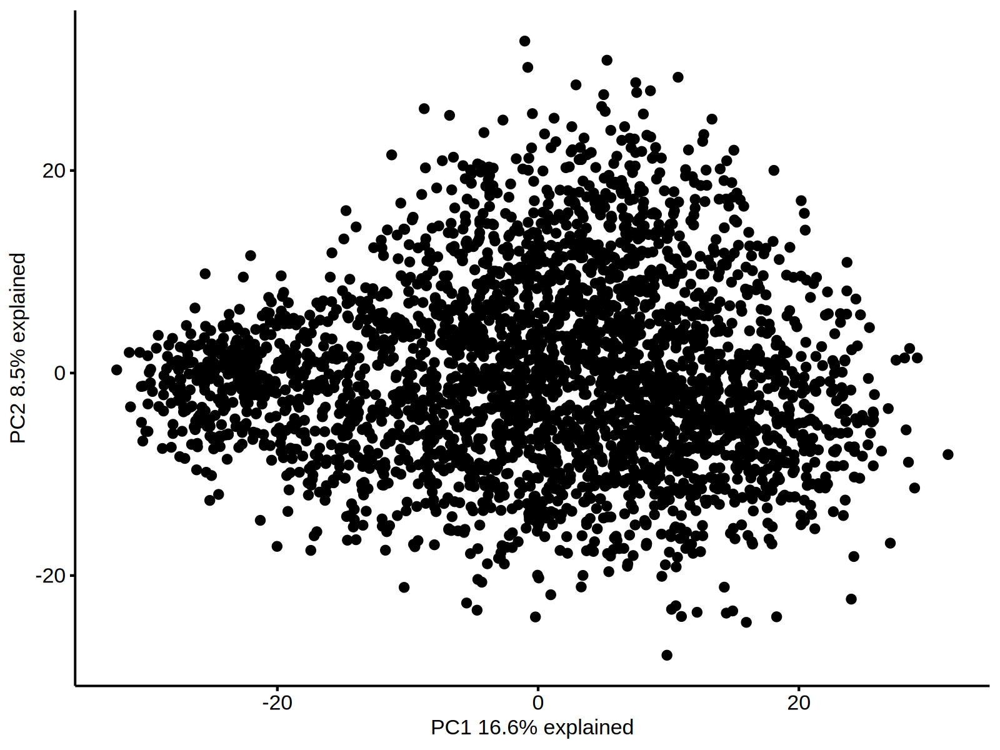

In [51]:
plotdat = pca_fun(logcpm_target_3063cases)
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)
ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2') + xlab(plotdat$labx) + ylab(plotdat$laby)


In [54]:
head(dsn)

patient_name,sample_name,.id,Gender,Race,Ethnicity,Age at Diagnosis in Days,First Event,Event Free Survival Time in Days,Vital Status,⋯,Bone Marrow Site of Relapse/Induction Failure,CNS Site of Relapse/Induction Failure,Chloroma Site of Relapse/Induction Failure,Cytogenetic Site of Relapse/Induction Failure,Other Site of Relapse/Induction Failure,Gene Fusion,Gemtuzumab ozogamicin treatment,Refractory Timepoint sent for Induction Failure Project,Comment,Blast count used for RNA seq
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>
TARGET-00-BM3897,TARGET-00-BM3897-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-00-BM3969,TARGET-00-BM3969-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-00-BM4203,TARGET-00-BM4203-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-00-BM4387,TARGET-00-BM4387-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-00-BM4404,TARGET-00-BM4404-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-00-BM4473,TARGET-00-BM4473-14A,NA,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [55]:
gene_sel = c('ETV6', 'MNX1', 'NOM1')
plotdat = as.data.table(t(logcpm_target_3063cases[gene_sel, ]), keep.rownames = T)
head(plotdat)

rn,ETV6,MNX1,NOM1
<chr>,<dbl>,<dbl>,<dbl>
TARGET-20-PAVDAJ-09A,8.695195,-2.388529,4.481038
TARGET-20-PAXBXU-09A,8.458565,-2.750891,5.121134
TARGET-20-PAWDKU-09A,9.028062,-4.105866,5.104463
TARGET-20-PAUVMN-09A,8.770550,-4.105866,5.251633
TARGET-20-PAUVMN-04A,7.598522,-2.799282,5.220552
TARGET-20-PAXEWS-09A,7.494089,7.798776,5.118358


### cases has clinical information, duplicated samples from one patients were retained

In [690]:
dsn_sel = dsn[!is.na(Gender) & patient_name %in% clin_dt_unq$`TARGET USI`, ]
dim(dsn_sel)

[1] 2615   71

In [692]:
share_dir

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/"

In [693]:
tgt_mtx_sel = tgt_dt_mtx[, dsn_sel$sample_name]
dim(tgt_mtx_sel)

[1] 19938  2615

In [694]:
logcpm_target_2615cases = logcpm_fun(tgt_mtx_sel) 

In [695]:
head(logcpm_target_2615cases)

,TARGET-20-PABGKN-09A,TARGET-20-PABHET-09A,TARGET-20-PABHET-03A,TARGET-20-PABHKY-03A,TARGET-20-PABLDZ-09A,TARGET-20-PABLDZ-04A,TARGET-20-PACDZR-09A,TARGET-20-PACEFU-09A,TARGET-20-PADDXZ-03A,TARGET-20-PADYIR-09A,⋯,TARGET-21-PATISD-09A,TARGET-21-PATISD-41A,TARGET-21-PATJMY-09A,TARGET-21-PATJMY-41A,TARGET-21-PATKBK-03A,TARGET-21-PATKBK-41A,TARGET-21-PATKKJ-09A,TARGET-21-PATKKJ-41A,TARGET-21-PATKWH-09A,TARGET-21-PATKWH-41A
A1BG,-0.7601172,-1.4055501,-0.1234956,0.2032106,0.6405055,0.26271346,0.35372069,0.7249586,-0.01157341,-2.2117067,⋯,1.101060,2.0957851,0.4887431,0.1591851,0.9323816,0.5361345,0.8981090,1.2790227,-0.561686,0.3216184
A1CF,-4.1003001,-3.0334303,-3.3602631,-3.8327473,-4.1003001,-4.10030005,-4.10030005,-4.1003001,-3.74853725,-2.7933252,⋯,-2.395158,-1.9771281,-2.1203302,-2.3914053,-2.4159559,-2.9862834,-2.6637558,-2.0912588,-2.138110,-2.2109529
A2M,1.6763254,-0.3950172,-0.6633556,1.0217452,-2.7170195,-0.97722192,-1.26618893,0.9620976,-0.97409856,-1.4209933,⋯,3.814852,4.0626363,1.3492713,2.1948294,3.3912352,3.2000232,0.4197141,0.9805472,3.102067,2.5970521
A2ML1,-1.8442469,-4.1003001,-4.1003001,-1.6453841,-3.2488574,-2.11249674,-0.22209829,-0.7616549,-3.74853725,-1.3666889,⋯,1.056044,0.4777496,-0.2672260,-1.5355830,-0.1221395,-0.1959420,-1.5453833,-1.2826169,0.916690,1.3971963
A3GALT2,-2.5700223,-2.4268494,-3.1791495,-1.0767349,-2.7170195,-0.41488635,-2.43859875,-2.6736330,-1.73803101,-0.8747283,⋯,-3.639014,-1.9771281,-2.5331283,-3.6375317,-4.1003001,-2.1326940,-2.6637558,-2.9008687,-2.138110,-3.7212120
A4GALT,1.4135846,3.3960411,3.4265239,0.8034378,2.5425377,0.08593834,0.09435065,-0.4587428,4.83391651,0.4607044,⋯,-2.395158,-0.2805407,2.0532125,3.8492213,-0.2272108,3.5569957,0.8759305,1.1539192,2.088150,0.6300224


In [526]:
write.table(logcpm_target_2615cases, file = paste0(share_dir, 'TARGET_logcpm_2615cases.xls'), sep = '\t')
fwrite(dsn_sel, file = paste0(share_dir, 'TARGET_clin_information_2615cases_filled.xls'), sep = '\t')

x being coerced from class: matrix to data.table



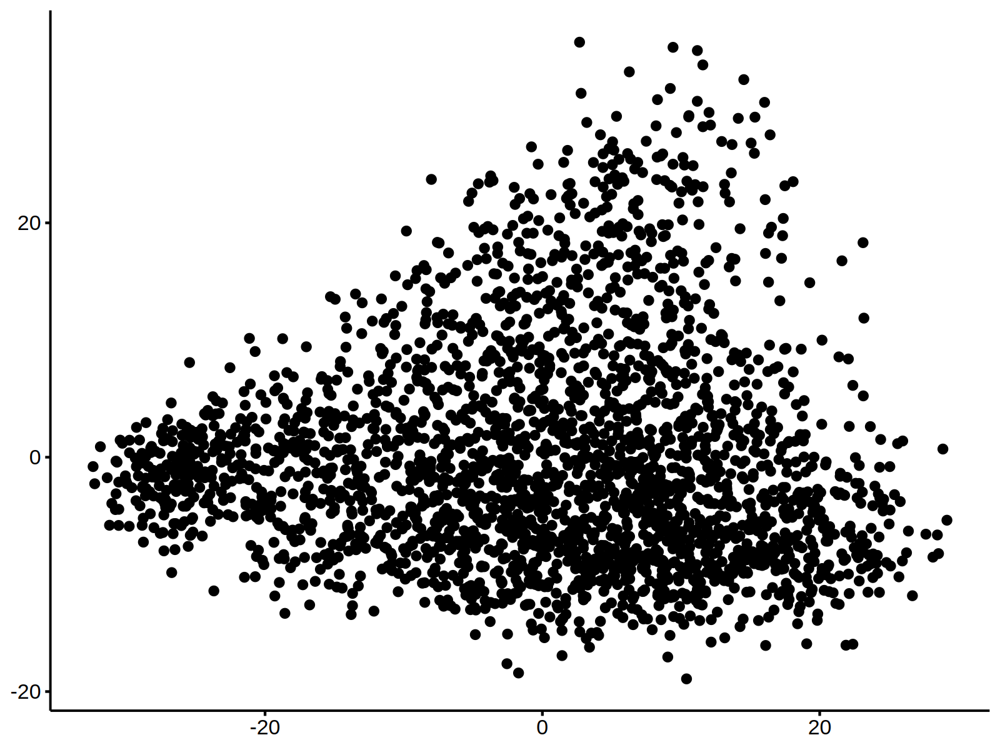

In [528]:
plotdat = pca_fun(logcpm_target_2615cases)
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)
ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2') + xlab(plotdat$lblx) + ylab(plotdat$lbly)


### mnx1 related features

In [205]:
mnx_ids = c('TARGET-20-PARUNX',  'TARGET-20-PASIBG',  'TARGET-20-PAWUTL',  'TARGET-20-PAVXZL',  'TARGET-20-PAXMPG',  'TARGET-20-PAXHGR',  'TARGET-20-PAUYCA', 
            'TARGET-20-PAWNHH',  'TARGET-20-PAVCJB',  'TARGET-20-PAXEWS',  'TARGET-20-PAVXPB',  'TARGET-20-PAWBTJ',  'TARGET-20-PAVFDW',  'TARGET-20-PAVAAM', 
            'TARGET-20-PAWNYK',  'TARGET-20-PAVNGY',  'TARGET-20-PAWYKA',  'TARGET-20-PAVDGM',  'TARGET-20-PAWMLK',  'TARGET-20-PAUYZY',  'TARGET-21-PASVJS',  'TARGET-20-PAUSBP',  'TARGET-20-PAXKAL',
            'TARGET-20-PAWMLK',  'TARGET-20-PAUYZY',  'TARGET-21-PASVJS',  'TARGET-20-PAUSBP',  'TARGET-20-PAXKAL') 
length(mnx_ids)
length(unique(mnx_ids))
# TARGET-20-PAWUTL TARGET-20-PAXMPG TARGET-20-PAUYCA TARGET-20-PAVFDW TARGET-20-PAVAAM
mnx_ids[duplicated(mnx_ids)]
#TARGET-20-PAWJDM
#TARGET-20-PAWMDY
mnx_ids_2 = sort(unique(c(mnx_ids, 'TARGET-20-PAWJDM')))

[1] 28

[1] 23

[1] "TARGET-20-PAWMLK" "TARGET-20-PAUYZY" "TARGET-21-PASVJS" "TARGET-20-PAUSBP" "TARGET-20-PAXKAL"

In [532]:
length(intersect(dsn_sel$patient_name, mnx_ids))
length(intersect(dsn_sel$patient_name, mnx_ids_2))

[1] 23

[1] 24

In [535]:
dsn_sel[patient_name %in% mnx_ids_2, .(sample_name, patient_name, `Gene Fusion`)]

sample_name,patient_name,Gene Fusion
<chr>,<chr>,<chr>
TARGET-20-PARUNX-09A,TARGET-20-PARUNX,MNX1-ETV6
TARGET-20-PARUNX-04A,TARGET-20-PARUNX,MNX1-ETV6
TARGET-20-PASIBG-04A,TARGET-20-PASIBG,MNX1-ETV6
TARGET-20-PASIBG-09A,TARGET-20-PASIBG,MNX1-ETV6
TARGET-20-PAUSBP-04A,TARGET-20-PAUSBP,
TARGET-20-PAUSBP-09A,TARGET-20-PAUSBP,
TARGET-20-PAUYCA-09A,TARGET-20-PAUYCA,
TARGET-20-PAUYZY-09A,TARGET-20-PAUYZY,
TARGET-20-PAVAAM-09A,TARGET-20-PAVAAM,


In [525]:
table(dsn_sel$`Gene Fusion`)


                      CBFA2T3-GLIS2        CBFB-MYH11        DEK-NUP214        ETV6-INO8D       FNBP1-KMT2A           FUS-ERG           FUS-FEV          FUS-FLI1      KAT6A-CREBBP 
             1649                14                65                 5                 2                 2                 4                 2                 1                 2 
      KAT6A-EP300        KMT2A-ABI1        KMT2A-AFF1    KMT2A-ARHGAP26     KMT2A-CEP170B         KMT2A-ELL        KMT2A-FLNA       KMT2A-MLLT1      KMT2A-MLLT10       KMT2A-MLLT3 
                4                 1                 2                 2                 2                11                 1                 4                25                39 
      KMT2A-MLLT4       KMT2A-SEPT6        KMT2A-TET1     MLLT10-PICALM         MNX1-ETV6         NPM1-MLF1       NUP98-HMGB3       NUP98-HOXA9      NUP98-HOXD13       NUP98-KDM5A 
               16                 4                 2                 7                 5     

## DNA mutation

In [ ]:
query <- GDCquery(
    project = "TARGET-AML", 
    data.category = "Simple Nucleotide Variation", 
    access = "open",
    data.type = "Masked Somatic Mutation", 
    workflow.type = "Aliquot Ensemble Somatic Variant Merging and Masking"
)
GDCdownload(query)
maf <- GDCprepare(query)
Methylation Beta Value

In [731]:
data_dir = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/TARGET_AML_Clinical_GDC/'
setwd(data_dir)
target_gdc_clin = fread('clinical.project-target-aml.2024-06-11/clinical.tsv')
colnames(target_gdc_clin)
dim(target_gdc_clin)
head(target_gdc_clin)


[1] "case_id"                                  "case_submitter_id"                        "project_id"                               "age_at_index"                            
  [5] "age_is_obfuscated"                        "cause_of_death"                           "cause_of_death_source"                    "country_of_birth"                        
  [9] "country_of_residence_at_enrollment"       "days_to_birth"                            "days_to_death"                            "education_level"                         
 [13] "ethnicity"                                "gender"                                   "marital_status"                           "occupation_duration_years"               
 [17] "premature_at_birth"                       "race"                                     "vital_status"                             "weeks_gestation_at_birth"                
 [21] "year_of_birth"                            "year_of_death"                            "adrenal_hormone"                          "age_at_diagnosis"                        
 [25] "ajcc_clinical_m"                          "ajcc_clinical_n"                          "ajcc_clinical_stage"                      "ajcc_clinical_t"                         
 [29] "ajcc_pathologic_m"                        "ajcc_pathologic_n"                        "ajcc_pathologic_stage"                    "ajcc_pathologic_t"                       
 [33] "ajcc_staging_system_edition"              "ann_arbor_b_symptoms"                     "ann_arbor_b_symptoms_described"           "ann_arbor_clinical_stage"                
 [37] "ann_arbor_extranodal_involvement"         "ann_arbor_pathologic_stage"               "best_overall_response"                    "burkitt_lymphoma_clinical_variant"       
 [41] "cancer_detection_method"                  "child_pugh_classification"                "clark_level"                              "classification_of_tumor"                 
 [45] "cog_liver_stage"                          "cog_neuroblastoma_risk_group"             "cog_renal_stage"                          "cog_rhabdomyosarcoma_risk_group"         
 [49] "contiguous_organ_invaded"                 "days_to_best_overall_response"            "days_to_diagnosis"                        "days_to_last_follow_up"                  
 [53] "days_to_last_known_disease_status"        "days_to_recurrence"                       "diagnosis_is_primary_disease"             "double_expressor_lymphoma"               
 [57] "double_hit_lymphoma"                      "eln_risk_classification"                  "enneking_msts_grade"                      "enneking_msts_metastasis"                
 [61] "enneking_msts_stage"                      "enneking_msts_tumor_site"                 "ensat_clinical_m"                         "ensat_pathologic_n"                      
 [65] "ensat_pathologic_stage"                   "ensat_pathologic_t"                       "esophageal_columnar_dysplasia_degree"     "esophageal_columnar_metaplasia_present"  
 [69] "fab_morphology_code"                      "figo_stage"                               "figo_staging_edition_year"                "first_symptom_longest_duration"          
 [73] "first_symptom_prior_to_diagnosis"         "gastric_esophageal_junction_involvement"  "gleason_grade_group"                      "gleason_grade_tertiary"                  
 [77] "gleason_patterns_percent"                 "gleason_score"                            "goblet_cells_columnar_mucosa_present"     "icd_10_code"                             
 [81] "igcccg_stage"                             "inpc_grade"                               "inpc_histologic_group"                    "inrg_stage"                              
 [85] "inss_stage"                               "international_prognostic_index"           "irs_group"                                "irs_stage"                               
 [89] "ishak_fibrosis_score"                     "iss_stage"                          

[1] 9818  210

case_id,case_submitter_id,project_id,age_at_index,age_is_obfuscated,cause_of_death,cause_of_death_source,country_of_birth,country_of_residence_at_enrollment,days_to_birth,⋯,treatment_dose_units,treatment_duration,treatment_effect,treatment_effect_indicator,treatment_frequency,treatment_intent_type,treatment_or_therapy,treatment_outcome,treatment_outcome_duration,treatment_type
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
002e6505-2e1f-4606-ba1e-0201bf9e53a6,TARGET-20-PARPSX,TARGET-AML,'--,'--,'--,'--,'--,'--,'--,⋯,'--,'--,'--,'--,'--,'--,'--,'--,'--,'--
00b9bfd0-95c0-59c6-afa4-44d13563a7e6,TARGET-20-PANTIV,TARGET-AML,7,false,'--,'--,'--,'--,-2833,⋯,'--,'--,'--,'--,'--,'--,yes,'--,'--,'--
00b9bfd0-95c0-59c6-afa4-44d13563a7e6,TARGET-20-PANTIV,TARGET-AML,7,false,'--,'--,'--,'--,-2833,⋯,'--,'--,'--,'--,'--,'--,no,'--,'--,"Stem Cell Transplantation, NOS"
00b9bfd0-95c0-59c6-afa4-44d13563a7e6,TARGET-20-PANTIV,TARGET-AML,7,false,'--,'--,'--,'--,-2833,⋯,'--,'--,'--,'--,'--,'--,yes,'--,'--,"Pharmaceutical Therapy, NOS"
00b9bfd0-95c0-59c6-afa4-44d13563a7e6,TARGET-20-PANTIV,TARGET-AML,7,false,'--,'--,'--,'--,-2833,⋯,'--,'--,'--,'--,'--,'--,yes,'--,'--,'--
00b9bfd0-95c0-59c6-afa4-44d13563a7e6,TARGET-20-PANTIV,TARGET-AML,7,false,'--,'--,'--,'--,-2833,⋯,'--,'--,'--,'--,'--,'--,yes,'--,'--,'--


In [732]:
table(target_gdc_clin$project_id)


TARGET-AML 
      9818 

## dna methylation

In [549]:
query <- GDCquery(
    experimental.strategy = 'Methylation Array', 
    project = "TARGET-AML",
    data.category = "DNA Methylation", 
    data.type = "Methylation Beta Value"
    #workflow.type = "Aliquot Ensemble Somatic Variant Merging and Masking"
)
#GDCdownload(query)

--------------------------------------

o GDCquery: Searching in GDC database

--------------------------------------

Genome of reference: hg38

--------------------------------------------

oo Accessing GDC. This might take a while...

--------------------------------------------

ooo Project: TARGET-AML

--------------------

oo Filtering results

--------------------

ooo By experimental.strategy

ooo By data.type

----------------

oo Checking data

----------------

ooo Checking if there are duplicated cases


ooo Checking if there are results for the query

-------------------

o Preparing output

-------------------



In [ ]:
getManifest(query)

# TARGET based on cbioportal

## load from GDC

In [1]:
getwd()

[1] "/research/rgs01/home/clusterHome/whu78/script/JinWang"

In [154]:
target_aml_clin = readRDS('data/target_aml_clin.rds')
colnames(target_aml_clin)

[1] "project"                                  "submitter_id"                             "disease_type"                             "primary_site"                            
  [5] "submitter_id"                             "irs_stage"                                "iss_stage"                                "ajcc_pathologic_stage"                   
  [9] "ann_arbor_clinical_stage"                 "created_datetime"                         "enneking_msts_stage"                      "treatments"                              
 [13] "inrg_stage"                               "enneking_msts_metastasis"                 "tissue_or_organ_of_origin"                "age_at_diagnosis"                        
 [17] "esophageal_columnar_dysplasia_degree"     "cog_liver_stage"                          "child_pugh_classification"                "metastasis_at_diagnosis_site"            
 [21] "state"                                    "prior_treatment"                          "cog_rhabdomyosarcoma_risk_group"          "days_to_last_known_disease_status"       
 [25] "primary_gleason_grade"                    "inpc_grade"                               "ajcc_pathologic_t"                        "morphology"                              
 [29] "ajcc_pathologic_n"                        "ajcc_pathologic_m"                        "irs_group"                                "medulloblastoma_molecular_classification"
 [33] "wilms_tumor_histologic_subtype"           "residual_disease"                         "weiss_assessment_score"                   "classification_of_tumor"                 
 [37] "tumor_focality"                           "ann_arbor_b_symptoms"                     "icd_10_code"                              "cog_renal_stage"                         
 [41] "figo_stage"                               "synchronous_malignancy"                   "burkitt_lymphoma_clinical_variant"        "days_to_best_overall_response"           
 [45] "inss_stage"                               "supratentorial_localization"              "ishak_fibrosis_score"                     "tumor_confined_to_organ_of_origin"       
 [49] "gleason_grade_group"                      "days_to_diagnosis"                        "goblet_cells_columnar_mucosa_present"     "laterality"                              
 [53] "last_known_disease_status"                "days_to_last_follow_up"                   "primary_diagnosis"                        "ajcc_clinical_stage"                     
 [57] "cog_neuroblastoma_risk_group"             "updated_datetime"                         "metastasis_at_diagnosis"                  "enneking_msts_tumor_site"                
 [61] "prior_malignancy"                         "year_of_diagnosis"                        "secondary_gleason_grade"                  "best_overall_response"                   
 [65] "ann_arbor_pathologic_stage"               "ann_arbor_extranodal_involvement"         "method_of_diagnosis"                      "mitosis_karyorrhexis_index"              
 [69] "ajcc_staging_system_edition"              "days_to_recurrence"                       "esophageal_columnar_metaplasia_present"   "ajcc_clinical_m"                         
 [73] "ajcc_clinical_n"                          "ajcc_clinical_t"                          "inpc_histologic_group"                    "masaoka_stage"                           
 [77] "micropapillary_features"                  "diagnosis_id"                             "igcccg_stage"                             "tumor_regression_grade"                  
 [81] "site_of_resection_or_biopsy"              "first_symptom_prior_to_diagnosis"         "tumor_grade"                              "enneking_msts_grade"                     
 [85] "sites_of_involvement"                     "gastric_esophageal_junction_involvement"  "progression_or_recurrence"                "NA."                                     
 [89] "submitter_sample_ids"                     "cause_of_death"                     

In [155]:
datatable(head(target_aml_clin))

Warning message in instance$preRenderHook(instance):
"It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html"


HTML widgets cannot be represented in plain text (need html)

## load clinical data from cbioportal

In [260]:
target_clin = read_xlsx('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/workspace/ImmuCellAI/TARGET/41375_2019_402_MOESM6_ESM.xlsx', 1)

In [731]:
dim(target_clin)
head(target_clin)

[1] 2181  104

,project,submitter_id,disease_type,primary_site,submitter_id.1,irs_stage,iss_stage,ajcc_pathologic_stage,ann_arbor_clinical_stage,created_datetime,⋯,age_at_index,submitter_id,days_to_birth,year_of_birth,premature_at_birth,weeks_gestation_at_birth,demographic_id,age_is_obfuscated,days_to_death,year_of_death
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<int>,<chr>,<int>,<lgl>,<lgl>,<lgl>,<chr>,<lgl>,<int>,<lgl>
1,TARGET-AML,TARGET-20-PAVWRR,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,TARGET-20-PAVWRR,NA,NA,NA,NA,2019-08-02T16:02:18.931765-05:00,⋯,2,TARGET-20-PAVWRR,-766,NA,NA,NA,ca8c6b36-061c-453e-a1dc-bf89a35e4d8d,FALSE,158,NA
2,TARGET-AML,TARGET-20-PAVAFA,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,TARGET-20-PAVAFA,NA,NA,NA,NA,2019-08-02T16:02:18.931765-05:00,⋯,1,TARGET-20-PAVAFA,-599,NA,NA,NA,b87dd0ef-3e01-4fc1-a734-47e66a8c1791,FALSE,771,NA
3,TARGET-AML,TARGET-20-PAWACC,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,TARGET-20-PAWACC,NA,NA,NA,NA,2019-08-02T16:02:18.931765-05:00,⋯,5,TARGET-20-PAWACC,-1874,NA,NA,NA,ae1724f7-883b-49f6-90a5-6bdf0ad34077,FALSE,NA,NA
4,TARGET-AML,TARGET-20-THP1,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
5,TARGET-AML,TARGET-20-PAWWWM,Myeloid Leukemias,Hematopoietic and reticuloendothelial systems,TARGET-20-PAWWWM,NA,NA,NA,NA,2019-08-02T16:02:18.931765-05:00,⋯,2,TARGET-20-PAWWWM,-750,NA,NA,NA,44915ac9-3400-46f8-b45e-53ab588b9fee,FALSE,661,NA
6,TARGET-AML,TARGET-00-RO02327,Not Applicable,Unknown,NA,NA,NA,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [262]:
# https://portal.gdc.cancer.gov/analysis_page?app=Projects

In [734]:
target_clin = fread('data/target_cbio/data_clinical_sample.txt', skip = 4)
setnames(target_clin, 1, 'PatientID')
target_clin_2 = readRDS('data/target_aml_clin.rds')
target_clin_2 = as.data.table(target_clin_2)
target_clin = merge(target_clin, target_clin_2[, .(submitter_id, vital_status, days_to_death)], by.x = 'PatientID', by.y = 'submitter_id', all.x = T)

# vital_status: Dead / Alive
# days_to_death: 
target_clin[, stat := factor(vital_status)]

dim(target_clin)
datatable(target_clin, options = list(pageLength = 3))


[1] 1025   40

HTML widgets cannot be represented in plain text (need html)

- MA9: t(9;11)(p22;q23) 
- MA6: t(6;11)(p27;q23) 
- AML1-ETO: t(8;21) (q21;q22) 


In [735]:
target_clin[, FLT3ITD := 'WT']
target_clin[FLT3_ITD_POSITIVE == 'Yes', FLT3ITD := 'FLT3ITD'] 

target_clin[,  MA6 := 'WT']
target_clin[T_6_11_Q27_Q23 == 'Yes',  MA6 := 'MA6']

target_clin[,  MA9 := 'WT']
target_clin[T_9_11_P22_Q23 == 'Yes',  MA9 := 'MA6']

target_clin[,  AML1ETO:= 'WT']
target_clin[T_8_21 == 'Yes',  AML1ETO := 'AML1ETO']


In [736]:
colnames(target_clin)

[1] "PatientID"                   "SAMPLE_ID"                   "T_6_9"                       "T_8_21"                      "T_3_5_Q25_Q34"               "T_6_11_Q27_Q23"             
 [7] "T_9_11_P22_Q23"              "T_10_11_P11_2_Q23"           "T_11_19_Q23_P13_1"           "INV_16"                      "DEL_5Q"                      "DEL_7Q"                     
[13] "DEL_9Q"                      "MONOSOMY_5"                  "MONOSOMY_7"                  "TRISOMY_8"                   "TRISOMY_21"                  "MLL"                        
[19] "MINUS_Y"                     "MINUS_X"                     "FLT3_ITD_POSITIVE"           "FLT3_ITD_ALLELIC_RATIO"      "FLT3_PM"                     "NPM_MUTATION"               
[25] "CEBPA_MUTATION"              "WT1_MUTATION"                "NUP98_NSD1"                  "CBFT2A3_GLIS"                "BONE_MARROW_SITE_OF_RELAPSE" "CNS_SITE_OF_RELAPSE"        
[31] "OTHER_SITE_OF_RELAPSE"       "ONCOTREE_CODE"               "ANALYSIS_COHORT"             "CANCER_TYPE"                 "CANCER_TYPE_DETAILED"        "SOMATIC_STATUS"             
[37] "TMB_NONSYNONYMOUS"           "vital_status"                "days_to_death"               "stat"                        "FLT3ITD"                     "MA6"                        
[43] "MA9"                         "AML1ETO"

In [559]:
colnames(target_clin)

[1] "PatientID"                   "SAMPLE_ID"                   "T_6_9"                       "T_8_21"                      "T_3_5_Q25_Q34"               "T_6_11_Q27_Q23"             
 [7] "T_9_11_P22_Q23"              "T_10_11_P11_2_Q23"           "T_11_19_Q23_P13_1"           "INV_16"                      "DEL_5Q"                      "DEL_7Q"                     
[13] "DEL_9Q"                      "MONOSOMY_5"                  "MONOSOMY_7"                  "TRISOMY_8"                   "TRISOMY_21"                  "MLL"                        
[19] "MINUS_Y"                     "MINUS_X"                     "FLT3_ITD_POSITIVE"           "FLT3_ITD_ALLELIC_RATIO"      "FLT3_PM"                     "NPM_MUTATION"               
[25] "CEBPA_MUTATION"              "WT1_MUTATION"                "NUP98_NSD1"                  "CBFT2A3_GLIS"                "BONE_MARROW_SITE_OF_RELAPSE" "CNS_SITE_OF_RELAPSE"        
[31] "OTHER_SITE_OF_RELAPSE"       "ONCOTREE_CODE"               "ANALYSIS_COHORT"             "CANCER_TYPE"                 "CANCER_TYPE_DETAILED"        "SOMATIC_STATUS"             
[37] "TMB_NONSYNONYMOUS"           "vital_status"                "days_to_death"               "stat"                        "FLT3ITD"                     "MA6"                        
[43] "MA9"                         "AML1ETO"

In [574]:
fwrite(target_clin, file = 'target_clin.tsv', sep = '\t')

In [573]:
patientid = unique(target_clin[T_6_9 == 'No' & T_8_21 == 'No' & T_3_5_Q25_Q34 == 'No' & T_6_11_Q27_Q23 == 'No' &
            T_9_11_P22_Q23 == 'No' & T_10_11_P11_2_Q23 == 'No' & T_11_19_Q23_P13_1 == 'No' & 
            INV_16 == 'No' & DEL_5Q == 'No' & DEL_7Q == 'No' & DEL_9Q == 'No' & MONOSOMY_5 == 'No' &
            MONOSOMY_7 == 'No' & TRISOMY_8 == 'No' & TRISOMY_21 == 'No', PatientID])
patientid
            

[1] "TARGET-20-PADZCG" "TARGET-20-PAECBZ" "TARGET-20-PAECRF" "TARGET-20-PAEDKB" "TARGET-20-PAEEYP" "TARGET-20-PAEFHC" "TARGET-20-PAKKBK" "TARGET-20-PAKKIM" "TARGET-20-PAKRZG"
 [10] "TARGET-20-PAMVVP" "TARGET-20-PAMYAS" "TARGET-20-PAMYGX" "TARGET-20-PANAEV" "TARGET-20-PANASY" "TARGET-20-PANCSC" "TARGET-20-PANDDC" "TARGET-20-PANDIX" "TARGET-20-PANGDN"
 [19] "TARGET-20-PANGJY" "TARGET-20-PANGTF" "TARGET-20-PANINI" "TARGET-20-PANJVI" "TARGET-20-PANKNB" "TARGET-20-PANLIR" "TARGET-20-PANLJN" "TARGET-20-PANLKB" "TARGET-20-PANLLX"
 [28] "TARGET-20-PANLXM" "TARGET-20-PANSBH" "TARGET-20-PANSJB" "TARGET-20-PANTNA" "TARGET-20-PANTPW" "TARGET-20-PANTRL" "TARGET-20-PANVUF" "TARGET-20-PANZWB" "TARGET-20-PAPSCM"
 [37] "TARGET-20-PAPUPC" "TARGET-20-PAPWIU" "TARGET-20-PAPXUF" "TARGET-20-PAPZCZ" "TARGET-20-PAPZFV" "TARGET-20-PAPZIZ" "TARGET-20-PAPZJT" "TARGET-20-PAPZYJ" "TARGET-20-PAPZYS"
 [46] "TARGET-20-PARAEG" "TARGET-20-PARAFA" "TARGET-20-PARAIC" "TARGET-20-PARAJX" "TARGET-20-PARANT" "TARGET-20-PARBEL" "TARGET-20-PARBFJ" "TARGET-20-PARBGF" "TARGET-20-PARBLP"
 [55] "TARGET-20-PARBTV" "TARGET-20-PARBXE" "TARGET-20-PARBZJ" "TARGET-20-PARCCH" "TARGET-20-PARCEC" "TARGET-20-PARCRW" "TARGET-20-PARCTW" "TARGET-20-PARCUK" "TARGET-20-PARDEV"
 [64] "TARGET-20-PARDRM" "TARGET-20-PARDYL" "TARGET-20-PARDZW" "TARGET-20-PAREHK" "TARGET-20-PARFGK" "TARGET-20-PARFIW" "TARGET-20-PARFLB" "TARGET-20-PARFMY" "TARGET-20-PARFWM"
 [73] "TARGET-20-PARFXF" "TARGET-20-PARGDB" "TARGET-20-PARGTF" "TARGET-20-PARGTR" "TARGET-20-PARHBA" "TARGET-20-PARHJL" "TARGET-20-PARHKJ" "TARGET-20-PARHKX" "TARGET-20-PARHKY"
 [82] "TARGET-20-PARHPP" "TARGET-20-PARHRS" "TARGET-20-PARHSA" "TARGET-20-PARHUP" "TARGET-20-PARILH" "TARGET-20-PARINM" "TARGET-20-PARJCR" "TARGET-20-PARJLW" "TARGET-20-PARKFB"
 [91] "TARGET-20-PARKHV" "TARGET-20-PARKSH" "TARGET-20-PARKSY" "TARGET-20-PARLFE" "TARGET-20-PARLGT" "TARGET-20-PARLSL" "TARGET-20-PARLVL" "TARGET-20-PARMGH" "TARGET-20-PARMHD"
[100] "TARGET-20-PARMIZ" "TARGET-20-PARMME" "TARGET-20-PARMMZ" "TARGET-20-PARMZC" "TARGET-20-PARNAW" "TARGET-20-PARNIN" "TARGET-20-PARNNT" "TARGET-20-PARNTM" "TARGET-20-PARNXW"
[109] "TARGET-20-PARPBA" "TARGET-20-PARPEK" "TARGET-20-PARPZP" "TARGET-20-PARRDD" "TARGET-20-PARRMF" "TARGET-20-PARRYL" "TARGET-20-PARSAN" "TARGET-20-PARSFK" "TARGET-20-PARSGE"
[118] "TARGET-20-PARSGS" "TARGET-20-PARSRR" "TARGET-20-PARTVG" "TARGET-20-PARTXH" "TARGET-20-PARTYK" "TARGET-20-PARTYV" "TARGET-20-PARUBT" "TARGET-20-PARUEX" "TARGET-20-PARUNX"
[127] "TARGET-20-PARUTH" "TARGET-20-PARUZS" "TARGET-20-PARVLH" "TARGET-20-PARVSF" "TARGET-20-PARVUC" "TARGET-20-PARVZU" "TARGET-20-PARWCG" "TARGET-20-PARWNS" "TARGET-20-PARWXU"
[136] "TARGET-20-PARXCG" "TARGET-20-PARXNG" "TARGET-20-PARXVI" "TARGET-20-PARYEB" "TARGET-20-PARYGA" "TARGET-20-PARYHR" "TARGET-20-PARYVW" "TARGET-20-PARYXV" "TARGET-20-PARZHI"
[145] "TARGET-20-PARZIA" "TARGET-20-PARZWH" "TARGET-20-PARZYF" "TARGET-20-PARZYN" "TARGET-20-PASAFM" "TARGET-20-PASANW" "TARGET-20-PASARF" "TARGET-20-PASAXB" "TARGET-20-PASBAX"
[154] "TARGET-20-PASBBE" "TARGET-20-PASBDC" "TARGET-20-PASBGZ" "TARGET-20-PASBPK" "TARGET-20-PASCBW" "TARGET-20-PASCCS" "TARGET-20-PASCGC" "TARGET-20-PASCGR" "TARGET-20-PASCIG"
[163] "TARGET-20-PASDET" "TARGET-20-PASDUD" "TARGET-20-PASDXF" "TARGET-20-PASECW" "TARGET-20-PASEFD" "TARGET-20-PASEGC" "TARGET-20-PASENE" "TARGET-20-PASFEW" "TARGET-20-PASFFS"
[172] "TARGET-20-PASFJJ" "TARGET-20-PASFLM" "TARGET-20-PASFNP" "TARGET-20-PASFTR" "TARGET-20-PASFVP" "TARGET-20-PASFZB" "TARGET-20-PASGAE" "TARGET-20-PASGEM" "TARGET-20-PASGML"
[181] "TARGET-20-PASGMZ" "TARGET-20-PASGWE" "TARGET-20-PASGZK" "TARGET-20-PASHLE" "TARGET-20-PASHMK" "TARGET-20-PASHWN" "TARGET-20-PASHWV" "TARGET-20-PASHZX" "TARGET-20-PASIBG"
[190] "TARGET-20-PASICM" "TARGET-20-PASIEJ" "TARGET-20-PASIEP" "TARGET-20-PASILA" "TARGET-20-PASINN" "TARGET-20-PASIZX" "TARGET-20-PASJNM" "TARGET-20-PASJRD" "TARGET-20-PASJZX"
[199] "TARGET-20-PASKAS" "TARGET-20-PASKGD" "TARGET-20-PASKGH" "TARGET-20-PASKRJ" "TARGET-20-PASKUA" "TARGET

In [ ]:
target_clin

In [566]:
table(target_clin$T_11_19_Q23_P13_1)



             No Unknown     Yes 
     13     938      49      25 

## load RNA-Seq data

In [702]:
target_rnaseq = readRDS('data/target_laml_RNAseq_Counts.rds')

In [719]:
head(target_rnaseq@rowRanges$gene_name)

[1] "TSPAN6"   "TNMD"     "DPM1"     "SCYL3"    "C1orf112" "FGR"

In [721]:
mtx = assays(target_rnaseq)$unstranded
rownames(mtx) = target_rnaseq@rowRanges$gene_name
mtx = mtx[!duplicated(rownames(mtx)), ]
dim(mtx)


[1] 59427  3182

In [468]:
dim(logcpm_t)

[1]  1931 17639

In [723]:
dge = DGEList(counts=mtx)
dge <- calcNormFactors(dge)

dge = normLibSizes(dge)
logcpm_target = log1p(cpm(dge, normalize = T))

logcpm_target_t = as.data.table(t(logcpm_target), keep.rownames = T)
head(logcpm_target_t)


rn,TSPAN6,TNMD,DPM1,SCYL3,C1orf112,FGR,CFH,FUCA2,GCLC,⋯,AL451106.1,AC092910.4,AC073611.1,AC136977.1,AC078856.1,AC008763.4,AL592295.6,AC006486.3,AL391628.1,AP006621.6
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TARGET-20-PASNIY-09A-02R,0.3152128,0.0000000,3.859646,2.389885,1.894752,4.664969,0.1382132,3.871678,3.247103,⋯,0,0.2158031,1.105092,0,0.3016023,0.05409288,1.0802420,0,0.6459768,0.2596226
TARGET-20-PASNKC-09A-01R,0.5073243,0.0000000,3.582083,2.271363,2.294690,4.676518,0.9753531,4.070213,3.722981,⋯,0,0.4919023,2.032590,0,0.5374726,0.00000000,0.8746074,0,0.7385650,0.3767265
TARGET-20-PASNLR-03A-01R,0.4704141,0.0000000,2.927265,2.009162,1.479197,5.909950,0.3719033,3.435046,4.058929,⋯,0,0.5226347,1.946848,0,0.5842946,0.00000000,0.6865220,0,0.7792615,0.1765284
TARGET-20-PASNAL-09A-01R,0.1005664,0.0000000,3.140334,2.493923,2.609323,3.589899,1.5704255,3.135746,3.193810,⋯,0,0.3528996,0.819588,0,0.6132250,0.00000000,0.7217203,0,0.3528996,0.5542180
TARGET-20-PASNDA-09A-01R,0.4380425,0.0000000,2.965993,2.045557,1.912729,4.214312,4.3804974,3.007586,4.311047,⋯,0,0.1287605,1.283967,0,0.3451864,0.00000000,0.3451864,0,0.1287605,0.0000000
TARGET-20-PASNYB-09A-01R,0.1283320,0.0270178,3.369732,2.705841,1.995186,4.623359,1.1253654,2.497011,3.585782,⋯,0,0.2420523,1.546950,0,0.3045533,0.00000000,0.9510372,0,0.4007537,0.4367840


In [640]:
target_rna = fread('data/target_cbio/data_mrna_seq_rpkm.txt')
target_rna[, Entrez_Gene_Id := NULL]
target_rna = target_rna[!duplicated(Hugo_Symbol), ]
head(target_rna)


Hugo_Symbol,TARGET-20-PABLDZ-04,TARGET-20-PADYIR-04,TARGET-20-PADZCG-04,TARGET-20-PAECCE-04,TARGET-20-PAEDKB-04,TARGET-20-PAEERJ-04,TARGET-20-PAEFGT-04,TARGET-20-PAEIKD-04,TARGET-20-PAKERZ-04,⋯,TARGET-20-PASPLU-04,TARGET-20-PASTUH-04,TARGET-20-PASVVS-04,TARGET-20-PASVYA-04,TARGET-20-PASWAJ-04,TARGET-20-PASXNR-04,TARGET-20-PASYJI-04,TARGET-20-PATDNN-04,TARGET-20-PATIAK-04,TARGET-20-PATJHJ-40
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TSPAN6,0.0000,0.0984,0.5163,0.1460,0.1509,0.1133,0.5556,NA,2.3656,⋯,0.0203,0.0400,0.0108,6.1147,0.2787,0.1694,0.1138,0.0095,0.0000,0.0000
TNMD,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,NA,0.0000,⋯,0.0000,0.0000,0.0448,0.0000,0.0000,0.0000,0.0152,0.0000,0.0000,0.0000
DPM1,38.2073,38.3176,24.4961,23.6720,50.1441,27.3078,21.7395,15.5213,17.8026,⋯,23.2317,26.7705,22.5473,29.6641,23.1722,31.0614,37.2344,17.5910,17.8578,23.0481
SCYL3,1.5071,1.4018,2.7219,4.9166,2.5829,5.5144,3.6603,0.9568,2.6750,⋯,4.7472,2.1981,2.2526,1.9956,6.6199,1.1677,3.6221,1.1359,2.0481,1.1945
C1orf112,0.1419,1.3998,0.3922,1.5836,0.4882,0.8848,1.7182,1.2730,2.5015,⋯,1.2261,0.9854,2.8554,1.0667,0.6274,1.7670,0.6663,0.8247,2.1462,1.1378
FGR,4.3848,15.0849,59.4319,30.5444,24.4406,28.4595,9.0564,22.7011,11.4983,⋯,27.9447,14.4064,30.7829,11.9304,20.4708,30.9586,57.7182,72.9432,8.6219,4.0474


In [689]:
target_rna_t = data.table::transpose(target_rna, make.names = 'Hugo_Symbol', keep.names = 'sample_name')
target_rna_t = merge(target_clin, target_rna_t, by.y = 'sample_name', by.x = 'SAMPLE_ID', all.x = T)
head(target_rna_t)
dim(target_rna_t)


SAMPLE_ID,PatientID,T_6_9,T_8_21,T_3_5_Q25_Q34,T_6_11_Q27_Q23,T_9_11_P22_Q23,T_10_11_P11_2_Q23,T_11_19_Q23_P13_1,INV_16,⋯,EDDM13,LINC01539,RUNDC3A-AS1,C19orf83,LINC01801,LINC01999,LINC01533,LINC01987,SMIM22,LIN37
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TARGET-20-PABLDZ-04,TARGET-20-PABLDZ,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,⋯,0.0326,0,0.0812,0.9643,0.0000,0,0,0,0,2.0284
TARGET-20-PABLDZ-09,TARGET-20-PABLDZ,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-20-PADYIR-03,TARGET-20-PADYIR,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-20-PADYIR-04,TARGET-20-PADYIR,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,⋯,0.0894,0,0.8169,1.5444,0.0517,0,0,0,0,1.5513
TARGET-20-PADYIR-09,TARGET-20-PADYIR,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
TARGET-20-PADZCG-04,TARGET-20-PADZCG,No,No,No,No,No,No,No,No,⋯,0.2465,0,0.3686,0.7363,0.0892,0,0,0,0,2.1492


[1]  1025 23768

## gene expression vs molecular subtypes

In [647]:
target_rna_t$BCAT1

ERROR: Error in eval(expr, envir, enclos): object 'target_rna_t' not found


In [696]:
genes

[1] "BCAT1"  "BCAT2"  "SLC7A8"

In [700]:
summary(target_rna_t$SLC7A8)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.0129  0.1489  0.4021  1.2188  1.0436 13.9083     980 

In [691]:
plotdat = target_rna_t[, .(genes, 'FLT3ITD', 'MA6', 'MA9', 'AML1ETO'), with = F]

ERROR: Error: When with=FALSE, j-argument should be of type logical/character/integer indicating the columns to select.


In [ ]:
vname = 'SLC7A8'
cname1 = 'FLT3ITD'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname1)) %>% 
  mutate(across(!!sym(cname1), factor)) %>% mutate(across(!!sym(cname1), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname1))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname1)

gg1 = ggboxplot(plotdat, x = cname1, y = vname, outlier.shape = NA, add = 'jitter', color = cname1, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname2 = 'MA9'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname2)) %>% 
  mutate(across(!!sym(cname2), factor)) %>% mutate(across(!!sym(cname2), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname2))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname2)

gg2 = ggboxplot(plotdat, x = cname2, y = vname, outlier.shape = NA, add = 'jitter', color = cname2, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

cname3 = 'AML1ETO'
stat.test = plotdat %>% select(!!sym(vname), !!sym(cname3)) %>% 
  mutate(across(!!sym(cname3), factor)) %>% mutate(across(!!sym(cname3), ~ relevel(.x, ref = 'WT'))) %>% 
  t_test(as.formula(paste0(vname, ' ~ ', cname3))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname3)

gg3 = ggboxplot(plotdat, x = cname3, y = vname, outlier.shape = NA, add = 'jitter', color = cname3, width = .5) + 
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.10))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1))

options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
gg1 + gg2 + gg3


In [630]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

# merge tcga and beat aml

[1]   844 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

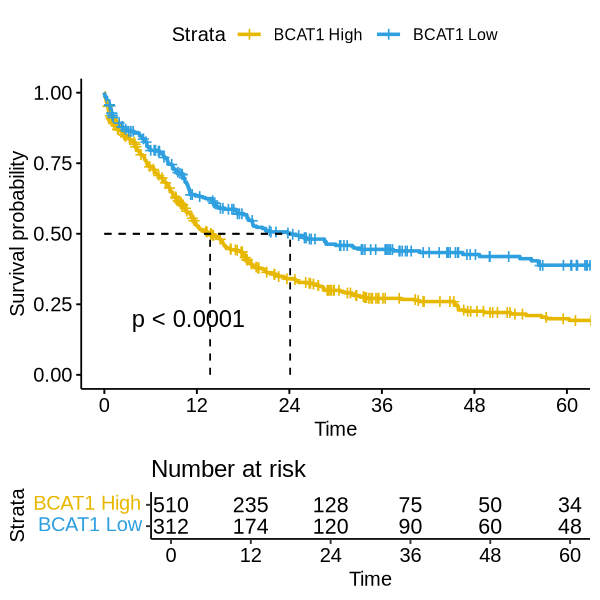

In [483]:
plotdat = logcpm_t[batch %in% c('TCGA', 'BeatAML'), ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_beatTCGA.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1]   807 17639

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

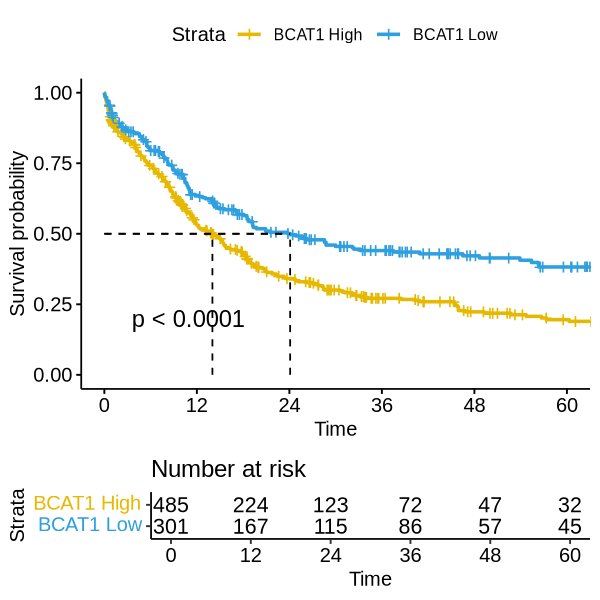

In [482]:
plotdat = logcpm_t[batch %in% c('TCGA', 'BeatAML'), ]
plotdat = plotdat[TET2_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT', ]
plotdat[, OS_STATUS2 := as.numeric(sub(':.*', '', OS_STATUS)) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,              # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr() , xlim = c(0, 60))      # Change ggplot2 theme
fname = '~/WenhuoHu/plot/surv_bcat1_beatTCGA_noMut.pdf'
pdf(file = fname, width = 5, height =5) 
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12,             # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


# put three cohort together

## organize raw counts

In [243]:
# TCGA rsem raw counts
tcga_rna_count = as.matrix(tcga_rna_mtx)
mode(tcga_rna_count) = 'integer'
head(tcga_rna_count)


,TCGA-AB-2803-03,TCGA-AB-2805-03,TCGA-AB-2806-03,TCGA-AB-2807-03,TCGA-AB-2808-03,TCGA-AB-2810-03,TCGA-AB-2811-03,TCGA-AB-2812-03,TCGA-AB-2813-03,TCGA-AB-2814-03,⋯,TCGA-AB-3000-03,TCGA-AB-3001-03,TCGA-AB-3002-03,TCGA-AB-3005-03,TCGA-AB-3006-03,TCGA-AB-3007-03,TCGA-AB-3008-03,TCGA-AB-3009-03,TCGA-AB-3011-03,TCGA-AB-3012-03
UBE2Q2P2,0,0,16,13,28,8,6,11,1,118,⋯,2,16,7,11,15,11,27,55,16,11
HMGB1P1,92,92,119,178,170,152,30,120,51,87,⋯,120,96,138,96,92,78,163,107,81,86
RNU12-2P,9,9,4,4,2,2,1,3,4,5,⋯,2,1,1,0,3,3,0,1,0,0
SSX9P,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
EZHIP,4,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,1,0,0,0,4,0
EFCAB8,0,1,8,0,2,0,8,1,0,0,⋯,5,3,0,5,0,5,4,2,6,10


In [244]:
beat_count = fread('data/beataml/beataml_waves1to4_counts_dbgap.txt')
beat_count = beat_count[!duplicated(display_label), ]
beat_count = setDF(beat_count[, 5:ncol(beat_count)], rownames = beat_count$display_label)
head(beat_count)
 

,BA2392R,BA2611R,BA2506R,BA2430R,BA2448R,BA2730R,BA2845R,BA2326R,BA2341R,BA2612R,⋯,BA3376R,BA3137R,BA3300R,BA3375R,BA3249R,BA3385R,BA3242R,BA3446R,BA3416R,BA3123R
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
TSPAN6,80,58,110,89,76,75,111,97,126,89,⋯,11,2,0,4,2,7,1,4,1,4
TNMD,0,0,0,0,0,0,0,0,1,1,⋯,0,0,0,0,0,0,0,0,0,0
DPM1,1000,520,1092,831,762,645,1811,1563,1599,1421,⋯,1416,1291,1447,1017,762,1309,1032,1506,1841,1068
SCYL3,621,364,805,531,566,448,1060,955,902,810,⋯,1353,858,1050,751,1409,1171,941,1085,1063,965
C1orf112,789,522,1007,791,706,601,1263,1058,1043,914,⋯,689,656,579,581,109,720,458,635,812,451
FGR,565,295,633,458,468,405,912,750,763,625,⋯,3972,14537,1208,2153,2686,17518,14547,38913,357,9714


In [245]:
target_raw_count = target_rnaseq@assays@data[[1]]
colnames(target_raw_count) = target_rnaseq@colData$patient
rownames(target_raw_count) = target_rnaseq@rowRanges$gene_name
colnames(target_raw_count) = substr(colnames(target_raw_count), 1, 16)
target_raw_count = target_raw_count[, !duplicated(colnames(target_raw_count))]
head(target_raw_count)


,TARGET-20-PASNIY,TARGET-20-PASNKC,TARGET-20-PASNLR,TARGET-20-PASNAL,TARGET-20-PASNDA,TARGET-20-PASNYB,TARGET-20-PATLDZ,TARGET-20-PASPFE,TARGET-20-PATLHB,TARGET-20-PATLKU,⋯,TARGET-20-PAWGEW,TARGET-20-PAVWZV,TARGET-00-RO0236,TARGET-20-PAYASV,TARGET-20-PAEPTD,TARGET-20-TF1,TARGET-20-PAXUVK,TARGET-20-PANTEL,TARGET-20-PAWYEK,TARGET-20-PATVAV
TSPAN6,20,26,28,1,4,5,29,12,4,4,⋯,24,7,61,171,25,19,3,1,1,44
TNMD,0,0,0,0,0,1,0,0,0,0,⋯,0,0,1,0,1,1,0,1,0,0
DPM1,2507,1375,824,209,134,1025,727,1936,812,194,⋯,606,780,865,147,1014,1486,416,672,441,1003
SCYL3,535,342,301,105,49,510,570,446,387,149,⋯,209,514,261,147,270,322,142,144,268,787
C1orf112,305,351,158,119,42,232,274,500,304,54,⋯,189,359,263,131,272,974,165,53,133,201
FGR,5676,4186,17140,333,485,3682,1016,32895,18494,1720,⋯,5303,2805,17278,841,8086,15,267,20783,7064,503


In [246]:
dim(target_raw_count[, !duplicated(colnames(target_raw_count))])

[1] 60660  2185

In [247]:
dim(tcga_rna_count)
dim(beat_count)
dim(target_raw_count)

[1] 20511   173

[1] 56638   707

[1] 60660  2185

In [248]:
ov = intersect(rownames(tcga_rna_count), intersect(rownames(beat_count), rownames(target_raw_count)))
length(ov)

[1] 17611

In [249]:
raw_count = cbind(cbind(tcga_rna_count[ov, ], beat_count[ov, ]), target_raw_count[ov, ])
raw_count = as.matrix(raw_count)
head(raw_count)

,TCGA-AB-2803-03,TCGA-AB-2805-03,TCGA-AB-2806-03,TCGA-AB-2807-03,TCGA-AB-2808-03,TCGA-AB-2810-03,TCGA-AB-2811-03,TCGA-AB-2812-03,TCGA-AB-2813-03,TCGA-AB-2814-03,⋯,TARGET-20-PAWGEW,TARGET-20-PAVWZV,TARGET-00-RO0236,TARGET-20-PAYASV,TARGET-20-PAEPTD,TARGET-20-TF1,TARGET-20-PAXUVK,TARGET-20-PANTEL,TARGET-20-PAWYEK,TARGET-20-PATVAV
UBE2Q2P2,0,0,16,13,28,8,6,11,1,118,⋯,38,15,71,75,41,293,38,5,53,124
HMGB1P1,92,92,119,178,170,152,30,120,51,87,⋯,5,7,8,4,10,175,7,3,1,78
RNU12-2P,9,9,4,4,2,2,1,3,4,5,⋯,2,8,2,3,6,1,3,1,14,39
EFCAB8,0,1,8,0,2,0,8,1,0,0,⋯,37,20,54,13,43,46,30,19,125,61
SDR16C6P,0,0,0,0,0,0,0,0,0,0,⋯,0,0,1,0,0,0,0,0,0,0
HSPB1P1,26,7,11,26,3,10,97,10,19,17,⋯,0,2,2,0,14,107,7,2,2,12


In [250]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [23]:
raw_count = read.csv(file = 'data/data_jun20/raw_count.cvs', check.names = F) 
raw_count = as.matrix(setDF(raw_count[, 2:ncol(raw_count)], rownames = raw_count[, 1])) 

In [24]:
dim(raw_count)
head2(raw_count)

[1] 17611  3065

,TCGA-AB-2803-03,TCGA-AB-2805-03,TCGA-AB-2806-03,TCGA-AB-2807-03,TCGA-AB-2808-03
UBE2Q2P2,0,0,16,13,28
HMGB1P1,92,92,119,178,170
RNU12-2P,9,9,4,4,2


In [27]:
write.table(raw_count, file = '~/WenhuoHu/repos/bcat1_dna_methylation/data/raw_count_3cohort.tsv', sep = '\t')

In [253]:
dsn_batch = data.table(rn = colnames(raw_count))

dsn_batch[, batch := 'BeatAML']
dsn_batch[grep('TCGA', rn), batch := 'TCGA']
dsn_batch[grep('TARGET', rn), batch := 'TARGET']

head(dsn_batch)

rn,batch
<chr>,<chr>
TCGA-AB-2803-03,TCGA
TCGA-AB-2805-03,TCGA
TCGA-AB-2806-03,TCGA
TCGA-AB-2807-03,TCGA
TCGA-AB-2808-03,TCGA
TCGA-AB-2810-03,TCGA


In [756]:
raw_count_adj = read.csv('data/data_jun20/raw_count_adj.cvs', check.names = F)
raw_count_adj = as.matrix(setDF(raw_count_adj[, 2:ncol(raw_count)], rownames = raw_count_adj[, 1])) 

In [861]:
dim(raw_count_adj)

[1] 17611  3064

In [143]:
raw_count_adj <- ComBat_seq(raw_count, batch=dsn_batch$batch, group=NULL)


Found 3 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [721]:
head(raw_count_adj)


,X,TCGA.AB.2803.03,TCGA.AB.2805.03,TCGA.AB.2806.03,TCGA.AB.2807.03,TCGA.AB.2808.03,TCGA.AB.2810.03,TCGA.AB.2811.03,TCGA.AB.2812.03,TCGA.AB.2813.03,⋯,TARGET.20.PAWGEW,TARGET.20.PAVWZV,TARGET.00.RO0236,TARGET.20.PAYASV,TARGET.20.PAEPTD,TARGET.20.TF1,TARGET.20.PAXUVK,TARGET.20.PANTEL,TARGET.20.PAWYEK,TARGET.20.PATVAV
,<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,UBE2Q2P2,0,0,20,17,35,11,8,14,1,⋯,19,6,37,47,20,176,19,2,27,67
2,HMGB1P1,14,16,25,49,50,36,1,27,4,⋯,15,18,21,9,22,180,18,14,1,97
3,RNU12-2P,6,6,3,3,2,2,1,3,3,⋯,2,7,2,3,5,1,3,1,12,31
4,EFCAB8,0,1,33,0,10,0,34,1,0,⋯,24,14,34,9,28,30,20,13,76,39
5,SDR16C6P,0,0,0,0,0,0,0,0,0,⋯,0,0,1,0,0,0,0,0,0,0
6,HSPB1P1,10,2,3,10,1,3,57,3,6,⋯,0,6,6,0,19,101,12,6,6,20


## summarized the batch correct effect

In [148]:
percent = function(x){round(x, 2)}

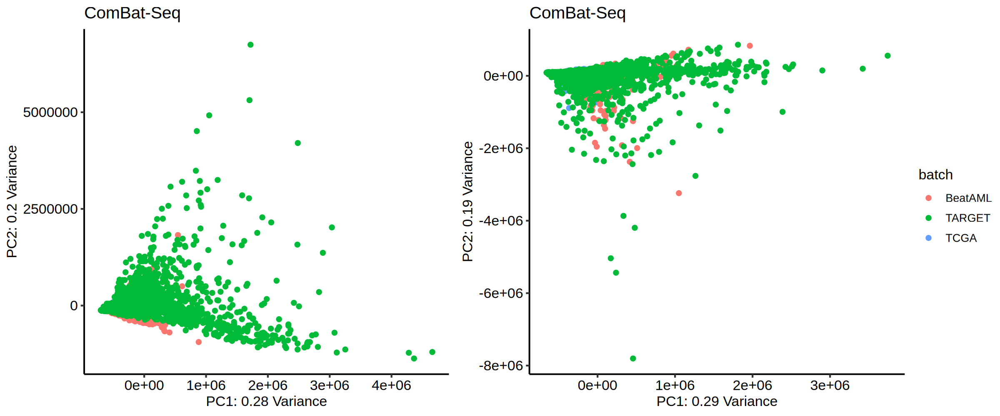

In [157]:
seobj <- SummarizedExperiment(assays=raw_count, colData=dsn_batch_df)
pca_obj <- plotPCA(DESeqTransform(seobj), intgroup=c("batch"))
plt <- ggplot(pca_obj$data, aes(x=PC1, y=PC2, color=batch)) + 
  geom_point() + 
  labs(x=sprintf("PC1: %s Variance", percent(pca_obj$plot_env$percentVar[1])),
       y=sprintf("PC2: %s Variance", percent(pca_obj$plot_env$percentVar[2])),
       title="ComBat-Seq") + theme_pubr()

seobj_adj <- SummarizedExperiment(assays=raw_count_adj, colData=dsn_batch_df)
pca_obj_adj <- plotPCA(DESeqTransform(seobj_adj), intgroup=c("batch"))
plt_adj <- ggplot(pca_obj_adj$data, aes(x=PC1, y=PC2, color=batch)) + 
  geom_point() + 
  labs(x=sprintf("PC1: %s Variance", percent(pca_obj_adj$plot_env$percentVar[1])),
       y=sprintf("PC2: %s Variance", percent(pca_obj_adj$plot_env$percentVar[2])),
       title="ComBat-Seq") + theme_pubr()

options(repr.plot.width = 12, repr.plot.height = 5, repr.plot.res = 200)
ggarrange(plt, plt_adj, ncol=2, nrow=1, common.legend=TRUE, legend="right")


In [161]:
sum_tbl = as.data.table(apply(raw_count_adj, 2, mean), keep.rownames = T)
head(sum_tbl)


V1,V2
<chr>,<dbl>
TCGA-AB-2803-03,937.8902
TCGA-AB-2805-03,789.3105
TCGA-AB-2806-03,842.9436
TCGA-AB-2807-03,933.2900
TCGA-AB-2808-03,813.7149
TCGA-AB-2810-03,1032.5357


In [167]:
library(BatchQC)

In [173]:
  unadjusted = batchqc_explained_variation(cpm(raw_count, log=TRUE), batch = dsn_batch$batch, condition = rep(1, nrow(dsn_batch)))$explained_variation

In [174]:
head(unadjusted)

,Full (Condition+Batch),Condition,Batch
UBE2Q2P2,48.417,0,48.417
HMGB1P1,49.587,0,49.587
RNU12-2P,15.238,0,15.238
EFCAB8,28.189,0,28.189
SDR16C6P,4.246,0,4.246
HSPB1P1,23.440,0,23.440


In [176]:
varexp_full <- list(
  unadjusted=batchqc_explained_variation(cpm(raw_count, log=TRUE), batch=dsn_batch$batch, condition = rep(1, nrow(dsn_batch)))$explained_variation,
  combatseq=batchqc_explained_variation(cpm(raw_count_adj, log=TRUE), condition = rep(1, nrow(dsn_batch)), batch=dsn_batch$batch)$explained_variation
)
varexp_full_df <- melt(varexp_full)
head(varexp_full_df) 


Warning message:
"The melt generic in data.table has been passed a list and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is superseded and is no longer actively developed, and this redirection is now deprecated. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace, i.e. reshape2::melt(varexp_full). In the next version, this warning will become an error."


,Var1,Var2,value,L1
,<fct>,<fct>,<dbl>,<chr>
1,UBE2Q2P2,Full (Condition+Batch),48.417,unadjusted
2,HMGB1P1,Full (Condition+Batch),49.587,unadjusted
3,RNU12-2P,Full (Condition+Batch),15.238,unadjusted
4,EFCAB8,Full (Condition+Batch),28.189,unadjusted
5,SDR16C6P,Full (Condition+Batch),4.246,unadjusted
6,HSPB1P1,Full (Condition+Batch),23.440,unadjusted


In [182]:
head(varexp_full_df)

,Var1,Var2,value,L1
,<fct>,<fct>,<dbl>,<fct>
1,UBE2Q2P2,Condition+Batch,48.417,unadjusted
2,HMGB1P1,Condition+Batch,49.587,unadjusted
3,RNU12-2P,Condition+Batch,15.238,unadjusted
4,EFCAB8,Condition+Batch,28.189,unadjusted
5,SDR16C6P,Condition+Batch,4.246,unadjusted
6,HSPB1P1,Condition+Batch,23.440,unadjusted


In [183]:
table(varexp_full_df$Var2)


Condition+Batch       Condition           Batch 
          35222           35222           35222 

In [185]:
varexp_full <- list(
  unadjusted=batchqc_explained_variation(cpm(raw_count, log=TRUE), batch=dsn_batch$batch, condition = rep(1, nrow(dsn_batch)))$explained_variation,
  combatseq=batchqc_explained_variation(cpm(raw_count_adj, log=TRUE), condition = rep(1, nrow(dsn_batch)), batch=dsn_batch$batch)$explained_variation
)
varexp_full_df <- melt(varexp_full)
varexp_full_df$L1 <- factor(varexp_full_df$L1, levels=c("unadjusted", "combatseq"))
varexp_full_df$Var2 <- plyr::revalue(varexp_full_df$Var2, c("Full (Condition+Batch)"="Condition+Batch"))
varexp_full_df = varexp_full_df[varexp_full_df$Var2 %in% c('Batch'), ]
head(varexp_full_df) 


Warning message:
"The melt generic in data.table has been passed a list and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is superseded and is no longer actively developed, and this redirection is now deprecated. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace, i.e. reshape2::melt(varexp_full). In the next version, this warning will become an error."


,Var1,Var2,value,L1
,<fct>,<fct>,<dbl>,<fct>
35223,UBE2Q2P2,Batch,48.417,unadjusted
35224,HMGB1P1,Batch,49.587,unadjusted
35225,RNU12-2P,Batch,15.238,unadjusted
35226,EFCAB8,Batch,28.189,unadjusted
35227,SDR16C6P,Batch,4.246,unadjusted
35228,HSPB1P1,Batch,23.440,unadjusted


In [187]:
summary(varexp_full_df$L1)

unadjusted  combatseq 
     17611      17611

In [ ]:
ggplot(varexp_full_df, aes(y=L1, y=value)) +
  geom_boxplot() +
  labs(y="Explained variation") +
  theme(axis.title.x = element_blank()) + theme_pubr()


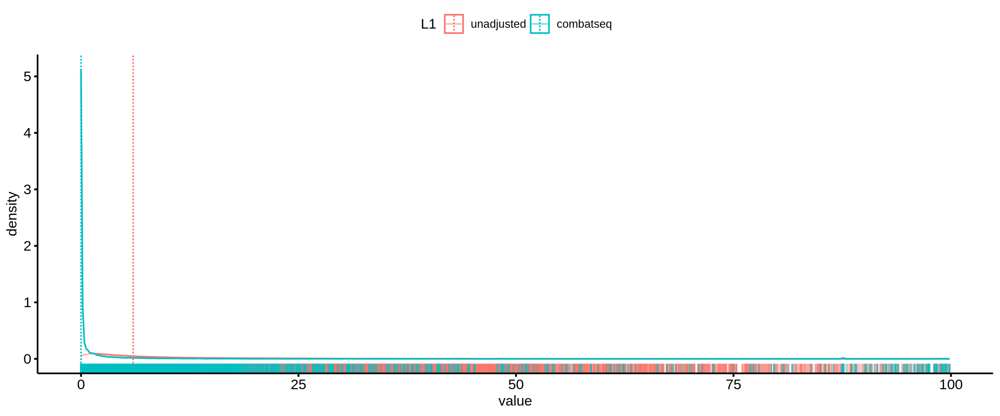

In [194]:
ggdensity(varexp_full_df, x = "value", color = "L1", add = "median", rug = TRUE)


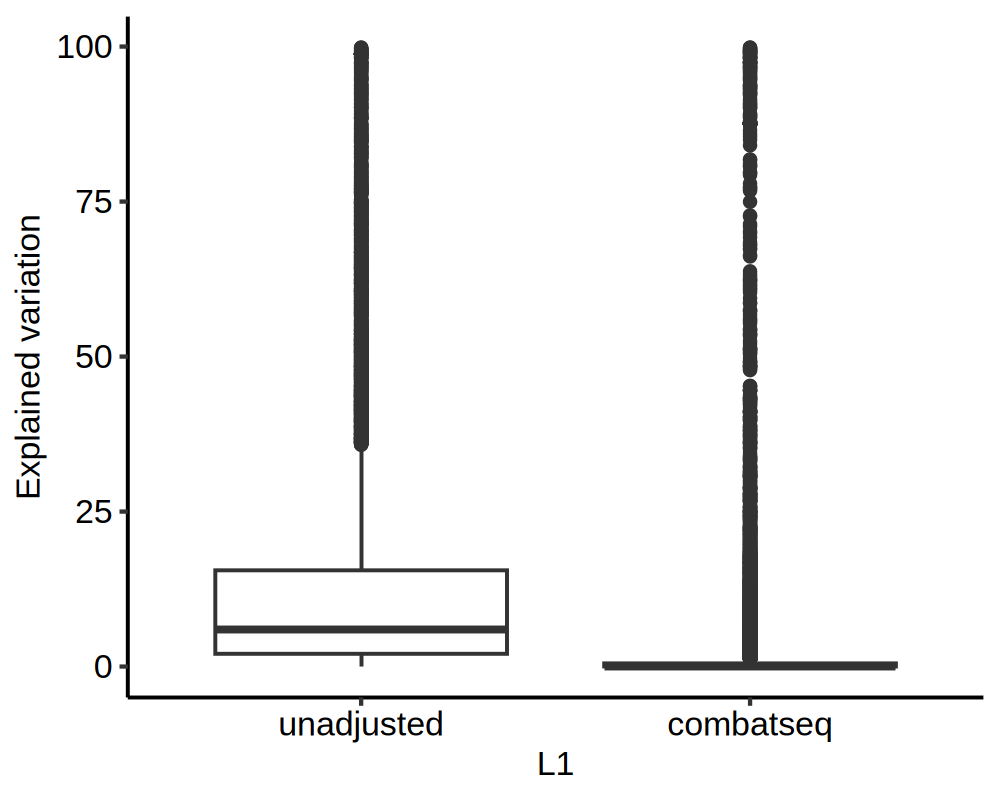

In [526]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
ggplot(varexp_full_df, aes(x=L1, y=value)) +
  geom_boxplot() +
  labs(y="Explained variation") +
  theme(axis.title.x = element_blank()) + theme_pubr()


## organize clinical information needed

In [327]:
xx = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/tcgaAML_clinical_info_only_151_cases_from_GDC.xls')
yy = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_clincalInfo.xls')
colnames(xx)
colnames(yy)

[1] "PatientID"              "SEX"                    "RACE"                   "FAB"                    "AGE"                    "BM_BLAST_PERCENTAGE"    "WBC"                   
 [8] "PB_BLAST_PERCENTAGE"    "AML_IN_SKIN_PERCENTAGE" "CYTOGENETICS"           "CYTOGENETIC_CODE_OTHER" "RISK_CYTO"              "HISTOLOGICAL_SUBTYPE"   "RISK_MOLECULAR"        
[15] "DFS_MONTHS"             "DFS_STATUS"             "INDUCTION"              "TRANSPLANT_TYPE"        "DARK_ZONE_STAT"         "OS_MONTHS"              "OS_STATUS"             
[22] "subtype_used"           "BCRABL"                 "karyotype"              "MLL_re"                 "MA9"                    "AML1ETO"                "PMLRARA"               
[29] "subtype"                "CBFBMYH11"              "Complex"                "FLT3"                   "FLT3_mut"               "FLT3ITD"                "TET2_mut"              
[36] "DNMT3A_mut"             "SF3B1_mut"              "TP53_mut"               "PPM1D_mut"              "ASXL1_mut"              "NRAS_mut"               "JAK2_mut"              
[43] "GNB1_mut"               "KRAS_mut"               "CBL_mut"                "IDH1_mut"               "IDH2_mut"

[1] "sampleName"                                "dbgap_subject_id"                          "dbgap_dnaseq_sample"                       "dbgap_rnaseq_sample"                      
  [5] "cohort"                                    "used_manuscript_analyses"                  "manuscript_dnaseq"                         "manuscript_rnaseq"                        
  [9] "manuscript_inhibitor"                      "consensus_sex"                             "inferred_sex"                              "reportedRace"                             
 [13] "reportedEthnicity"                         "inferred_ethnicity"                        "centerID"                                  "CEBPA_Biallelic"                          
 [17] "consensusAMLFusions"                       "ageAtDiagnosis"                            "isRelapse"                                 "isDenovo"                                 
 [21] "isTransformed"                             "specificDxAtAcquisition_MDSMPN"            "nonAML_MDSMPN_specificDxAtAcquisition"     "priorMalignancyNonMyeloid"                
 [25] "priorMalignancyType"                       "cumulativeChemo"                           "priorMalignancyRadiationTx"                "priorMDS"                                 
 [29] "priorMDSMoreThanTwoMths"                   "priorMDSMPN"                               "priorMDSMPNMoreThanTwoMths"                "priorMPN"                                 
 [33] "priorMPNMoreThanTwoMths"                   "dxAtInclusion"                             "specificDxAtInclusion"                     "ELN2017"                                  
 [37] "dxAtSpecimenAcquisition"                   "specificDxAtAcquisition"                   "ageAtSpecimenAcquisition"                  "timeOfSampleCollectionRelativeToInclusion"
 [41] "specimenGroups"                            "diseaseStageAtSpecimenCollection"          "specimenType"                              "rnaSeq"                                   
 [45] "exomeSeq"                                  "totalDrug"                                 "analysisRnaSeq"                            "analysisExomeSeq"                         
 [49] "analysisDrug"                              "cumulativeTreatmentTypeCount"              "cumulativeTreatmentTypes"                  "cumulativeTreatmentRegimenCount"          
 [53] "cumulativeTreatmentRegimens"               "cumulativeTreatmentStageCount"             "cumulativeTreatmentStages"                 "responseToInductionTx"                    
 [57] "typeInductionTx"                           "responseDurationToInductionTx"             "mostRecentTreatmentType"                   "currentRegimen"                           
 [61] "currentStage"                              "mostRecentTreatmentDuration"               "vitalStatus"                               "overallSurvival"                          
 [65] "causeOfDeath"                              "%.Basophils.in.PB"                         "%.Blasts.in.BM"                            "%.Blasts.in.PB"                           
 [69] "%.Eosinophils.in.PB"                       "%.Immature.Granulocytes.in.PB"             "%.Lymphocytes.in.PB"                       "%.Monocytes.in.PB"                        
 [73] "%.Neutrophils.in.PB"                       "%.Nucleated.RBCs.in.PB"                    "ALT"                                       "AST"                                      
 [77] "albumin"                                   "creatinine"                                "fabBlastMorphology"                        "hematocrit"                               
 [81] "hemoglobin"                                "karyotype"                                 "LDH"                                       "MCV"                                      
 [85] "otherCytogenetics"                         "plateletCount"                             "surfaceAntigensImmunohistochemicalStains"  "totalProtein"                            

In [331]:
xx$OS_STATUS = as.numeric(substr(xx$OS_STATUS, 1, 1))

In [334]:
xx[, sampleName := PatientID ]
xx[, batch := 'tcga' ]

yy[, SEX := consensus_sex ] 
yy[, OS_MONTHS := OS_Month ] 
yy[, OS_STATUS := stat ] 
yy[, batch := 'beat' ]

ov = intersect(colnames(xx), colnames(yy))
xxyy = rbindlist(list(xx[, ov, with = F], yy[, ov, with = F]))


In [335]:
fwrite(xxyy, file = 'tcga_beat_clin.tsv') 
#xxyy = fread('tcga_beat_clin.tsv')


In [239]:
logcpm_t[, rn2 := rn]
logcpm_t[grep('TCGA', rn), rn2 := substr(rn, 1, 12) ]

In [240]:
length(intersect(logcpm_t$rn2i2, xxyy$sampleName)) 

[1] 816

In [225]:
intersect(colnames(clin1), colnames(clin2))

[1] "MLL_re"    "MA9"       "AML1ETO"   "PMLRARA"   "CBFBMYH11"

In [864]:
dsn_batch_tcga = dsn_batch[batch == 'TCGA', ]
dim(dsn_batch_tcga)
dsn_batch_tcga[, PatientID := substr(rn, 1, 12) ]
dsn_batch_tcga = merge(dsn_batch_tcga, 
                       cbio_tcga_clin[, .(PatientID, AGE, DFS_MONTHS, DFS_STATUS, OS_MONTHS, OS_STATUS, MLL_re, AML1ETO, PMLRARA, CBFBMYH11, FLT3)], 
                       by = 'PatientID', all.x = T)
setnames(dsn_batch_tcga, 'FLT3', 'FLT3ITD')
dim(dsn_batch_tcga)
head(dsn_batch_tcga)

[1] 173   2

[1] 173  13

PatientID,rn,batch,AGE,DFS_MONTHS,DFS_STATUS,OS_MONTHS,OS_STATUS,MLL_re,AML1ETO,PMLRARA,CBFBMYH11,FLT3ITD
<chr>,<chr>,<chr>,<int>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TCGA-AB-2803,TCGA-AB-2803-03,TCGA,61,24.1,1:Recurred/Progressed,25.7,1:DECEASED,WT,WT,PML-RARA,WT,WT
TCGA-AB-2805,TCGA-AB-2805-03,TCGA,77,11.6,1:Recurred/Progressed,18.5,1:DECEASED,WT,WT,WT,WT,WT
TCGA-AB-2806,TCGA-AB-2806-03,TCGA,46,16.1,1:Recurred/Progressed,30.6,1:DECEASED,WT,AML1-ETO,WT,WT,WT
TCGA-AB-2807,TCGA-AB-2807-03,TCGA,68,4.9,0:DiseaseFree,4.9,1:DECEASED,WT,WT,WT,WT,WT
TCGA-AB-2808,TCGA-AB-2808-03,TCGA,23,10.0,1:Recurred/Progressed,118.1,0:LIVING,WT,WT,WT,WT,WT
TCGA-AB-2810,TCGA-AB-2810-03,TCGA,76,1.3,0:DiseaseFree,1.3,1:DECEASED,WT,WT,WT,WT,WT


In [192]:
beat_clin = fread('data/beat_clin_beat12.tsv')
beat_clin[, AGE := ageAtDiagnosis]


In [193]:
dsn_batch_beat = dsn_batch[batch == 'BeatAML', ]
dim(dsn_batch_beat) 
head(dsn_batch_beat) 


ERROR: Error: object 'dsn_batch' not found


In [866]:
dsn_batch_beat = dsn_batch[batch == 'BeatAML', ]
dsn_batch_beat = merge(dsn_batch_beat, beat_clin[, .(dbgap_rnaseq_sample, AGE, OS_Month, stat, MLL_re, AML1ETO, PMLRARA, CBFBMYH11, FLT3ITD)], 
                       by.x = 'rn', by.y = 'dbgap_rnaseq_sample', all.x = T) 
dsn_batch_beat = dsn_batch_beat[!is.na(FLT3ITD), ]
setnames(dsn_batch_beat, 'stat', 'OS_STATUS')
setnames(dsn_batch_beat, 'OS_Month', 'OS_MONTHS')
head( dsn_batch_beat )
dim( dsn_batch_beat )
 

rn,batch,AGE,OS_MONTHS,OS_STATUS,MLL_re,AML1ETO,PMLRARA,CBFBMYH11,FLT3ITD
<chr>,<chr>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>
BA2000R,BeatAML,24,20.925620,1,WT,WT,WT,WT,FLT3-ITD
BA2003R,BeatAML,57,8.495868,1,WT,WT,WT,WT,FLT3-ITD
BA2004R,BeatAML,77,11.272727,1,WT,WT,WT,WT,WT
BA2011R,BeatAML,63,10.115702,0,WT,WT,WT,WT,WT
BA2019R,BeatAML,39,5.586777,1,WT,WT,WT,WT,WT
BA2020R,BeatAML,51,25.190083,0,WT,WT,WT,WT,FLT3-ITD


[1] 671  10

In [867]:
target_clin = fread(file = 'target_clin.tsv')
dim(target_clin) 

[1] 1025   44

In [868]:
target_clin_ori = as.data.table(readRDS('data/target_aml_clin.rds'))
target_clin_ori[, AGE := as.numeric(age_at_diagnosis) / 365.25]
target_clin_ori = target_clin_ori[, !duplicated(colnames(target_clin_ori)), with = F]
dim(target_clin_ori) 

Warning message in eval(jsub, SDenv, parent.frame()):
"NAs introduced by coercion"


[1] 2181  103

In [826]:
target_clin = merge(target_clin, target_clin_ori[!duplicated(submitter_id), .(submitter_id, AGE)], by.x = 'PatientID', by.y = 'submitter_id', all.x = T)

In [827]:
dsn_batch_target = dsn_batch[batch == 'TARGET', ]
dim(dsn_batch_target)
dsn_batch_target = merge(dsn_batch_target, target_clin[, .(PatientID, AGE, vital_status, days_to_death, FLT3ITD, MA9, AML1ETO)], by.x = 'rn', by.y = 'PatientID')
dsn_batch_target[, days_to_death := days_to_death / 30.25 ]
setnames(dsn_batch_target, 'vital_status', 'OS_STATUS')
setnames(dsn_batch_target, 'days_to_death', 'OS_MONTHS')
setnames(dsn_batch_target, 'MA9', 'MLL_re')
head(dsn_batch_target)
dim(dsn_batch_target)


[1] 2185    2

rn,batch,AGE,OS_STATUS,OS_MONTHS,FLT3ITD,MLL_re,AML1ETO
<chr>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,FLT3ITD,WT,WT
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,FLT3ITD,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADZCG,TARGET,14.579055,Dead,17.71901,WT,WT,WT


[1] 823   8

In [845]:
dim(dsn_batch_tcga)

[1] 173  13

In [830]:
dsn_batch_v2 = rbindlist(list(dsn_batch_target[, .(rn, batch, AGE, OS_STATUS, OS_MONTHS, MLL_re, FLT3ITD, AML1ETO)], 
                           dsn_batch_beat[, .(rn, batch, AGE, OS_STATUS, OS_MONTHS, MLL_re, FLT3ITD, AML1ETO)], 
                           dsn_batch_tcga[, .(rn, batch, AGE, OS_STATUS, OS_MONTHS, MLL_re, FLT3ITD, AML1ETO)])) 
head(dsn_batch_v2)
                           

rn,batch,AGE,OS_STATUS,OS_MONTHS,MLL_re,FLT3ITD,AML1ETO
<chr>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,WT,FLT3ITD,WT
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,WT,FLT3ITD,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADZCG,TARGET,14.579055,Dead,17.71901,WT,WT,WT


In [842]:
dim(dsn_batch_v2)

[1] 1667    8

In [831]:
fwrite(dsn_batch_v2, file = 'data/batch_corrected_3cohort_design_table.tsv', sep = '\t')


In [850]:
head(dsn_batch_v2)

rn,batch,AGE,OS_STATUS,OS_MONTHS,MLL_re,FLT3ITD,AML1ETO
<chr>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,WT,FLT3ITD,WT
TARGET-20-PABLDZ,TARGET,6.721424,Alive,NA,WT,FLT3ITD,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADYIR,TARGET,3.173169,Dead,19.33884,WT,WT,WT
TARGET-20-PADZCG,TARGET,14.579055,Dead,17.71901,WT,WT,WT


In [851]:
table(dsn_batch_v2$batch)


BeatAML  TARGET    TCGA 
    671     823     173 

In [838]:
raw_count_adj_v2 = raw_count_adj[, dsn_batch_v2$rn]

In [847]:
dim(raw_count_adj_v2)

[1] 17611  1667

In [849]:
dim(raw_count_adj_v2[, !duplicated(colnames(raw_count_adj_v2))])

[1] 17611  1547

In [363]:
fwrite(raw_count_adj_v2, file = 'data/batch_corrected_3cohort_raw_counts.tsv', sep = '\t')


x being coerced from class: matrix to data.table



In [841]:
dim(raw_count)

[1] 17611  3065

## normalized reads 

In [839]:
dge = DGEList(counts=raw_count_adj_v2)
dge <- calcNormFactors(dge)

dge = normLibSizes(dge)
logcpm = log1p(cpm(dge, normalize = T))

logcpm_t = as.data.table(t(logcpm), keep.rownames = T)

logcpm_t = merge(logcpm_t, dsn_batch_v2, by.x = 'rn', by.y = 'rn', all.x = T)

head(logcpm_t)


Repeated column names found in count matrix



In [546]:
datatable(head(logcpm_t))

Warning message in instance$preRenderHook(instance):
"It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html"


HTML widgets cannot be represented in plain text (need html)

In [597]:
logcpm_t[FLT3ITD == 'FLT3ITD', FLT3ITD := 'FLT3-ITD']
logcpm_t[FLT3ITD == 'FLT3_Mut', FLT3ITD := 'WT']
logcpm_t[MLL_re == 'MA6', MLL_re := 'WT']
logcpm_t[AML1ETO == 'AML1ETO', AML1ETO := 'AML1-ETO']

In [598]:
logcpm_t[, FLT3ITD := factor(FLT3ITD, levels = c('WT', 'FLT3-ITD'))] 
logcpm_t[, MLL_re := factor(MLL_re, levels = c('WT', 'MLL_re'))] 
logcpm_t[, AML1ETO := factor(AML1ETO, levels = c('WT', 'AML1-ETO'))] 

In [336]:
table(logcpm_t$AML1ETO)


AML1-ETO  AML1ETO       WT 
      23      134     1774 

In [ ]:
logcpm_t[OS_STATUS == '0:LIVING',   OS_STATUS2 := 0] 
logcpm_t[OS_STATUS == '1:DECEASED', OS_STATUS2 := 1] 
logcpm_t[OS_STATUS == 'Alive',      OS_STATUS2 := 0] 
logcpm_t[OS_STATUS == 'Dead',       OS_STATUS2 := 1] 

In [595]:
head(logcpm_t[, .(FLT3ITD, MLL_re, AML1ETO)])

FLT3ITD,MLL_re,AML1ETO
<chr>,<chr>,<chr>
FLT3-ITD,WT,WT
FLT3-ITD,WT,WT
WT,WT,WT
WT,WT,WT
WT,WT,WT
FLT3-ITD,WT,WT


In [521]:
dim(logcpm_t)

[1]  1931 17623

In [599]:
table(logcpm_t$FLT3ITD)
table(logcpm_t$MLL_re)
table(logcpm_t$AML1ETO)


      WT FLT3-ITD 
    1583      348 


    WT MLL_re 
  1898     33 


      WT AML1-ETO 
    1774      157 

In [544]:
dim(logcpm_t)

[1]  1931 17623

In [834]:
tail2(logcpm_t)

batch,OS_STATUS,OS_MONTHS,MLL_re,FLT3ITD,AML1ETO
<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
TCGA,1:DECEASED,27.0,WT,WT,WT
TCGA,1:DECEASED,19.0,WT,WT,WT
TCGA,0:LIVING,81.9,WT,WT,WT
TCGA,0:LIVING,86.6,WT,WT,WT


## correlation


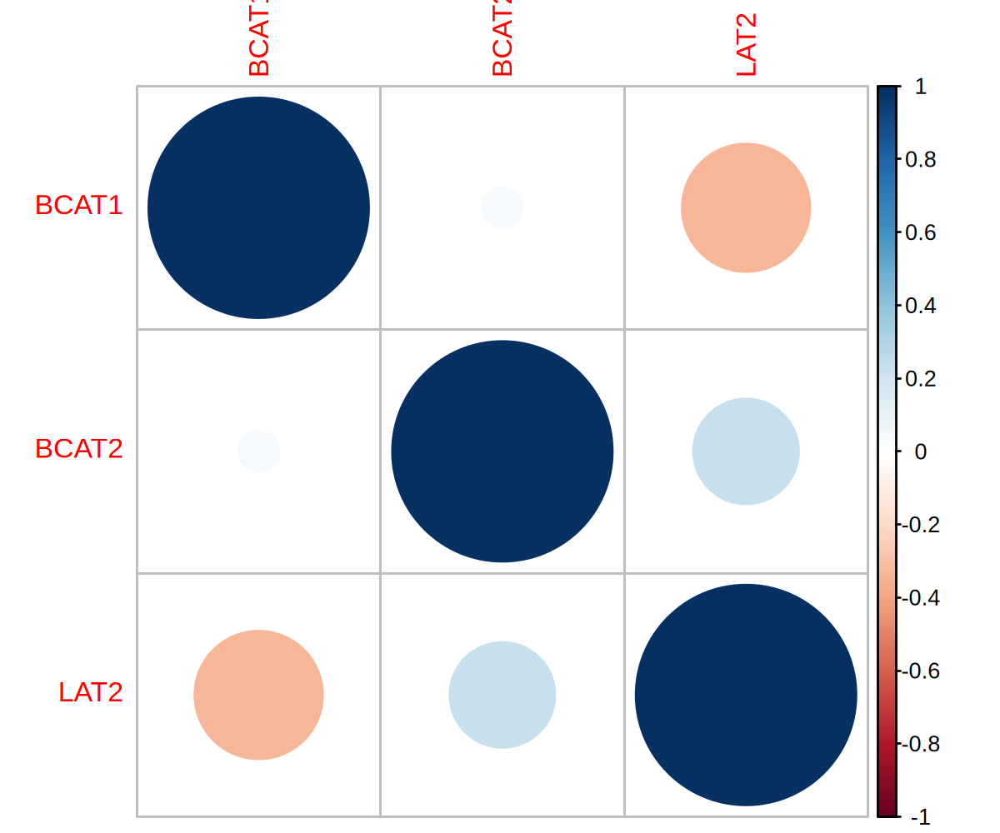

In [378]:
genes = c('BCAT1', 'BCAT2', 'SLC7A8', 'BCKDK')
genes = c('BCAT1', 'BCAT2', 'LAT2')
plotdat = logcpm_t[, genes, with = F]
plotdat = cor(plotdat)
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)
corrplot(plotdat) # colorful number


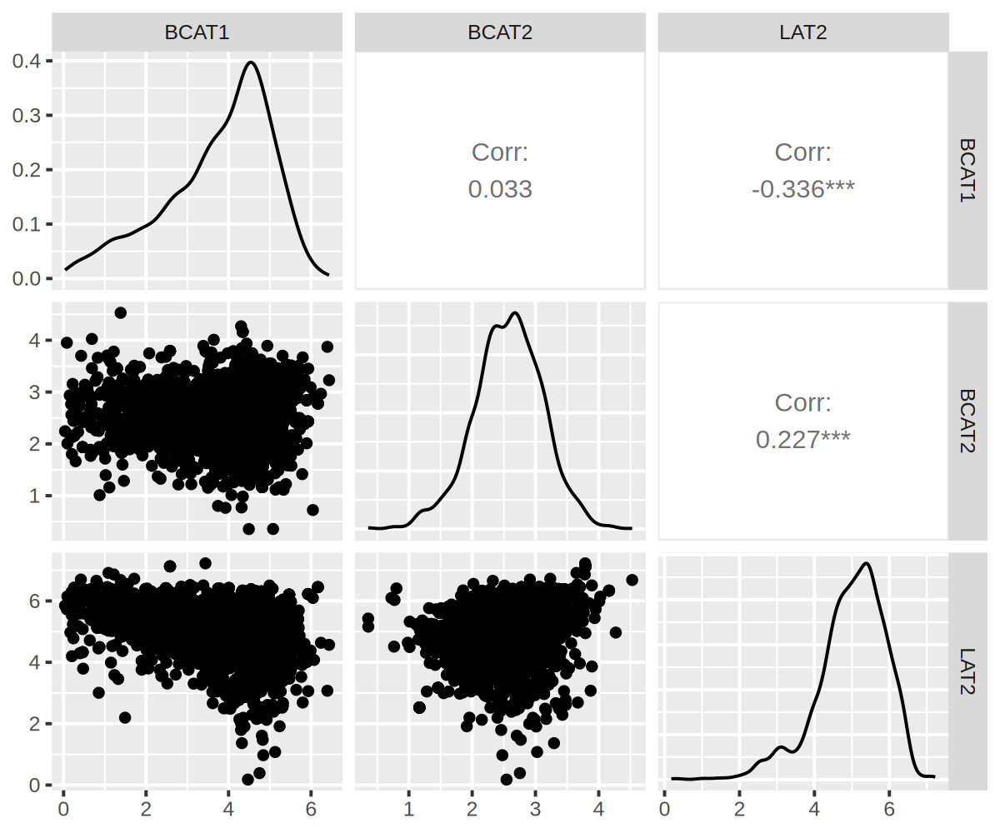

In [386]:
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)
ggpairs(logcpm_t, columns = genes)


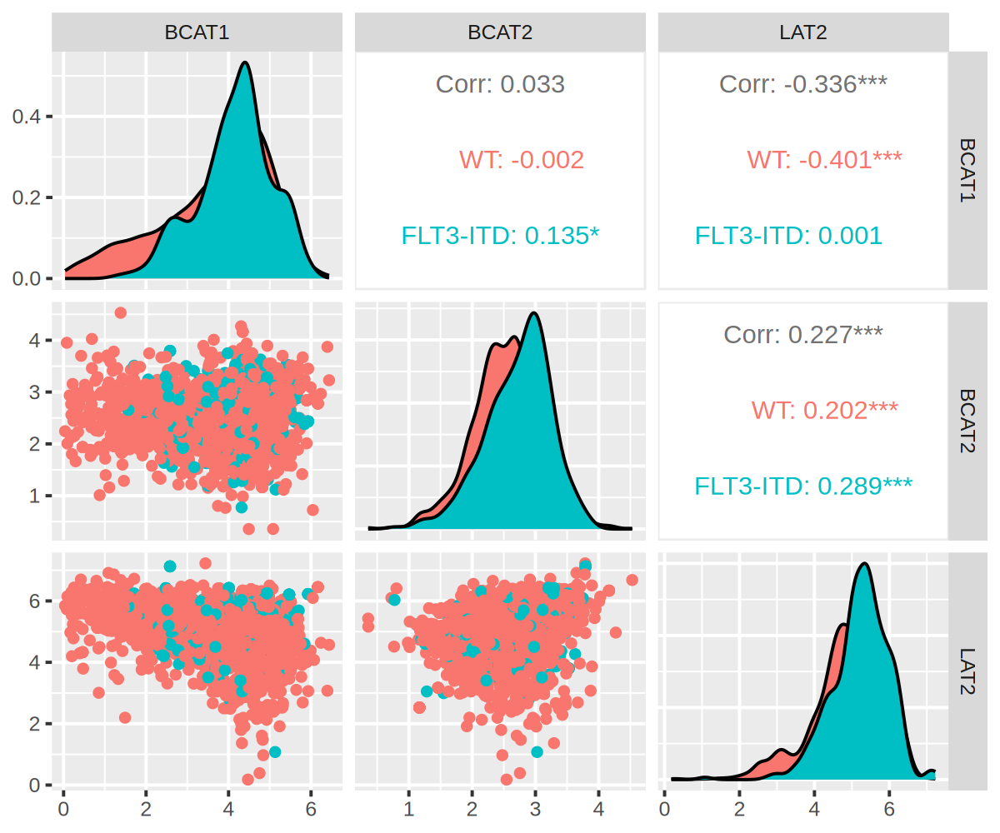

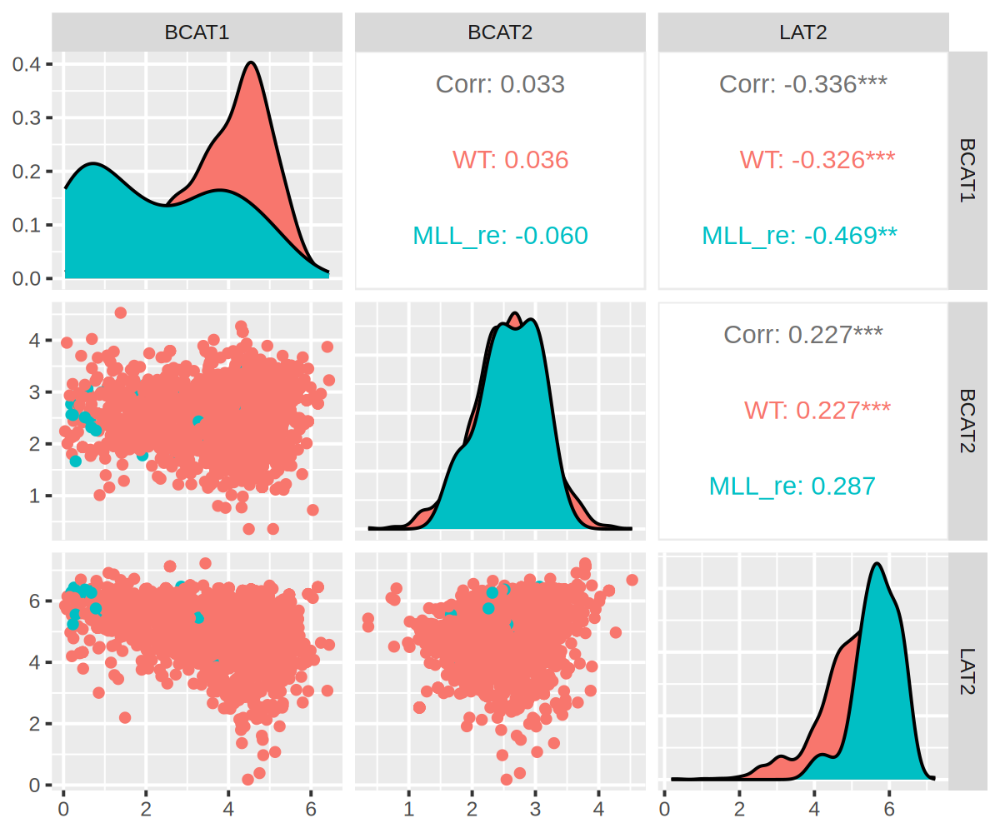

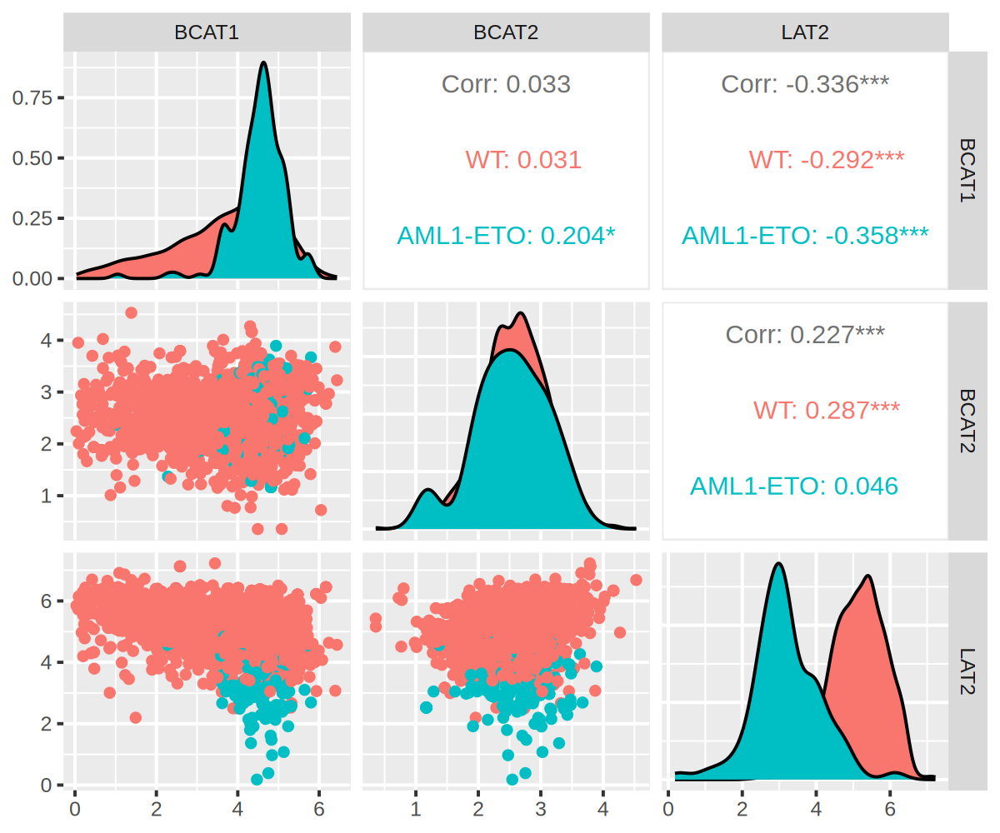

In [380]:
ggpairs(logcpm_t, columns = genes, aes(color = FLT3ITD))
ggpairs(logcpm_t, columns = genes, aes(color = MLL_re))
ggpairs(logcpm_t, columns = genes, aes(color = AML1ETO))

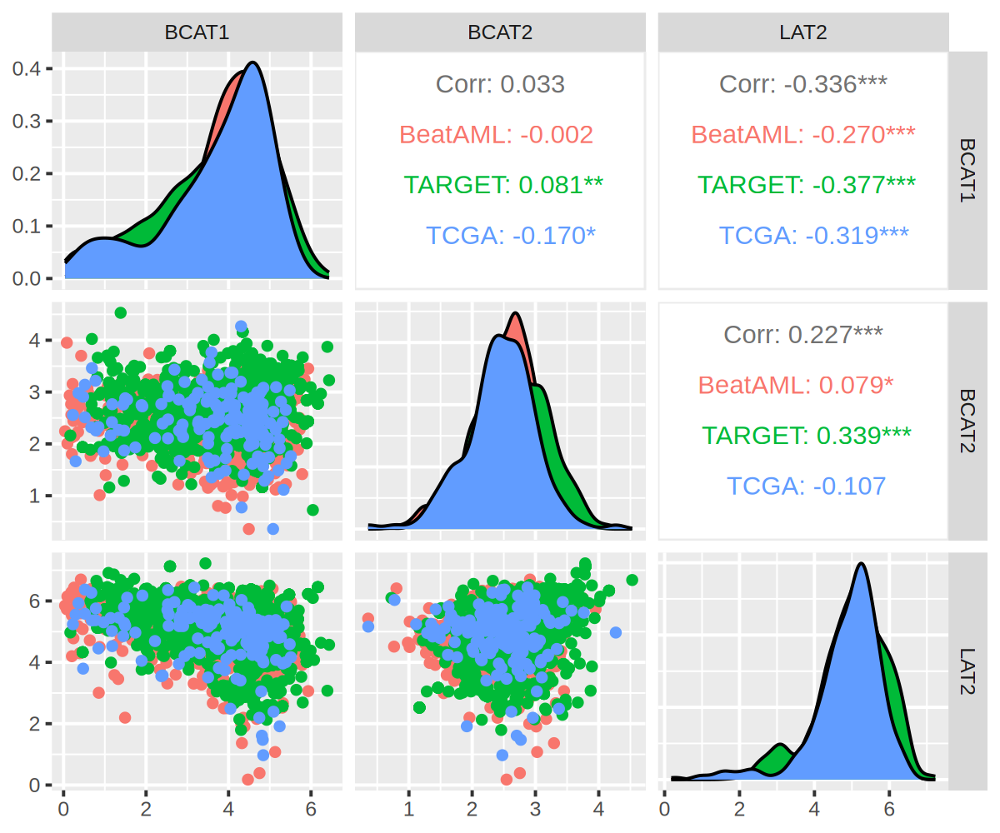

In [435]:
ggpairs(logcpm_t, columns = c('BCAT1', 'BCAT2', 'LAT2'), aes(color = batch))


## gene expression by molecular subtypes

### BCAT1/2

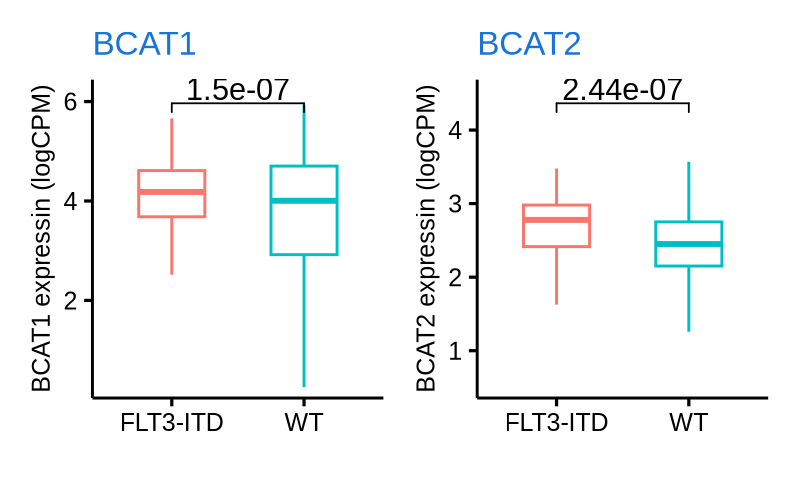

In [320]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/expression_BCAT12_both.pdf'), width = 4, height = 2.5)


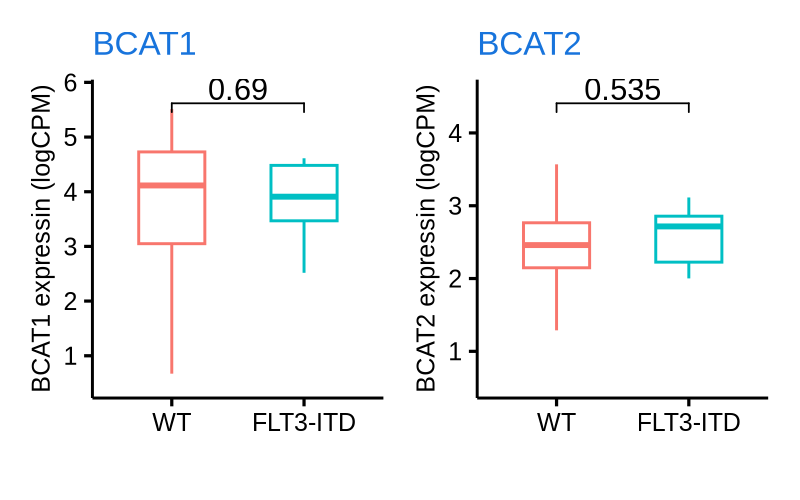

In [321]:
plotdat = logcpm_t[batch %in% c( 'TCGA'), ]
#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/expression_BCAT12_TCGA.pdf'), width = 4, height = 2.5)


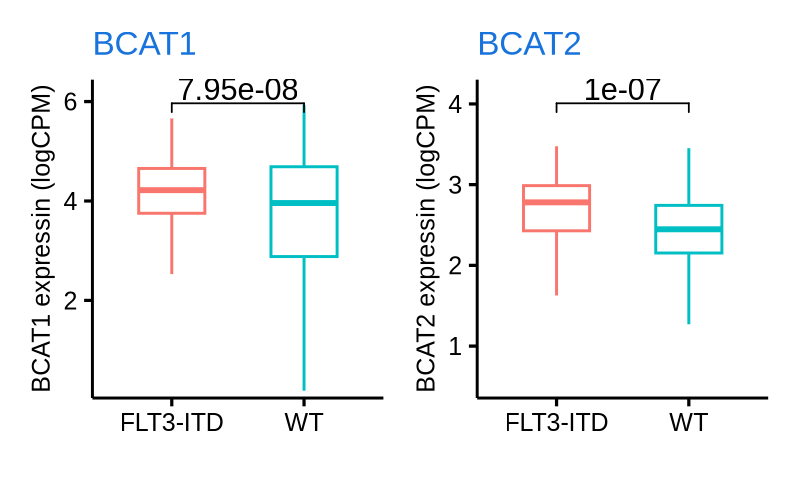

In [322]:
plotdat = logcpm_t[batch %in% c( 'BeatAML'), ]
#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
cname = 'FLT3ITD'
vname = 'BCAT1'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg1 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

cname = 'FLT3ITD'
vname = 'BCAT2'

stat.test = plotdat %>% select(!!sym(vname), !!sym(cname)) %>% 
mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
stat.test <- stat.test %>% add_xy_position(x = cname)

gg2 = ggboxplot(plotdat, y = vname, x = cname, color = cname, outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = paste0('~/WenhuoHu/plot/expression_BCAT12_TCGA.pdf'), width = 4, height = 2.5)


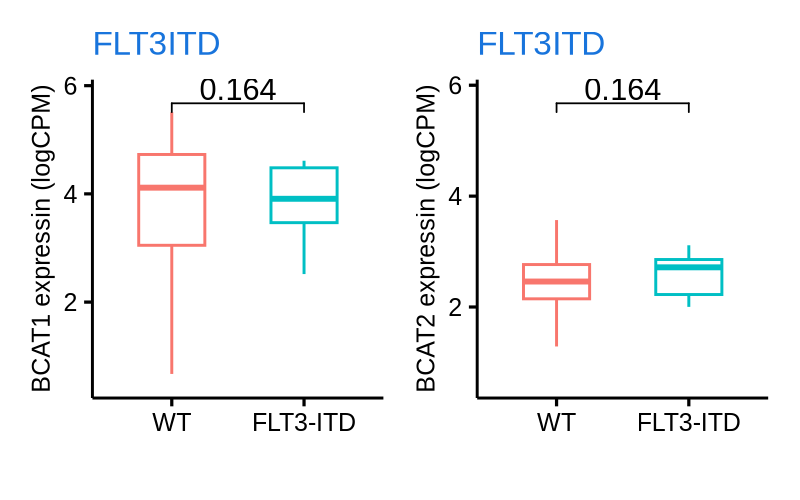

In [314]:
plotdat = logcpm_t[batch %in% c( 'TCGA'), ]
#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
vname = 'FLT3ITD'
gname = 'BCAT1'
gg1 = ggboxplot(plotdat, y = gname, x = vname, color = vname, outlier.shape = NA, width = .5) + 
ylab(paste0(gname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

vname = 'FLT3ITD'
gname = 'BCAT2'
gg2 = ggboxplot(plotdat, y = gname, x = vname, color = vname, outlier.shape = NA, width = .5) + 
ylab(paste0(gname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = '~/WenhuoHu/plot/expression_BCAT1_tcga.pdf', width = 4, height = 2.5)


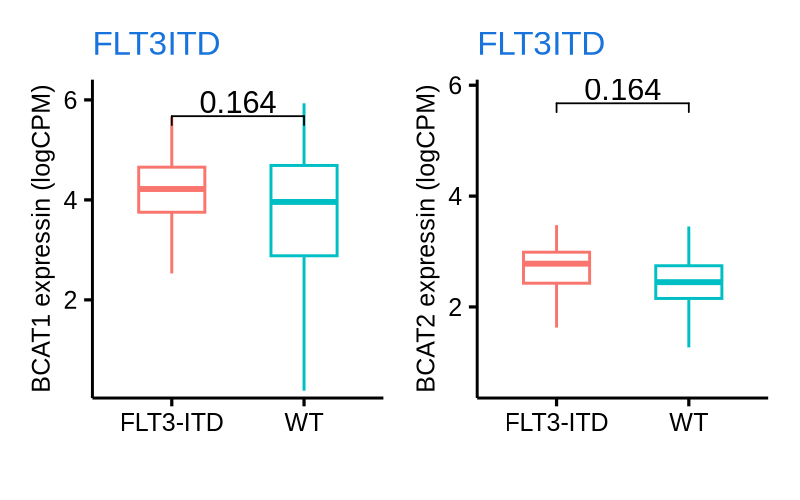

In [315]:
plotdat = logcpm_t[batch %in% c( 'BeatAML'), ]
#plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
#plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
vname = 'FLT3ITD'
gname = 'BCAT1'
gg1 = ggboxplot(plotdat, y = gname, x = vname, color = vname, outlier.shape = NA, width = .5) + 
ylab(paste0(gname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

vname = 'FLT3ITD'
gname = 'BCAT2'
gg2 = ggboxplot(plotdat, y = gname, x = vname, color = vname, outlier.shape = NA, width = .5) + 
ylab(paste0(gname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))

options(repr.plot.width = 4, repr.plot.height = 2.5, repr.plot.res = 200)
gg = gg1 | gg2
gg

ggsave(gg, file = '~/WenhuoHu/plot/expression_BCAT1_BeatAML.pdf', width = 4, height = 2.5)


In [589]:
vnames = genes
cnames = c('FLT3ITD', 'AML1ETO', 'MLL_re')
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep

[1] "BCAT1" "BCAT1" "BCAT1" "BCAT2" "BCAT2" "BCAT2" "LAT2"  "LAT2"  "LAT2"

[1] "FLT3ITD" "AML1ETO" "MLL_re"  "FLT3ITD" "AML1ETO" "MLL_re"  "FLT3ITD" "AML1ETO" "MLL_re"

[1] "BCAT1" "BCAT1" "BCAT1" "BCAT2" "BCAT2" "BCAT2" "LAT2"  "LAT2"  "LAT2"  "BCKDK" "BCKDK" "BCKDK"

[1] "FLT3ITD" "AML1ETO" "MLL_re"  "FLT3ITD" "AML1ETO" "MLL_re"  "FLT3ITD" "AML1ETO" "MLL_re"  "FLT3ITD" "AML1ETO" "MLL_re"

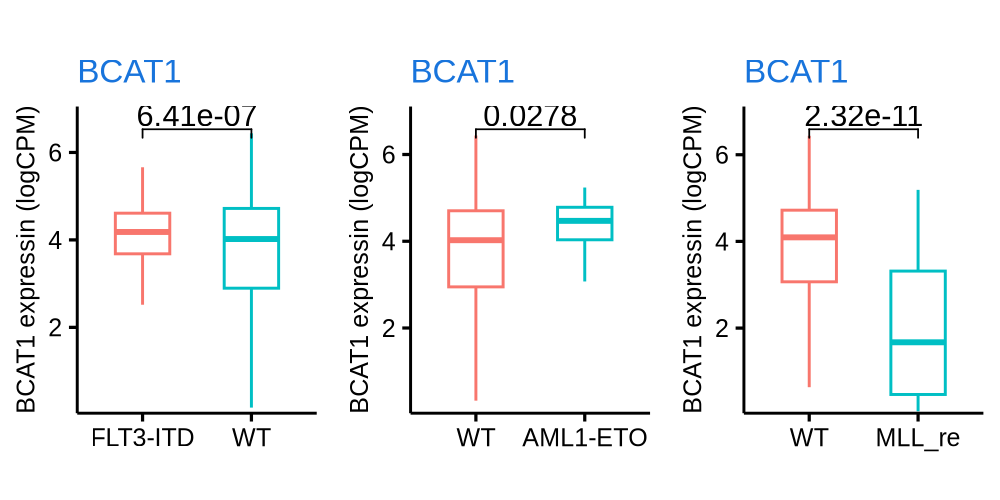

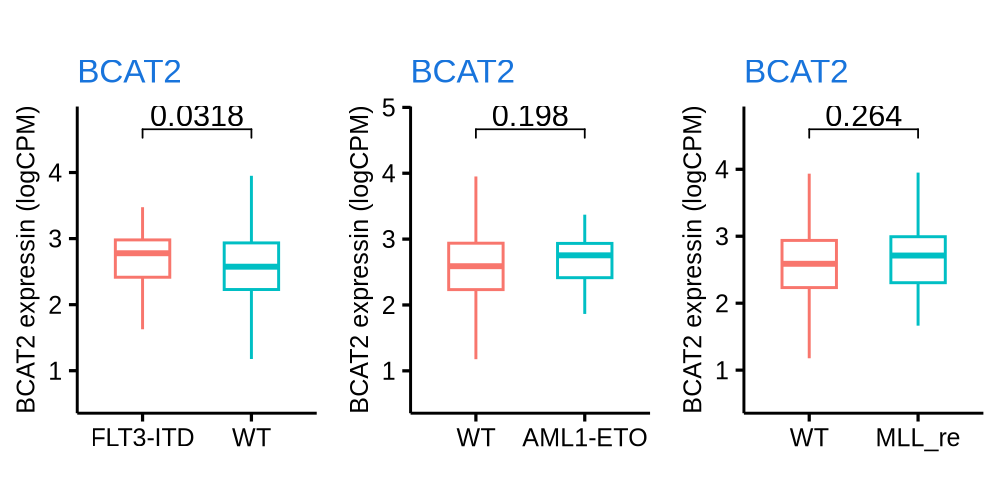

[[1]]
NULL

[[2]]
NULL

[[3]]
NULL

[[4]]
NULL


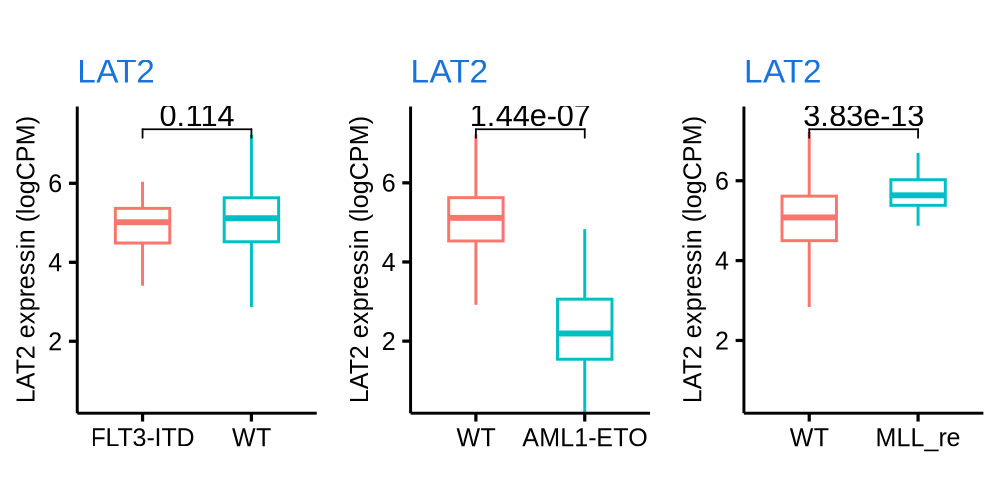

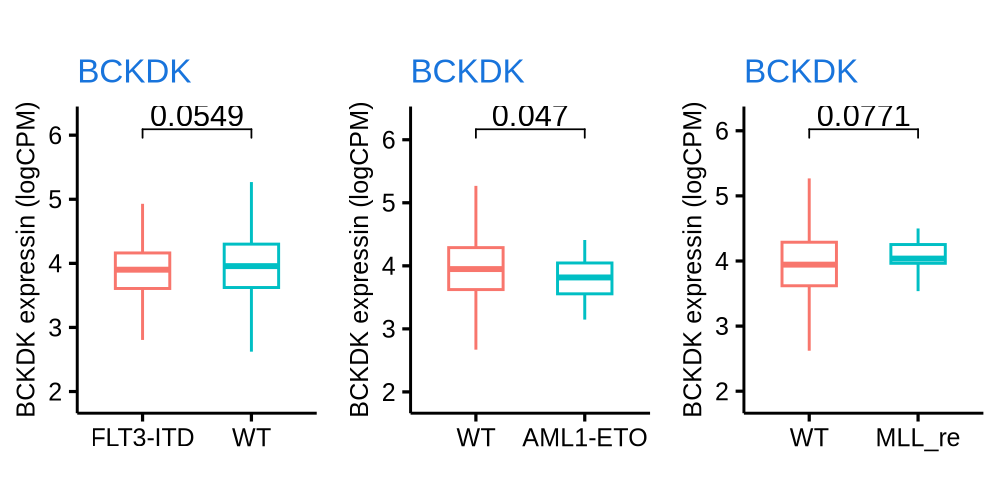

In [323]:
vnames = genes
cnames = c('FLT3ITD', 'AML1ETO', 'MLL_re')
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    stat.test = logcpm_t %>% select(!!sym(vname), !!sym(cname)) %>% 
    mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
    t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
    stat.test <- stat.test %>% add_xy_position(x = cname)
    #gg1 = ggboxplot(logcpm_t, x = cname, y = vname, outlier.shape = NA, color = cname, alpha = .2, width = .5) + 
    gg1 = ggboxplot(logcpm_t, x = cname, y = vname, color = cname, outlier.shape = NA, width = .5) + 
    ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
    theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
    stat_pvalue_manual(stat.test, label = "p") + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))
    gg1
})

options(repr.plot.width = 5, repr.plot.height = 2.5, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 3, nrow = 1, top = '', by)


In [638]:
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    stat.test = logcpm_t %>% select(!!sym(vname), !!sym(cname)) %>% 
    mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
    t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
    stat.test <- stat.test %>% add_xy_position(x = cname)
    #gg1 = ggboxplot(logcpm_t, x = cname, y = vname, outlier.shape = NA, color = cname, alpha = .2, width = .5) + 
    gg1 = ggboxplot(logcpm_t, x = cname, y = vname, color = cname, outlier.shape = NA, width = .5) + 
    ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
    theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
    stat_pvalue_manual(stat.test, label = "p") + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))
    gg1
})


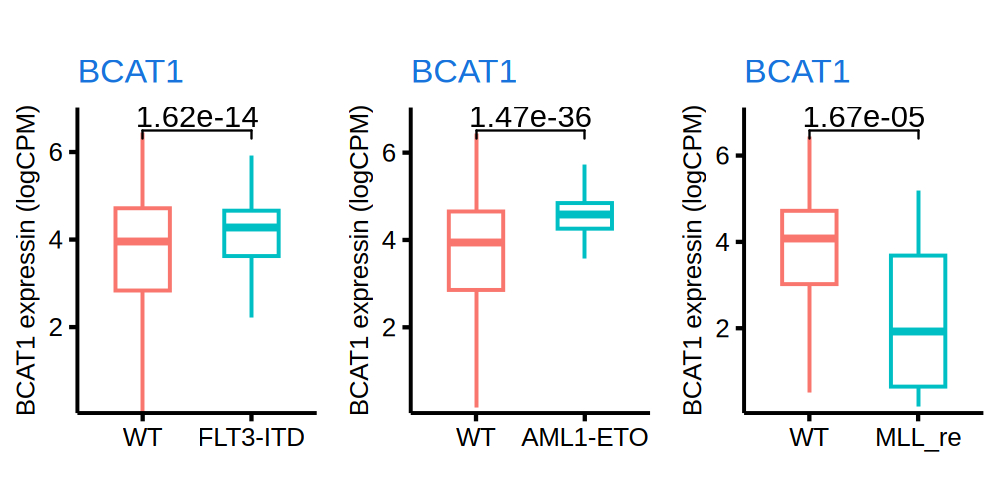

[[1]]
NULL

[[2]]
NULL

[[3]]
NULL


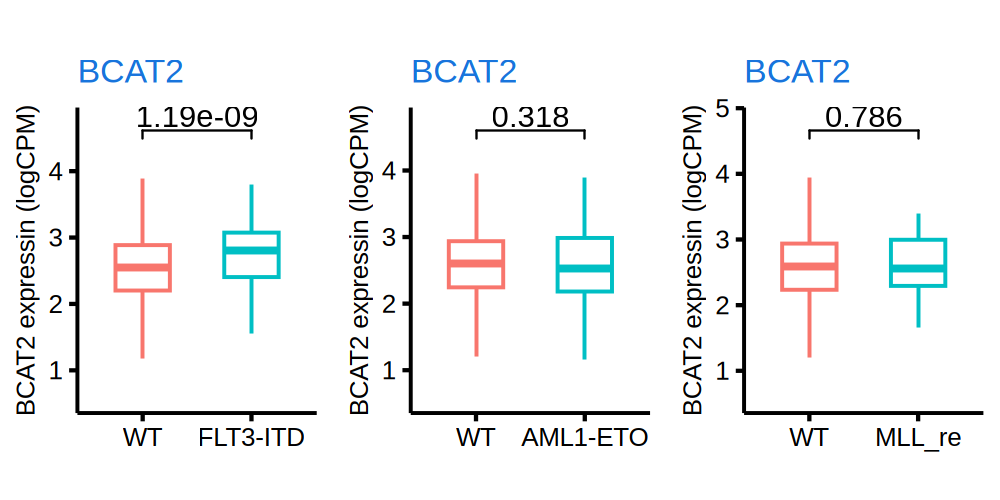

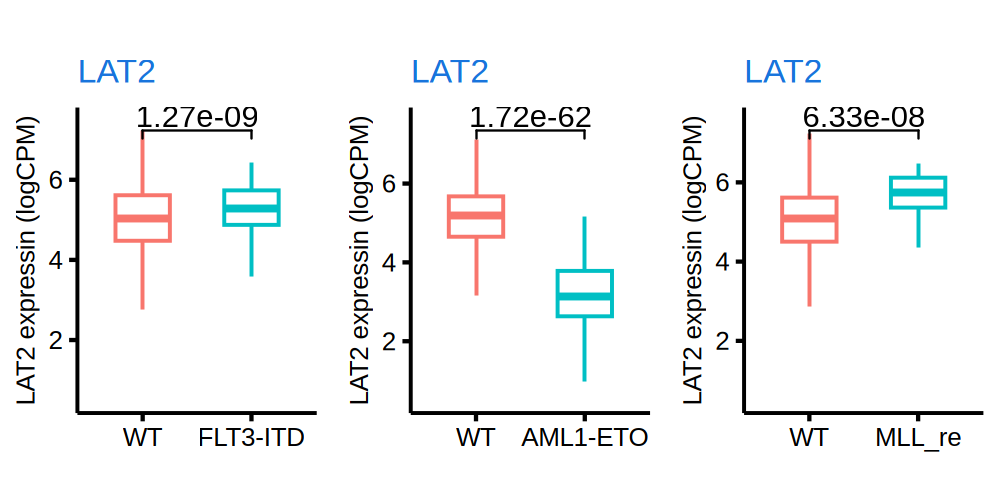

In [639]:
options(repr.plot.width = 5, repr.plot.height = 2.5, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 3, nrow = 1, top = '', by)


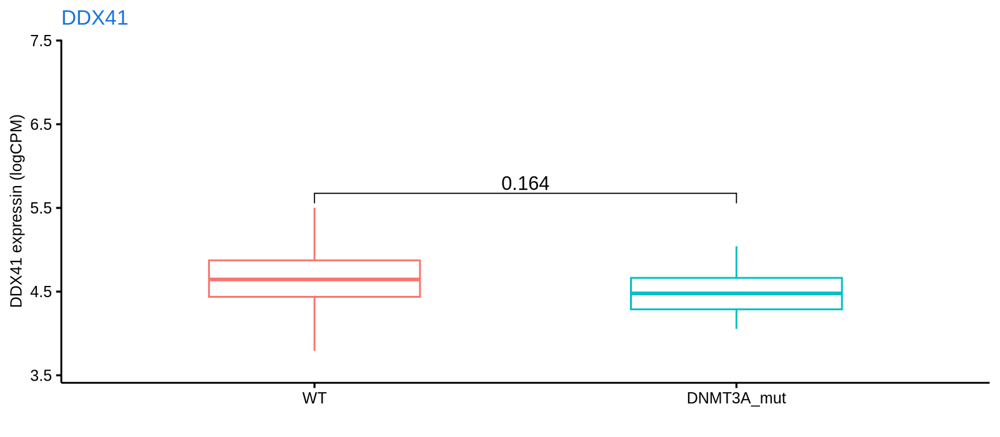

In [258]:
gg1 = ggboxplot(logcpm_t, x = 'DNMT3A_mut', y = 'DDX41', color = 'DNMT3A_mut', outlier.shape = NA, width = .5) + 
ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
stat_pvalue_manual(stat.test, label = "p") + 
scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))
gg1


In [259]:
aml_mut

[1] "TET2_mut"   "DNMT3A_mut" "SF3B1_mut"  "TP53_mut"   "PPM1D_mut"  "ASXL1_mut"  "NRAS_mut"   "JAK2_mut"   "GNB1_mut"   "KRAS_mut"   "CBL_mut"    "IDH1_mut"   "IDH2_mut"   "MLL_re"    
[15] "FLT3ITD"    "AML1ETO"    "PMLRARA"    "CBFBMYH11"  "GATA2MECOM"

In [282]:
cname = 'GATA2MECOM'
table(logcpm_t[, cname, with=F])


GATA2MECOM
            GATA2-MECOM 
       1920          11 

In [286]:
cnames

[1] "TET2_mut"   "DNMT3A_mut" "SF3B1_mut"  "TP53_mut"   "ASXL1_mut"  "NRAS_mut"   "JAK2_mut"   "KRAS_mut"   "CBL_mut"    "IDH1_mut"   "IDH2_mut"   "MLL_re"     "FLT3ITD"    "AML1ETO"   
[15] "PMLRARA"    "CBFBMYH11"  "GATA2MECOM"

In [287]:
(logcpm_t[GATA2MECOM == '',  GATA2MECOM := 'WT'])

[1] "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41" "DDX41"

[1] "TET2_mut"   "DNMT3A_mut" "SF3B1_mut"  "TP53_mut"   "ASXL1_mut"  "NRAS_mut"   "JAK2_mut"   "KRAS_mut"   "CBL_mut"    "IDH1_mut"   "IDH2_mut"   "MLL_re"     "FLT3ITD"    "AML1ETO"   
[15] "PMLRARA"    "CBFBMYH11"  "GATA2MECOM"

TET2_mut

DNMT3A_mut

SF3B1_mut

TP53_mut

ASXL1_mut

NRAS_mut

JAK2_mut

KRAS_mut

CBL_mut

IDH1_mut

IDH2_mut

MLL_re

FLT3ITD

AML1ETO

PMLRARA

CBFBMYH11

GATA2MECOM



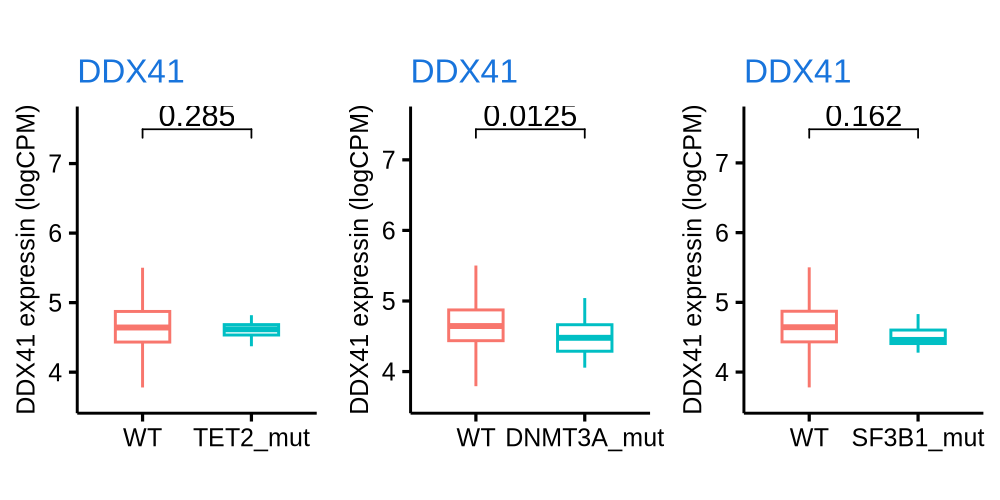

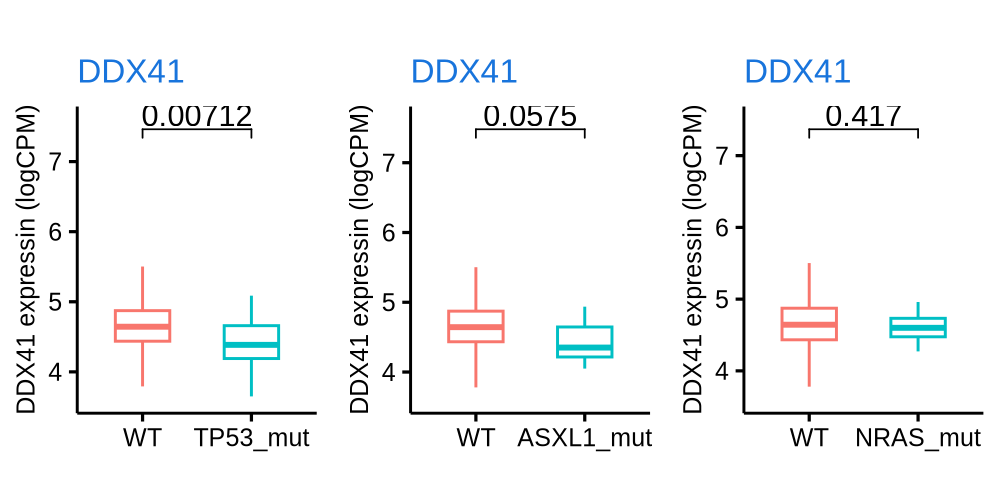

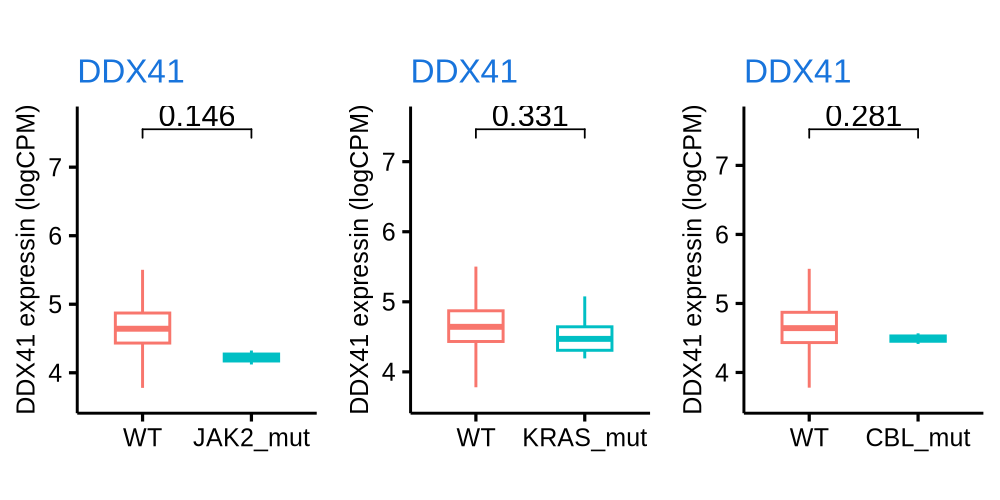

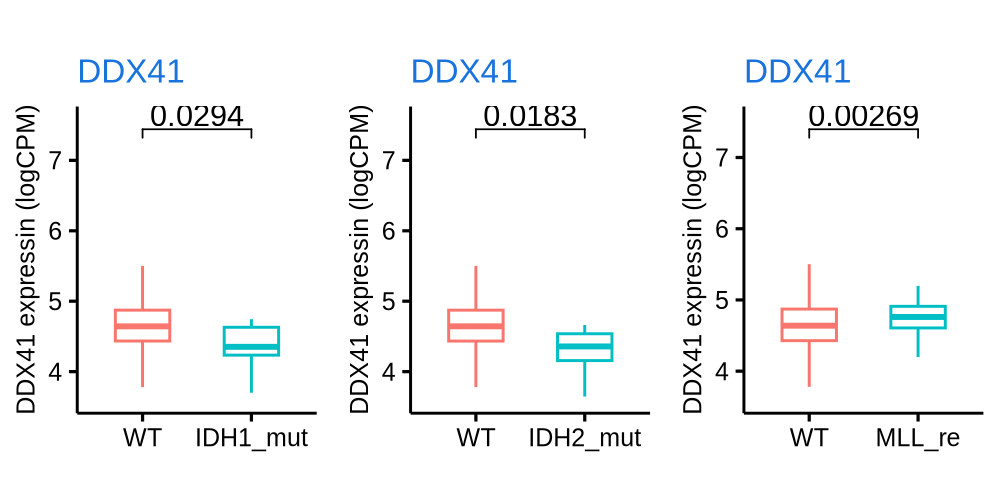

[[1]]
NULL

[[2]]
NULL

[[3]]
NULL

[[4]]
NULL

[[5]]
NULL

[[6]]
NULL


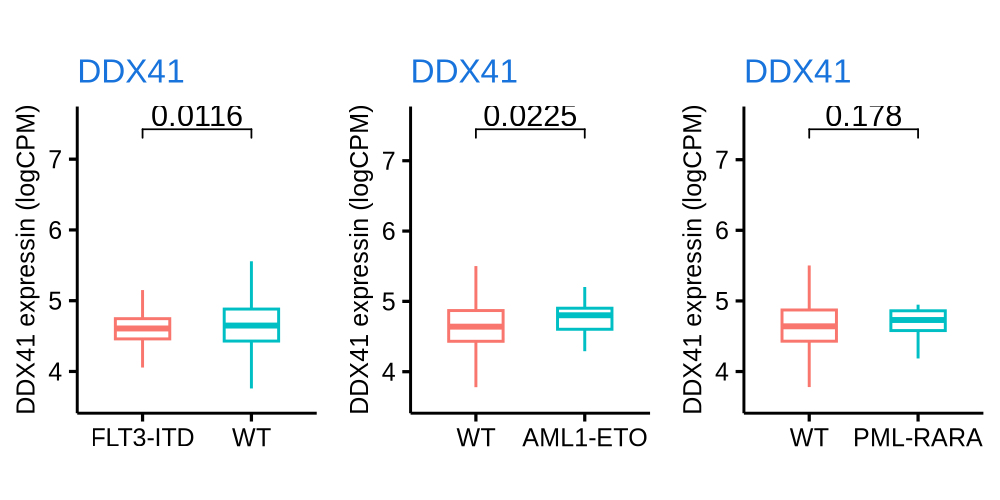

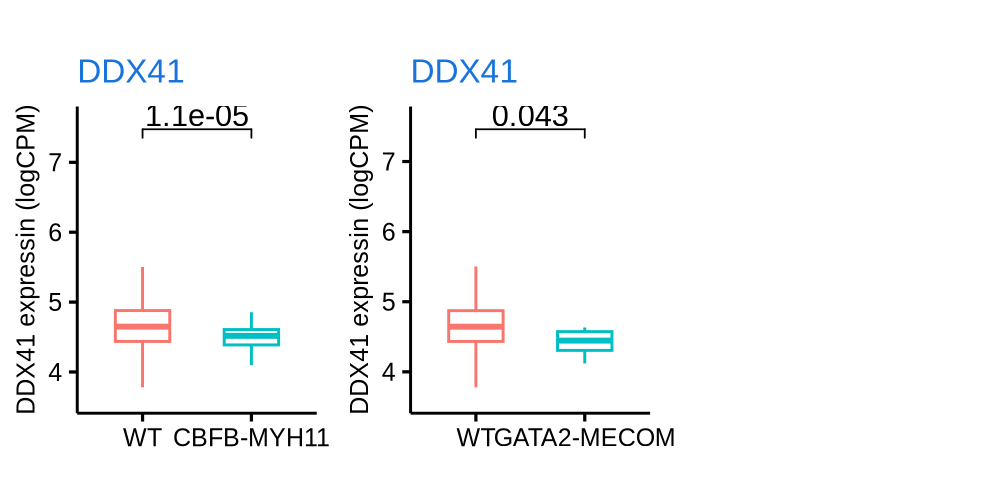

In [288]:
vnames = 'DDX41'
cnames = c('FLT3ITD', 'AML1ETO', 'MLL_re', 'DNMT3A_mut', 'IDH1_mut', 'IDH2_mut', '')
cnames = intersect(aml_mut, colnames(logcpm_t))
cnames = cnames[unlist(lapply(1:length(cnames), function(ii){
    cname = cnames[ii]
    dim(table(logcpm_t[, cname, with=F])) > 1 & min(table(logcpm_t[, cname, with=F])) > 1
}))]
vnames_rep = rep(vnames, each = length(cnames))
cnames_rep = rep(cnames, times = length(vnames))

vnames_rep
cnames_rep
gg_list = lapply(1:length(vnames_rep), function(ii){
    vname = vnames_rep[ii]
    cname = cnames_rep[ii]
    message(cname)
    stat.test = logcpm_t %>% select(!!sym(vname), !!sym(cname)) %>% 
    mutate(across(!!sym(cname), factor)) %>% mutate(across(!!sym(cname), ~ relevel(.x, ref = 'WT'))) %>% 
    t_test(as.formula(paste0(vname, ' ~ ', cname))) %>% add_significance()
    stat.test <- stat.test %>% add_xy_position(x = cname)
    #gg1 = ggboxplot(logcpm_t, x = cname, y = vname, outlier.shape = NA, color = cname, alpha = .2, width = .5) + 
    gg1 = ggboxplot(logcpm_t, x = cname, y = vname, color = cname, outlier.shape = NA, width = .5) + 
    ylab(paste0(vname, ' expressin (logCPM)')) + ggtitle(vname) + 
    theme(axis.text = element_text(size = 9), axis.title = element_text(size = 9), plot.title = element_text(size = 12, color = '#1874DC')) +
    stat_pvalue_manual(stat.test, label = "p") + 
    scale_y_continuous(expand = expansion(mult = c(0, 0.08))) + theme(legend.position="none") + xlab('') +
    theme(axis.text.x = element_text(angle = 0, vjust = 1, hjust = .5))
    gg1
})

options(repr.plot.width = 5, repr.plot.height = 2.5, repr.plot.res = 200)
gridExtra::marrangeGrob(gg_list, ncol = 3, nrow = 1, top = '', by)


## survival analysis 

In [462]:
genes = c('BCAT1', 'BCAT2', 'LAT2')#, 'BCKDK')
genes_cat = paste0(genes, '')


In [ ]:
BeatAML  TARGET    TCGA 
    671    1087     173 


In [249]:
logcpm_t[OS_STATUS == 0, OS_STATUS2 := 0 ]
logcpm_t[OS_STATUS == 1, OS_STATUS2 := 1 ]
logcpm_t[OS_STATUS == '1:DECEASED', OS_STATUS2 := 1 ]
logcpm_t[OS_STATUS == '0:LIVING', OS_STATUS2 := 0 ]
logcpm_t[OS_STATUS == 'Alive', OS_STATUS2 := 0 ]
logcpm_t[OS_STATUS == 'Dead', OS_STATUS2 := 1 ]

In [28]:
head2(logcpm_t)

rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000R,0.02926131,0.4846250,0.18884637,0.1122339
BA2003R,0.90268049,0.4228661,0.03690553,0.3191444
BA2004R,0.75782187,0.3605750,0.02383337,1.0413694


### bcat1 survival analysis 

In [394]:
##### mar7

dat = logcpm_t[, .(batch, OS_MONTHS, OS_STATUS2, BCAT1, BCAT2, FLT3ITD) ]
fwrite(dat, file = '~/WenhuoHu/plot/mar/logcpm_beataml_tcga_clin.xls', sep = '\t')


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 822   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


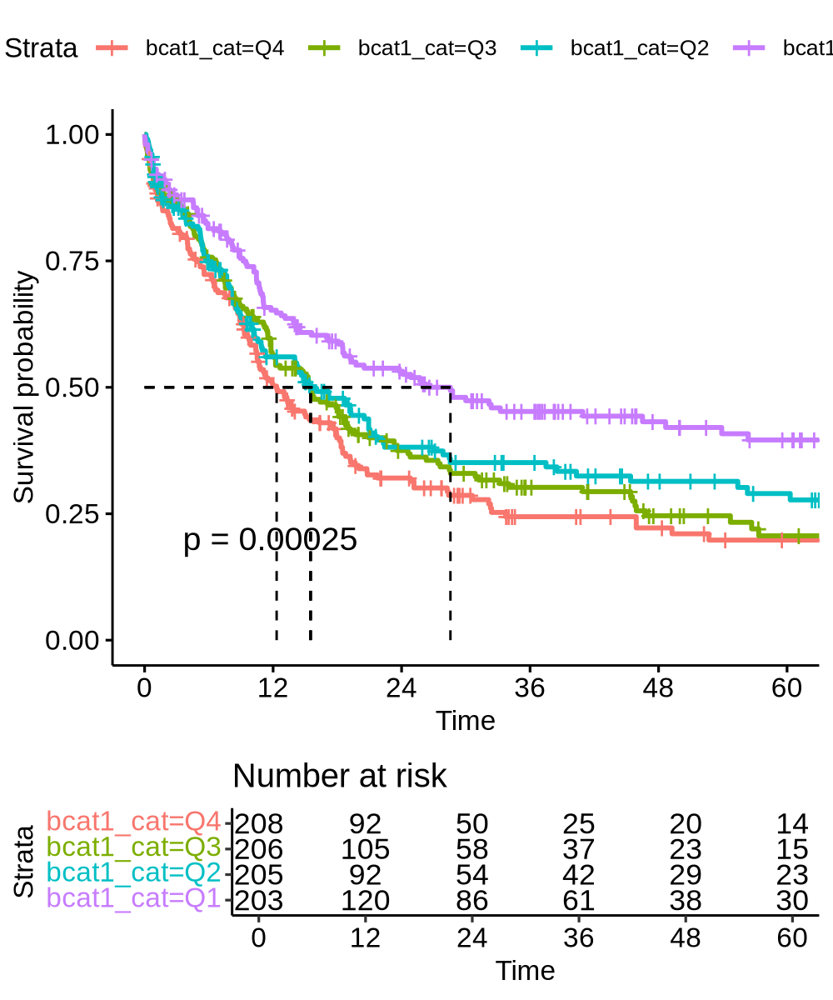

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


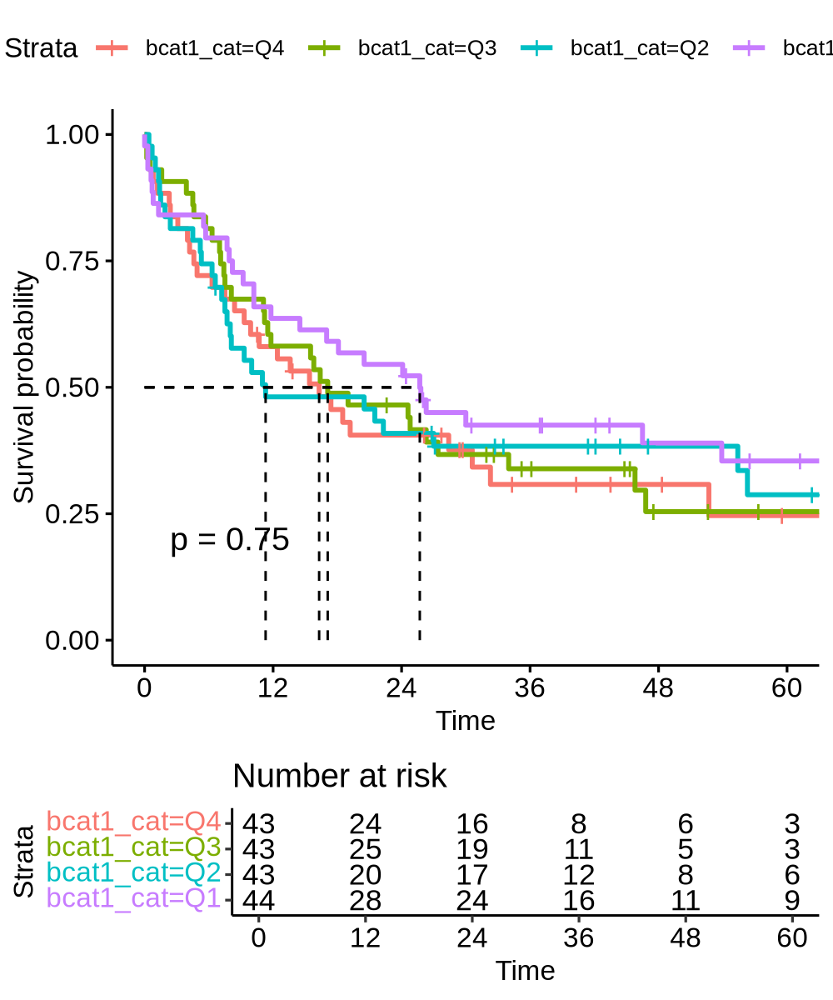

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

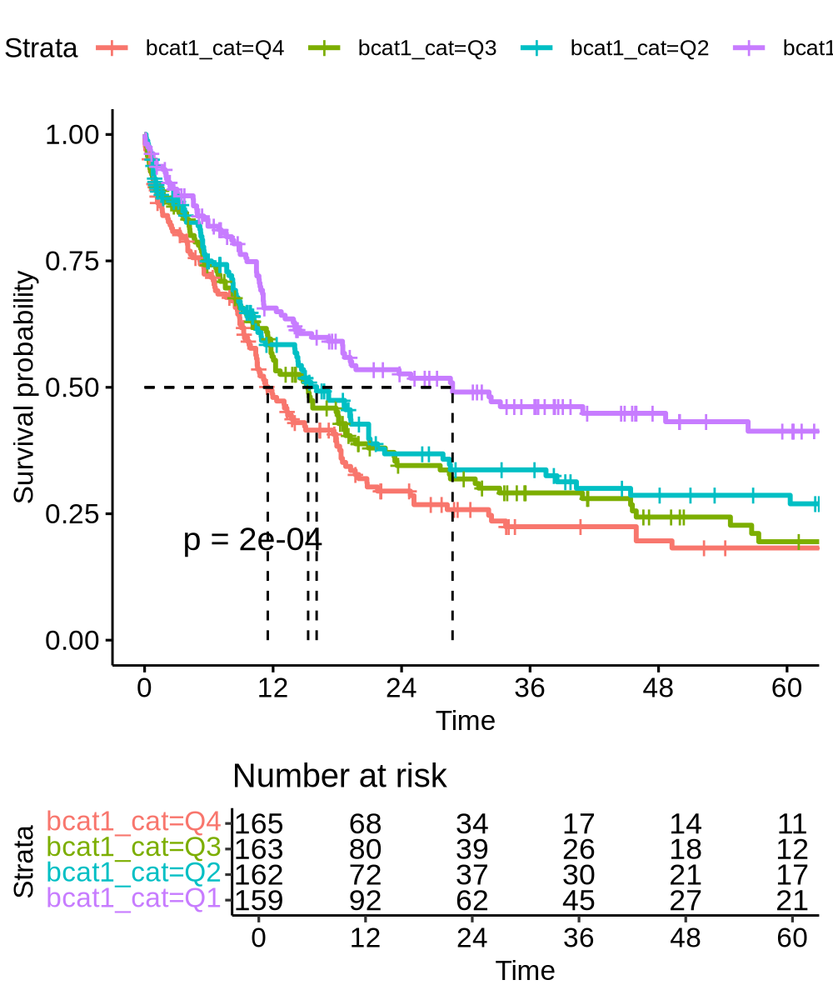

In [395]:
##### mar7

plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat1_cat := factor(bcat1_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)


fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat1_tcga_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_tcga = plotdat[batch == 'TCGA', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat_tcga)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_tcga,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat1_tcga_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_beat = plotdat[batch == 'BeatAML', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat_beat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat1_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


### bcat2 survival analysis 

    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 822   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


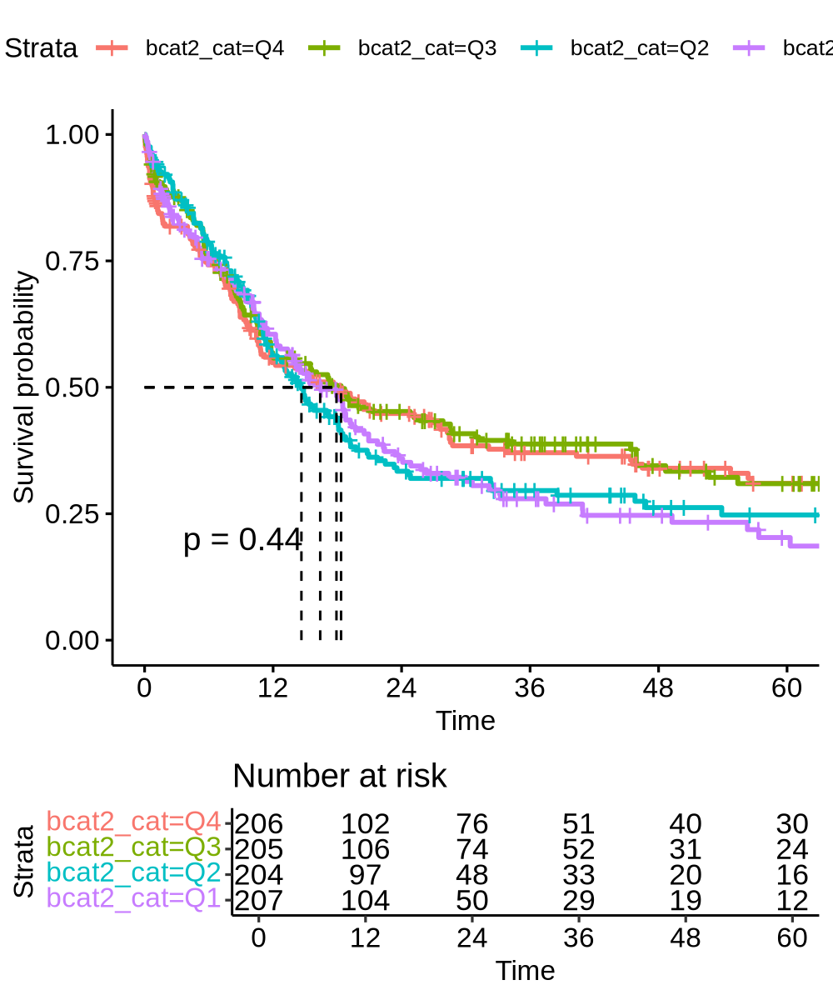

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


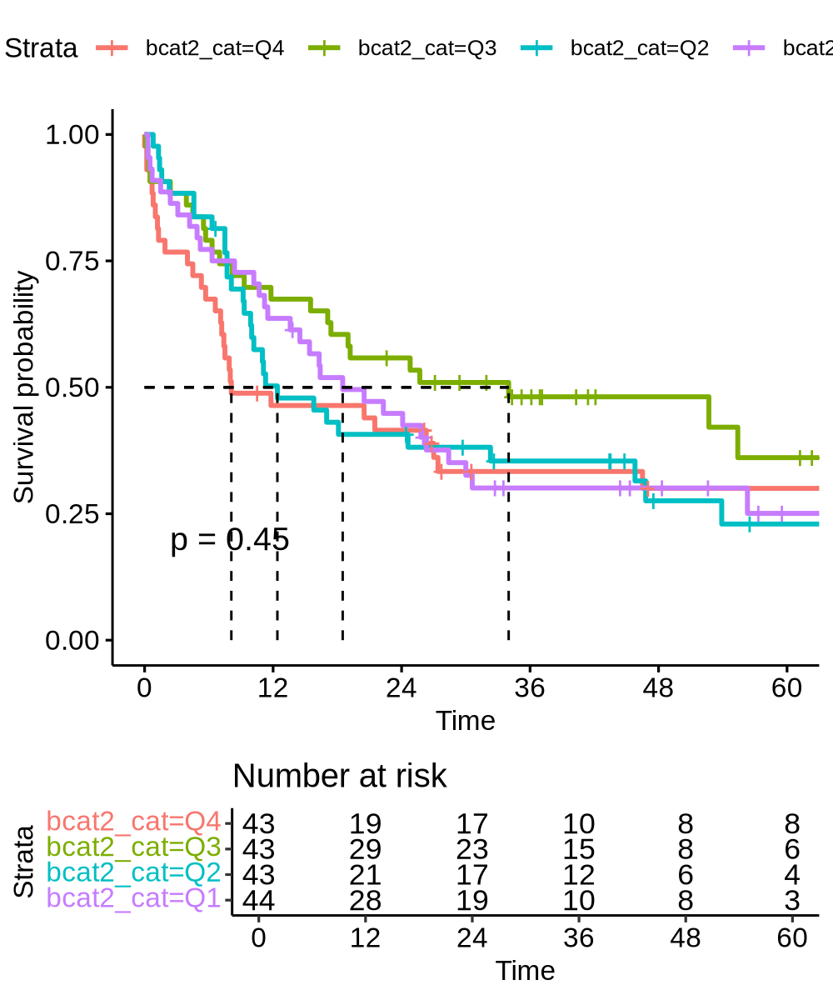

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

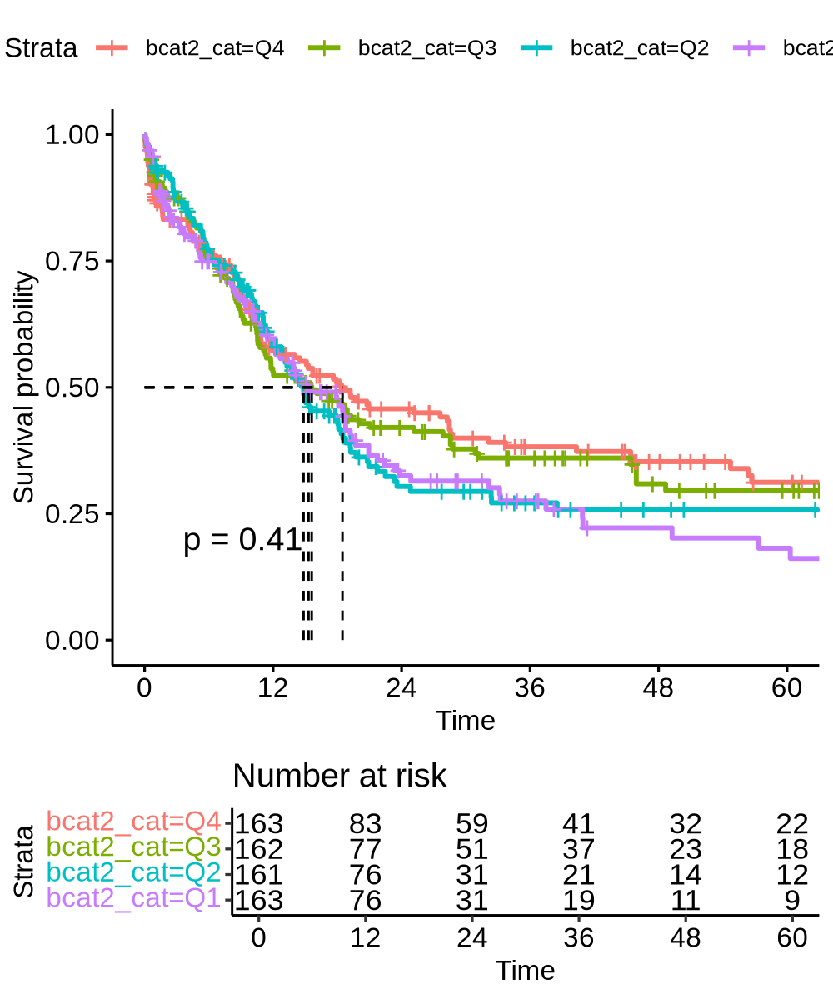

In [396]:
##### mar7

plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat2_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT2], 4) ]
plotdat[grep('BA', rn), bcat2_cat := cut_quantile(plotdat[grep('BA', rn), BCAT2], 4) ]
table(plotdat$bcat2_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat2_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat2_cat := factor(bcat2_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)


fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat2_tcga_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_tcga = plotdat[batch == 'TCGA', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat_tcga)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_tcga,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat2_tcga_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_beat = plotdat[batch == 'BeatAML', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat_beat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_bcat2_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


In [42]:
table(logcpm_t$karyotype)


        Altered  Normal 
   1087     574     270 

    
     BeatAML TCGA
  Q1      44   19
  Q2      43   18
  Q3      43   18
  Q4      44   19

[1] 248   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


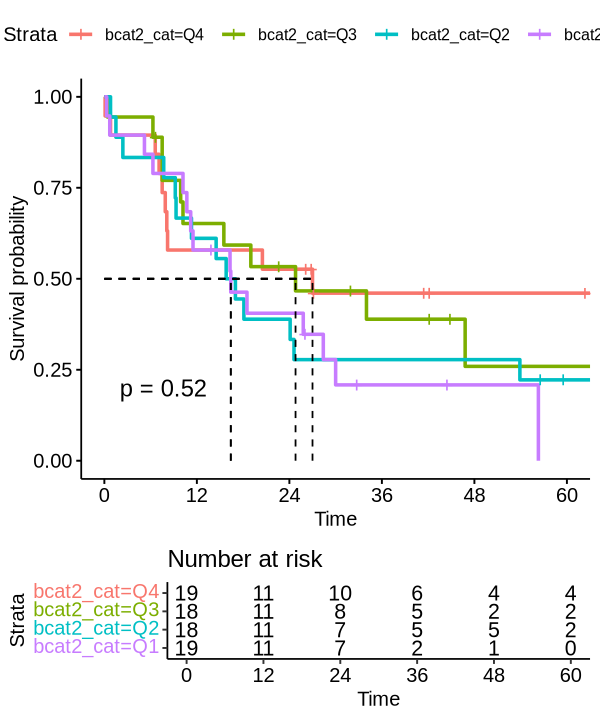

In [41]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat = plotdat[karyotype == 'Normal' & DNMT3A_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT' & TET2_mut == 'WT', ]
plotdat[grep('TCGA', rn), bcat2_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT2], 4) ]
plotdat[grep('BA', rn), bcat2_cat := cut_quantile(plotdat[grep('BA', rn), BCAT2], 4) ]
table(plotdat$bcat2_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat2_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat2_cat := factor(bcat2_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)

plotdat_tcga = plotdat[batch == 'TCGA', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat_tcga)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_tcga,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme


    
     BeatAML TCGA
  Q1      44   19
  Q2      43   18
  Q3      43   18
  Q4      44   19

[1] 248   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


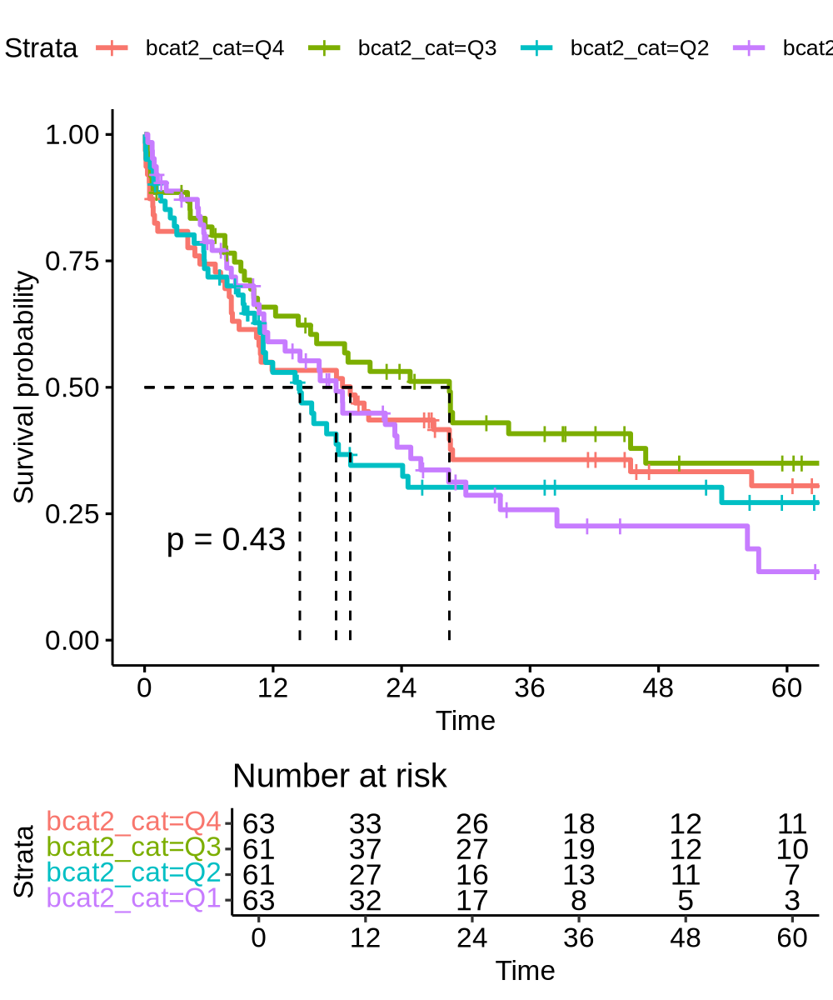

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


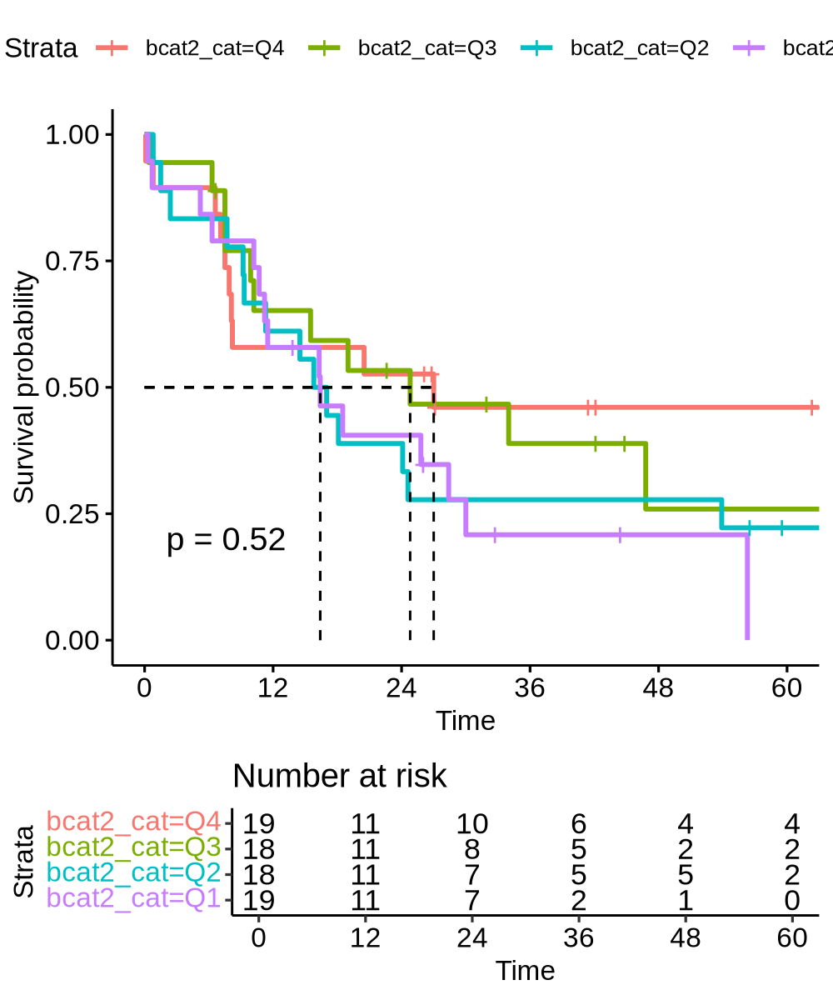

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


pdf 
  2

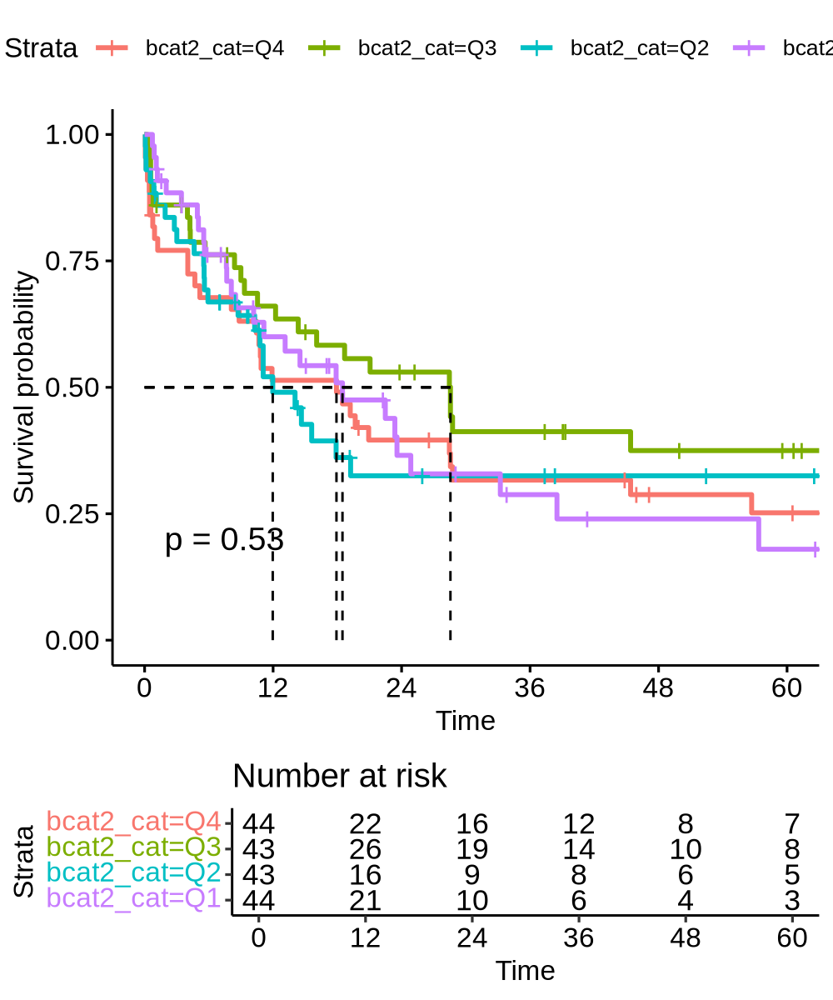

In [393]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat = plotdat[karyotype == 'Normal' & DNMT3A_mut == 'WT' & IDH1_mut == 'WT' & IDH2_mut == 'WT' & TET2_mut == 'WT', ]
plotdat[grep('TCGA', rn), bcat2_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT2], 4) ]
plotdat[grep('BA', rn), bcat2_cat := cut_quantile(plotdat[grep('BA', rn), BCAT2], 4) ]
table(plotdat$bcat2_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat2_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat2_cat := factor(bcat2_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)


fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_wt_bcat2_tcga_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_tcga = plotdat[batch == 'TCGA', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat_tcga)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_tcga,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_wt_bcat2_tcga_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()

plotdat_beat = plotdat[batch == 'BeatAML', ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat_beat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/mar/surv_wt_bcat2_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat_beat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("bcat2 High", "bcat2 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 822   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

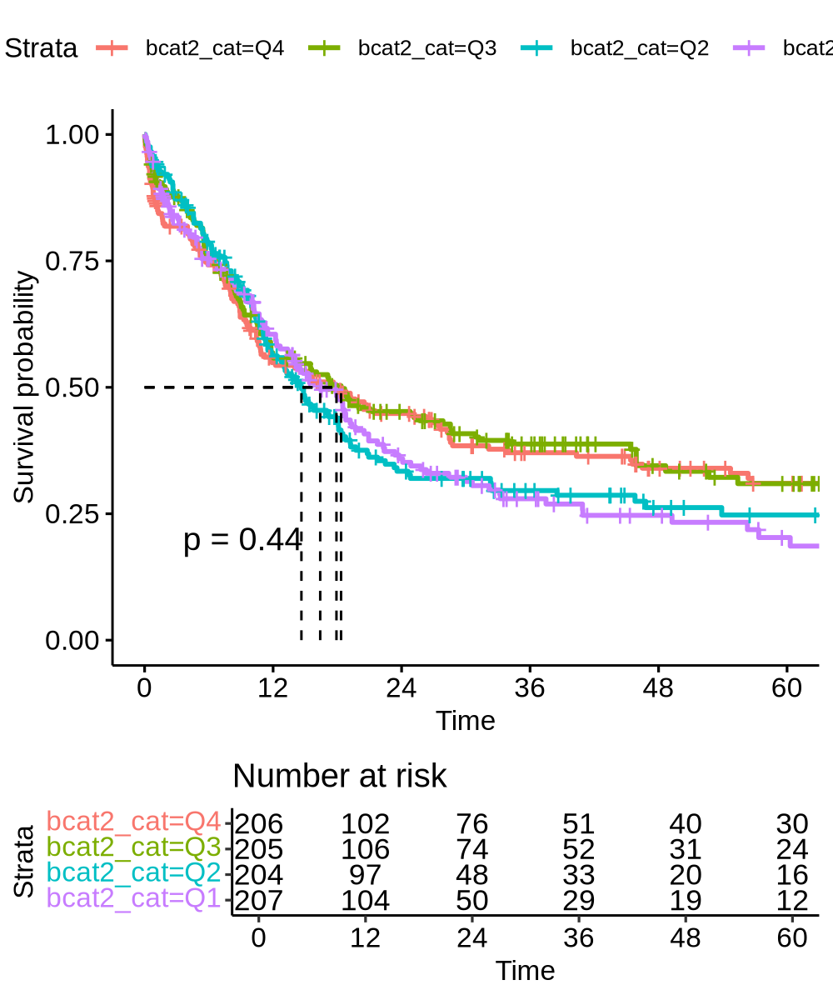

In [297]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat2_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT2], 4) ]
plotdat[grep('BA', rn), bcat2_cat := cut_quantile(plotdat[grep('BA', rn), BCAT2], 4) ]
table(plotdat$bcat2_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat2_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat2_cat := factor(bcat2_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat2_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat2_tcga_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 822   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 4 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

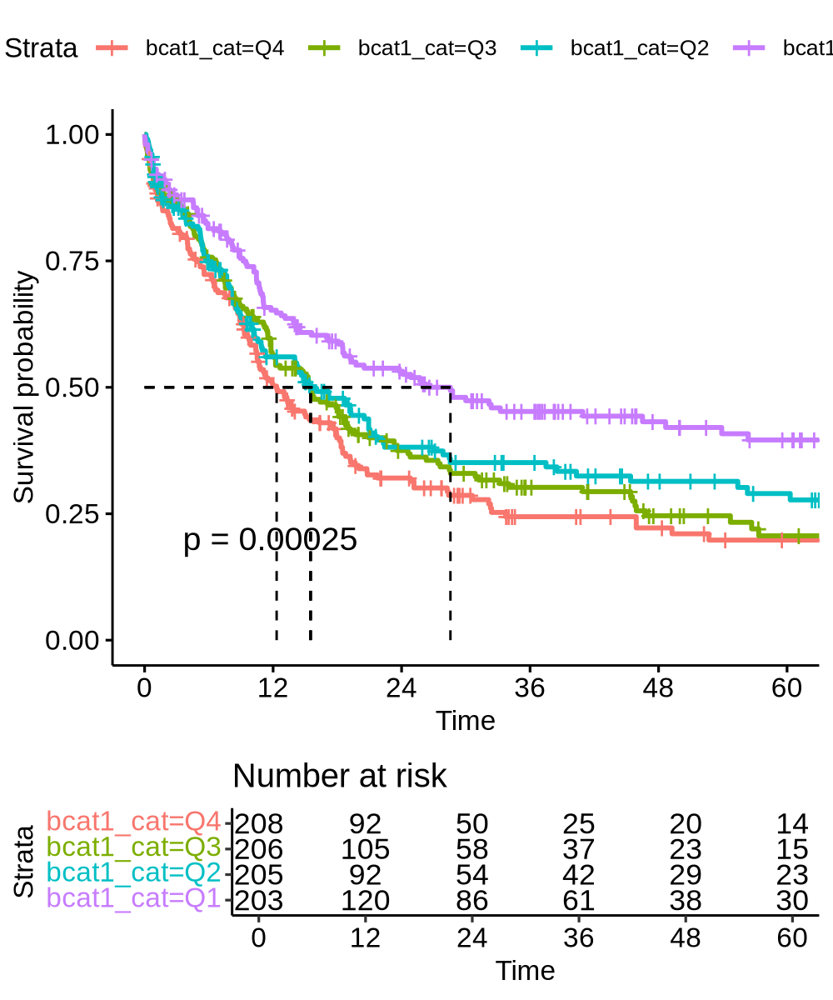

In [292]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat1_cat := factor(bcat1_cat, levels = c('Q4', 'Q3', 'Q2', 'Q1'))]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 6, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat1_tcga_beat_4q.pdf'
pdf(file = fname, width = 5, height = 6)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           #palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           #legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 411   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

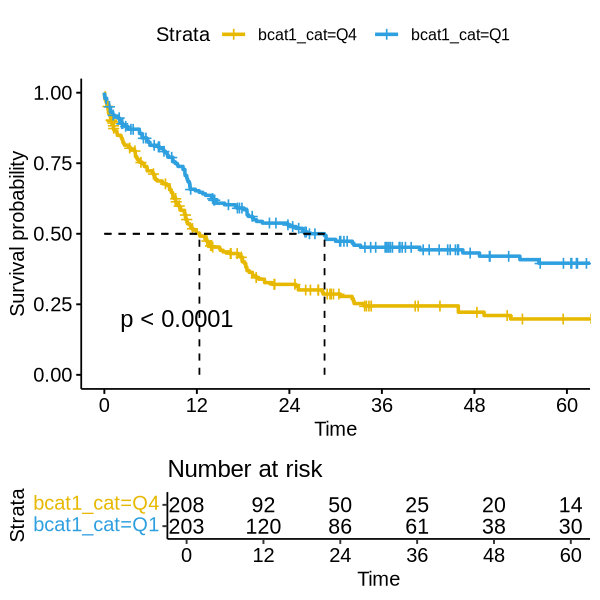

In [53]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1') & bcat1_cat %in% c('Q1', 'Q4'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat1_cat := factor(bcat1_cat, levels = c('Q4', 'Q1'))]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat1_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 410   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

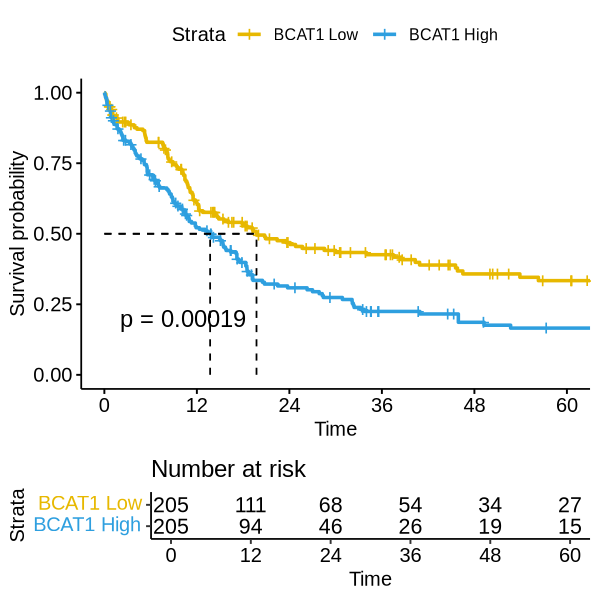

In [51]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), AZU1], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), AZU1], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1') & bcat1_cat %in% c('Q1', 'Q4'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat1_cat := factor(bcat1_cat, levels = c('Q4', 'Q1'))]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 Low", "BCAT1 High"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_AZU1_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 Low", "BCAT1 High"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


In [ ]:
plotdat = logcpm_t[batch %in% c( 'BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), ITGB6], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), ITGB6], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1') & bcat1_cat %in% c('Q1', 'Q4'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
plotdat[, bcat1_cat := factor(bcat1_cat, levels = c('Q4', 'Q1'))]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("ITGB6 High", "ITGB6 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_ITGB6_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("ITGB6 High", "ITGB6 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

dev.off()


    
     BeatAML TCGA
  Q1     168  130
  Q2     168   43
  Q3     167    0
  Q4     168    0

[1] 457   5

      
       TCGA
  low    87
  high   86

[1] 173   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

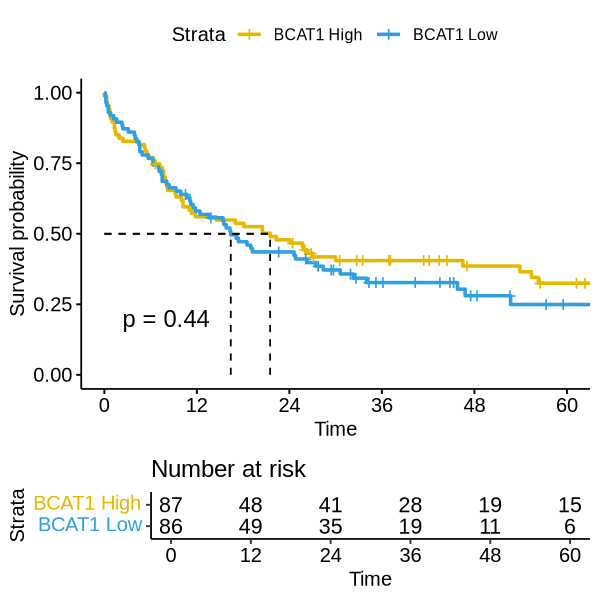

In [38]:
plotdat = logcpm_t[batch %in% c( 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 2) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 2) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1') , c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat1_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12, 
           legend.labs =  c("BCAT1 top 25%", "BCAT1 low 25%"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


    
     BeatAML TCGA
  Q1     168   44
  Q2     168   43
  Q3     167   43
  Q4     168   43

[1] 411   5

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

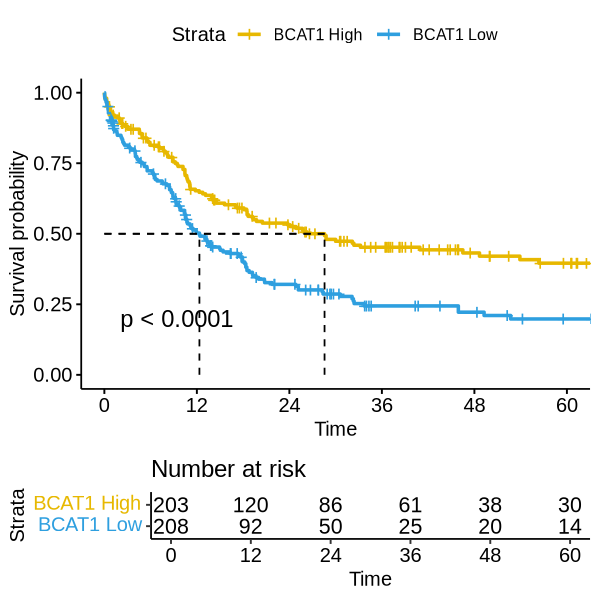

In [34]:
plotdat = logcpm_t[batch %in% c('BeatAML', 'TCGA'), ]
plotdat[grep('TCGA', rn), bcat1_cat := cut_quantile(plotdat[grep('TCGA', rn), BCAT1], 4) ]
plotdat[grep('BA', rn), bcat1_cat := cut_quantile(plotdat[grep('BA', rn), BCAT1], 4) ]
table(plotdat$bcat1_cat, plotdat$batch)

plotdat = plotdat[OS_STATUS2 %in% c('0', '1') & bcat1_cat %in% c('Q1', 'Q4'), c('bcat1_cat', 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
dim(plotdat)

fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_cat, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat1_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12, 
           legend.labs =  c("BCAT1 top 25%", "BCAT1 low 25%"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


[1] 822   7

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(

pdf 
  2

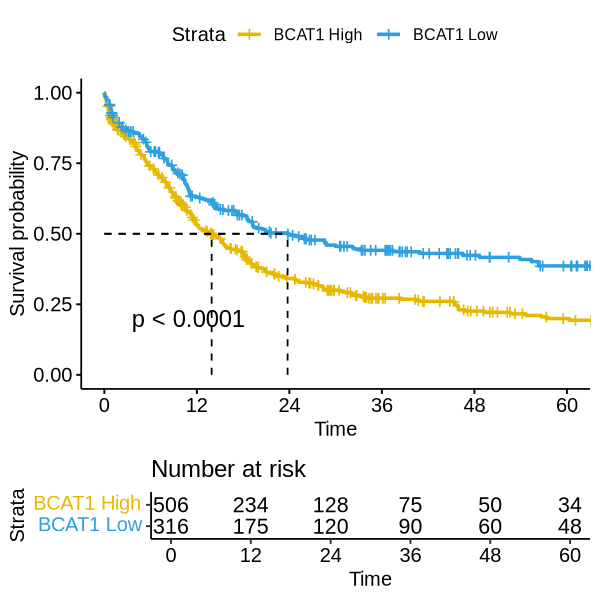

In [337]:
plotdat = logcpm_t[OS_STATUS2 %in% c('0', '1') & batch %in% c('TCGA', 'BeatAML'), c(genes, 'OS_MONTHS', 'OS_STATUS2', 'batch'), with = F]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme

fname = '~/WenhuoHu/plot/surv_bcat1_tcga_beat.pdf'
pdf(file = fname, width = 5, height = 5)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE, break.time.by = 12, 
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme
dev.off()


In [315]:
xxyy[, OS_STATUS := as.numeric(substr(OS_STATUS, 1, 2))]

Warning message in eval(jsub, SDenv, parent.frame()):
“NAs introduced by coercion”


In [316]:
table(xxyy$OS_STATUS) 


  0   1 
251 398 

In [345]:
table(plotdat0$batch)
table(logcpm_t$batch)


beat tcga 
 671  145 


BeatAML  TARGET    TCGA 
    671    1087     173 

In [344]:
setdiff(xx$PatientID, logcpm_t$rn2)

[1] "TCGA-AB-2892" "TCGA-AB-2894" "TCGA-AB-2876" "TCGA-AB-2878" "TCGA-AB-2883" "TCGA-AB-2893"

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


[1] 145  30

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


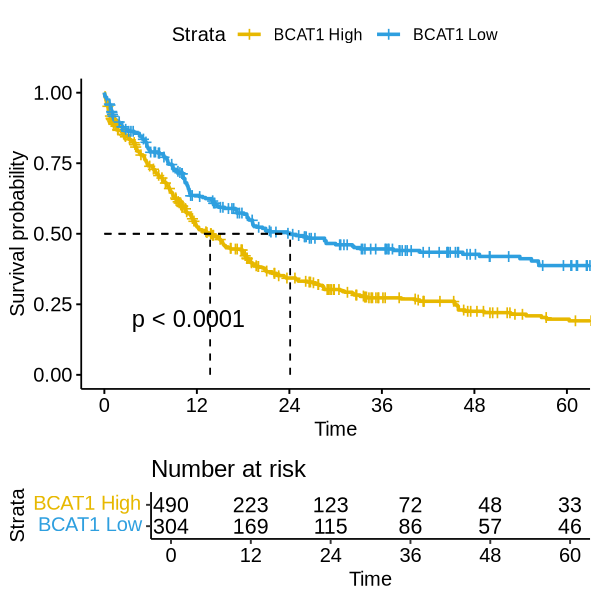

Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 2 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”


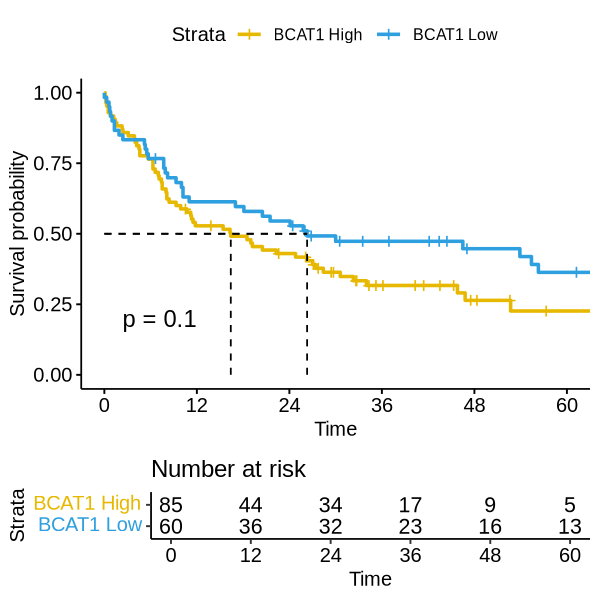

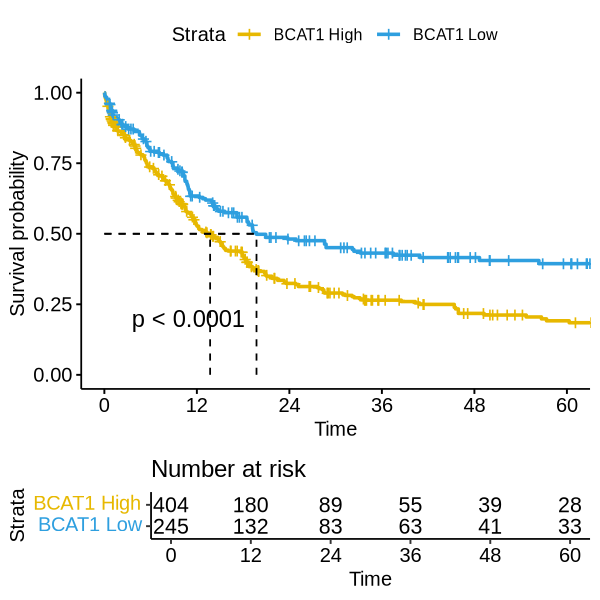

In [340]:
plotdat0 = merge(xxyy, logcpm_t[, .(rn, rn2, BCAT1, BCAT2)], by.y = 'rn2', by.x = 'sampleName') 
#plotdat0[, OS_STATUS := as.numeric(OS_STATUS) ]

options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
plotdat = plotdat0
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
ggsurvplot(fit, data = plotdat, size = 1, surv.median.line = "hv", risk.table = T, palette =  c("#E7B800", "#2E9FDF"),
           pval = TRUE, break.time.by = 12,  legend.labs =  c("BCAT1 High", "BCAT1 Low"), ggtheme = theme_pubr(), xlim = c(0, 60)) 

plotdat = plotdat0[batch == 'tcga', ]
dim(plotdat)
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
ggsurvplot(fit, data = plotdat, size = 1, surv.median.line = "hv", risk.table = T, palette =  c("#E7B800", "#2E9FDF"),
           pval = TRUE, break.time.by = 12,  legend.labs =  c("BCAT1 High", "BCAT1 Low"), ggtheme = theme_pubr(), xlim = c(0, 60)) 

plotdat = plotdat0[batch == 'beat', ]
plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
ggsurvplot(fit, data = plotdat, size = 1, surv.median.line = "hv", risk.table = T, palette =  c("#E7B800", "#2E9FDF"),
           pval = TRUE, break.time.by = 12,  legend.labs =  c("BCAT1 High", "BCAT1 Low"), ggtheme = theme_pubr(), xlim = c(0, 60)) 


In [303]:
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + BCAT1 + TET2_mut')), plotdat) 
coxph(as.formula(paste0('Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + IDH1_mut + IDH2_mut + TET2')), plotdat) 


Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT2 + BCAT1 + TET2_mut")), 
    data = plotdat)

               coef exp(coef) se(coef)      z        p
BCAT2      -0.12212   0.88504  0.09845 -1.240   0.2148
BCAT1       0.19434   1.21451  0.04209  4.617 3.89e-06
TET2_mutWT -0.86928   0.41925  0.34021 -2.555   0.0106

Likelihood ratio test=29.17  on 3 df, p=2.06e-06
n= 649, number of events= 398 
   (173 observations deleted due to missingness)

Call:
coxph(formula = as.formula(paste0("Surv(OS_MONTHS, OS_STATUS) ~ BCAT1 + IDH1_mut + IDH2_mut + TET2")), 
    data = plotdat)

               coef exp(coef) se(coef)      z        p
BCAT1       0.19030   1.20961  0.04265  4.462 8.12e-06
IDH1_mutWT  0.14061   1.15098  0.38246  0.368    0.713
IDH2_mutWT  0.38211   1.46537  0.70998  0.538    0.590
TET2       -0.02102   0.97920  0.08598 -0.244    0.807

Likelihood ratio test=22.79  on 4 df, p=0.0001394
n= 649, number of events= 398 
   (173 observations deleted due to missingness)

Warning message:
“Using `bins = 30` by default. Pick better value with the argument `bins`.”
Warning message:
“Removed 6 rows containing non-finite outside the scale range (`stat_bin()`).”


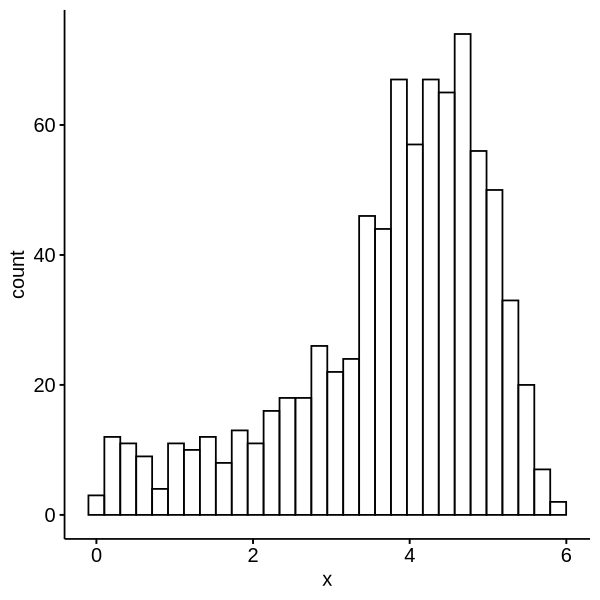

In [306]:
gghistogram(plotdat$BCAT1)

In [301]:
plotdat = merge(xxyy, logcpm_t[, .(rn, rn2, BCAT1, BCAT2, TET2)], by.y = 'rn2', by.x = 'sampleName', all.x = T) 
plotdat[, OS_STATUS := as.numeric(OS_STATUS) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[TET2_mut != 'WT', .(TET2_mut, bcat1_lvl, BCAT1, BCAT2)]


Warning message in eval(jsub, SDenv, parent.frame()):
“NAs introduced by coercion”


TET2_mut,bcat1_lvl,BCAT1,BCAT2
<chr>,<chr>,<dbl>,<dbl>
TET2_mut,low,0.2016386,1.802347
TET2_mut,low,1.3512202,2.109446
TET2_mut,hi,3.9225181,2.317558
TET2_mut,hi,4.9171883,2.913512
TET2_mut,hi,3.8944942,2.677681
TET2_mut,hi,5.2290358,2.802414
TET2_mut,hi,4.2710915,2.170473
TET2_mut,low,3.5851366,1.615084
TET2_mut,hi,4.0099246,2.808292


Warning message in eval(jsub, SDenv, parent.frame()):
“NAs introduced by coercion”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 3 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 3 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 3 rows.
ℹ Please consider using `annotate()` or provide this layer with data containing a single row.”
Warning message in geom_segment(aes(x = 0, y = max(y2), xend = max(x1), yend = max(y2)), :
“All aesthetics have length 1, but the data has 3 rows.
ℹ Please consider using `annotate()` or prov

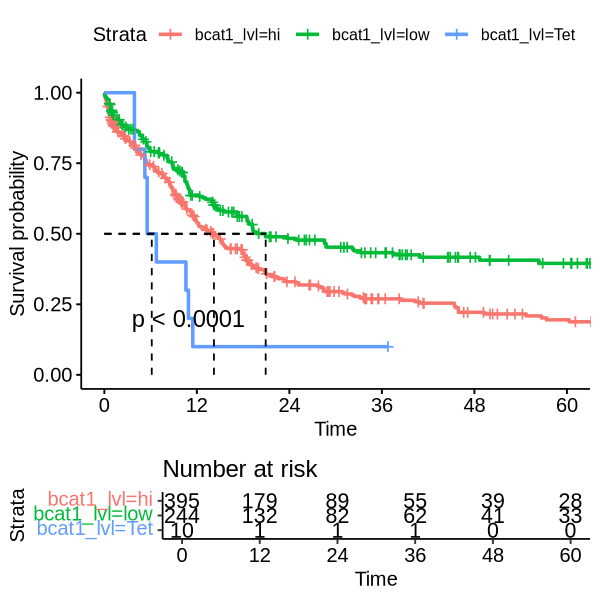

In [297]:
plotdat = merge(xxyy, logcpm_t[, .(rn, rn2, BCAT1, BCAT2, TET2)], by.y = 'rn2', by.x = 'sampleName', all.x = T) 
plotdat[, OS_STATUS := as.numeric(OS_STATUS) ]

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
plotdat[TET2_mut != 'WT', bcat1_lvl := 'Tet' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme


In [273]:
plotdat = logcpm_t[OS_STATUS2 %in% c('0', '1') & batch %in% c('TCGA', 'BeatAML'), ]
plotdat = plotdat[!is.na(OS_MONTHS), ]
plotdat = plotdat[TET2_mut == 'WT' & TET1_mut == 'WT' & IDH1_mut == 'WT',]
plotdat[, OS_STATUS := as.numeric(OS_STATUS2) ]
dim(plotdat)

plotdat[, bcat1_lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), bcat1_lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS2) ~ bcat1_lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 5, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           surv.median.line = "hv",
           risk.table = T,
           pval = TRUE, break.time.by = 12,       # Add p-value
           legend.labs =  c("BCAT1 High", "BCAT1 Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 60))      # Change ggplot2 theme



ERROR: Error: Object 'TET2_mut' not found amongst [rn, UBE2Q2P2, HMGB1P1, RNU12-2P, EFCAB8, SDR16C6P, HSPB1P1, PPBPP1, GTPBP6, EFCAB12, ...]


In [270]:
table(plotdat$batch)


BeatAML    TCGA 
    649     173 

In [500]:
plotdat[, BCAT1_cat := factor(findInterval(BCAT1, c(-Inf, quantile(BCAT1, probs=c(0.25, .75)),  Inf)),  labels=c("Low", "Middle", "High") ) ]
plotdat[, BCAT2_cat := factor(findInterval(BCAT2, c(-Inf, quantile(BCAT2, probs=c(0.25, .75)),  Inf)),  labels=c("Low", "Middle", "High") ) ]
plotdat[, LAT2_cat := factor(findInterval(LAT2, c(-Inf, quantile(LAT2, probs=c(0.25, .75)),  Inf)),  labels=c("Low", "Middle", "High") ) ]
plotdat[, BCAT1_LAT2_cat := paste0(BCAT1_cat, '_', LAT2_cat) ]
#plotdat[, BCKDK_cat := factor(findInterval(BCKDK, c(-Inf, quantile(BCKDK, probs=c(0.25, .75)),  Inf)),  labels=c("Low", "Middle", "High") ) ]


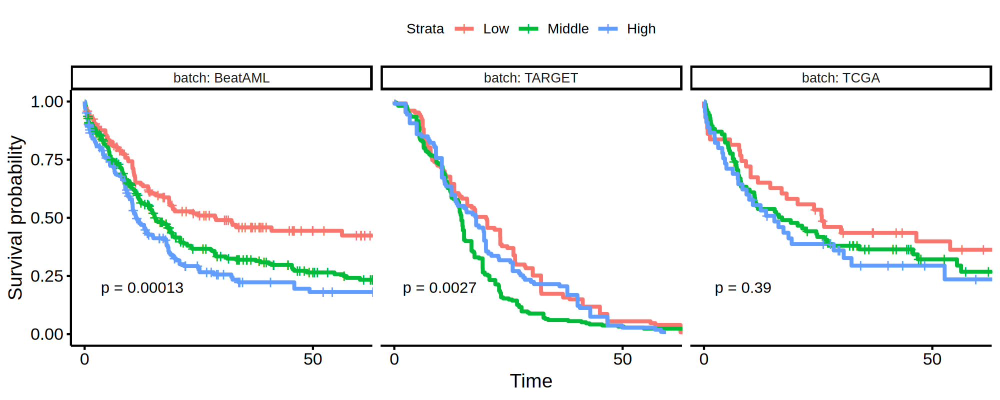

In [518]:
fit_bcat1 <- surv_fit(Surv(OS_MONTHS, OS_STATUS) ~ BCAT1_cat, data = plotdat)

options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 200)
ggsurvplot_facet(fit_bcat1, data = plotdat, facet.by = 'batch', xlim = c(0, 60), pval = T)


Warning message:
"`as.tibble()` was deprecated in tibble 2.0.0.
ℹ Please use `as_tibble()` instead.
ℹ The signature and semantics have changed, see `?as_tibble`.
ℹ The deprecated feature was likely used in the survminer package.
  Please report the issue at <https://github.com/kassambara/survminer/issues>."
Warning message:
"`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.
ℹ The deprecated feature was likely used in the survminer package.
  Please report the issue at <https://github.com/kassambara/survminer/issues>."


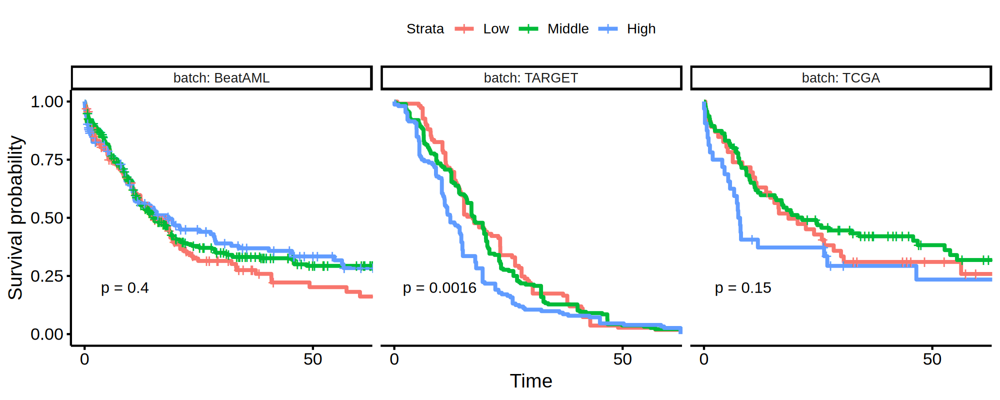

In [517]:
fit_bcat2 <- surv_fit(Surv(OS_MONTHS, OS_STATUS) ~ BCAT2_cat, data = plotdat)

options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 200)
ggsurvplot_facet(fit_bcat2, data = plotdat, facet.by = 'batch', xlim = c(0, 60), pval = T)


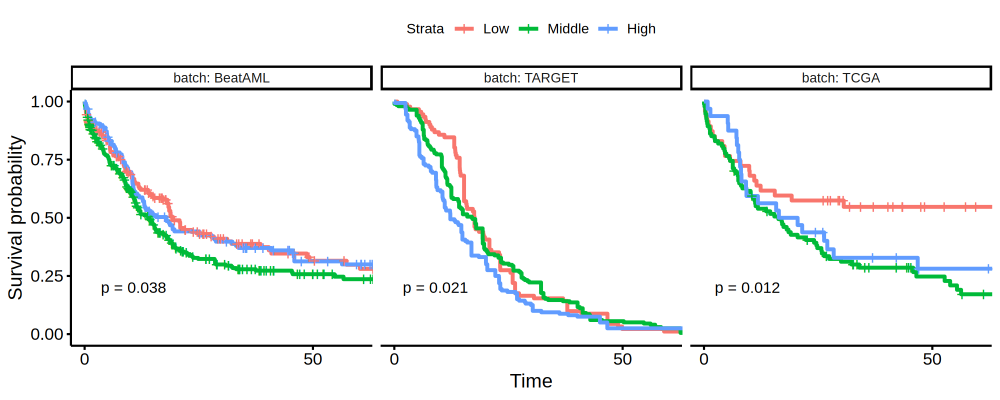

In [519]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
fit_lat2  <- surv_fit(Surv(OS_MONTHS, OS_STATUS) ~ LAT2_cat,  data = plotdat)

options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 200)
ggsurvplot_facet(fit_lat2, data = plotdat, facet.by = 'batch', xlim = c(0, 60), pval = T)


In [503]:
table(plotdat$BCAT1_LAT2_cat)


    High_High      High_Low   High_Middle      Low_High       Low_Low    Low_Middle   Middle_High    Middle_Low Middle_Middle 
           57           106           155           120            53           145           141           159           335 

In [506]:
head(plotdat)

BCAT1,BCAT2,LAT2,OS_MONTHS,OS_STATUS2,batch,OS_STATUS,BCAT1_cat,BCAT2_cat,LAT2_cat,BCAT1_LAT2_cat,tmp1
<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<fct>,<fct>,<fct>,<chr>,<fct>
3.920193,3.019401,5.236813,20.925620,1,BeatAML,1,Middle,High,Middle,Middle_Middle,Low
3.869503,2.222817,5.031643,8.495868,1,BeatAML,1,Middle,Middle,Middle,Middle_Middle,Low
3.960267,2.556529,5.033442,11.272727,1,BeatAML,1,Middle,Middle,Middle,Middle_Middle,Low
3.790495,1.568817,4.669780,10.115702,0,BeatAML,0,Middle,Low,Middle,Middle_Middle,Low
4.484909,2.653276,3.604861,5.586777,1,BeatAML,1,Middle,Middle,Low,Middle_Low,High
2.528706,2.863301,4.528423,25.190083,0,BeatAML,0,Low,Middle,Low,Low_Low,Low


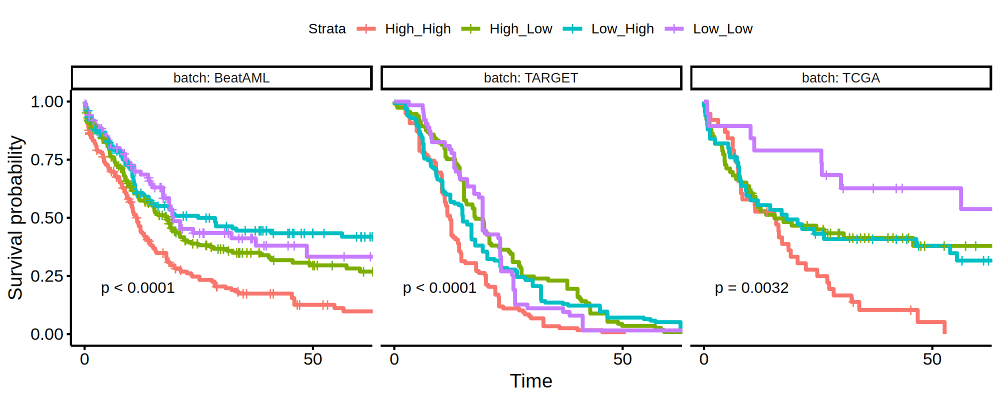

In [527]:
plotdat[, tmp1 := factor(findInterval(BCAT1, c(-Inf, mean(BCAT1),  Inf)),  labels=c("Low", "High") ) ]
plotdat[, tmp2 := factor(findInterval(LAT2, c(-Inf, mean(LAT2),  Inf)),  labels=c("Low", "High") ) ]
plotdat[, BCAT1_LAT2_cat := paste0(tmp1, '_', tmp2) ]
#plotdat[, BCKDK_cat := factor(findInterval(BCKDK, c(-Inf, quantile(BCKDK, probs=c(0.25, .75)),  Inf)),  labels=c("Low", "Middle", "High") ) ]

options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
fit_bcat1_lat2  <- surv_fit(Surv(OS_MONTHS, OS_STATUS) ~ BCAT1_LAT2_cat,  data = plotdat)

options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 200)
ggsurvplot_facet(fit_bcat1_lat2, data = plotdat, facet.by = 'batch', xlim = c(0, 60), pval = T)


In [543]:
table(plotdat$FLT3ITD)


      WT FLT3-ITD 
    1583      348 

In [ ]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
tmp <- surv_fit(Surv(OS_MONTHS, OS_STATUS) ~ FLT3ITD,  data = plotdat)

options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 200)
ggsurvplot_facet(tmp, data = plotdat, facet.by = 'batch', xlim = c(0, 60), pval = T)


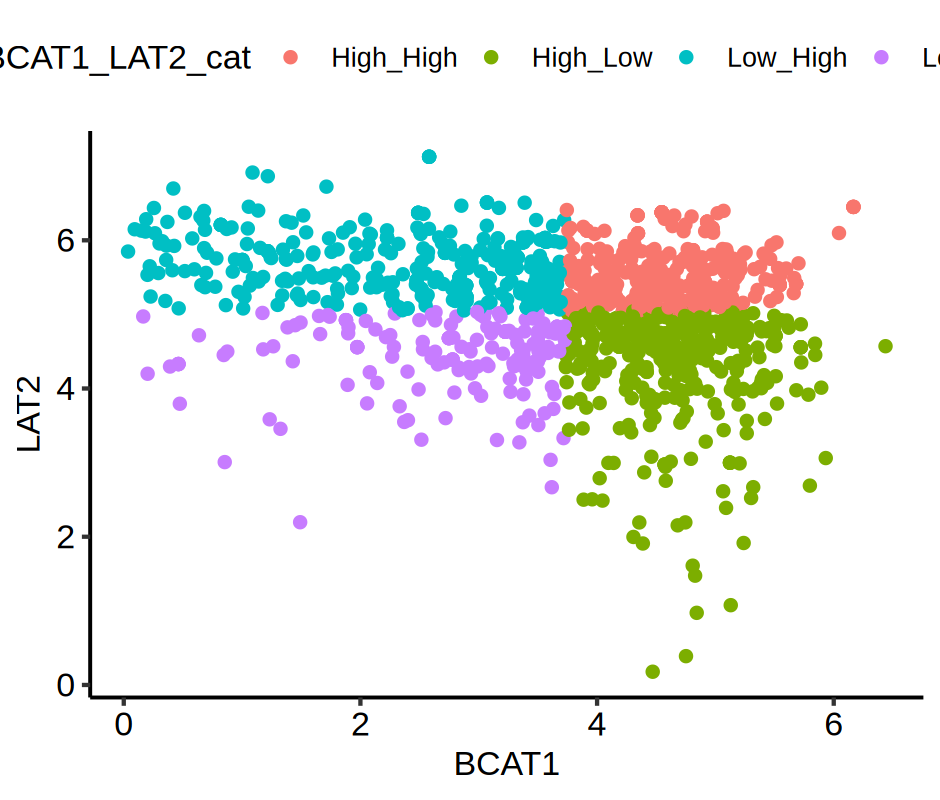

In [516]:
options(repr.plot.width = 4.7, repr.plot.height = 4, repr.plot.res = 200)
ggplot(plotdat, aes(x = BCAT1, y = LAT2, color = BCAT1_LAT2_cat)) + geom_point() + theme_pubr()


In [541]:
plotdat = copy(logcpm_t)
plotdat[, tmp1 := factor(findInterval(BCAT1, c(-Inf, mean(BCAT1),  Inf)),  labels=c("Low", "High") ) ]
plotdat[, tmp2 := factor(findInterval(LAT2, c(-Inf, mean(LAT2),  Inf)),  labels=c("Low", "High") ) ]
plotdat[, BCAT1_LAT2_cat := paste0(tmp1, '_', tmp2) ]
table(plotdat[BCAT1_LAT2_cat == 'High_High', batch], plotdat[BCAT1_LAT2_cat == 'High_High', MLL_re])
table(plotdat[BCAT1_LAT2_cat == 'High_High', batch], plotdat[BCAT1_LAT2_cat == 'High_High', AML1ETO])
table(plotdat[BCAT1_LAT2_cat == 'High_High', batch], plotdat[BCAT1_LAT2_cat == 'High_High', FLT3ITD])

         
           WT MLL_re
  BeatAML 181      7
  TARGET  254      0
  TCGA     43      0

         
           WT AML1-ETO
  BeatAML 188        0
  TARGET  254        0
  TCGA     43        0

         
           WT FLT3-ITD
  BeatAML 134       54
  TARGET  136      118
  TCGA     41        2

In [507]:
quantile(plotdat$BCAT1, probs=c(0.5))

50% 
3.968582

In [ ]:
BCAT1_LAT2_cat

In [33]:
table(logcpm_t$batch)


BeatAML  TARGET    TCGA 
    671    1087     173 

# export 

In [600]:
write.csv(raw_count_adj, file = 'data/data_jun20/raw_count_adj.cvs') 
write.csv(raw_count, file = 'data/data_jun20/raw_count.cvs') 
fwrite(raw_count_adj_v2, file = 'data/batch_corrected_3cohort_raw_counts.tsv', sep = '\t')
fwrite(dsn_batch_v2, file = 'data/batch_corrected_3cohort_design_table.tsv', sep = '\t')
fwrite(logcpm_t, file = 'data/batch_corrected_normalized_3cohort_with_basic_clinical_info.tsv', sep = '\t')
write.table(logcpm, file = 'data/batch_corrected_normalized_3cohort.tsv', sep = '\t')
fwrite(cbio_tcga_clin, file = 'data/cbio_tcga_clin.tsv', sep = '\t')


x being coerced from class: matrix to data.table



In [469]:
fwrite(logcpm_t, file = 'data/batch_corrected_normalized_3cohort_with_basic_clinical_info_Nov26.tsv', sep = '\t')


In [43]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [44]:
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/batch_corrected_normalized_3cohort_with_basic_clinical_info_Nov26.tsv


[1] 490125803

In [40]:
logcpm_t = fread(file = 'data/batch_corrected_normalized_3cohort_with_basic_clinical_info_Nov26.tsv')


In [585]:
fwrite(beat_rna_t, file = 'beat_rna_t.tsv', sep = '\t')

In [558]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"

In [15]:
cbio_tcga_clin = fread(file = 'data/cbio_tcga_clin.tsv') 

In [549]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat"